In [1]:
import numpy as np
import matplotlib.pyplot as plt
plt.rcParams['font.family'] = 'DejaVu Sans'

from matplotlib.dates import date2num
import matplotlib.dates as mdates
import matplotlib.patches as mpatches
from datetime import datetime
import xarray as xr
import netCDF4 as nc
import glob
import math
import subprocess
from matplotlib import colormaps
import plotly.graph_objs as go

import cartopy.crs as ccrs
import cartopy.feature as cfeature

import seaborn as sns
import csv
import pandas as pd
from scipy.optimize import curve_fit
from math import prod

import numpy as np
import matplotlib.pyplot as plt
from metpy.plots import SkewT
from metpy.units import units
from metpy.calc import dewpoint_from_relative_humidity
#from metpy.io import get_test_data

import sys, os
import requests
import pyart

import warnings
warnings.simplefilter("ignore", RuntimeWarning)
warnings.simplefilter("ignore", FutureWarning)
warnings.simplefilter("ignore", UserWarning)

#%matplotlib notebook

plt.style.use('default')


#import dask
#from dask.distributed import Client, progress, wait
#dask.config.config.get('distributed').get('dashboard').update({'link':'{JUPYTERHUB_SERVICE_PREFIX}/proxy/{port}/status'})
#client = Client()
#client

#dask.config.set(scheduler='threads', num_workers=2)

from dask.distributed import Client
import dask

# Dashboard config for JupyterHub (optional)
dask.config.config.get('distributed').get('dashboard').update({
    'link': '{JUPYTERHUB_SERVICE_PREFIX}/proxy/{port}/status'
})

# Start Dask client with controlled resources
client = Client(n_workers=4, threads_per_worker=2, memory_limit='80GB') # This will use 4*2=8 CPU threads
#client



## You are using the Python ARM Radar Toolkit (Py-ART), an open source
## library for working with weather radar data. Py-ART is partly
## supported by the U.S. Department of Energy as part of the Atmospheric
## Radiation Measurement (ARM) Climate Research Facility, an Office of
## Science user facility.
##
## If you use this software to prepare a publication, please cite:
##
##     JJ Helmus and SM Collis, JORS 2016, doi: 10.5334/jors.119



In [2]:
import numpy as np
import warnings

np.seterr(divide='ignore', invalid='ignore')
warnings.filterwarnings("ignore", category=RuntimeWarning)

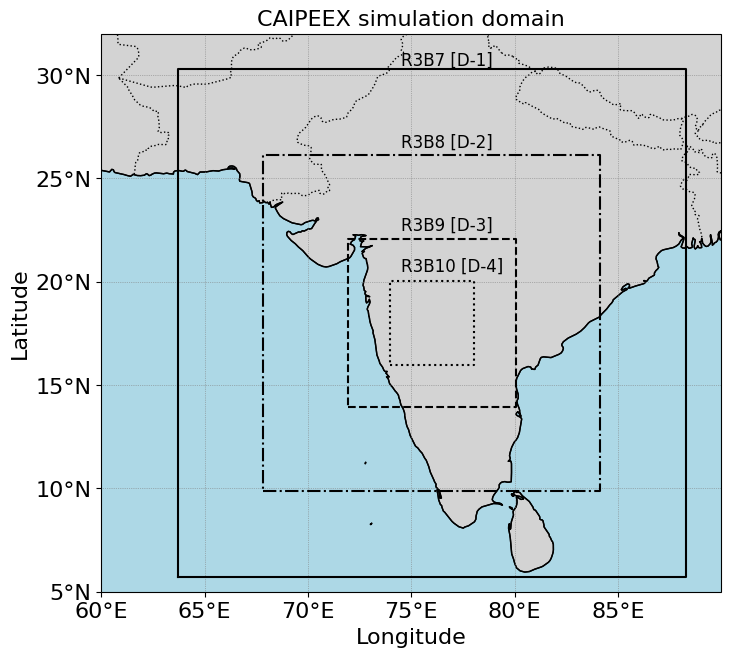

In [3]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from cartopy.mpl.geoaxes import GeoAxes
from mpl_toolkits.axes_grid1.inset_locator import inset_axes, zoomed_inset_axes
#from mpl_toolkits.axes_grid1.inset_locator import inset_axes


# Define bounding boxes (in degrees)
lon1 = [np.rad2deg(1.111786), np.rad2deg(1.540838)];
lat1 = [np.rad2deg(0.1000659), np.rad2deg(0.5284007)];

lon2 = [np.rad2deg(1.184192), np.rad2deg(1.468616)];
lat2 = [np.rad2deg(0.172241), np.rad2deg(0.4561395)];

lon3 = [np.rad2deg(1.255452), np.rad2deg(1.397565)];
lat3 = [np.rad2deg(0.2432072), np.rad2deg(0.3851319)];

lon4 = [np.rad2deg(1.290886), np.rad2deg(1.362008)];
lat4 = [np.rad2deg(0.2786696), np.rad2deg(0.3496378)];

#print(lon1, lat1)
#print(lon2, lat2)
#print(lon3, lat3)
#print(lon4, lat4)

fontsize = 12;
fnt = 12;
proj = ccrs.PlateCarree()

plt.style.use('default')
fig = plt.figure(figsize=(8, 8))
ax = fig.add_subplot(1, 1, 1, projection=proj)

# Plot base map
ax.coastlines(resolution='50m')
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.add_feature(cfeature.OCEAN, facecolor='lightblue')
ax.add_feature(cfeature.LAND, edgecolor='black', facecolor='lightgray')

# Plot bounding boxes
for lon, lat, style in zip(
    [lon1, lon2, lon3, lon4],
    [lat1, lat2, lat3, lat4],
    ['-', '-.', '--', ':']
):
    ax.plot([lon[0], lon[1], lon[1], lon[0], lon[0]],
            [lat[0], lat[0], lat[1], lat[1], lat[0]],
            color='black', linewidth=1.5, linestyle=style, transform=proj)


# Labels
ax.text(74.5, 30.5, "R3B7 [D-1]", transform=proj, fontsize=fontsize)
ax.text(74.5, 26.5, "R3B8 [D-2]", transform=proj, fontsize=fontsize)
ax.text(74.5, 22.5, "R3B9 [D-3]", transform=proj, fontsize=fontsize)
ax.text(74.5, 20.5, "R3B10 [D-4]", transform=proj, fontsize=fontsize)

# Map limits
ax.set_xlim(60., 90.)
ax.set_ylim(5., 32.)
ax.set_xticks(range(60, 90, 5))  
ax.set_yticks(range(5, 32, 5))


ax.set_xlim(60., 90.)
ax.set_ylim(5., 32.)
ax.set_xticks(range(60, 90, 5))  
ax.set_yticks(range(5, 32, 5))

xticks = range(60, 89, 5)  # x-ticks from -50 to -10 with step 5
yticks = range(5, 32, 5)  # y-ticks from -10 to 30 with step 5

xtick_labels = [f"{abs(x)}°W" if x < 0 else f"{x}°E" for x in xticks]
ytick_labels = [f"{abs(y)}°N" if y >= 0 else f"{abs(y)}°S" for y in yticks]


ax.tick_params(axis='x', labelsize=fnt)
ax.tick_params(axis='y', labelsize=fnt)
ax.set_xticklabels(xtick_labels[:], fontsize=fnt)
ax.set_yticklabels(ytick_labels, fontsize=fnt)

ax.tick_params(axis='both', labelsize=fontsize+4)
ax.set_xlabel("Longitude", fontsize=fontsize+4)
ax.set_ylabel("Latitude", fontsize=fontsize+4)
ax.set_title('CAIPEEX simulation domain', fontsize=fontsize+4)
ax.grid(True, linestyle=':', linewidth=0.5, color='grey')

# === Create inset axes === #
#inset_position = [0.68, 0.35, 0.30, 0.25]  # [left, bottom, width, height] in figure coordinates
#inset_ax = fig.add_axes(inset_position, projection=proj)
#inset_ax.set_extent([75, 77, 16, 18], crs=proj)
#inset_ax.coastlines(resolution='50m')
#inset_ax.add_feature(cfeature.LAND, facecolor='lightgray')
#inset_ax.add_feature(cfeature.OCEAN, facecolor='lightblue')
#inset_ax.gridlines(draw_labels=False, linestyle=':')


# Aircraft track in inset
#inset_ax.plot(ds_b200.Longitude, ds_b200.Latitude, 'r-', transform=proj)

#inset_ax.plot([75, 77, 77, 75, 75],
#              [16, 16, 18, 18, 16],
#              color='black', linewidth=1, linestyle=':', alpha=0.1, transform=proj)

#inset_ax.text(76, 16.2, 'R3B10 [D-4]', transform=proj, 
#              fontsize=fontsize, ha='center', va='center', 
#              bbox=dict(facecolor='none', edgecolor='none', alpha=0.7))

#gl = inset_ax.gridlines(draw_labels=False, linestyle=':', color='grey', alpha=0.5)
#gl.top_labels = False
#gl.right_labels = False
##gl.xlabel_style = {'size': 10}
##gl.ylabel_style = {'size': 10}
#inset_ax.set_xticks(np.linspace(75, 77, 5), crs=proj)
#inset_ax.set_yticks(np.linspace(16, 18, 5), crs=proj)
#inset_ax.tick_params(axis='both', which='major', labelsize=8)

# --- Radar marker in zoomed inset ---
#inset_ax.text(76, 16.7, 'B200 aircraft', transform=proj, fontsize=fontsize, ha='center', color='red')

plt.show()


In [4]:

file_path='/work/bk1415/b382718/output/caipeex/nested_run/icon_output/continental_ccn/latent_heat/sull_ds'
ds_nosip = xr.open_mfdataset(f'{file_path}/nosip/caipeex_2mom/NWP_LAM_icongrid_DOM04*.nc', chunks={'time': 4, 'height': 10}, parallel=True);
ds_4sip = xr.open_mfdataset(f'{file_path}/4sip/caipeex_2mom/NWP_LAM_icongrid_DOM04*.nc', chunks={'time': 4, 'height': 10}, parallel=True);
ds_icongrid = xr.open_mfdataset(f'{file_path}/4sip/caipeex_2mom/ICONCONST_icongrid_DOM04_ML_0001.nc', chunks={'time': 4, 'height': 10}, parallel=True)


/home/b/b382718/own_env/lib/python3.9/site-packages/xarray/backends/plugins.py:80: RuntimeWarning: Engine 'earthkit' loading failed:
unsupported operand type(s) for |: 'type' and 'types.GenericAlias'
  warnings.warn(f"Engine {name!r} loading failed:\n{ex}", RuntimeWarning)
/home/b/b382718/own_env/lib/python3.9/site-packages/xarray/backends/plugins.py:80: RuntimeWarning: Engine 'earthkit' loading failed:
unsupported operand type(s) for |: 'type' and 'types.GenericAlias'
  warnings.warn(f"Engine {name!r} loading failed:\n{ex}", RuntimeWarning)
/home/b/b382718/own_env/lib/python3.9/site-packages/xarray/backends/plugins.py:80: RuntimeWarning: Engine 'earthkit' loading failed:
unsupported operand type(s) for |: 'type' and 'types.GenericAlias'
  warnings.warn(f"Engine {name!r} loading failed:\n{ex}", RuntimeWarning)
/home/b/b382718/own_env/lib/python3.9/site-packages/xarray/backends/plugins.py:80: RuntimeWarning: Engine 'earthkit' loading failed:
unsupported operand type(s) for |: 'type' and

In [27]:

grid_caipeex = xr.open_dataset(f'{file_path}/4sip/caipeex_2mom/domain4_DOM04.nc');

clon_deg = np.degrees(grid_caipeex.clon)
clat_deg = np.degrees(grid_caipeex.clat)

print(clon_deg.min().values); print(clon_deg.max().values);
print(clat_deg.min().values); print(clat_deg.max().values);

okla_x, okla_y = np.array([75., 17.])
#print(okla_x), print(okla_y)
dx_deg = 1; dy_deg = 1.
left_bound = okla_x - dx_deg
right_bound = okla_x + dx_deg
top_bound = okla_y + dy_deg
bottom_bound = okla_y - dy_deg

print(left_bound), print(right_bound)
print(top_bound), print(bottom_bound)

window_cell = (
    (grid_caipeex.clat >= np.deg2rad(bottom_bound))
    & (grid_caipeex.clat <= np.deg2rad(top_bound))
    & (grid_caipeex.clon >= np.deg2rad(left_bound))
    & (grid_caipeex.clon <= np.deg2rad(right_bound))
).values

(window_cell_indices,) = np.where(window_cell)

# select cells matching with the area of interest (windows_cell_indices:: matching to that with the area sampled by the aircraft)
window_vertex_indices = (np.unique(grid_caipeex.vertex_of_cell.isel(cell=window_cell_indices).values) - 1)
print('window_vertex_indices ::',window_vertex_indices)

# select edges matching with the area of interest (corresponding to the windows_cell_indices)
window_edge_indices = (np.unique(grid_caipeex.edge_of_cell.isel(cell=window_cell_indices).values) - 1)
print('window_edge_indices ::',window_edge_indices)

selected_indices = xr.Dataset(
    {
        "cell": ("cell", window_cell_indices),
        "vertex": ("vertex", window_vertex_indices),
        "edge": ("edge", window_edge_indices),
    }
)


vars_to_renumber = {
    "cell": [
        "adjacent_cell_of_edge",
        "cells_of_vertex",
        "neighbor_cell_index",
    ],
    "vertex": ["vertex_of_cell", "edge_vertices", "vertices_of_vertex"],
    "edge": ["edge_of_cell", "edges_of_vertex"],
}

def reindex_grid(grid, indices, vars_to_renumber):
    new_grid = grid.load().isel(
        cell=indices.cell, vertex=indices.vertex, edge=indices.edge
    )
    for dim, idx in indices.coords.items():
        renumbering = np.full(grid.dims[dim], -2, dtype="int")
        renumbering[idx] = np.arange(len(idx))
        for name in vars_to_renumber[dim]:
            new_grid[name].data = renumbering[new_grid[name].data - 1] + 1
    return new_grid

new_grid_caipeex = reindex_grid(grid_caipeex, selected_indices, vars_to_renumber)

mask_cells=np.isin(ds_4sip['ncells'], selected_indices.cell)


73.96231325070727
78.03733091737507
15.966592379850837
20.032768784756854
74.0
76.0
18.0
16.0
window_vertex_indices :: [  113   120   127 ... 32701 32702 32703]
window_edge_indices :: [  610   611   612 ... 95287 95288 95289]


In [28]:

ds_nosip['w_vel'] = -1.*ds_nosip.omega/(9.8*ds_nosip.rho)
ds_nosip['tempc'] = ds_nosip.temp-273.16;
ds_nosip['lwc_gperm3']  = ds_nosip.qc*ds_nosip.rho*1.e3 # kgperm3 to gperm3
ds_nosip['tqi'] = ds_nosip.qi+ds_nosip.qs+ds_nosip.qg+ds_nosip.qh
ds_nosip['tq'] = ds_nosip.qc+ds_nosip.qi+ds_nosip.qs+ds_nosip.qg+ds_nosip.qh
ds_nosip['ciwc_gperm3'] = ds_nosip.qi*ds_nosip.rho*1.e3 # kgperm3 to gperm3
ds_nosip['tiwc_gperm3'] = (ds_nosip.qi+ds_nosip.qs+ds_nosip.qg+ds_nosip.qh)*ds_nosip.rho*1.e3 # kgperm3 to gperm3
ds_nosip['twc_gperm3'] = (ds_nosip.qc+ds_nosip.qi+ds_nosip.qs+ds_nosip.qg+ds_nosip.qh)*ds_nosip.rho*1.e3 # kgperm3 to gperm3
ds_nosip['cdnc_percm3'] = ds_nosip.qnc*ds_nosip.rho*1.e-6  # perkg to percm3
ds_nosip['inc_perl'] = (ds_nosip.qni+ds_nosip.qns+ds_nosip.qng+ds_nosip.qnh)*ds_nosip.rho*1.e-3 # perkg to perl
ds_nosip['inp_perl'] = (ds_nosip.d_qni_het)*ds_nosip.rho*1.e-3 # perkg to perl

ds_4sip['w_vel'] = -1.*ds_4sip.omega/(9.8*ds_4sip.rho)
ds_4sip['tempc'] = ds_4sip.temp-273.16;
ds_4sip['lwc_gperm3']  = ds_4sip.qc*ds_4sip.rho*1.e3 # kgperm3 to gperm3
ds_4sip['tqi'] = ds_4sip.qi+ds_4sip.qs+ds_4sip.qg+ds_4sip.qh
ds_4sip['tq'] = ds_4sip.qc+ds_4sip.qi+ds_4sip.qs+ds_4sip.qg+ds_4sip.qh
ds_4sip['ciwc_gperm3'] = ds_4sip.qi*ds_4sip.rho*1.e3 # kgperm3 to gperm3
ds_4sip['tiwc_gperm3'] = (ds_4sip.qi+ds_4sip.qs+ds_4sip.qg+ds_4sip.qh)*ds_4sip.rho*1.e3 # kgperm3 to gperm3
ds_4sip['twc_gperm3'] = (ds_4sip.qc+ds_4sip.qi+ds_4sip.qs+ds_4sip.qg+ds_4sip.qh)*ds_4sip.rho*1.e3 # kgperm3 to gperm3
ds_4sip['cdnc_percm3'] = ds_4sip.qnc*ds_4sip.rho*1.e-6  # perkg to percm3
ds_4sip['inc_perl'] = (ds_4sip.qni+ds_4sip.qns+ds_4sip.qng+ds_4sip.qnh)*ds_4sip.rho*1.e-3 # perkg to perl
ds_4sip['inp_perl'] = (ds_4sip.d_qni_het)*ds_4sip.rho*1.e-3 # perkg to perl
ds_4sip['inc_sip_perl'] = (ds_4sip.dqni_sec)*ds_4sip.rho*1.e-3 # perkg to perl
ds_4sip['inp_perl'] = (ds_4sip.d_qni_het)*ds_4sip.rho*1.e-3 # perkg to perl

#==========================================
# Geometric height at half level (z_ifc)
#==========================================

z_ifc_2d = ds_icongrid['z_ifc']
z_ifc_2d = z_ifc_2d.rename({'height':'height_2'})

time = ds_4sip['time']
z_ifc_3d = z_ifc_2d.expand_dims(time=time)
z_ifc_3d = z_ifc_3d.transpose('time', 'height_2', 'ncells')
ds_4sip = ds_4sip.assign(z_ifc=z_ifc_3d)
ds_nosip = ds_nosip.assign(z_ifc=z_ifc_3d)

#plt.plot(ds_4sip.z_ifc.mean(dim=('time','ncells')), 'k-')
#plt.plot(ds_4sip.z_mc.mean(dim=('time','ncells')), 'b-')
#plt.plot(ds_icongrid.z_ifc.mean(dim=('ncells')), 'r-')

In [29]:
z_ifc_2d

<xarray.DataArray 'z_ifc' (height_2: 66, ncells: 68960)> Size: 18MB
dask.array<open_dataset-z_ifc, shape=(66, 68960), dtype=float32, chunksize=(10, 68960), chunktype=numpy.ndarray>
Coordinates:
    clon      (ncells) float64 552kB dask.array<chunksize=(68960,), meta=np.ndarray>
    clat      (ncells) float64 552kB dask.array<chunksize=(68960,), meta=np.ndarray>
  * height_2  (height_2) float64 528B 1.0 2.0 3.0 4.0 ... 63.0 64.0 65.0 66.0
Dimensions without coordinates: ncells
Attributes:
    standard_name:                geometric_height_at_half_level_center
    long_name:                    geometric height at half level center
    units:                        m
    param:                        6.3.0
    CDI_grid_type:                unstructured
    number_of_grid_in_reference:  1

In [30]:

aircraft_starttime='2019-09-30T07:00:00.000000000'
aircraft_endtime='2019-09-30T11:00:00.000000000'

ds_nosip_new = ds_nosip.sel(ncells=mask_cells,time=slice(aircraft_starttime, aircraft_endtime))
ds_4sip_new = ds_4sip.sel(ncells=mask_cells,time=slice(aircraft_starttime, aircraft_endtime))


In [31]:

mean_ht_nosip = 1.e-3*ds_nosip.z_mc.mean(dim=('time','ncells'))
mean_tempc_nosip = ds_nosip.tempc.mean(dim=('time','ncells'))

mean_ht_4sip = 1.e-3*ds_4sip.z_mc.mean(dim=('time','ncells'))
mean_tempc_4sip = ds_4sip.tempc.mean(dim=('time','ncells'))

variables = [mean_tempc_nosip, mean_tempc_4sip]
numpy_variables = [var.values for var in variables]

mean_tempc_nosip = numpy_variables[0]
mean_tempc_4sip = numpy_variables[1]

variables = [mean_ht_nosip, mean_ht_4sip]
numpy_variables = [var.values for var in variables]

mean_ht_nosip = numpy_variables[0]
mean_ht_4sip = numpy_variables[1]


KeyboardInterrupt: 

## Surface precipitation

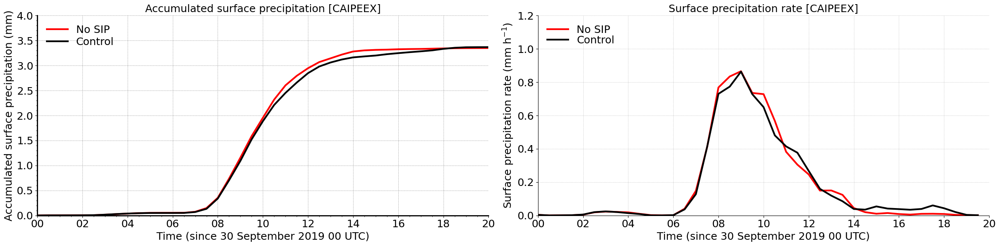

In [8]:


dt_hours = (ds_nosip.time.diff('time') / np.timedelta64(1, 'h'))


acc_precip_nosip = ds_nosip.tot_prec.mean('ncells')
acc_precip_4sip = ds_4sip.tot_prec.mean('ncells')

del_prec_nosip = ds_nosip.tot_prec.diff('time')
del_prec_4sip = ds_4sip.tot_prec.diff('time')

precip_rate_nosip = del_prec_nosip/dt_hours #0.5    # output is over 30 min
precip_rate_4sip = del_prec_4sip/dt_hours 



fnt=18
ln = 3
plt.figure(figsize=(24, 6))
plt.style.use('default')
plt.subplot(1,2,1)
plt.plot(ds_nosip.time, acc_precip_nosip, "-", color='r', label="No SIP", linewidth = ln)
plt.plot(ds_4sip.time, acc_precip_4sip, "k-", label="Control", linewidth = ln)

plt.grid(True, linestyle='--', color='grey', linewidth=0.5, alpha=0.8)
plt.minorticks_on()
plt.ylim(0, 4)
plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt)
plt.ylabel('Accumulated surface precipitation (mm)', fontsize=fnt)
start_date = datetime(2019, 9, 30, 0, 0)  # Start at 00 UTC on 10 May 2011
end_date = datetime(2019, 9, 30, 20, 0)
plt.xlim(start_date, end_date)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.title('Accumulated surface precipitation [CAIPEEX]', fontsize=fnt)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.2, fontsize=fnt, loc='upper left')#, ncol = 1, fontsize='16', bbox_to_anchor=(1.02, 1.02))
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_linewidth(2)
plt.gca().spines['left'].set_linewidth(2)

plt.subplot(1,2,2)
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(ds_nosip.time[:-1], precip_rate_nosip.mean('ncells'), '-', color='r', linewidth=ln, label='No SIP')
plt.plot(ds_4sip.time[:-1], precip_rate_4sip.mean('ncells'), 'k-', linewidth=ln, label='Control')

plt.ylim(0, 1.2)
plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt)
plt.ylabel('Surface precipitation rate (mm h$^{-1}$)', fontsize=fnt)
start_date = datetime(2019, 9, 30, 0, 0)  # Start at 00 UTC on 10 May 2011
end_date = datetime(2019, 9, 30, 20, 0)
plt.xlim(start_date, end_date)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.title('Surface precipitation rate [CAIPEEX]', fontsize=fnt)
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, loc='upper left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['right'].set_linewidth(3)
plt.gca().spines['right'].set_linewidth(3)

plt.tight_layout()
plt.show()


## Wind shear

In [9]:

du_4sip = ds_4sip.u.diff('height')
dv_4sip = ds_4sip.v.diff('height')
dz_4sip = -1.*ds_4sip.z_mc.diff('height')

wind_shear_4sip = np.sqrt(du_4sip**2. + dv_4sip**2.)/dz_4sip

du_nosip = ds_nosip.u.diff('height')
dv_nosip = ds_nosip.v.diff('height')
dz_nosip = -1.*ds_nosip.z_mc.diff('height')

wind_shear_nosip = np.sqrt(du_nosip**2. + dv_nosip**2.)/dz_nosip



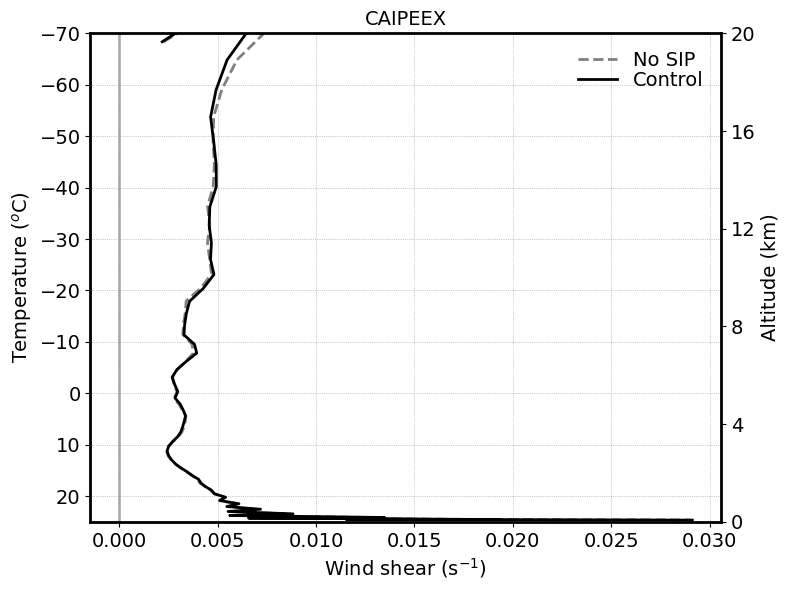

In [11]:

mean_wind_shear_4sip = wind_shear_4sip.mean(dim=('time', 'ncells'))
mean_wind_shear_nosip = wind_shear_nosip.mean(dim=('time', 'ncells'))

fontsize=14;
lnwdth=2;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_wind_shear_nosip, mean_tempc_nosip[:-1], '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_wind_shear_4sip, mean_tempc_4sip[:-1], 'k-', linewidth=lnwdth, label='Control')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(mean_wind_shear_nosip, mean_tempc_nosip[:-1], '-', color='none', linewidth=lnwdth)#, label='No SB')

#plt1.set_xlim(-0.01, 0)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([-4, -2, 0, 2, 4, 6, 8, 10])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Wind shear (s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('CAIPEEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.tight_layout()
plt.show()


In [61]:
ds_4sip.ddt_temp_radlw

<xarray.DataArray 'ddt_temp_radlw' (time: 41, height: 65, ncells: 68960)> Size: 735MB
dask.array<concatenate, shape=(41, 65, 68960), dtype=float32, chunksize=(1, 10, 68960), chunktype=numpy.ndarray>
Coordinates:
  * time     (time) datetime64[ns] 328B 2019-09-30 ... 2019-09-30T20:00:00
  * height   (height) float64 520B 1.0 2.0 3.0 4.0 5.0 ... 62.0 63.0 64.0 65.0
  * ncells   (ncells) int64 552kB 0 1 2 3 4 5 ... 68955 68956 68957 68958 68959
    clon     (ncells) float64 552kB dask.array<chunksize=(68960,), meta=np.ndarray>
    clat     (ncells) float64 552kB dask.array<chunksize=(68960,), meta=np.ndarray>
Attributes:
    standard_name:                ddt_temp_radlw
    long_name:                    long wave radiative temperature tendency
    units:                        K s-1
    param:                        192.5.0
    CDI_grid_type:                unstructured
    number_of_grid_in_reference:  1

## Freezing and homogeneous level

In [10]:
mask = (ds_4sip.tempc > -0.2) & (ds_4sip.tempc < 0.)
mean_freez_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_4sip.tempc > -38.5) & (ds_4sip.tempc < -37.5)
mean_hom_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))

mask = (ds_nosip.tempc > -0.2) & (ds_nosip.tempc < 0.)
mean_freez_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_nosip.tempc > -38.5) & (ds_nosip.tempc < -37.5)
mean_hom_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))

## SIP process rate

In [10]:


dt_hours = (ds_4sip.time.diff('time') / np.timedelta64(1, 'h'))

thres_q = 1.e-14;
thres_w = 1.;
thres_cond = (ds_4sip.dqi_sec > thres_q) & (ds_4sip.w_vel > thres_w)
mean_qni_tot_sec_4sip = (ds_4sip.dqni_sec.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_rf_4sip = (ds_4sip.dqni_ds.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_hm_4sip = (ds_4sip.dqni_rs.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_br_4sip = (ds_4sip.dqni_br.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_sb_snow_4sip = (ds_4sip.dqni_snow_sbf.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_sb_graup_4sip = (ds_4sip.dqni_graup_sbf.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_het_4sip = (ds_4sip.d_qni_het.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_sb_4sip = mean_qni_sb_snow_4sip + mean_qni_sb_graup_4sip

mean_qni_tot_sec_4sip = mean_qni_tot_sec_4sip/dt_hours.mean('time')
mean_qni_rf_4sip = mean_qni_rf_4sip/dt_hours.mean('time')
mean_qni_hm_4sip = mean_qni_hm_4sip/dt_hours.mean('time')
mean_qni_br_4sip = mean_qni_br_4sip/dt_hours.mean('time')
mean_qni_sb_snow_4sip = mean_qni_sb_snow_4sip/dt_hours.mean('time')
mean_qni_sb_graup_4sip = mean_qni_sb_graup_4sip/dt_hours.mean('time')
mean_qni_sb_4sip = mean_qni_sb_4sip/dt_hours.mean('time')
mean_qni_het_4sip = mean_qni_het_4sip/dt_hours.mean('time')


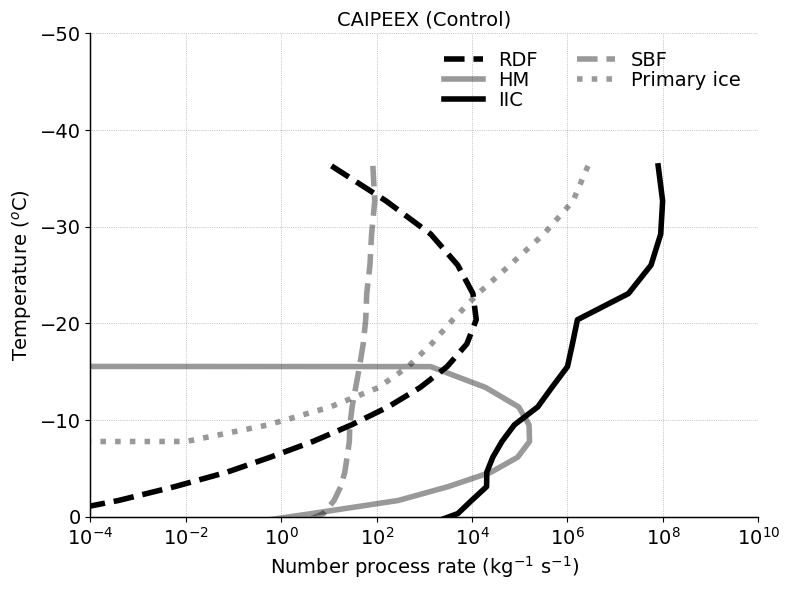

In [11]:

sort_idx = np.argsort(mean_tempc_4sip)
mean_tempc_4sip_sorted = mean_tempc_4sip[sort_idx]

sort_idx = np.argsort(mean_tempc_nosip)
mean_tempc_nosip_sorted = mean_tempc_nosip[sort_idx]

mean_qni_rf_4sip[mean_tempc_4sip_sorted < -40.] = np.nan
mean_qni_hm_4sip[mean_tempc_4sip_sorted < -40.] = np.nan
mean_qni_br_4sip[mean_tempc_4sip_sorted < -40.] = np.nan
mean_qni_sb_4sip[mean_tempc_4sip_sorted < -40.] = np.nan
mean_qni_het_4sip[mean_tempc_4sip_sorted < -40.] = np.nan


fontsize=14;
lnwdth=4;
alpha=0.6;
alp1=1;
alp1=1;
alp2=0.4;
alp2=0.4;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
#plt1.plot(mean_qni_rf_4sip*fact, mean_tempc_4sip, 'r-', linewidth=lnwdth, label='RDF')
#plt1.plot(mean_qni_hm_4sip*fact, mean_tempc_4sip, 'b-', linewidth=lnwdth, label='HM')
#plt1.plot(mean_qni_br_4sip*fact, mean_tempc_4sip, 'm-', linewidth=lnwdth, label='IIC')
#plt1.plot(mean_qni_sb_4sip*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='SBF')

plt1.plot(mean_qni_rf_4sip*fact, mean_tempc_4sip_sorted, '--', color='k', alpha=alp1, linewidth=lnwdth, label='RDF')
plt1.plot(mean_qni_hm_4sip*fact, mean_tempc_4sip_sorted, '-', color='k', alpha=alp2, linewidth=lnwdth, label='HM')
plt1.plot(mean_qni_br_4sip*fact, mean_tempc_4sip_sorted, '-', color='k', alpha=alp1, linewidth=lnwdth, label='IIC')
plt1.plot(mean_qni_sb_4sip*fact, mean_tempc_4sip_sorted, '--', color='k', alpha=alp2, linewidth=lnwdth, label='SBF')

plt1.plot(mean_qni_het_4sip*fact, mean_tempc_4sip_sorted, ':', color='k', alpha=alp2, linewidth=lnwdth, label='Primary ice')

#plt2.plot(mean_qni_tot_sec_4sip/dt_hours*fact, mean_tempc_4sip, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(0, -50)
#plt2.set_ylim(0.5, 14)
plt2.set_yticks([])

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
#plt1.set_yticks([0, -10, -20, -30, -40, -50, -60])
#plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
#plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Number process rate (kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
#plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, ncols=2, loc='best')

plt.title('CAIPEEX (Control)', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
plt1.spines['top'].set_visible(False)
plt1.spines['right'].set_visible(False)
plt2.spines['top'].set_visible(False)
plt2.spines['right'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


In [13]:
ds_4sip.time

<xarray.DataArray 'time' (time: 41)> Size: 328B
array(['2019-09-30T00:00:00.000000000', '2019-09-30T00:30:00.000000000',
       '2019-09-30T01:00:00.000000000', '2019-09-30T01:30:00.000000000',
       '2019-09-30T02:00:00.000000000', '2019-09-30T02:30:00.000000000',
       '2019-09-30T03:00:00.000000000', '2019-09-30T03:30:00.000000000',
       '2019-09-30T04:00:00.000000000', '2019-09-30T04:30:00.000000000',
       '2019-09-30T05:00:00.000000000', '2019-09-30T05:30:00.000000000',
       '2019-09-30T06:00:00.000000000', '2019-09-30T06:30:00.000000000',
       '2019-09-30T07:00:00.000000000', '2019-09-30T07:30:00.000000000',
       '2019-09-30T08:00:00.000000000', '2019-09-30T08:30:00.000000000',
       '2019-09-30T09:00:00.000000000', '2019-09-30T09:30:00.000000000',
       '2019-09-30T10:00:00.000000000', '2019-09-30T10:30:00.000000000',
       '2019-09-30T11:00:00.000000000', '2019-09-30T11:30:00.000000000',
       '2019-09-30T12:00:00.000000000', '2019-09-30T12:30:00.000000000',
       '2019-09-30T13:00:00.000000000', '2019-09-30T13:30:00.000000000',
       '2019-09-30T14:00:00.000000000', '2019-09-30T14:30:00.000000000',
       '2019-09-30T15:00:00.000000000', '2019-09-30T15:30:00.000000000',
       '2019-09-30T16:00:00.000000000', '2019-09-30T16:30:00.000000000',
       '2019-09-30T17:00:00.000000000', '2019-09-30T17:30:00.000000000',
       '2019-09-30T18:00:00.000000000', '2019-09-30T18:30:00.000000000',
       '2019-09-30T19:00:00.000000000', '2019-09-30T19:30:00.000000000',
       '2019-09-30T20:00:00.000000000'], dtype='datetime64[ns]')
Coordinates:
  * time     (time) datetime64[ns] 328B 2019-09-30 ... 2019-09-30T20:00:00

## Microphysical properties

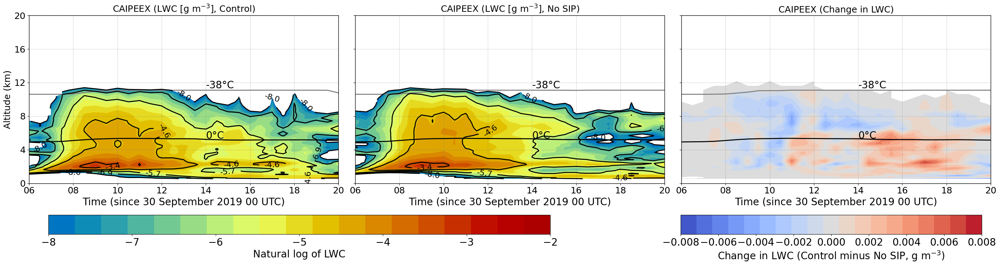

In [19]:

import matplotlib.lines as mlines
mean_lwc_4sip = ds_4sip.lwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_lwc_nosip = ds_nosip.lwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_del_lwc_4sip_nosip = mean_lwc_4sip-mean_lwc_nosip

mean_lwc_4sip = mean_lwc_4sip.where(mean_lwc_4sip != 0., np.nan)
mean_lwc_nosip = mean_lwc_nosip.where(mean_lwc_nosip != 0., np.nan)
mean_del_lwc_4sip_nosip = mean_del_lwc_4sip_nosip.where(mean_del_lwc_4sip_nosip != 0., np.nan)

mean_tiwc_4sip = ds_4sip.tiwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_tiwc_nosip = ds_nosip.tiwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_del_tiwc_4sip_nosip = mean_tiwc_4sip-mean_tiwc_nosip

mean_tiwc_4sip = mean_tiwc_4sip.where(mean_tiwc_4sip != 0., np.nan)
mean_tiwc_nosip = mean_tiwc_nosip.where(mean_tiwc_nosip != 0., np.nan)
mean_del_tiwc_4sip_nosip = mean_del_tiwc_4sip_nosip.where(mean_del_tiwc_4sip_nosip != 0., np.nan)

fnt=18;
fnt1=18;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-8, -2, 20)
#lev1 = np.linspace(0, 0.04, 20)
lev2 = np.linspace(-0.008, 0.008, 20)

plt.figure(figsize=(28, 6))
plt.style.use('default')

plt.subplot(1,3,1)
cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(mean_lwc_4sip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_4sip.time, mean_ht_4sip, mean_lwc_4sip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-10, -8, -6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[28], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[28], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 6, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (LWC [g m$^{-3}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-8, 0, 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(mean_lwc_4sip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)
cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_lwc_nosip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_lwc_nosip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[28], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[28], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 6, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (LWC [g m$^{-3}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-8, 0, 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(mean_lwc_nosip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax1 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax1 = fig.add_axes([0.05, -0.1, 0.5, 0.09])
cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[-8, -7, -6, -5, -4, -3, -2, -1, 0, 1, 2], orientation='horizontal')
#cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[0, 0.01, 0.02, 0.03, 0.04], orientation='horizontal')
cbar.set_label('Natural log of LWC', fontsize=fnt+2)
#cbar.set_label('LWC (g m$^{-3}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)

plt.subplot(1,3,3)
#cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_del_lwc_4sip_nosip.T), levels=lev2, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_del_lwc_4sip_nosip.T, levels=lev2, cmap='coolwarm')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[28], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[28], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 6, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (Change in LWC)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


#contour_levels = np.linspace(-8, 0, 8)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.lwc_gperm3.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax2 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax2 = fig.add_axes([0.68, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
#cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-8, -6, -4, -2, 0], orientation='horizontal')
cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-0.008, -0.006, -0.004, -0.002, 0, 0.002, 0.004, 0.006, 0.008], orientation='horizontal')
#cbar.set_label('Natural log of change in LWC', fontsize=fnt+2)
cbar.set_label('Change in LWC (Control minus No SIP, g m$^{-3}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)


plt.tight_layout()
plt.show()


2025-11-17 13:47:24,988 - distributed.worker.state_machine - WARNING - Async instruction for <Task cancelled name="execute(('open_dataset-qg-concatenate-e2a7a804e035a978ef5baafba909ccd8', 4, 6, 0))" coro=<Worker.execute() done, defined at /home/b/b382718/own_env/lib/python3.9/site-packages/distributed/worker_state_machine.py:3615>> ended with CancelledError
2025-11-17 13:47:24,988 - distributed.worker.state_machine - WARNING - Async instruction for <Task cancelled name="execute(('open_dataset-qh-concatenate-1fd406067cb51078941215cc5fce5f5c', 4, 6, 0))" coro=<Worker.execute() done, defined at /home/b/b382718/own_env/lib/python3.9/site-packages/distributed/worker_state_machine.py:3615>> ended with CancelledError
2025-11-17 13:47:24,988 - distributed.worker.state_machine - WARNING - Async instruction for <Task cancelled name="execute(('open_dataset-qg-concatenate-e2a7a804e035a978ef5baafba909ccd8', 4, 5, 0))" coro=<Worker.execute() done, defined at /home/b/b382718/own_env/lib/python3.9/sit

KeyboardInterrupt: 

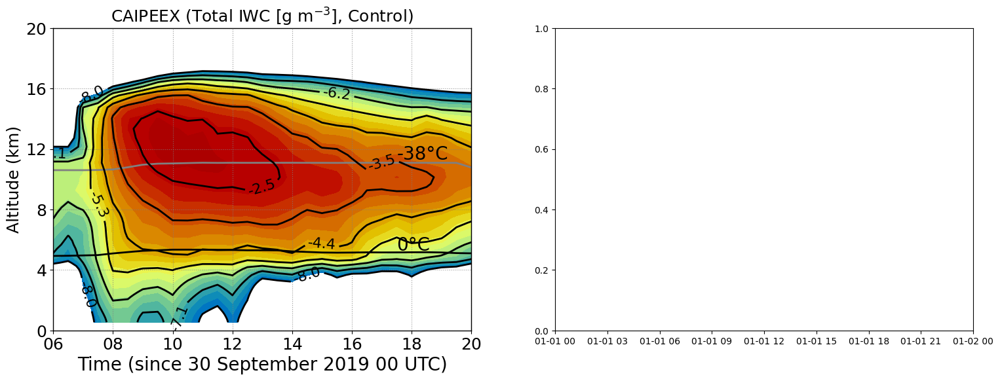

In [20]:

import matplotlib.lines as mlines
mean_lwc_4sip = ds_4sip.lwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_lwc_nosip = ds_nosip.lwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_del_lwc_4sip_nosip = mean_lwc_4sip-mean_lwc_nosip

mean_lwc_4sip = mean_lwc_4sip.where(mean_lwc_4sip != 0., np.nan)
mean_lwc_nosip = mean_lwc_nosip.where(mean_lwc_nosip != 0., np.nan)
mean_del_lwc_4sip_nosip = mean_del_lwc_4sip_nosip.where(mean_del_lwc_4sip_nosip != 0., np.nan)

mean_tiwc_4sip = ds_4sip.tiwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_tiwc_nosip = ds_nosip.tiwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_del_tiwc_4sip_nosip = mean_tiwc_4sip-mean_tiwc_nosip

#mean_tiwc_4sip = mean_tiwc_4sip.where(mean_tiwc_4sip > 0.00001, np.nan)
#mean_tiwc_nosip = mean_tiwc_nosip.where(mean_tiwc_nosip > 0.00001, np.nan)
mean_del_tiwc_4sip_nosip = mean_del_tiwc_4sip_nosip.where(mean_del_tiwc_4sip_nosip != 0., np.nan)

fnt=18;
fnt1=18;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-8, -2, 20)
#lev1 = np.linspace(0, 0.1, 20)
#lev2 = np.linspace(0.0001, 0.03, 20)
lev2 = np.linspace(-0.03, 0.03, 20)

plt.figure(figsize=(28, 6))
plt.style.use('default')

plt.subplot(1,3,1)
cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(mean_tiwc_4sip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_4sip.time, mean_ht_4sip, mean_tiwc_4sip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-10, -8, -6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[35], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[35], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 6, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (Total IWC [g m$^{-3}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-8, 2, 12)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(mean_tiwc_4sip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)
cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_tiwc_nosip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_tiwc_nosip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[35], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[35], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 6, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (Total IWC [g m$^{-3}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-8, 2, 12)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(mean_tiwc_nosip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax1 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax1 = fig.add_axes([0.05, -0.1, 0.5, 0.09])
cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[-8, -7, -6, -5, -4, -3, -2, -1, 0, 1, 2], orientation='horizontal')
#cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[0, 0.02, 0.04, 0.06, 0.08, 0.1], orientation='horizontal')
cbar.set_label('Natural log of LWC', fontsize=fnt+2)
#cbar.set_label('Total IWC (g m$^{-3}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)

plt.subplot(1,3,3)
#cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_del_lwc_4sip_nosip.T), levels=lev2, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_del_tiwc_4sip_nosip.T, levels=lev2, cmap='coolwarm')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[35], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[35], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 6, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (Change in total IWC)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


#contour_levels = np.linspace(-8, 0, 8)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.lwc_gperm3.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax2 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax2 = fig.add_axes([0.68, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
#cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-8, -6, -4, -2, 0], orientation='horizontal')
cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-0.03, -0.02, -0.01, 0, 0.01, 0.02, 0.03], orientation='horizontal')
#cbar.set_label('Natural log of change in LWC', fontsize=fnt+2)
cbar.set_label('Change in total IWC (Control minus No SIP, g m$^{-3}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)


plt.tight_layout()
plt.show()


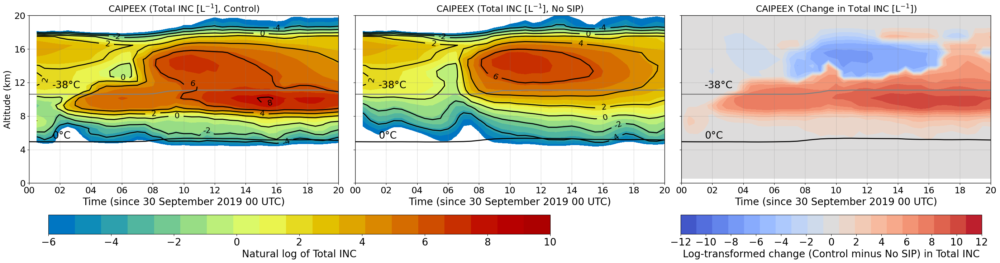

In [32]:

import matplotlib.lines as mlines


## Transformed-log-scale to handle negative values
def signed_log(x, scale=0.1):
    return np.sign(x) * np.log1p(np.abs(x) / scale)


mean_tinc_4sip = ds_4sip.inc_perl.mean(dim=('ncells'), skipna=True)
mean_tinc_nosip = ds_nosip.inc_perl.mean(dim=('ncells'), skipna=True)
mean_del_tinc_4sip_nosip = mean_tinc_4sip-mean_tinc_nosip

mean_tinc_4sip = mean_tinc_4sip.where(mean_tinc_4sip != 0., np.nan)
mean_tinc_nosip = mean_tinc_nosip.where(mean_tinc_nosip != 0., np.nan)
#mean_del_tinc_4sip_nosip = mean_del_tinc_4sip_nosip.where(mean_del_tinc_4sip_nosip != 0., np.nan)


fnt=18;
fnt1=18;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-6, 10, 20)
#lev1 = np.linspace(0, 0.1, 20)
lev2 = np.linspace(-12, 12, 20)

plt.figure(figsize=(28, 6))
plt.style.use('default')

plt.subplot(1,3,1)
cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(mean_tinc_4sip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, mean_lwc_4sip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-10, -8, -6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[3], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (Total INC [L$^{-1}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-4, 10, 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(mean_tinc_4sip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)
cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_tinc_nosip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_lwc_nosip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[3], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (Total INC [L$^{-1}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-4, 10, 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(mean_tinc_nosip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax1 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax1 = fig.add_axes([0.05, -0.1, 0.5, 0.09])
#cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[-8, -7, -6, -5, -4, -3, -2, -1, 0, 1, 2], orientation='horizontal')
cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[-6, -4, -2, 0, 2, 4, 6, 8, 10], orientation='horizontal')
#cbar.set_label('Natural log of total INC', fontsize=fnt+2)
cbar.set_label('Natural log of Total INC', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)

plt.subplot(1,3,3)
cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, signed_log(mean_del_tinc_4sip_nosip.T), levels=lev2, cmap='coolwarm')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_del_tinc_4sip_nosip.T, levels=lev2, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[3], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (Change in Total INC [L$^{-1}$])', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


#contour_levels = np.linspace(-6, 10, 8)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(mean_del_tinc_4sip_nosip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax2 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax2 = fig.add_axes([0.68, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
#cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-8, -6, -4, -2, 0], orientation='horizontal')
cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-12, -10, -8, -6, -4, -2, 0, 2, 4, 6, 8, 10, 12], orientation='horizontal')
#cbar.set_label('Natural log of change in LWC', fontsize=fnt+2)
cbar.set_label('Log-transformed change (Control minus No SIP) in Total INC', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)


plt.tight_layout()
plt.show()


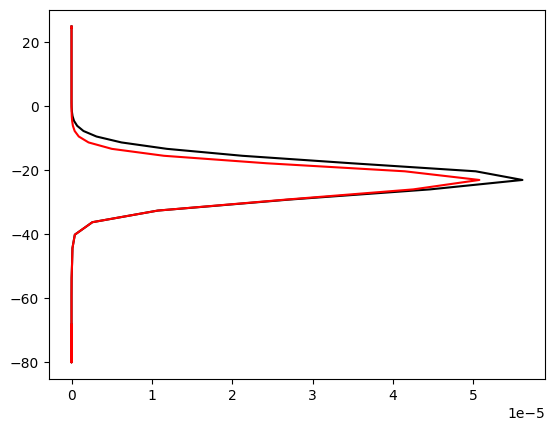

In [14]:
mean_dqr_rf = ds_4sip.d_qr_rf.mean(dim=('time','ncells'))
mean_dqri_rf = (ds_4sip.d_qi_rf + ds_4sip.d_qg_rf).mean(dim=('time','ncells'))
plt.plot(mean_dqr_rf, mean_tempc_4sip, 'k-')
plt.plot(mean_dqri_rf, mean_tempc_4sip, 'r-')

In [12]:
ds_4sip

<xarray.Dataset> Size: 87GB
Dimensions:             (time: 41, ncells: 68960, vertices: 3, height: 65,
                         bnds: 2, plev: 1, plev_2: 1, plev_3: 1, height_2: 66)
Coordinates:
  * time                (time) datetime64[ns] 328B 2019-09-30 ... 2019-09-30T...
    clon                (ncells) float64 552kB dask.array<chunksize=(68960,), meta=np.ndarray>
    clat                (ncells) float64 552kB dask.array<chunksize=(68960,), meta=np.ndarray>
  * height              (height) float64 520B 1.0 2.0 3.0 4.0 ... 63.0 64.0 65.0
  * height_2            (height_2) float64 528B 1.0 2.0 3.0 ... 64.0 65.0 66.0
  * plev                (plev) float64 8B 800.0
  * plev_2              (plev_2) float64 8B 400.0
  * plev_3              (plev_3) float64 8B 0.0
Dimensions without coordinates: ncells, vertices, bnds
Data variables: (12/149)
    clon_bnds           (time, ncells, vertices) float64 68MB dask.array<chunksize=(1, 68960, 3), meta=np.ndarray>
    clat_bnds           (time, ncells, vertices) float64 68MB dask.array<chunksize=(1, 68960, 3), meta=np.ndarray>
    height_bnds         (time, height, bnds) float64 43kB dask.array<chunksize=(1, 10, 2), meta=np.ndarray>
    plev_bnds           (time, plev, bnds) float64 656B dask.array<chunksize=(1, 1, 2), meta=np.ndarray>
    plev_2_bnds         (time, plev_2, bnds) float64 656B dask.array<chunksize=(1, 1, 2), meta=np.ndarray>
    plev_3_bnds         (time, plev_3, bnds) float64 656B dask.array<chunksize=(1, 1, 2), meta=np.ndarray>
    ...                  ...
    twc_gperm3          (time, height, ncells) float32 735MB dask.array<chunksize=(1, 10, 68960), meta=np.ndarray>
    cdnc_percm3         (time, height, ncells) float32 735MB dask.array<chunksize=(1, 10, 68960), meta=np.ndarray>
    inc_perl            (time, height, ncells) float32 735MB dask.array<chunksize=(1, 10, 68960), meta=np.ndarray>
    inp_perl            (time, height, ncells) float32 735MB dask.array<chunksize=(1, 10, 68960), meta=np.ndarray>
    inc_sip_perl        (time, height, ncells) float32 735MB dask.array<chunksize=(1, 10, 68960), meta=np.ndarray>
    z_ifc               (time, height_2, ncells) float32 746MB dask.array<chunksize=(41, 10, 68960), meta=np.ndarray>
Attributes:
    CDI:                  Climate Data Interface version 2.4.0 (https://mpime...
    Conventions:          CF-1.6
    number_of_grid_used:  99
    uuidOfHGrid:          3eb4f381-adbd-e79a-b32f-6e1ff3ba2860
    uuidOfVGrid:          acbf7b33-d4a3-b631-6ecd-012f775e2bc0
    institution:          Max Planck Institute for Meteorology/Deutscher Wett...
    title:                ICON simulation
    source:               version: 2024.10; revision: 6f8e58b4040c0905b72f63e...
    history:              /home/b/b382718/continental_cases/phil_ds_julian/ic...
    references:           see MPIM/DWD publications
    comment:              Deepak Waman (b382718) on l50310 (Linux 4.18.0-513....

## Latent heat

In [ ]:

### OLD formula, which is wrong as:
## d_qr_rf == d_qi_rf + d_qs_rf + d_qg_rf + d_qh_rf
## d_qsgh_evap =/ d_qs_evap + d_qg_evap + d_qh_evap

#tot_latent_heating_4sip = ((lh_v/cv_m_4sip)*(ds_4sip.d_qc_nuc) + # condensation
#                       (lh_s/cv_m_4sip) * (ds_4sip.d_qi_dep + ds_4sip.d_qs_dep + ds_4sip.d_qg_dep + ds_4sip.d_qh_dep) + # deposition
#                       (lh_f/cv_m_4sip) * (ds_4sip.d_qc_rime_i + ds_4sip.d_qr_rime_i + ds_4sip.d_qc_rime_s + ds_4sip.d_qr_rime_s +
#                                     ds_4sip.d_qc_rime_gh + ds_4sip.d_qr_rime_gh) + # riming
#                       (lh_v/cv_m_4sip) * (ds_4sip.d_satad+ds_4sip.d_satad2) + # saturation adjustment
#                       (lh_s/cv_m_4sip) * (ds_4sip.d_qi_homhet) +
#                       (lh_f/cv_m_4sip) * (ds_4sip.d_qi_hom + ds_4sip.d_qr_rf + ds_4sip.d_qi_rf + 
#                                      ds_4sip.d_qg_rf + ds_4sip.d_qh_rf) +                     # freezing
#                       (-1.*lh_v/cv_m_4sip) * (ds_4sip.d_qr_evap + ds_4sip.d_qsgh_evap) +  # evaporation
#                       (-1.*lh_f/cv_m_4sip) * (ds_4sip.d_qr_melt + ds_4sip.d_qc_melt)      # melting
#                      )

In [17]:


r_d   = 287.;
cp_d  = 1004.64;
cv_d  = cp_d-r_d;
lh_v  = 2.5008e6;
lh_s  = 2.8345e6;
lh_f  = lh_s - lh_v;

q_vap_4sip = ds_4sip.qv;
cv_m_4sip  = cv_d*(1. + 0.97*q_vap_4sip);

# d_qr_rf == d_qi_rf + d_qs_rf + d_qg_rf + d_qh_rf
# d_qsgh_evap =/ d_qs_evap + d_qg_evap + d_qh_evap

## Components of latent heating (freezing, condensation, riming, nucleation, saturation adjustment)
tot_latent_heating_4sip = ((lh_v/cv_m_4sip)*(ds_4sip.d_qc_nuc) + # condensation
                       (lh_s/cv_m_4sip) * (ds_4sip.d_qi_dep + ds_4sip.d_qs_dep + ds_4sip.d_qg_dep + ds_4sip.d_qh_dep) + # deposition
                       (lh_f/cv_m_4sip) * (ds_4sip.d_qc_rime_i + ds_4sip.d_qr_rime_i + ds_4sip.d_qc_rime_s + ds_4sip.d_qr_rime_s +
                                     ds_4sip.d_qc_rime_gh + ds_4sip.d_qr_rime_gh) + # riming
                       (lh_v/cv_m_4sip) * (ds_4sip.d_satad+ds_4sip.d_satad2) + # saturation adjustment
                       (lh_s/cv_m_4sip) * (ds_4sip.d_qi_homhet) +
                       (lh_f/cv_m_4sip) * (ds_4sip.d_qi_hom + ds_4sip.d_qr_rf) +                     # freezing
                       (-1.*lh_v/cv_m_4sip) * (ds_4sip.d_qr_evap + ds_4sip.d_qs_evap + ds_4sip.d_qg_evap + ds_4sip.d_qh_evap) +  # evaporation
                       (-1.*lh_f/cv_m_4sip) * (ds_4sip.d_qr_melt + ds_4sip.d_qc_melt)      # melting
                      )

cond_latent_heat_4sip = (lh_v/cv_m_4sip)*(ds_4sip.d_qc_nuc) 
dep_latent_heat_4sip  = (lh_s/cv_m_4sip) * (ds_4sip.d_qi_dep + ds_4sip.d_qs_dep + ds_4sip.d_qg_dep + ds_4sip.d_qh_dep)
rime_latent_heat_4sip = (lh_f/cv_m_4sip) * (ds_4sip.d_qc_rime_i + ds_4sip.d_qr_rime_i + ds_4sip.d_qc_rime_s + 
                                            ds_4sip.d_qr_rime_s + ds_4sip.d_qc_rime_gh + ds_4sip.d_qr_rime_gh)
satad_latent_heat_4sip = (lh_v/cv_m_4sip) * (ds_4sip.d_satad+ds_4sip.d_satad2)
homhet_latent_heat_4sip = (lh_s/cv_m_4sip) * (ds_4sip.d_qi_homhet)
rain_freez_latent_heat_4sip = (lh_f/cv_m_4sip) * (ds_4sip.d_qi_hom + ds_4sip.d_qr_rf)
evap_latent_heat_4sip = (-1.*lh_v/cv_m_4sip) * (ds_4sip.d_qr_evap + ds_4sip.d_qs_evap + ds_4sip.d_qg_evap + ds_4sip.d_qh_evap)
melt_latent_heat_4sip = (-1.*lh_f/cv_m_4sip) * (ds_4sip.d_qr_melt + ds_4sip.d_qc_melt)

## Total latent heating
tot_latent_heating_kpers_4sip = (1./1800.) * np.gradient(tot_latent_heating_4sip, axis=0) # w.r.t. time
tot_latent_heating_kperd_4sip = tot_latent_heating_kpers_4sip * 86400.
mean_tot_latent_heating_kperd_4sip = np.mean(tot_latent_heating_kperd_4sip, axis=(0,2))
ds_4sip['tot_lhr_kperd'] = (ds_4sip.tempc.dims, tot_latent_heating_kperd_4sip)


## LHR condensation
cond_latent_heat_kpers_4sip = (1./1800.) * np.gradient(cond_latent_heat_4sip, axis=0) # w.r.t. time
cond_latent_heat_kperd_4sip = cond_latent_heat_kpers_4sip * 86400.
mean_cond_latent_heat_kperd_4sip = np.mean(cond_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['cond_lhr_kperd'] = (ds_4sip.tempc.dims, cond_latent_heat_kperd_4sip)

## LHR deposition
dep_latent_heat_kpers_4sip = (1./1800.) * np.gradient(dep_latent_heat_4sip, axis=0) # w.r.t. time
dep_latent_heat_kperd_4sip = dep_latent_heat_kpers_4sip * 86400.
mean_dep_latent_heat_kperd_4sip = np.mean(dep_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['dep_lhr_kperd'] = (ds_4sip.tempc.dims, dep_latent_heat_kperd_4sip)

## LHR riming
rime_latent_heat_kpers_4sip = (1./1800.) * np.gradient(rime_latent_heat_4sip, axis=0) # w.r.t. time
rime_latent_heat_kperd_4sip = rime_latent_heat_kpers_4sip * 86400.
mean_rime_latent_heat_kperd_4sip = np.mean(rime_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['rime_lhr_kperd'] = (ds_4sip.tempc.dims, rime_latent_heat_kperd_4sip)

## LHR saturation adjustment
satad_latent_heat_kpers_4sip = (1./1800.) * np.gradient(satad_latent_heat_4sip, axis=0) # w.r.t. time
satad_latent_heat_kperd_4sip = satad_latent_heat_kpers_4sip * 86400.
mean_satad_latent_heat_kperd_4sip = np.mean(satad_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['satad_lhr_kperd'] = (ds_4sip.tempc.dims, satad_latent_heat_kperd_4sip)

## LHR homhet
homhet_latent_heat_kpers_4sip = (1./1800.) * np.gradient(homhet_latent_heat_4sip, axis=0) # w.r.t. time
homhet_latent_heat_kperd_4sip = homhet_latent_heat_kpers_4sip * 86400.
mean_homhet_latent_heat_kperd_4sip = np.mean(homhet_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['homhet_lhr_kperd'] = (ds_4sip.tempc.dims, homhet_latent_heat_kperd_4sip)

## LHR rain freezing (homogeneously, and to snow, graupel, hail)
rain_freez_latent_heat_kpers_4sip = (1./1800.) * np.gradient(rain_freez_latent_heat_4sip, axis=0) # w.r.t. time
rain_freez_latent_heat_kperd_4sip = rain_freez_latent_heat_kpers_4sip * 86400.
mean_rain_freez_latent_heat_kperd_4sip = np.mean(rain_freez_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['rainfreez_lhr_kperd'] = (ds_4sip.tempc.dims, rain_freez_latent_heat_kperd_4sip)

## LHR evaporation
evap_latent_heat_kpers_4sip = (1./1800.) * np.gradient(evap_latent_heat_4sip, axis=0) # w.r.t. time
evap_latent_heat_kperd_4sip = evap_latent_heat_kpers_4sip * 86400.
mean_evap_latent_heat_kperd_4sip = np.mean(evap_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['evap_lhr_kperd'] = (ds_4sip.tempc.dims, evap_latent_heat_kperd_4sip)

## LHR melting
melt_latent_heat_kpers_4sip = (1./1800.) * np.gradient(melt_latent_heat_4sip, axis=0) # w.r.t. time
melt_latent_heat_kperd_4sip = melt_latent_heat_kpers_4sip * 86400.
mean_melt_latent_heat_kperd_4sip = np.mean(melt_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['melt_lhr_kperd'] = (ds_4sip.tempc.dims, melt_latent_heat_kperd_4sip)



In [18]:
r_d   = 287.;
cp_d  = 1004.64;
cv_d  = cp_d-r_d;
lh_v  = 2.5008e6;
lh_s  = 2.8345e6;
lh_f  = lh_s - lh_v;

q_vap_nosip = ds_nosip.qv;
cv_m_nosip  = cv_d*(1. + 0.97*q_vap_nosip);

# d_qr_rf == d_qi_rf + d_qs_rf + d_qg_rf + d_qh_rf
# d_qsgh_evap =/ d_qs_evap + d_qg_evap + d_qh_evap

## Components of latent heating (freezing, condensation, riming, nucleation, saturation adjustment)
tot_latent_heating_nosip = ((lh_v/cv_m_nosip)*(ds_nosip.d_qc_nuc) + # condensation
                       (lh_s/cv_m_nosip) * (ds_nosip.d_qi_dep + ds_nosip.d_qs_dep + ds_nosip.d_qg_dep + ds_nosip.d_qh_dep) + # deposition
                       (lh_f/cv_m_nosip) * (ds_nosip.d_qc_rime_i + ds_nosip.d_qr_rime_i + ds_nosip.d_qc_rime_s + ds_nosip.d_qr_rime_s +
                                     ds_nosip.d_qc_rime_gh + ds_nosip.d_qr_rime_gh) + # riming
                       (lh_v/cv_m_nosip) * (ds_nosip.d_satad+ds_nosip.d_satad2) + # saturation adjustment
                       (lh_s/cv_m_nosip) * (ds_nosip.d_qi_homhet) +
                       (lh_f/cv_m_nosip) * (ds_nosip.d_qi_hom + ds_nosip.d_qr_rf) +                     # freezing
                       (-1.*lh_v/cv_m_nosip) * (ds_nosip.d_qr_evap + ds_nosip.d_qs_evap + ds_nosip.d_qg_evap + ds_nosip.d_qh_evap) +  # evaporation
                       (-1.*lh_f/cv_m_nosip) * (ds_nosip.d_qr_melt + ds_nosip.d_qc_melt)      # melting
                      )

cond_latent_heat_nosip = (lh_v/cv_m_nosip)*(ds_nosip.d_qc_nuc)
dep_latent_heat_nosip  = (lh_s/cv_m_nosip) * (ds_nosip.d_qi_dep + ds_nosip.d_qs_dep + ds_nosip.d_qg_dep + ds_nosip.d_qh_dep)
rime_latent_heat_nosip = (lh_f/cv_m_nosip) * (ds_nosip.d_qc_rime_i + ds_nosip.d_qr_rime_i + ds_nosip.d_qc_rime_s +
                                            ds_nosip.d_qr_rime_s + ds_nosip.d_qc_rime_gh + ds_nosip.d_qr_rime_gh)
satad_latent_heat_nosip = (lh_v/cv_m_nosip) * (ds_nosip.d_satad+ds_nosip.d_satad2)
homhet_latent_heat_nosip = (lh_s/cv_m_nosip) * (ds_nosip.d_qi_homhet)
rain_freez_latent_heat_nosip = (lh_f/cv_m_nosip) * (ds_nosip.d_qi_hom + ds_nosip.d_qr_rf)
evap_latent_heat_nosip = (-1.*lh_v/cv_m_nosip) * (ds_nosip.d_qr_evap + ds_nosip.d_qs_evap + ds_nosip.d_qg_evap + ds_nosip.d_qh_evap)
melt_latent_heat_nosip = (-1.*lh_f/cv_m_nosip) * (ds_nosip.d_qr_melt + ds_nosip.d_qc_melt)

## Total latent heating
tot_latent_heating_kpers_nosip = (1./1800.) * np.gradient(tot_latent_heating_nosip, axis=0) # w.r.t. time
tot_latent_heating_kperd_nosip = tot_latent_heating_kpers_nosip * 86400.
mean_tot_latent_heating_kperd_nosip = np.mean(tot_latent_heating_kperd_nosip, axis=(0,2))
ds_nosip['tot_lhr_kperd'] = (ds_nosip.tempc.dims, tot_latent_heating_kperd_nosip)


## LHR condensation
cond_latent_heat_kpers_nosip = (1./1800.) * np.gradient(cond_latent_heat_nosip, axis=0) # w.r.t. time
cond_latent_heat_kperd_nosip = cond_latent_heat_kpers_nosip * 86400.
mean_cond_latent_heat_kperd_nosip = np.mean(cond_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['cond_lhr_kperd'] = (ds_nosip.tempc.dims, cond_latent_heat_kperd_nosip)

## LHR deposition
dep_latent_heat_kpers_nosip = (1./1800.) * np.gradient(dep_latent_heat_nosip, axis=0) # w.r.t. time
dep_latent_heat_kperd_nosip = dep_latent_heat_kpers_nosip * 86400.
mean_dep_latent_heat_kperd_nosip = np.mean(dep_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['dep_lhr_kperd'] = (ds_nosip.tempc.dims, dep_latent_heat_kperd_nosip)

## LHR riming
rime_latent_heat_kpers_nosip = (1./1800.) * np.gradient(rime_latent_heat_nosip, axis=0) # w.r.t. time
rime_latent_heat_kperd_nosip = rime_latent_heat_kpers_nosip * 86400.
mean_rime_latent_heat_kperd_nosip = np.mean(rime_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['rime_lhr_kperd'] = (ds_nosip.tempc.dims, rime_latent_heat_kperd_nosip)

## LHR saturation adjustment
satad_latent_heat_kpers_nosip = (1./1800.) * np.gradient(satad_latent_heat_nosip, axis=0) # w.r.t. time
satad_latent_heat_kperd_nosip = satad_latent_heat_kpers_nosip * 86400.
mean_satad_latent_heat_kperd_nosip = np.mean(satad_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['satad_lhr_kperd'] = (ds_nosip.tempc.dims, satad_latent_heat_kperd_nosip)

## LHR homhet
homhet_latent_heat_kpers_nosip = (1./1800.) * np.gradient(homhet_latent_heat_nosip, axis=0) # w.r.t. time
homhet_latent_heat_kperd_nosip = homhet_latent_heat_kpers_nosip * 86400.
mean_homhet_latent_heat_kperd_nosip = np.mean(homhet_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['homhet_lhr_kperd'] = (ds_nosip.tempc.dims, homhet_latent_heat_kperd_nosip)

## LHR rain freezing (homogeneously, and to snow, graupel, hail)
rain_freez_latent_heat_kpers_nosip = (1./1800.) * np.gradient(rain_freez_latent_heat_nosip, axis=0) # w.r.t. time
rain_freez_latent_heat_kperd_nosip = rain_freez_latent_heat_kpers_nosip * 86400.
mean_rain_freez_latent_heat_kperd_nosip = np.mean(rain_freez_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['rainfreez_lhr_kperd'] = (ds_nosip.tempc.dims, rain_freez_latent_heat_kperd_nosip)

## LHR evaporation
evap_latent_heat_kpers_nosip = (1./1800.) * np.gradient(evap_latent_heat_nosip, axis=0) # w.r.t. time
evap_latent_heat_kperd_nosip = evap_latent_heat_kpers_nosip * 86400.
mean_evap_latent_heat_kperd_nosip = np.mean(evap_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['evap_lhr_kperd'] = (ds_nosip.tempc.dims, evap_latent_heat_kperd_nosip)

## LHR melting
melt_latent_heat_kpers_nosip = (1./1800.) * np.gradient(melt_latent_heat_nosip, axis=0) # w.r.t. time
melt_latent_heat_kperd_nosip = melt_latent_heat_kpers_nosip * 86400.
mean_melt_latent_heat_kperd_nosip = np.mean(melt_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['melt_lhr_kperd'] = (ds_nosip.tempc.dims, melt_latent_heat_kperd_nosip)


In [19]:



#==================================================================================================
mean_tot_lhr_kperd_4sip = ds_4sip.tot_lhr_kperd.mean(dim=('time','ncells')).values
mean_cond_lhr_kperd_4sip = ds_4sip.cond_lhr_kperd.mean(dim=('time','ncells')).values
mean_satad_lhr_kperd_4sip = ds_4sip.satad_lhr_kperd.mean(dim=('time','ncells')).values
mean_dep_lhr_kperd_4sip = ds_4sip.dep_lhr_kperd.mean(dim=('time','ncells')).values
mean_rime_lhr_kperd_4sip = ds_4sip.rime_lhr_kperd.mean(dim=('time','ncells')).values
mean_rainfreez_lhr_kperd_4sip = ds_4sip.rainfreez_lhr_kperd.mean(dim=('time','ncells')).values
mean_homhet_lhr_kperd_4sip = ds_4sip.homhet_lhr_kperd.mean(dim=('time','ncells'))
mean_melt_evap_lhr_kperd_4sip = (ds_4sip.melt_lhr_kperd.mean(dim=('time','ncells')).values + 
                                 ds_4sip.evap_lhr_kperd.mean(dim=('time','ncells')).values)

mean_tot_lhr_kperd_nosip = ds_nosip.tot_lhr_kperd.mean(dim=('time','ncells')).values
mean_cond_lhr_kperd_nosip = ds_nosip.cond_lhr_kperd.mean(dim=('time','ncells')).values
mean_satad_lhr_kperd_nosip = ds_nosip.satad_lhr_kperd.mean(dim=('time','ncells')).values
mean_dep_lhr_kperd_nosip = ds_nosip.dep_lhr_kperd.mean(dim=('time','ncells')).values
mean_rime_lhr_kperd_nosip = ds_nosip.rime_lhr_kperd.mean(dim=('time','ncells')).values
mean_rainfreez_lhr_kperd_nosip = ds_nosip.rainfreez_lhr_kperd.mean(dim=('time','ncells')).values
mean_homhet_lhr_kperd_nosip = ds_nosip.homhet_lhr_kperd.mean(dim=('time','ncells'))
mean_melt_evap_lhr_kperd_nosip = (ds_nosip.melt_lhr_kperd.mean(dim=('time','ncells')).values + 
                                  ds_nosip.evap_lhr_kperd.mean(dim=('time','ncells')).values)
#==================================================================================================

del_lhr_kperd_nosip = mean_tot_lhr_kperd_4sip-mean_tot_lhr_kperd_nosip

per_del_lhr_kperd_nosip = 100*(del_lhr_kperd_nosip)/mean_tot_lhr_kperd_4sip


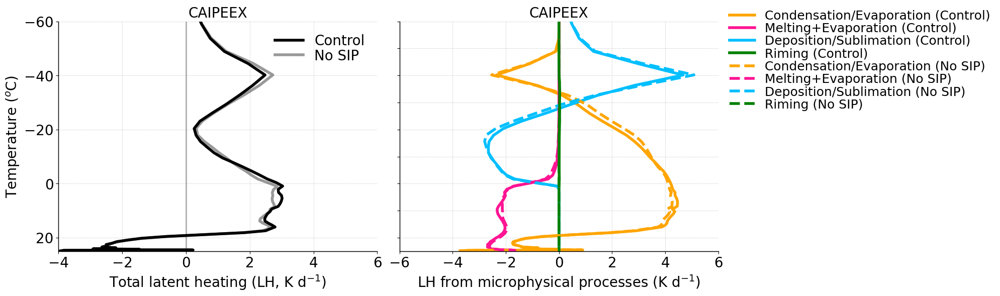

In [20]:
sort_idx = np.argsort(mean_tempc_4sip)
mean_tempc_4sip_sorted = mean_tempc_4sip[sort_idx]

sort_idx = np.argsort(mean_tempc_nosip)
mean_tempc_nosip_sorted = mean_tempc_nosip[sort_idx]

fontsize=20;
lnwdth=4;
alpha=0.8;
alp1=1.0;
alp2=0.4; 

plt.figure(figsize=(20, 6))
plt.style.use('default')

plt.subplot(1,2,1)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_lhr_kperd_4sip, mean_tempc_4sip_sorted, 'k-', linewidth=lnwdth, alpha=alp1, label='Control')
plt1.plot(mean_tot_lhr_kperd_nosip, mean_tempc_nosip_sorted, 'k-', alpha=alp2, linewidth=lnwdth, label='No SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(mean_tot_lhr_kperd_nosip, mean_ht_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(-4, 6)
plt1.set_ylim(25, -60)
plt2.set_ylim(0., 14)

plt1.set_xticks([-4, -2, 0, 2, 4, 6])
#plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)
plt2.yaxis.set_ticklabels([])
plt2.set_yticks([])

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Total latent heating (LH, K d$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
#plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('CAIPEEX', fontsize=fontsize)


plt1.spines['top'].set_linewidth(1)
plt1.spines['top'].set_visible(False)
plt1.spines['right'].set_visible(False)
plt2.spines['top'].set_visible(False)
plt2.spines['right'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.subplot(1,2,2)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_satad_lhr_kperd_4sip, mean_tempc_4sip_sorted, '-', color='orange', linewidth=lnwdth, label='Condensation/Evaporation (Control)')
plt1.plot(mean_melt_evap_lhr_kperd_4sip, mean_tempc_4sip_sorted, '-', color='deeppink', linewidth=lnwdth, label='Melting+Evaporation (Control)')
plt1.plot(mean_dep_lhr_kperd_4sip, mean_tempc_4sip_sorted, '-', color='deepskyblue', linewidth=lnwdth, label='Deposition/Sublimation (Control)')
plt1.plot(mean_rime_lhr_kperd_4sip, mean_tempc_4sip_sorted, '-', color='green', linewidth=lnwdth, label='Riming (Control)')
#plt1.plot(mean_cond_lhr_kperd_4sip, mean_tempc_4sip_sorted, 'g-', linewidth=lnwdth, label='CCN activation (Control)')

plt1.plot(mean_satad_lhr_kperd_nosip, mean_tempc_nosip_sorted, '--', color='orange', linewidth=lnwdth, label='Condensation/Evaporation (No SIP)')
plt1.plot(mean_melt_evap_lhr_kperd_nosip, mean_tempc_nosip_sorted, '--', color='deeppink', linewidth=lnwdth, label='Melting+Evaporation (No SIP)')
plt1.plot(mean_dep_lhr_kperd_nosip, mean_tempc_nosip_sorted, '--', color='deepskyblue', linewidth=lnwdth, label='Deposition/Sublimation (No SIP)')
plt1.plot(mean_rime_lhr_kperd_nosip, mean_tempc_nosip_sorted, '--', color='green', linewidth=lnwdth, label='Riming (No SIP)')
#plt1.plot(mean_cond_lhr_kperd_nosip, mean_tempc_nosip_sorted, 'g--', linewidth=lnwdth, label='CCN activation (No SIP)')

plt2.plot(mean_cond_lhr_kperd_4sip, mean_ht_4sip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-6., 6)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

plt1.set_xticks([-6, -4, -2, 0, 2, 4, 6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

#plt1.set_yticks([])
#plt1.set_gca().axes.xaxis.set_ticklabels([])
plt1.yaxis.set_ticklabels([])
plt2.yaxis.set_ticklabels([])
plt2.set_yticks([])

#plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize-2, bbox_to_anchor=[1.0, 1.10], ncols=1, loc='best')

plt1.set_xlabel('LH from microphysical processes (K d$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
#plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('CAIPEEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
plt1.spines['top'].set_visible(False)
plt1.spines['right'].set_visible(False)
plt2.spines['top'].set_visible(False)
plt2.spines['right'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


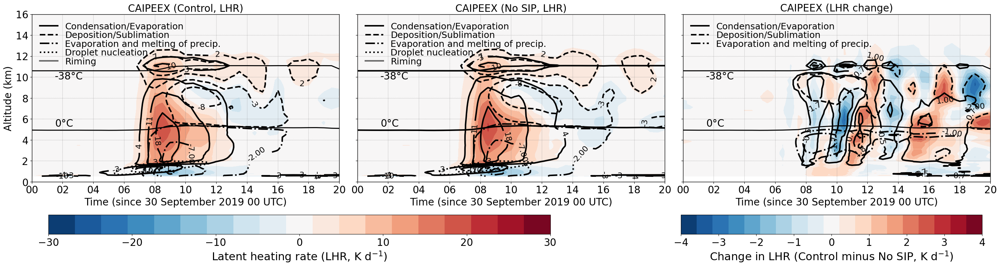

In [21]:

import matplotlib.lines as mlines
import matplotlib.gridspec as gridspec


del_mean_tot_lhr_time_ht = ds_4sip.tot_lhr_kperd.mean(dim=('ncells'))-ds_nosip.tot_lhr_kperd.mean(dim=('ncells'))
del_mean_satad_lhr_time_ht = ds_4sip.satad_lhr_kperd.mean(dim=('ncells'))-ds_nosip.satad_lhr_kperd.mean(dim=('ncells'))
del_mean_cond_lhr_time_ht = ds_4sip.cond_lhr_kperd.mean(dim=('ncells'))-ds_nosip.cond_lhr_kperd.mean(dim=('ncells'))
del_mean_rime_lhr_time_ht = ds_4sip.rime_lhr_kperd.mean(dim=('ncells'))-ds_nosip.rime_lhr_kperd.mean(dim=('ncells'))
del_mean_dep_lhr_time_ht = ds_4sip.dep_lhr_kperd.mean(dim=('ncells'))-ds_nosip.dep_lhr_kperd.mean(dim=('ncells'))
del_mean_evap_melt_lhr_time_ht = ((ds_4sip.evap_lhr_kperd.mean(dim=('ncells'))+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')))-
                              ds_nosip.evap_lhr_kperd.mean(dim=('ncells'))+ds_nosip.melt_lhr_kperd.mean(dim=('ncells')))

fnt=18;
fnt1=18;
ln=2;
ln1=2.0;
ln2=3.0;
alp1=0.3;

lev1 = np.linspace(-30, 30, 20)
lev2 = np.linspace(-0.2, 0.2, 20)
lev3=np.linspace(-4, 4, 20)

plt.figure(figsize=(28, 6))
plt.style.use('default')

plt.subplot(1,3,1)
cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, ds_4sip.tot_lhr_kperd.mean(dim=('ncells')).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)#darkorchid
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='k', linewidth=ln)#grey

plt.text(ds_4sip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[3], 9.8, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt+2)
plt.title('CAIPEEX (Control, LHR)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-10, 20.5, 7)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln2, label='Condensation/Evaporation')#Saturation adjustment')


contour_levels = np.arange(-8, 10.5, 5)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='k', linestyle='--', linewidth=ln2, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 5)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.evap_lhr_kperd.mean(dim=('ncells')).T+ds_nosip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='k', linestyles='-.', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='k', linestyle='-.', linewidth=ln2, label='Evaporation and melting of precip.')

contour_levels = np.arange(-0.1, 12.5, 4)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles=':', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy4 = mlines.Line2D([], [], color='k', linestyle=':', linewidth=ln2, label='Droplet nucleation')

contour_levels = np.arange(-0.1, 2.5, 0.8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dimgray', linestyles='-', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dimgray', linestyle='-', linewidth=ln2, label='Riming')


plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, handlelength=2, labelspacing=0.02, 
           ncols=1, loc='upper left')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)
cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_nosip.tot_lhr_kperd.mean(dim=('ncells')).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln+1)#darkorchid
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='k', linewidth=ln+1)#grey

plt.text(ds_nosip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[3], 9.8, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (No SIP, LHR)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-10, 20.5, 7)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln2, label='Condensation/Evaporation')#Saturation adjustment')


contour_levels = np.arange(-8, 10.5, 5)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='k', linestyle='--', linewidth=ln2, label='Deposition/Sublimation')


contour_levels = np.arange(-12, 0., 5)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.evap_lhr_kperd.mean(dim=('ncells')).T+ds_nosip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='k', linestyles='-.', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='k', linestyle='-.', linewidth=ln2, label='Evaporation and melting of precip.')

contour_levels = np.arange(-0.1, 12.5, 4)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles=':', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy4 = mlines.Line2D([], [], color='k', linestyle=':', linewidth=ln2, label='Droplet nucleation')

contour_levels = np.arange(-0.1, 2.5, 0.8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dimgray', linestyles='-', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dimgray', linestyle='-', linewidth=ln2, label='Riming')


plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, handlelength=2, labelspacing=0.02, 
           ncols=1, loc='upper left')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()
#cbar_ax1 = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar_ax1 = fig.add_axes([0.05, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar1 = fig.colorbar(cnt2, cax=cbar_ax1, orientation='horizontal', ticks=[-30, -20, -10, 0, 10, 20, 30])
cbar1.set_label('Latent heating rate (LHR, K d$^{-1}$)', fontsize=fnt+4)
cbar1.ax.tick_params(labelsize=fnt+2)


plt.subplot(1,3,3)

cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, del_mean_tot_lhr_time_ht.T, levels=lev3, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='k', linewidth=ln)

plt.text(ds_4sip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[3], 9.8, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (LHR change)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-4, 3, 7) #np.arange(-2, 3, 3) #np.arange(-2, 2, 1.2) #np.arange(-6.5, 6.5, 4.5)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_satad_lhr_time_ht.T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%3.1f')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln2, label='Condensation/Evaporation')


contour_levels = np.arange(-2, 2, 3)# np.linspace(-2, 2, 4) #np.arange(-8.5, 8.5, 3.)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_dep_lhr_time_ht.T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy2 = mlines.Line2D([], [], color='k', linestyle='--', linewidth=ln2, label='Deposition/Sublimation')

contour_levels = np.arange(-2, -0.5, 1)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_evap_melt_lhr_time_ht.T, 
                       levels=contour_levels, colors='k', linestyles='-.', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='k', linestyle='-.', linewidth=ln2, label='Evaporation and melting of precip.')

#contour_levels = np.arange(-0.5, 0.5, 0.4)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_cond_lhr_time_ht.T, levels=contour_levels, colors='k', linestyles=':', linewidths=ln2)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

#legend_proxy4 = mlines.Line2D([], [], color='k', linestyle=':', linewidth=ln2, label='CCN nucleation')

#contour_levels = np.arange(-0.8, 0.8, 0.7)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_rime_lhr_time_ht.T, levels=contour_levels, colors='dimgray', linestyles='-', linewidths=ln2)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

#legend_proxy5 = mlines.Line2D([], [], color='dimgray', linestyle='-', linewidth=ln2, label='Riming')


#plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, handlelength=2, labelspacing=0.05, 
#           ncols=1, loc='upper left')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3], frameon=False, fontsize=fnt, handlelength=2, labelspacing=0.02, 
           ncols=1, loc='upper left')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()
#cbar_ax2 = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar_ax2 = fig.add_axes([0.68, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
cbar3 = fig.colorbar(cnt3, cax=cbar_ax2, orientation='horizontal', ticks=[-4, -3, -2, -1, 0, 1, 2, 3, 4])
cbar3.set_label('Change in LHR (Control minus No SIP, K d$^{-1}$)', fontsize=fnt+4)
cbar3.ax.tick_params(labelsize=fnt+2)

plt.tight_layout()
plt.show()


## Cloud radiative heating rates (CRH)

In [9]:
#============ CRH calculation

#Source: https://github.com/aikovoigt/nawdex-hackathon/blob/master/postprocessing/calc_heatingrates.py

def calc_heatingrates(ds):
    # expected input: xarray dataset that besides the radiative fluxes contains height at interface levels, air density and specific humidity
    # specific heat at constant volume for dry air and water vapor
    pcd = 1004.64 - 287.04
    pcv = 1869.46 - 461.51

    
    #z_ifc = 
    # geometric thickness of full levels, label='lower' for xr.diff is important for correct result
    dz_full = -1*ds['z_mc'].diff(dim='height', n=1, label='lower').rename('dz_full')#.rename({'height_ifc': 'height'})
    #dz_full = -1*ds['z_ifc'].diff(dim='height_ifc', n=1, label='upper').rename('dz_full').rename({'height_2': 'height'})
    # mass of air
    pmair = ds['rho'] * dz_full
    # conversion factor for flux divergence to heating rate
    zconv = 1.0/(pmair*(pcd+(pcv-pcd)*ds['qv']))
    # calculate radiative heating rates from radiative fluxes, use "\_fromflux" to indicate that these were from fluxes
    ds['ddt_temp_radsw_fromflux'] = ( 
        -1*ds['swflxall'].diff(dim='height_2', n=1, label='lower').rename({'height_2':'height'})*zconv )
    ds['ddt_temp_radlw_fromflux'] = ( 
        -1*ds['lwflxall'].diff(dim='height_2', n=1, label='lower').rename({'height_2':'height'})*zconv )
    ds['ddt_temp_radswclr_fromflux'] = ( 
        -1*ds['swflxclr'].diff(dim='height_2', n=1, label='lower').rename({'height_2':'height'})*zconv )
    ds['ddt_temp_radlwclr_fromflux'] = ( 
        -1*ds['lwflxclr'].diff(dim='height_2', n=1, label='lower').rename({'height_2':'height'})*zconv )

    # Total radiative temperature tendency (clr+cld)
    ds['ddt_temp_radtot_fromflux'] = (ds['ddt_temp_radsw_fromflux'] + ds['ddt_temp_radlw_fromflux'])

    # Clear-sky radiative temperature tendency (clr)
    ds['ddt_temp_radtot_clr_fromflux'] = (ds['ddt_temp_radswclr_fromflux'] + ds['ddt_temp_radlwclr_fromflux'])

    # Net Cloud-radiative heating
    ds['total_crh'] = ((ds['ddt_temp_radsw_fromflux'] + ds['ddt_temp_radlw_fromflux']) -
                       (ds['ddt_temp_radswclr_fromflux'] + ds['ddt_temp_radlwclr_fromflux']))

    # SW Cloud-radiative heating
    ds['crh_sw'] = ds['ddt_temp_radsw_fromflux'] - ds['ddt_temp_radswclr_fromflux']
    # Net Cloud-radiative heating
    ds['crh_lw'] = ds['ddt_temp_radlw_fromflux'] - ds['ddt_temp_radlwclr_fromflux']
    
    return ds




In [10]:
# Net radiative flux (Net flux) = downward − upward
# Total radiative tendency = SW + LW

#toa_sw_cre_4sip = (toa_sw_dn_4sip-toa_sw_up_4sip) - (toa_sw_dn_clr_4sip-toa_sw_up_clr_4sip)

ds_4sip['swflxall'] = ds_4sip.swflx_dn - ds_4sip.swflx_up
ds_4sip['swflxclr'] = ds_4sip.swflx_dn_clr - ds_4sip.swflx_up_clr
ds_4sip['lwflxall'] = ds_4sip.lwflx_dn - ds_4sip.lwflx_up
ds_4sip['lwflxclr'] = ds_4sip.lwflx_dn_clr - ds_4sip.lwflx_up_clr

ds_4sip['tot_rad_ddt_temp'] = ds_4sip.ddt_temp_radlw + ds_4sip.ddt_temp_radsw

ds_nosip['swflxall'] = ds_nosip.swflx_dn - ds_nosip.swflx_up
ds_nosip['swflxclr'] = ds_nosip.swflx_dn_clr - ds_nosip.swflx_up_clr
ds_nosip['lwflxall'] = ds_nosip.lwflx_dn - ds_nosip.lwflx_up
ds_nosip['lwflxclr'] = ds_nosip.lwflx_dn_clr - ds_nosip.lwflx_up_clr


ds_nosip['tot_rad_ddt_temp'] = ds_nosip.ddt_temp_radlw + ds_nosip.ddt_temp_radsw

ds_4sip = calc_heatingrates(ds_4sip)
ds_nosip = calc_heatingrates(ds_nosip)




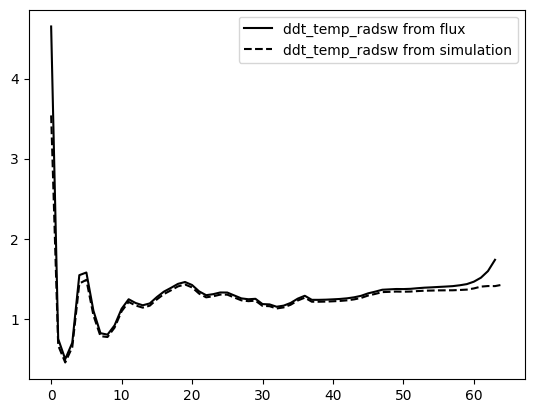

In [93]:
plt.plot(86400*ds_4sip.ddt_temp_radsw_fromflux.mean(dim=('time','ncells')), 'k-', label='ddt_temp_radsw from flux')
#plt.plot(86400*ds_4sip.ddt_temp_radswclr_fromflux.mean(dim=('time','ncells')), 'k-.', label='ddt_temp_radsw clr from flux')
plt.plot(86400*ds_4sip.ddt_temp_radsw.mean(dim=('time','ncells')), 'k--', label='ddt_temp_radsw from simulation')
plt.legend()

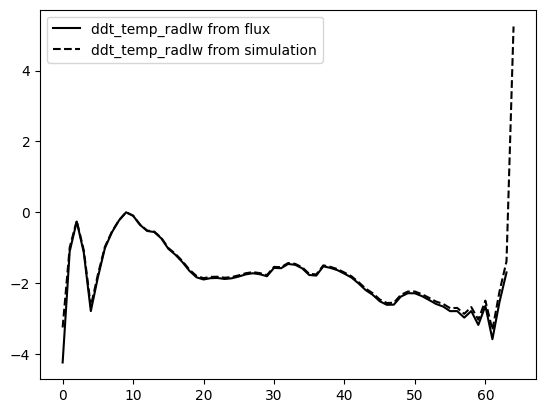

In [98]:
plt.plot(86400*ds_4sip.ddt_temp_radlw_fromflux.mean(dim=('time','ncells')), 'k-', label='ddt_temp_radlw from flux')
#plt.plot(86400*ds_4sip.ddt_temp_radlwclr_fromflux.mean(dim=('time','ncells')), 'k-.', label='ddt_temp_radlw clr from flux')
plt.plot(86400*ds_4sip.ddt_temp_radlw.mean(dim=('time','ncells')), 'k--', label='ddt_temp_radlw from simulation')
plt.legend()

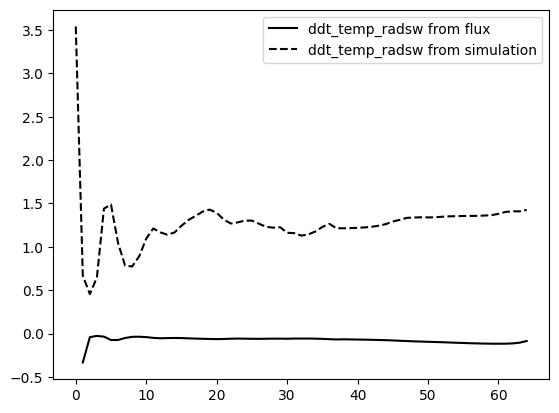

In [87]:
plt.plot(86400*ds_4sip.ddt_temp_radsw_fromflux.mean(dim=('time','ncells')), 'k-', label='ddt_temp_radsw from flux')
#plt.plot(86400*ds_4sip.ddt_temp_radswclr_fromflux.mean(dim=('time','ncells')), 'k-.', label='ddt_temp_radsw clr from flux')
plt.plot(86400*ds_4sip.ddt_temp_radsw.mean(dim=('time','ncells')), 'k--', label='ddt_temp_radsw from simulation')

#plt.plot(86400*ds_4sip.ddt_temp_radlw_fromflux.mean(dim=('time','ncells')), 'r-', label='ddt_temp_radlw from flux')
#plt.plot(86400*ds_4sip.ddt_temp_radlwclr_fromflux.mean(dim=('time','ncells')), 'r-.', label='ddt_temp_radlw clr from flux')
#plt.plot(86400*ds_4sip.ddt_temp_radlw.mean(dim=('time','ncells')), 'r--', label='ddt_temp_radlw from simulation')
plt.legend()

In [11]:

mean_tot_crh_kperd_4sip = 86400*ds_4sip.total_crh.mean(dim=('time','ncells')).values # K/s to K/d
mean_tot_crh_kperd_nosip = 86400*ds_nosip.total_crh.mean(dim=('time','ncells')).values

mean_sw_crh_kperd_4sip = 86400*ds_4sip.crh_sw.mean(dim=('time','ncells')).values # K/s to K/d
mean_sw_crh_kperd_nosip = 86400*ds_nosip.crh_sw.mean(dim=('time','ncells')).values

mean_lw_crh_kperd_4sip = 86400*ds_4sip.crh_lw.mean(dim=('time','ncells')).values # K/s to K/d
mean_lw_crh_kperd_nosip = 86400*ds_nosip.crh_lw.mean(dim=('time','ncells')).values

std_tot_crh_kperd_4sip = 86400 * ds_4sip.total_crh.std(dim=('time', 'ncells')).values
std_tot_crh_kperd_nosip = 86400 * ds_nosip.total_crh.std(dim=('time', 'ncells')).values

n_count = ds_4sip.sizes['time'] * ds_4sip.sizes['ncells'] 
se_tot_crh_kperd_4sip = 86400 * (std_tot_crh_kperd_4sip / np.sqrt(n_count))#.values
se_tot_crh_kperd_nosip = 86400 * (std_tot_crh_kperd_nosip / np.sqrt(n_count))#.values


/home/b/b382718/own_env/lib/python3.9/site-packages/dask/array/numpy_compat.py:56: RuntimeWarning: invalid value encountered in divide
  x = np.divide(x1, x2, out)


In [95]:

se_tot_crh_kperd_4sip = 86400 * (std_tot_crh_kperd_4sip / np.sqrt(n_count))#.values
se_tot_crh_kperd_nosip = 86400 * (std_tot_crh_kperd_nosip / np.sqrt(n_count))#.values

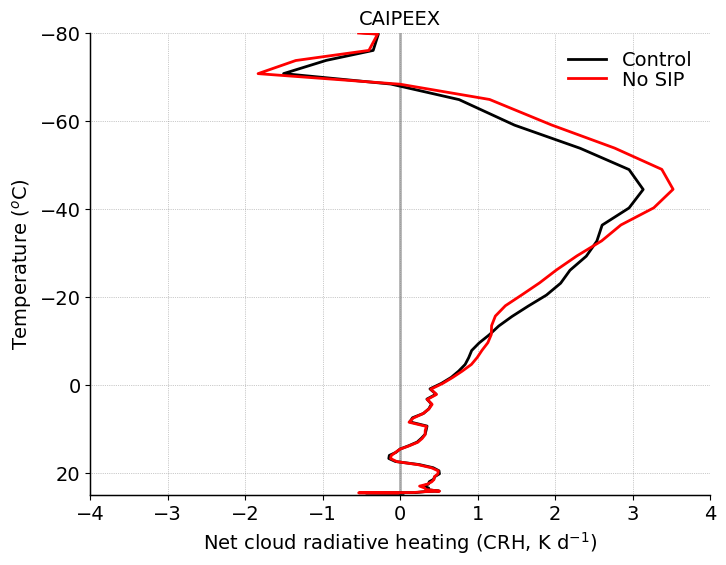

In [24]:
sort_idx = np.argsort(mean_tempc_4sip)
mean_tempc_4sip_sorted = mean_tempc_4sip[sort_idx]
mean_tot_crh_kperd_4sip_sorted = mean_tot_crh_kperd_4sip[sort_idx]

# Sort No SIP by temperature
sort_idx = np.argsort(mean_tempc_nosip)
mean_tempc_nosip_sorted = mean_tempc_nosip[sort_idx]
mean_tot_crh_kperd_nosip_sorted = mean_tot_crh_kperd_nosip[sort_idx]


fnt=14;
lnwdth=2;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_crh_kperd_4sip, mean_tempc_4sip_sorted, 'k-', linewidth=lnwdth, label='Control')
#plt1.plot(mean_sw_crh_kperd_4sip, mean_tempc_4sip_sorted, 'k--', linewidth=lnwdth, label='Control')
#plt1.plot(mean_lw_crh_kperd_4sip, mean_tempc_4sip_sorted, 'k-.', linewidth=lnwdth, label='Control')
plt1.plot(mean_tot_crh_kperd_nosip, mean_tempc_nosip_sorted, 'r-', linewidth=lnwdth, label='No SIP')
#plt1.plot(mean_sw_crh_kperd_nosip, mean_tempc_nosip_sorted, 'r--', linewidth=lnwdth, label='No SIP')
#plt1.plot(mean_lw_crh_kperd_nosip, mean_tempc_nosip_sorted, 'r-.', linewidth=lnwdth, label='No SIP')

#plt1.errorbar(mean_tot_crh_kperd_4sip, mean_tempc_4sip, yerr=std_tot_crh_kperd_4sip)

#plt1.fill_betweenx(mean_tempc_4sip, (mean_tot_crh_kperd_4sip-std_tot_crh_kperd_4sip),(mean_tot_crh_kperd_4sip+std_tot_crh_kperd_4sip), color='k', alpha=0.2)
#plt1.fill_betweenx(mean_tempc_nosip, (mean_tempc_nosip-std_tot_crh_kperd_nosip), (mean_tempc_nosip+std_tot_crh_kperd_nosip), color='r', alpha=0.2)#, label='ICON $\pm$ 1 STD DEV')
                 
plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(mean_tot_crh_kperd_4sip, mean_ht_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(-4, 4)
plt1.set_ylim(25, -80)
plt2.set_ylim(0, 14)

#plt1.set_xticks([-2, -1, 0, 1, 2, 3, 4])
#plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70, -80])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])
plt2.set_yticks([])

plt1.tick_params(axis='x', labelsize=fnt)
plt1.tick_params(axis='y', labelsize=fnt)
plt2.tick_params(axis='y', labelsize=fnt)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, loc='best')

plt1.set_xlabel('Net cloud radiative heating (CRH, K d$^{-1}$)', fontsize=fnt)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fnt)
#plt2.set_ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX', fontsize=fnt)

plt1.spines['top'].set_linewidth(1)
plt1.spines['top'].set_visible(False)
plt1.spines['right'].set_visible(False)
plt2.spines['top'].set_visible(False)
plt2.spines['right'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.show()

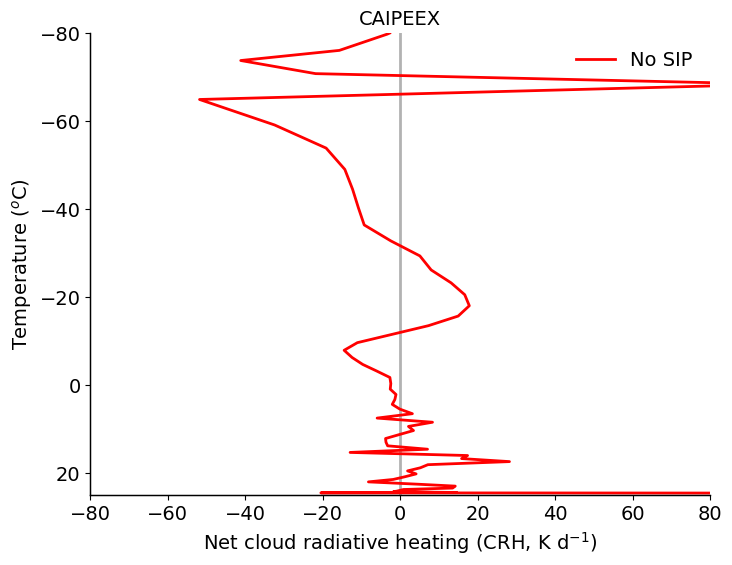

In [34]:
sort_idx = np.argsort(mean_tempc_4sip)
mean_tempc_4sip_sorted = mean_tempc_4sip[sort_idx]
mean_tot_crh_kperd_4sip_sorted = mean_tot_crh_kperd_4sip[sort_idx]

# Sort No SIP by temperature
sort_idx = np.argsort(mean_tempc_nosip)
mean_tempc_nosip_sorted = mean_tempc_nosip[sort_idx]
mean_tot_crh_kperd_nosip_sorted = mean_tot_crh_kperd_nosip[sort_idx]


fnt=14;
lnwdth=2;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
#plt1.plot(mean_tot_crh_kperd_4sip, mean_tempc_4sip_sorted, 'k-', linewidth=lnwdth, label='Control')
#plt1.plot(mean_tot_crh_kperd_nosip, mean_tempc_nosip_sorted, 'r-', linewidth=lnwdth, label='No SIP')
plt1.plot(100*(mean_tot_crh_kperd_4sip-mean_tot_crh_kperd_nosip)/mean_tot_crh_kperd_4sip, mean_tempc_nosip_sorted, 'r-', linewidth=lnwdth, label='No SIP')


plt1.set_xlim(-80, 80)
plt1.set_ylim(25, -80)
plt2.set_ylim(0, 14)

#plt1.set_xticks([-2, -1, 0, 1, 2, 3, 4])
#plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70, -80])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])
plt2.set_yticks([])

plt1.tick_params(axis='x', labelsize=fnt)
plt1.tick_params(axis='y', labelsize=fnt)
plt2.tick_params(axis='y', labelsize=fnt)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, loc='best')

plt1.set_xlabel('Net cloud radiative heating (CRH, K d$^{-1}$)', fontsize=fnt)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fnt)
#plt2.set_ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX', fontsize=fnt)

plt1.spines['top'].set_linewidth(1)
plt1.spines['top'].set_visible(False)
plt1.spines['right'].set_visible(False)
plt2.spines['top'].set_visible(False)
plt2.spines['right'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.show()

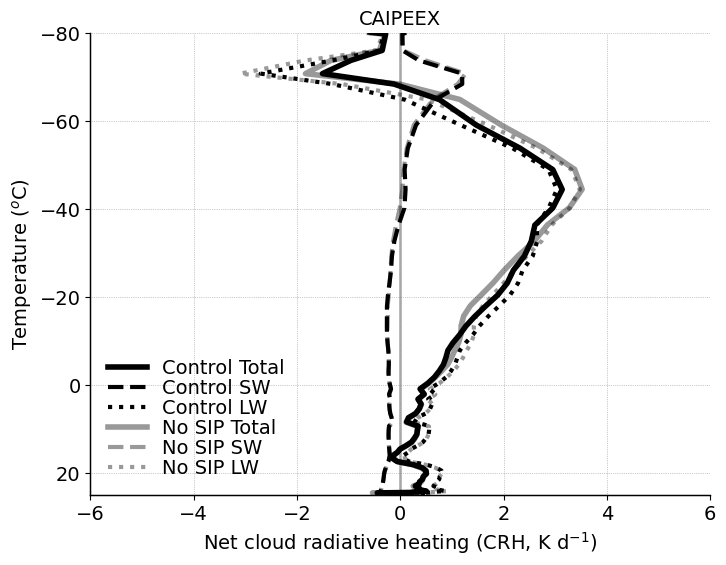

In [17]:
sort_idx = np.argsort(mean_tempc_4sip)
mean_tempc_4sip_sorted = mean_tempc_4sip[sort_idx]
mean_tot_crh_kperd_4sip_sorted = mean_tot_crh_kperd_4sip[sort_idx]

# Sort No SIP by temperature
sort_idx = np.argsort(mean_tempc_nosip)
mean_tempc_nosip_sorted = mean_tempc_nosip[sort_idx]
mean_tot_crh_kperd_nosip_sorted = mean_tot_crh_kperd_nosip[sort_idx]


fnt=14;
lnwdth=4;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')

#plt.subplot(1,2,1)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_crh_kperd_4sip, mean_tempc_4sip_sorted, 'k-', linewidth=lnwdth, label='Control Total')
plt1.plot(mean_sw_crh_kperd_4sip, mean_tempc_4sip_sorted, '--', color='k', linewidth=lnwdth-1, label='Control SW ')
plt1.plot(mean_lw_crh_kperd_4sip, mean_tempc_4sip_sorted, ':', color='k', linewidth=lnwdth-1, label='Control LW')
plt1.plot(mean_tot_crh_kperd_nosip, mean_tempc_nosip_sorted, 'k-', linewidth=lnwdth, alpha=0.4, label='No SIP Total')
plt1.plot(mean_sw_crh_kperd_nosip, mean_tempc_nosip_sorted, '--', color='k', linewidth=lnwdth-1, alpha=0.4, label='No SIP SW')
plt1.plot(mean_lw_crh_kperd_nosip, mean_tempc_nosip_sorted, ':', color='k', linewidth=lnwdth-1, alpha=0.4, label='No SIP LW')

#plt1.errorbar(mean_tot_crh_kperd_4sip, mean_tempc_4sip, yerr=std_tot_crh_kperd_4sip)

#plt1.fill_betweenx(mean_tempc_4sip, (mean_tot_crh_kperd_4sip-std_tot_crh_kperd_4sip),(mean_tot_crh_kperd_4sip+std_tot_crh_kperd_4sip), color='k', alpha=0.2)
#plt1.fill_betweenx(mean_tempc_nosip, (mean_tempc_nosip-std_tot_crh_kperd_nosip), (mean_tempc_nosip+std_tot_crh_kperd_nosip), color='r', alpha=0.2)#, label='ICON $\pm$ 1 STD DEV')
                 
plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(mean_tot_crh_kperd_4sip, mean_ht_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(-6, 6)
plt1.set_ylim(25, -80)
plt2.set_ylim(0, 14)

#plt1.set_xticks([-2, -1, 0, 1, 2, 3, 4])
#plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70, -80])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])
plt2.set_yticks([])

plt1.tick_params(axis='x', labelsize=fnt)
plt1.tick_params(axis='y', labelsize=fnt)
plt2.tick_params(axis='y', labelsize=fnt)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, loc='best')

plt1.set_xlabel('Net cloud radiative heating (CRH, K d$^{-1}$)', fontsize=fnt)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fnt)
#plt2.set_ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX', fontsize=fnt)

plt1.spines['top'].set_linewidth(1)
plt1.spines['top'].set_visible(False)
plt1.spines['right'].set_visible(False)
plt2.spines['top'].set_visible(False)
plt2.spines['right'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.show()

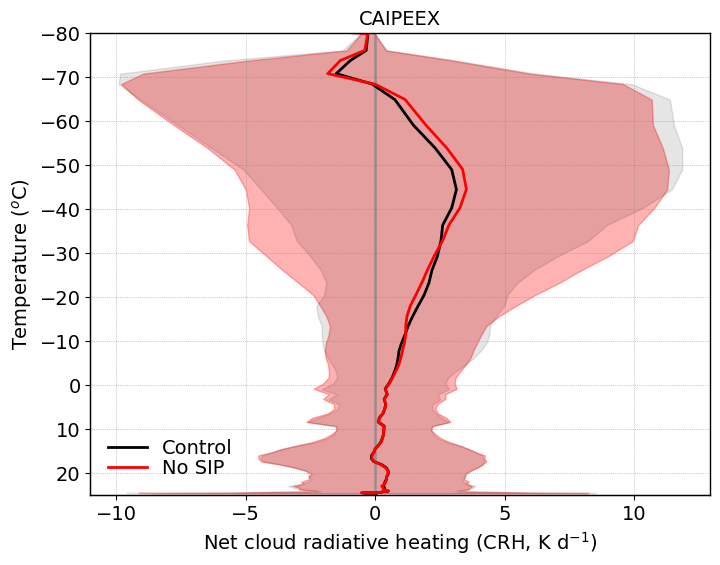

In [32]:

fnt=14
lnwdth=2
alpha=0.8

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)

# Example arrays: mean ± std (replace with your data arrays)
mean_4sip = mean_tot_crh_kperd_4sip
std_4sip  = std_tot_crh_kperd_4sip   # <-- standard deviation
se_4sip  = se_tot_crh_kperd_4sip
tempc_4sip_sorted = mean_tempc_4sip_sorted

mean_nosip = mean_tot_crh_kperd_nosip
std_nosip  = std_tot_crh_kperd_nosip
se_nosip  = se_tot_crh_kperd_nosip
tempc_nosip_sorted = mean_tempc_nosip_sorted

# Plot mean lines
plt1.plot(mean_4sip, tempc_4sip_sorted, 'k-', linewidth=lnwdth, label='Control')
plt1.plot(mean_nosip, tempc_nosip_sorted, 'r-', linewidth=lnwdth, label='No SIP')

# Shaded standard deviation (mean ± std)
plt1.fill_betweenx(tempc_4sip_sorted, mean_4sip-std_4sip, mean_4sip+std_4sip,
                   color='r', alpha=0.3)
plt1.fill_betweenx(tempc_nosip_sorted, mean_nosip-std_nosip, mean_nosip+std_nosip,
                   color='k', alpha=0.1)

# Other formatting
plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(mean_4sip, mean_ht_nosip, '-', color='none', linewidth=lnwdth)

plt1.set_ylim(25, -80)
plt2.set_ylim(0, 14)

plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70, -80])
plt2.set_yticks([])

plt1.tick_params(axis='x', labelsize=fnt)
plt1.tick_params(axis='y', labelsize=fnt)
plt2.tick_params(axis='y', labelsize=fnt)

plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, loc='best')

plt1.set_xlabel('Net cloud radiative heating (CRH, K d$^{-1}$)', fontsize=fnt)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fnt)
plt.title('CAIPEEX', fontsize=fnt)

plt1.spines['top'].set_linewidth(1)
plt2.spines['top'].set_visible(False)
plt2.spines['right'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.show()


## Vertical velocity

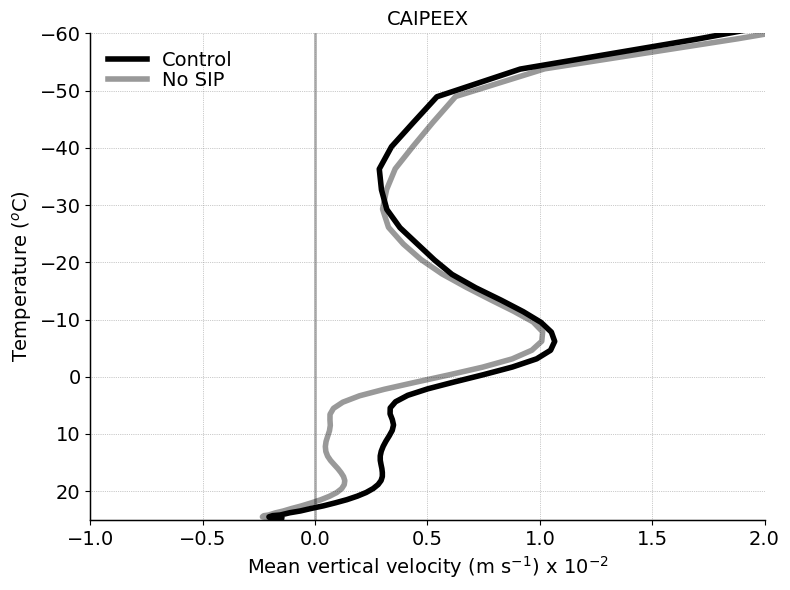

In [37]:
sort_idx = np.argsort(mean_tempc_4sip)
mean_tempc_4sip_sorted = mean_tempc_4sip[sort_idx]

sort_idx = np.argsort(mean_tempc_nosip)
mean_tempc_nosip_sorted = mean_tempc_nosip[sort_idx]

stime='2019-09-30T08:00:00.000000000';
etime='2019-09-30T14:00:00.000000000'

filt_wvel_4sip = ds_4sip.w_vel.sel(time=slice(stime, etime))
filt_wvel_nosip = ds_nosip.w_vel.sel(time=slice(stime, etime))

fontsize=14;
lnwdth=4;
alpha=0.8;
alp1=1;
alp2=0.4;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1 = plt.gca()
plt2 = plt1.twinx()

fac=100.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(fac*filt_wvel_4sip.mean(dim=('time','ncells')), mean_tempc_4sip_sorted, 'k-', alpha=alp1, linewidth=lnwdth, label='Control')
plt1.plot(fac*filt_wvel_nosip.mean(dim=('time','ncells')), mean_tempc_nosip_sorted, 'k-', alpha=alp2, linewidth=lnwdth, label='No SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(filt_wvel_nosip.mean(dim=('time','ncells')), mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(-1., 2)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)
plt2.set_yticks([])

#plt1.set_xticks([-40, -20, 0, 20, 40, 60, 80, 100])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)
#plt1.yaxis.set_ticklabels([])
plt2.yaxis.set_ticklabels([])
plt2.set_yticks([])

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Mean vertical velocity (m s$^{-1}$) x 10$^{-2}$', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
#plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt.title('CAIPEEX', fontsize=fontsize)


plt1.spines['top'].set_linewidth(1)
plt1.spines['top'].set_visible(False)
plt1.spines['right'].set_visible(False)
plt2.spines['top'].set_visible(False)
plt2.spines['right'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


## Freezing and cloud top height

In [38]:

## Freezing and cloud top height
mask = (ds_4sip.tempc > -0.2) & (ds_4sip.tempc < 0.)  & (ds_4sip.twc_gperm3 > 1.e-3)
mean_freez_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_4sip.tempc > -38.5) & (ds_4sip.tempc < -37.5)
mean_hom_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))

mask = (ds_nosip.tempc > -0.2) & (ds_nosip.tempc < 0.)  & (ds_nosip.twc_gperm3 > 1.e-3)
mean_freez_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_nosip.tempc > -38.5) & (ds_nosip.tempc < -37.5)
mean_hom_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))


## Melting level thickness
ds_4sip['tot_q'] = ds_4sip.tq+ds_4sip.qr
mask = (ds_4sip.tempc > -1) & (ds_4sip.tempc < 1.)  & (ds_4sip.twc_gperm3 > 1.e-6) 
mean_melt_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))
## Cloud top height

thres_q = 1.e-3
cld_mask = ds_4sip.twc_gperm3 > thres_q;
mean_cld_top_ht = ds_4sip.z_mc.where(cld_mask)
mean_cld_top_ht_4sip = (mean_cld_top_ht.max(dim='height')).mean(dim=('ncells'))

cld_mask = (ds_nosip.twc_gperm3 > thres_q) & (ds_nosip.w_vel > 0.);
mean_cld_top_ht = ds_nosip.z_mc.where(cld_mask)
mean_cld_top_ht_nosip = (mean_cld_top_ht.max(dim='height')).mean(dim=('ncells'))
#plt.plot(ds_4sip.time, mean_hom_lev_4sip, 'k-', linewidth=ln, label='Control')


/home/b/b382718/own_env/lib/python3.9/site-packages/dask/array/reductions.py:654: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


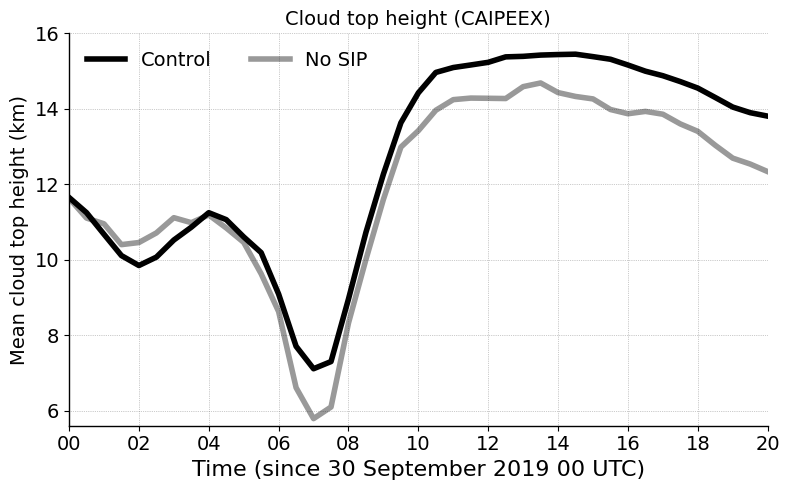

In [40]:

fnt=14;
ln=4;

alp1=1.0;
alp2=0.4;

plt.figure(figsize=(8, 5))
plt.style.use('default')

plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_4sip.time, 1.e-3*mean_cld_top_ht_4sip, 'k-', alpha=alp1, linewidth=ln, label='Control')
plt.plot(ds_nosip.time, 1.e-3*mean_cld_top_ht_nosip, 'k-', alpha=alp2, linewidth=ln, label='No SIP')

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(5.6,16)
plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Mean cloud top height (km)', fontsize=fnt)#, fontweight='bold')
plt.title('Cloud top height (CAIPEEX)', fontsize=fnt)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, ncols=3, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()

### Freezing and homogeneous level

In [23]:
mask = (ds_4sip.tempc > -0.2) & (ds_4sip.tempc < 0.)
mean_freez_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_4sip.tempc > -38.5) & (ds_4sip.tempc < -37.5)
mean_hom_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))

mask = (ds_nosip.tempc > -0.2) & (ds_nosip.tempc < 0.)
mean_freez_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_nosip.tempc > -38.5) & (ds_nosip.tempc < -37.5)
mean_hom_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))


In [25]:

start_time = '2019-09-30T06:00:00.000000000'
end_time = '2019-09-30T15:00:00.000000000'
lhr_4sip = ds_4sip.tot_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()
lhr_nosip = ds_nosip.tot_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()

cond_lhr_4sip = ds_4sip.cond_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()
cond_lhr_nosip = ds_nosip.cond_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()

satad_lhr_4sip = ds_4sip.satad_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()
satad_lhr_nosip = ds_nosip.satad_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()

dep_lhr_4sip = ds_4sip.dep_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()
dep_lhr_nosip = ds_nosip.dep_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()

rime_lhr_4sip = ds_4sip.rime_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()
rime_lhr_nosip = ds_nosip.rime_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()

rainfreez_lhr_4sip = ds_4sip.rainfreez_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()
rainfreez_lhr_nosip = ds_nosip.rainfreez_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()

homhet_lhr_4sip = ds_4sip.homhet_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()
homhet_lhr_nosip = ds_nosip.homhet_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()

melt_lhr_4sip = ds_4sip.melt_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()
melt_lhr_nosip = ds_nosip.melt_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()

evap_lhr_4sip = ds_4sip.evap_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()
evap_lhr_nosip = ds_nosip.evap_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()

melt_evap_lhr_4sip = melt_lhr_4sip+evap_lhr_4sip
melt_evap_lhr_nosip = melt_lhr_nosip+evap_lhr_nosip


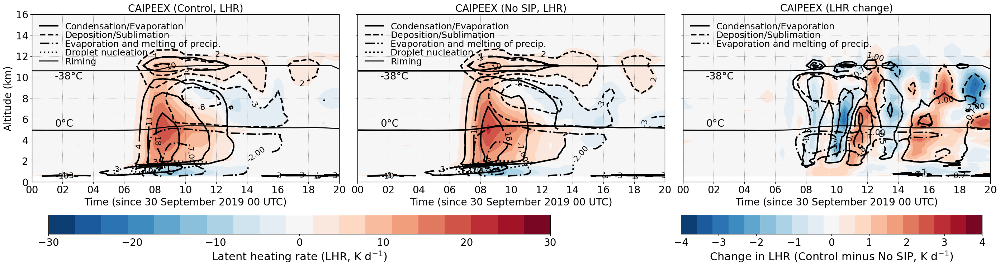

In [87]:

import matplotlib.lines as mlines
import matplotlib.gridspec as gridspec


del_mean_tot_lhr_time_ht = ds_4sip.tot_lhr_kperd.mean(dim=('ncells'))-ds_nosip.tot_lhr_kperd.mean(dim=('ncells'))
del_mean_satad_lhr_time_ht = ds_4sip.satad_lhr_kperd.mean(dim=('ncells'))-ds_nosip.satad_lhr_kperd.mean(dim=('ncells'))
del_mean_cond_lhr_time_ht = ds_4sip.cond_lhr_kperd.mean(dim=('ncells'))-ds_nosip.cond_lhr_kperd.mean(dim=('ncells'))
del_mean_rime_lhr_time_ht = ds_4sip.rime_lhr_kperd.mean(dim=('ncells'))-ds_nosip.rime_lhr_kperd.mean(dim=('ncells'))
del_mean_dep_lhr_time_ht = ds_4sip.dep_lhr_kperd.mean(dim=('ncells'))-ds_nosip.dep_lhr_kperd.mean(dim=('ncells'))
del_mean_evap_melt_lhr_time_ht = ((ds_4sip.evap_lhr_kperd.mean(dim=('ncells'))+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')))-
                              ds_nosip.evap_lhr_kperd.mean(dim=('ncells'))+ds_nosip.melt_lhr_kperd.mean(dim=('ncells')))

fnt=18;
fnt1=18;
ln=2;
ln1=2.0;
ln2=3.0;
alp1=0.3;

lev1 = np.linspace(-30, 30, 20)
lev2 = np.linspace(-0.2, 0.2, 20)
lev3=np.linspace(-4, 4, 20)

plt.figure(figsize=(28, 6))
plt.style.use('default')

plt.subplot(1,3,1)
cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, ds_4sip.tot_lhr_kperd.mean(dim=('ncells')).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)#darkorchid
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='k', linewidth=ln)#grey

plt.text(ds_4sip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[3], 9.8, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt+2)
plt.title('CAIPEEX (Control, LHR)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-10, 20.5, 7)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln2, label='Condensation/Evaporation')#Saturation adjustment')


contour_levels = np.arange(-8, 10.5, 5)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='k', linestyle='--', linewidth=ln2, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 5)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.evap_lhr_kperd.mean(dim=('ncells')).T+ds_nosip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='k', linestyles='-.', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='k', linestyle='-.', linewidth=ln2, label='Evaporation and melting of precip.')

contour_levels = np.arange(-0.1, 12.5, 4)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles=':', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy4 = mlines.Line2D([], [], color='k', linestyle=':', linewidth=ln2, label='Droplet nucleation')

contour_levels = np.arange(-0.1, 2.5, 0.8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dimgray', linestyles='-', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dimgray', linestyle='-', linewidth=ln2, label='Riming')


plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, handlelength=2, labelspacing=0.02, 
           ncols=1, loc='upper left')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)
cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_nosip.tot_lhr_kperd.mean(dim=('ncells')).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln+1)#darkorchid
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='k', linewidth=ln+1)#grey

plt.text(ds_nosip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[3], 9.8, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (No SIP, LHR)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-10, 20.5, 7)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln2, label='Condensation/Evaporation')#Saturation adjustment')


contour_levels = np.arange(-8, 10.5, 5)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='k', linestyle='--', linewidth=ln2, label='Deposition/Sublimation')


contour_levels = np.arange(-12, 0., 5)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.evap_lhr_kperd.mean(dim=('ncells')).T+ds_nosip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='k', linestyles='-.', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='k', linestyle='-.', linewidth=ln2, label='Evaporation and melting of precip.')

contour_levels = np.arange(-0.1, 12.5, 4)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles=':', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy4 = mlines.Line2D([], [], color='k', linestyle=':', linewidth=ln2, label='Droplet nucleation')

contour_levels = np.arange(-0.1, 2.5, 0.8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dimgray', linestyles='-', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dimgray', linestyle='-', linewidth=ln2, label='Riming')


plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, handlelength=2, labelspacing=0.02, 
           ncols=1, loc='upper left')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()
#cbar_ax1 = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar_ax1 = fig.add_axes([0.05, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar1 = fig.colorbar(cnt2, cax=cbar_ax1, orientation='horizontal', ticks=[-30, -20, -10, 0, 10, 20, 30])
cbar1.set_label('Latent heating rate (LHR, K d$^{-1}$)', fontsize=fnt+4)
cbar1.ax.tick_params(labelsize=fnt+2)


plt.subplot(1,3,3)

cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, del_mean_tot_lhr_time_ht.T, levels=lev3, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='k', linewidth=ln)

plt.text(ds_4sip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[3], 9.8, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (LHR change)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-4, 3, 7) #np.arange(-2, 3, 3) #np.arange(-2, 2, 1.2) #np.arange(-6.5, 6.5, 4.5)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_satad_lhr_time_ht.T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%3.1f')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln2, label='Condensation/Evaporation')


contour_levels = np.arange(-2, 2, 3)# np.linspace(-2, 2, 4) #np.arange(-8.5, 8.5, 3.)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_dep_lhr_time_ht.T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy2 = mlines.Line2D([], [], color='k', linestyle='--', linewidth=ln2, label='Deposition/Sublimation')

contour_levels = np.arange(-2, -0.5, 1)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_evap_melt_lhr_time_ht.T, 
                       levels=contour_levels, colors='k', linestyles='-.', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='k', linestyle='-.', linewidth=ln2, label='Evaporation and melting of precip.')

#contour_levels = np.arange(-0.5, 0.5, 0.4)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_cond_lhr_time_ht.T, levels=contour_levels, colors='k', linestyles=':', linewidths=ln2)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

#legend_proxy4 = mlines.Line2D([], [], color='k', linestyle=':', linewidth=ln2, label='CCN nucleation')

#contour_levels = np.arange(-0.8, 0.8, 0.7)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_rime_lhr_time_ht.T, levels=contour_levels, colors='dimgray', linestyles='-', linewidths=ln2)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

#legend_proxy5 = mlines.Line2D([], [], color='dimgray', linestyle='-', linewidth=ln2, label='Riming')


#plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, handlelength=2, labelspacing=0.05, 
#           ncols=1, loc='upper left')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3], frameon=False, fontsize=fnt, handlelength=2, labelspacing=0.02, 
           ncols=1, loc='upper left')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()
#cbar_ax2 = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar_ax2 = fig.add_axes([0.68, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
cbar3 = fig.colorbar(cnt3, cax=cbar_ax2, orientation='horizontal', ticks=[-4, -3, -2, -1, 0, 1, 2, 3, 4])
cbar3.set_label('Change in LHR (Control minus No SIP, K d$^{-1}$)', fontsize=fnt+4)
cbar3.ax.tick_params(labelsize=fnt+2)

plt.tight_layout()
plt.show()


In [86]:

print(np.linspace(-2, 2, 4))
print(np.linspace(-4, 3, 7))
print(del_mean_satad_lhr_time_ht.min().values, del_mean_satad_lhr_time_ht.max().values)

[-2.         -0.66666667  0.66666667  2.        ]
[-4.         -2.83333333 -1.66666667 -0.5         0.66666667  1.83333333
  3.        ]
-3.81386 2.6068082


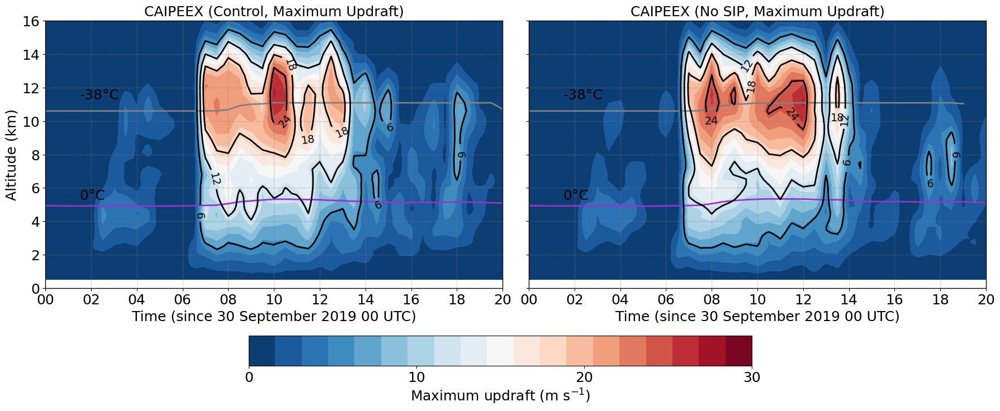

In [9]:

import matplotlib.lines as mlines

fnt=16;
fnt1=16;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(0, 30, 20)
#lev2 = np.linspace(-0.1, 0.1, 20)
lev2 = np.linspace(0, 30, 20)

plt.figure(figsize=(18, 6))
plt.style.use('default')

plt.subplot(1,2,1)
cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, ds_4sip.w_vel.max(dim=('ncells')).T, levels=lev2, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-0.2, -0.1, 0, 0.1, 0.2])#, 25, 30])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[3], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt+2)
plt.title('CAIPEEX (Control, Maximum Updraft)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(0, 30., 6)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.w_vel.max(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,2,2)
cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_nosip.w_vel.max(dim=('ncells')).T, levels=lev2, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-30, -20, -10, 0, 10, 20, 30])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Vertical velocity (m s$^{-1}$)', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[3], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (No SIP, Maximum Updraft)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(0, 30., 6)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.w_vel.max(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()  # Get the current figure
cbar_ax = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar = fig.colorbar(cnt, cax=cbar_ax, ticks=[-30, -20, -10, 0, 10, 20, 30], orientation='horizontal')
cbar.set_label('Maximum updraft (m s$^{-1}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt1+2)

plt.tight_layout()
plt.show()


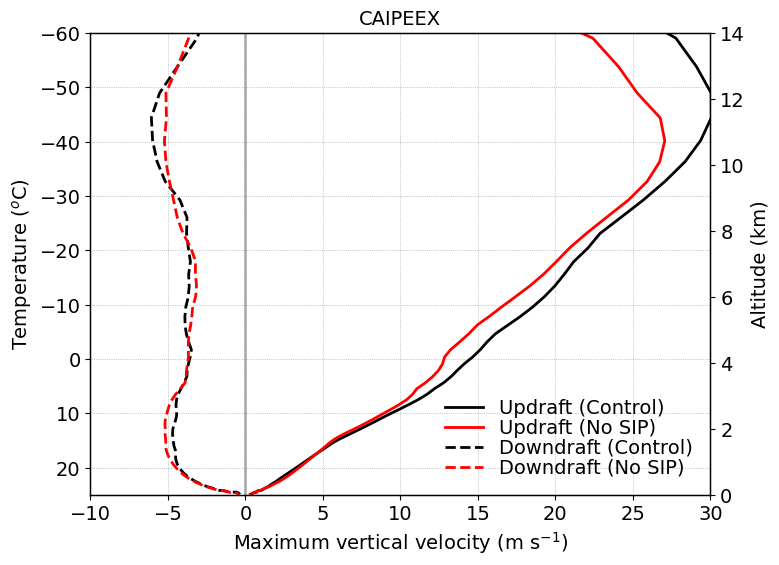

In [28]:

start_time='2019-09-30T06:00:00.000000000'
end_time='2019-09-30T14:00:00.000000000'

ds_nosip_new = ds_nosip.sel(time=slice(start_time, end_time))
ds_4sip_new = ds_4sip.sel(time=slice(start_time, end_time))

fontsize=14;
lnwdth=2;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')


plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)

plt1.plot(ds_4sip_new.w_vel.max(dim=('time','ncells')), mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Updraft (Control)')
plt1.plot(ds_nosip_new.w_vel.max(dim=('time','ncells')), mean_tempc_nosip, 'r-', linewidth=lnwdth, label='Updraft (No SIP)')

plt1.plot(ds_4sip_new.w_vel.min(dim=('time','ncells')), mean_tempc_4sip, 'k--', linewidth=lnwdth, label='Downdraft (Control)')
plt1.plot(ds_nosip_new.w_vel.min(dim=('time','ncells')), mean_tempc_nosip, 'r--', linewidth=lnwdth, label='Downdraft (No SIP)')


plt2.plot(ds_nosip_new.w_vel.max(dim=('time','ncells')), mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-10, 30)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([-1, 0, 1, 2, 3, 4])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Maximum vertical velocity (m s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('CAIPEEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.show()

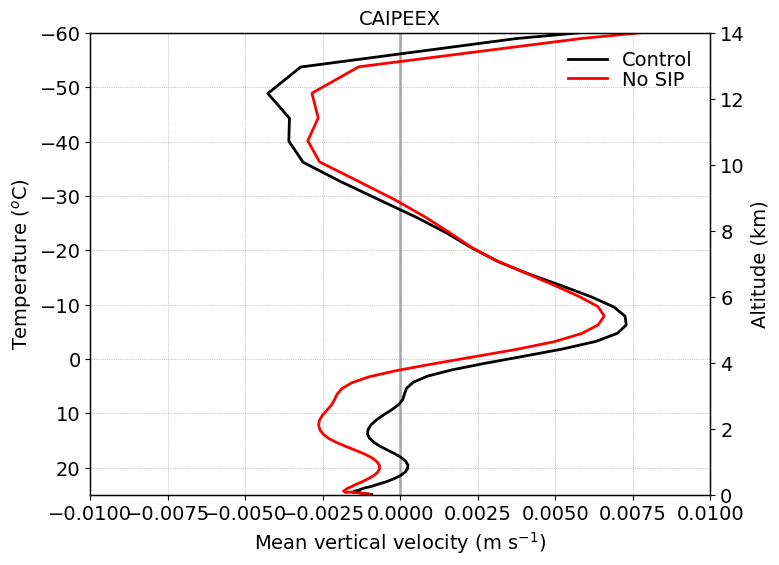

In [15]:

start_time='2019-09-30T06:00:00.000000000'
end_time='2019-09-30T14:00:00.000000000'

ds_nosip_new = ds_nosip.sel(time=slice(start_time, end_time))
ds_4sip_new = ds_4sip.sel(time=slice(start_time, end_time))

fontsize=14;
lnwdth=2;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')


plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)

plt1.plot(ds_4sip_new.w_vel.mean(dim=('time','ncells')), mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Control')
plt1.plot(ds_nosip_new.w_vel.mean(dim=('time','ncells')), mean_tempc_nosip, 'r-', linewidth=lnwdth, label='No SIP')


plt2.plot(ds_nosip_new.w_vel.mean(dim=('time','ncells')), mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-0.01, 0.01)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([-1, 0, 1, 2, 3, 4])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Mean vertical velocity (m s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('CAIPEEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.show()

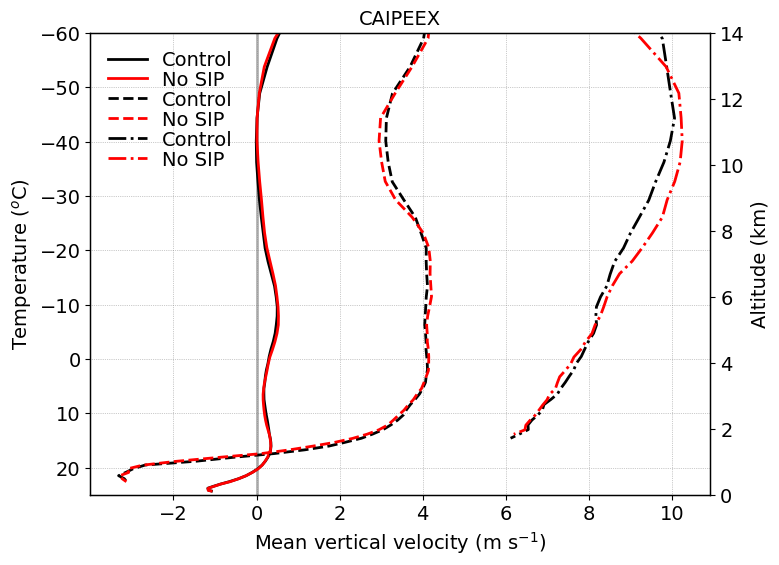

In [22]:

start_time='2019-09-30T06:00:00.000000000'
end_time='2019-09-30T14:00:00.000000000'

ds_nosip_new = ds_nosip.sel(time=slice(start_time, end_time))
ds_4sip_new = ds_4sip.sel(time=slice(start_time, end_time))

avg_wvel_13_4sip = ds_4sip.w_vel.where((np.abs(ds_4sip.w_vel) > 1.) & (np.abs(ds_4sip.w_vel) < 3.), np.nan).mean(dim=('time','ncells'))
avg_wvel_13_nosip = ds_nosip.w_vel.where((np.abs(ds_nosip.w_vel) > 1.) & (np.abs(ds_nosip.w_vel) < 3.), np.nan).mean(dim=('time','ncells'))

avg_wvel_36_4sip = ds_4sip.w_vel.where((np.abs(ds_4sip.w_vel) > 3.) & (np.abs(ds_4sip.w_vel) < 6.), np.nan).mean(dim=('time','ncells'))
avg_wvel_36_nosip = ds_nosip.w_vel.where((np.abs(ds_nosip.w_vel) > 3.) & (np.abs(ds_nosip.w_vel) < 6.), np.nan).mean(dim=('time','ncells'))

avg_wvel_6_4sip = ds_4sip.w_vel.where((np.abs(ds_4sip.w_vel) > 6.), np.nan).mean(dim=('time','ncells'))
avg_wvel_6_nosip = ds_nosip.w_vel.where((np.abs(ds_nosip.w_vel) > 6.), np.nan).mean(dim=('time','ncells'))

fontsize=14;
lnwdth=2;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')


plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)

plt1.plot(avg_wvel_13_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Control')
plt1.plot(avg_wvel_13_nosip, mean_tempc_nosip, 'r-', linewidth=lnwdth, label='No SIP')

plt1.plot(avg_wvel_36_4sip, mean_tempc_4sip, 'k--', linewidth=lnwdth, label='Control')
plt1.plot(avg_wvel_36_nosip, mean_tempc_nosip, 'r--', linewidth=lnwdth, label='No SIP')

plt1.plot(avg_wvel_6_4sip, mean_tempc_4sip, 'k-.', linewidth=lnwdth, label='Control')
plt1.plot(avg_wvel_6_nosip, mean_tempc_nosip, 'r-.', linewidth=lnwdth, label='No SIP')


plt2.plot(avg_wvel_13_4sip, mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

#plt1.set_xlim(-0.01, 0.01)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([-1, 0, 1, 2, 3, 4])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Mean vertical velocity (m s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('CAIPEEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.show()

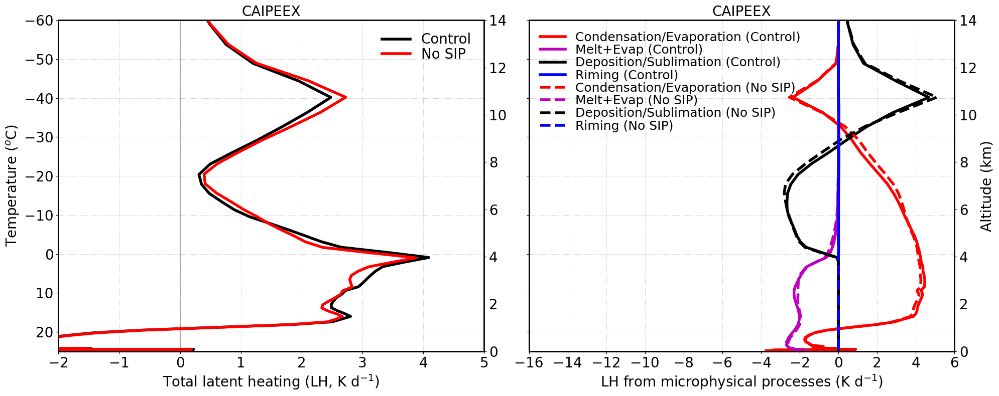

In [61]:

fontsize=20;
lnwdth=4;
alpha=0.8;

plt.figure(figsize=(20, 8))
plt.style.use('default')

plt.subplot(1,2,1)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_lhr_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Control')
plt1.plot(mean_lhr_kperd_nosip, mean_tempc_nosip, 'r-', linewidth=lnwdth, label='No SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(mean_lhr_kperd_nosip, mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(-2, 5)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

plt1.set_xticks([-2, -1, 0, 1, 2, 3, 4, 5])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Total latent heating (LH, K d$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
#plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('CAIPEEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.subplot(1,2,2)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_satad_lhr_4sip, mean_tempc_4sip, 'r-', linewidth=lnwdth, label='Condensation/Evaporation (Control)')
plt1.plot(mean_melt_evap_lhr_4sip, mean_tempc_4sip, 'm-', linewidth=lnwdth, label='Melt+Evap (Control)')
plt1.plot(mean_dep_lhr_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Deposition/Sublimation (Control)')
plt1.plot(mean_rime_lhr_4sip, mean_tempc_4sip, 'b-', linewidth=lnwdth, label='Riming (Control)')
#plt1.plot(mean_cond_lhr_4sip, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='CCN activation (Control)')

plt1.plot(mean_satad_lhr_nosip, mean_tempc_nosip, 'r--', linewidth=lnwdth, label='Condensation/Evaporation (No SIP)')
plt1.plot(mean_melt_evap_lhr_nosip, mean_tempc_nosip, 'm--', linewidth=lnwdth, label='Melt+Evap (No SIP)')
plt1.plot(mean_dep_lhr_nosip, mean_tempc_nosip, 'k--', linewidth=lnwdth, label='Deposition/Sublimation (No SIP)')
plt1.plot(mean_rime_lhr_nosip, mean_tempc_nosip, 'b--', linewidth=lnwdth, label='Riming (No SIP)')
#plt1.plot(mean_cond_lhr_nosip, mean_tempc_nosip, 'g--', linewidth=lnwdth, label='CCN activation (No SIP)')

plt2.plot(mean_cond_lhr_4sip, mean_tempc_4sip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-16., 6)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

plt1.set_xticks([-16, -14, -12, -10, -8, -6, -4, -2, 0, 2, 4, 6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

#plt1.set_yticks([])
#plt1.set_gca().axes.xaxis.set_ticklabels([])
plt1.yaxis.set_ticklabels([])

#plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize-2, ncols=1, loc='best')

plt1.set_xlabel('LH from microphysical processes (K d$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('CAIPEEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.tight_layout()
plt.show()


## Microphysical properties

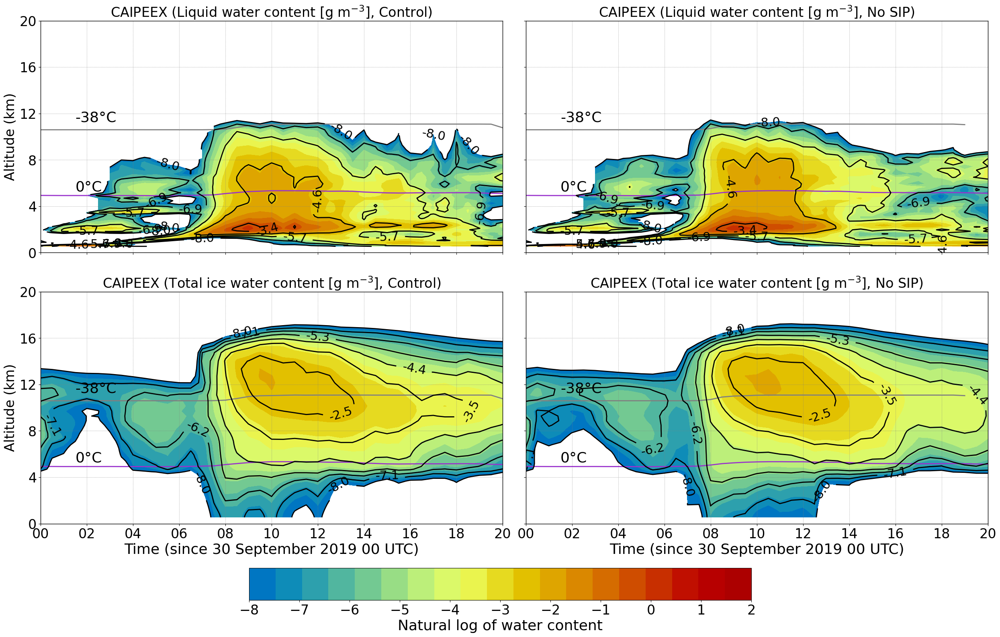

In [29]:

import matplotlib.lines as mlines

fnt=24;
fnt1=22;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-8, -2, 20)
lev2 = np.linspace(-8, 2, 20)
plt.figure(figsize=(25, 20))
plt.style.use('default')

plt.subplot(3,2,1)
cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(ds_4sip.lwc_gperm3.mean(dim=('ncells')).T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-10, -8, -6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[3], 11.3, '-38°C', fontsize=fnt+2)

#plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (Liquid water content [g m$^{-3}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-8, 0, 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(ds_4sip.lwc_gperm3.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(3,2,2)
cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.lwc_gperm3.mean(dim=('ncells')).T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[3], 11.3, '-38°C', fontsize=fnt+2)

#plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (Liquid water content [g m$^{-3}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-8, 0, 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.lwc_gperm3.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(3,2,3)
cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(ds_4sip.tiwc_gperm3.mean(dim=('ncells')).T), levels=lev2, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-0.2, -0.1, 0, 0.1, 0.2])#, 25, 30])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[3], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (Total ice water content [g m$^{-3}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-8, 2, 12)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(ds_4sip.tiwc_gperm3.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(3,2,4)
cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.tiwc_gperm3.mean(dim=('ncells')).T), levels=lev2, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])#, 25, 30])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of Total IWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[3], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (Total ice water content [g m$^{-3}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-8, 2, 12)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.tiwc_gperm3.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
cbar_ax = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar = fig.colorbar(cnt, cax=cbar_ax, ticks=[-8, -7, -6, -5, -4, -3, -2, -1, 0, 1, 2], orientation='horizontal')
cbar.set_label('Natural log of water content', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt)

plt.tight_layout()
plt.show()


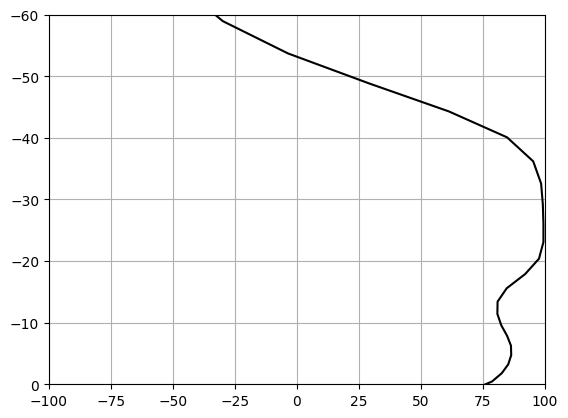

In [144]:

plt.plot(100*(ds_4sip.inc_perl.mean(dim=('time','ncells'))-(ds_nosip.inc_perl.mean(dim=('time','ncells'))))/ds_4sip.inc_perl.mean(dim=('time','ncells')), mean_tempc_4sip, 'k-')
#plt.plot(ds_nosip.lwc_gperm3.mean(dim=('time','ncells')), mean_tempc_nosip, 'r-')
#plt.xscale('log')
#plt.xlim(1.e-6, 1.e-1)
plt.xlim(-100, 100)
plt.ylim(0,-60)
plt.grid(True, which='both')

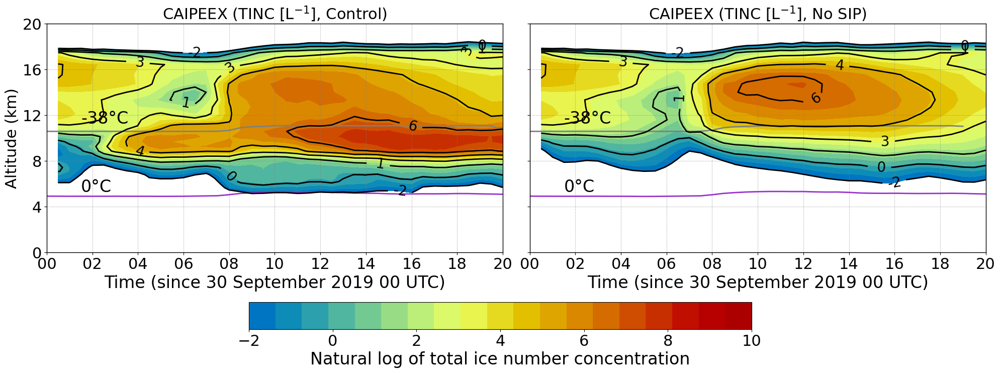

In [121]:

import matplotlib.lines as mlines

fnt=22;
fnt1=22;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-2, 10, 20)
#lev2 = np.linspace(-4, 10, 20)
plt.figure(figsize=(20, 6))
plt.style.use('default')

plt.subplot(1,2,1)
cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(ds_4sip.inc_perl.mean(dim=('ncells')).T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[0, 2, 4, 6, 8, 10, 12])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[3], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (TINC [L$^{-1}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-2, 10, 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(ds_4sip.inc_perl.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,2,2)
cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.inc_perl.mean(dim=('ncells')).T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-4, -2, 0, 2, 4, 6, 8, 10, 12])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of Total INC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[3], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (TINC [L$^{-1}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-2, 10, 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.inc_perl.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()  # Get the current figure
cbar_ax = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar = fig.colorbar(cnt, cax=cbar_ax, ticks=[-2, 0, 2, 4, 6, 8, 10], orientation='horizontal')#ticks=[0, 1000, 2000, 3000, 4000], orientation='horizontal')#, ticks=[-4, -2, 0, 2, 4, 6, 8, 10, 12], orientation='horizontal')
cbar.set_label('Natural log of total ice number concentration', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt)

plt.tight_layout()
plt.show()


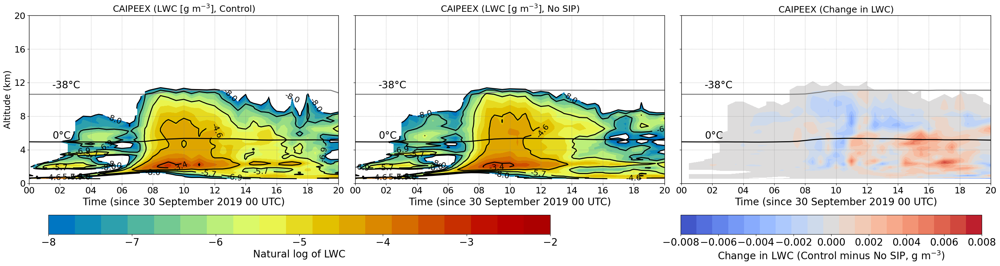

In [11]:

import matplotlib.lines as mlines
mean_lwc_4sip = ds_4sip.lwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_lwc_nosip = ds_nosip.lwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_del_lwc_4sip_nosip = mean_lwc_4sip-mean_lwc_nosip

mean_lwc_4sip = mean_lwc_4sip.where(mean_lwc_4sip != 0., np.nan)
mean_lwc_nosip = mean_lwc_nosip.where(mean_lwc_nosip != 0., np.nan)
mean_del_lwc_4sip_nosip = mean_del_lwc_4sip_nosip.where(mean_del_lwc_4sip_nosip != 0., np.nan)

mean_tiwc_4sip = ds_4sip.tiwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_tiwc_nosip = ds_nosip.tiwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_del_tiwc_4sip_nosip = mean_tiwc_4sip-mean_tiwc_nosip

mean_tiwc_4sip = mean_tiwc_4sip.where(mean_tiwc_4sip != 0., np.nan)
mean_tiwc_nosip = mean_tiwc_nosip.where(mean_tiwc_nosip != 0., np.nan)
mean_del_tiwc_4sip_nosip = mean_del_tiwc_4sip_nosip.where(mean_del_tiwc_4sip_nosip != 0., np.nan)

fnt=18;
fnt1=18;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-8, -2, 20)
#lev1 = np.linspace(0, 0.04, 20)
lev2 = np.linspace(-0.008, 0.008, 20)

plt.figure(figsize=(28, 6))
plt.style.use('default')

plt.subplot(1,3,1)
cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(mean_lwc_4sip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_4sip.time, mean_ht_4sip, mean_lwc_4sip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-10, -8, -6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[3], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (LWC [g m$^{-3}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-8, 0, 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(mean_lwc_4sip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)
cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_lwc_nosip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_lwc_nosip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[3], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (LWC [g m$^{-3}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-8, 0, 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(mean_lwc_nosip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax1 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax1 = fig.add_axes([0.05, -0.1, 0.5, 0.09])
cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[-8, -7, -6, -5, -4, -3, -2, -1, 0, 1, 2], orientation='horizontal')
#cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[0, 0.01, 0.02, 0.03, 0.04], orientation='horizontal')
cbar.set_label('Natural log of LWC', fontsize=fnt+2)
#cbar.set_label('LWC (g m$^{-3}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)

plt.subplot(1,3,3)
#cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_del_lwc_4sip_nosip.T), levels=lev2, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_del_lwc_4sip_nosip.T, levels=lev2, cmap='coolwarm')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[3], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (Change in LWC)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


#contour_levels = np.linspace(-8, 0, 8)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.lwc_gperm3.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax2 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax2 = fig.add_axes([0.68, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
#cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-8, -6, -4, -2, 0], orientation='horizontal')
cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-0.008, -0.006, -0.004, -0.002, 0, 0.002, 0.004, 0.006, 0.008], orientation='horizontal')
#cbar.set_label('Natural log of change in LWC', fontsize=fnt+2)
cbar.set_label('Change in LWC (Control minus No SIP, g m$^{-3}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)


plt.tight_layout()
plt.show()


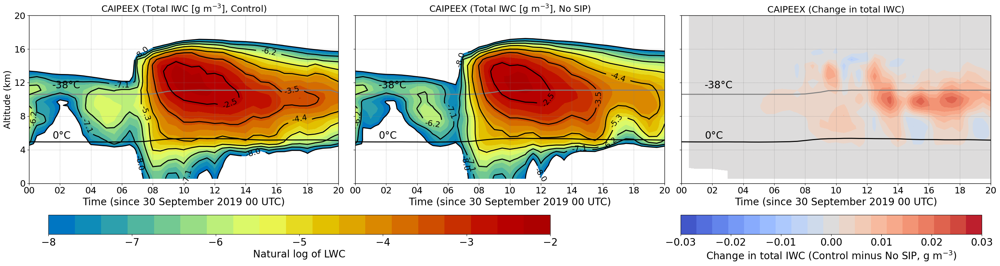

In [12]:

import matplotlib.lines as mlines
mean_lwc_4sip = ds_4sip.lwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_lwc_nosip = ds_nosip.lwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_del_lwc_4sip_nosip = mean_lwc_4sip-mean_lwc_nosip

mean_lwc_4sip = mean_lwc_4sip.where(mean_lwc_4sip != 0., np.nan)
mean_lwc_nosip = mean_lwc_nosip.where(mean_lwc_nosip != 0., np.nan)
mean_del_lwc_4sip_nosip = mean_del_lwc_4sip_nosip.where(mean_del_lwc_4sip_nosip != 0., np.nan)

mean_tiwc_4sip = ds_4sip.tiwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_tiwc_nosip = ds_nosip.tiwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_del_tiwc_4sip_nosip = mean_tiwc_4sip-mean_tiwc_nosip

#mean_tiwc_4sip = mean_tiwc_4sip.where(mean_tiwc_4sip > 0.00001, np.nan)
#mean_tiwc_nosip = mean_tiwc_nosip.where(mean_tiwc_nosip > 0.00001, np.nan)
mean_del_tiwc_4sip_nosip = mean_del_tiwc_4sip_nosip.where(mean_del_tiwc_4sip_nosip != 0., np.nan)

fnt=18;
fnt1=18;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-8, -2, 20)
#lev1 = np.linspace(0, 0.1, 20)
#lev2 = np.linspace(0.0001, 0.03, 20)
lev2 = np.linspace(-0.03, 0.03, 20)

plt.figure(figsize=(28, 6))
plt.style.use('default')

plt.subplot(1,3,1)
cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(mean_tiwc_4sip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_4sip.time, mean_ht_4sip, mean_tiwc_4sip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-10, -8, -6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[3], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (Total IWC [g m$^{-3}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-8, 2, 12)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(mean_tiwc_4sip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)
cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_tiwc_nosip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_tiwc_nosip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[3], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (Total IWC [g m$^{-3}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-8, 2, 12)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(mean_tiwc_nosip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax1 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax1 = fig.add_axes([0.05, -0.1, 0.5, 0.09])
cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[-8, -7, -6, -5, -4, -3, -2, -1, 0, 1, 2], orientation='horizontal')
#cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[0, 0.02, 0.04, 0.06, 0.08, 0.1], orientation='horizontal')
cbar.set_label('Natural log of LWC', fontsize=fnt+2)
#cbar.set_label('Total IWC (g m$^{-3}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)

plt.subplot(1,3,3)
#cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_del_lwc_4sip_nosip.T), levels=lev2, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_del_tiwc_4sip_nosip.T, levels=lev2, cmap='coolwarm')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[3], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (Change in total IWC)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


#contour_levels = np.linspace(-8, 0, 8)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.lwc_gperm3.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax2 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax2 = fig.add_axes([0.68, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
#cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-8, -6, -4, -2, 0], orientation='horizontal')
cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-0.03, -0.02, -0.01, 0, 0.01, 0.02, 0.03], orientation='horizontal')
#cbar.set_label('Natural log of change in LWC', fontsize=fnt+2)
cbar.set_label('Change in total IWC (Control minus No SIP, g m$^{-3}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)


plt.tight_layout()
plt.show()


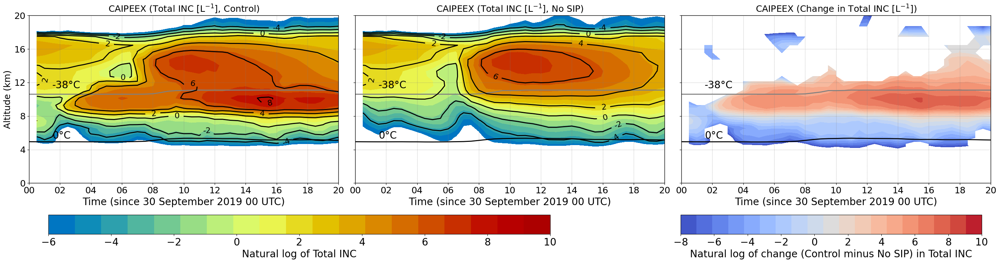

In [13]:

import matplotlib.lines as mlines
mean_tinc_4sip = ds_4sip.inc_perl.mean(dim=('ncells'), skipna=True)
mean_tinc_nosip = ds_nosip.inc_perl.mean(dim=('ncells'), skipna=True)
mean_del_tinc_4sip_nosip = mean_tinc_4sip-mean_tinc_nosip

mean_tinc_4sip = mean_tinc_4sip.where(mean_tinc_4sip != 0., np.nan)
mean_tinc_nosip = mean_tinc_nosip.where(mean_tinc_nosip != 0., np.nan)
mean_del_tinc_4sip_nosip = mean_del_tinc_4sip_nosip.where(mean_del_tinc_4sip_nosip != 0., np.nan)


fnt=18;
fnt1=18;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-6, 10, 20)
#lev1 = np.linspace(0, 0.1, 20)
lev2 = np.linspace(-8, 10, 20)

plt.figure(figsize=(28, 6))
plt.style.use('default')

plt.subplot(1,3,1)
cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(mean_tinc_4sip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, mean_lwc_4sip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-10, -8, -6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[3], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (Total INC [L$^{-1}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-4, 10, 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(mean_tinc_4sip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)
cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_tinc_nosip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_lwc_nosip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[3], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (Total INC [L$^{-1}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-4, 10, 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(mean_tinc_nosip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax1 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax1 = fig.add_axes([0.05, -0.1, 0.5, 0.09])
#cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[-8, -7, -6, -5, -4, -3, -2, -1, 0, 1, 2], orientation='horizontal')
cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[-6, -4, -2, 0, 2, 4, 6, 8, 10], orientation='horizontal')
#cbar.set_label('Natural log of total INC', fontsize=fnt+2)
cbar.set_label('Natural log of Total INC', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)

plt.subplot(1,3,3)
cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_del_tinc_4sip_nosip.T), levels=lev2, cmap='coolwarm')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_del_tinc_4sip_nosip.T, levels=lev2, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[3], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (Change in Total INC [L$^{-1}$])', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


#contour_levels = np.linspace(-6, 10, 8)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(mean_del_tinc_4sip_nosip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax2 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax2 = fig.add_axes([0.68, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
#cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-8, -6, -4, -2, 0], orientation='horizontal')
cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-8, -6, -4, -2, 0, 2, 4, 6, 8, 10], orientation='horizontal')
#cbar.set_label('Natural log of change in LWC', fontsize=fnt+2)
cbar.set_label('Natural log of change (Control minus No SIP) in Total INC', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)


plt.tight_layout()
plt.show()


In [9]:

## Transformed-log-scale to handle negative values
def signed_log(x, scale=0.1):
    return np.sign(x) * np.log1p(np.abs(x) / scale)
    

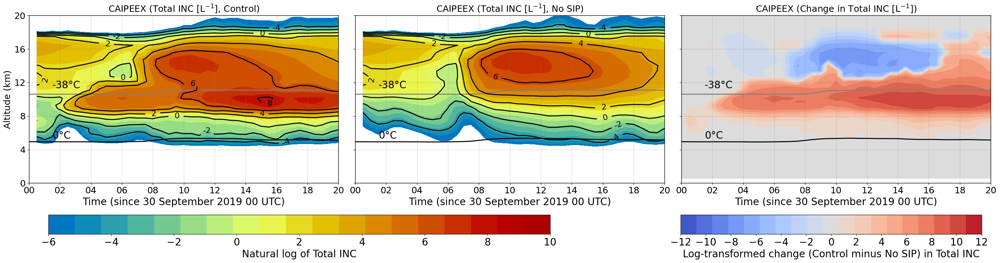

In [18]:

import matplotlib.lines as mlines


## Transformed-log-scale to handle negative values
def signed_log(x, scale=0.1):
    return np.sign(x) * np.log1p(np.abs(x) / scale)


mean_tinc_4sip = ds_4sip.inc_perl.mean(dim=('ncells'), skipna=True)
mean_tinc_nosip = ds_nosip.inc_perl.mean(dim=('ncells'), skipna=True)
mean_del_tinc_4sip_nosip = mean_tinc_4sip-mean_tinc_nosip

mean_tinc_4sip = mean_tinc_4sip.where(mean_tinc_4sip != 0., np.nan)
mean_tinc_nosip = mean_tinc_nosip.where(mean_tinc_nosip != 0., np.nan)
#mean_del_tinc_4sip_nosip = mean_del_tinc_4sip_nosip.where(mean_del_tinc_4sip_nosip != 0., np.nan)


fnt=18;
fnt1=18;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-6, 10, 20)
#lev1 = np.linspace(0, 0.1, 20)
lev2 = np.linspace(-12, 12, 20)

plt.figure(figsize=(28, 6))
plt.style.use('default')

plt.subplot(1,3,1)
cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(mean_tinc_4sip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, mean_lwc_4sip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-10, -8, -6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[3], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (Total INC [L$^{-1}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-4, 10, 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(mean_tinc_4sip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)
cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_tinc_nosip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_lwc_nosip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[3], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (Total INC [L$^{-1}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-4, 10, 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(mean_tinc_nosip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax1 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax1 = fig.add_axes([0.05, -0.1, 0.5, 0.09])
#cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[-8, -7, -6, -5, -4, -3, -2, -1, 0, 1, 2], orientation='horizontal')
cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[-6, -4, -2, 0, 2, 4, 6, 8, 10], orientation='horizontal')
#cbar.set_label('Natural log of total INC', fontsize=fnt+2)
cbar.set_label('Natural log of Total INC', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)

plt.subplot(1,3,3)
cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, signed_log(mean_del_tinc_4sip_nosip.T), levels=lev2, cmap='coolwarm')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_del_tinc_4sip_nosip.T, levels=lev2, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[3], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (Change in Total INC [L$^{-1}$])', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


#contour_levels = np.linspace(-6, 10, 8)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(mean_del_tinc_4sip_nosip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax2 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax2 = fig.add_axes([0.68, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
#cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-8, -6, -4, -2, 0], orientation='horizontal')
cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-12, -10, -8, -6, -4, -2, 0, 2, 4, 6, 8, 10, 12], orientation='horizontal')
#cbar.set_label('Natural log of change in LWC', fontsize=fnt+2)
cbar.set_label('Log-transformed change (Control minus No SIP) in Total INC', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)


plt.tight_layout()
plt.show()


In [17]:

print(mean_del_tinc_4sip_nosip.max().values)


3551.529


In [15]:
def signed_log(x, scale=0.08):
    return np.sign(x) * np.log1p(np.abs(x) / scale)

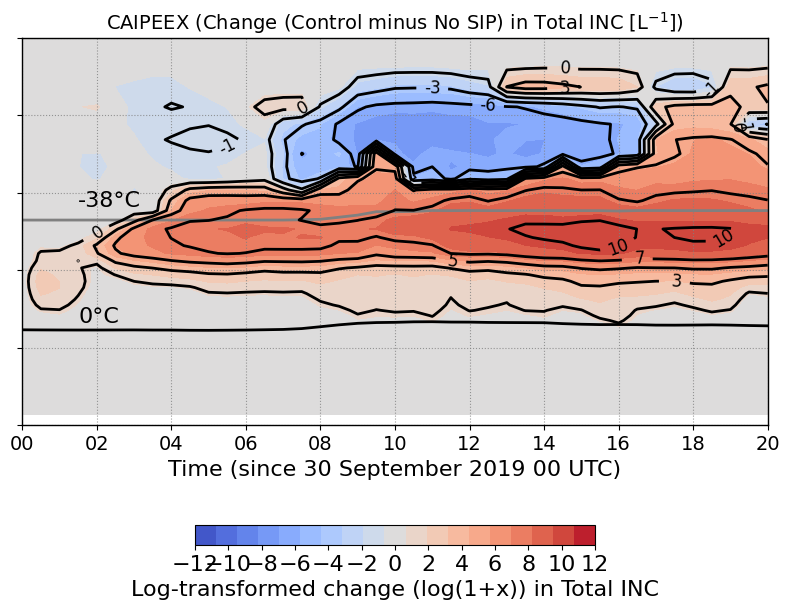

In [17]:
import matplotlib.lines as mlines
from matplotlib.colors import SymLogNorm

mean_tinc_4sip = ds_4sip.inc_perl.mean(dim=('ncells'), skipna=True)
mean_tinc_nosip = ds_nosip.inc_perl.mean(dim=('ncells'), skipna=True)
mean_del_tinc_4sip_nosip = mean_tinc_4sip-mean_tinc_nosip

mean_tinc_4sip = mean_tinc_4sip.where(mean_tinc_4sip != 0., np.nan)
mean_tinc_nosip = mean_tinc_nosip.where(mean_tinc_nosip != 0., np.nan)
#mean_del_tinc_4sip_nosip = mean_del_tinc_4sip_nosip.where(mean_del_tinc_4sip_nosip != 0., np.nan)


fnt=14;
fnt1=14;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-6, 10, 20)
#lev1 = np.linspace(0, 0.1, 20)
lev2 = np.linspace(-12, 12, 20)

plt.figure(figsize=(8, 5))
plt.style.use('default')
cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, signed_log(mean_del_tinc_4sip_nosip.T), levels=lev2, cmap='coolwarm')


plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[3], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (Change (Control minus No SIP) in Total INC [L$^{-1}$])', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-6, 10, 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, signed_log(mean_del_tinc_4sip_nosip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax2 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax2 = fig.add_axes([0.25, -0.1, 0.5, 0.04])  # [left, bottom, width, height]
#cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-8, -6, -4, -2, 0], orientation='horizontal')
cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-12, -10, -8, -6, -4, -2, 0, 2, 4, 6, 8, 10, 12], orientation='horizontal')
#cbar = fig.colorbar(cnt3, cax=cbar_ax2, orientation='horizontal')
cbar.set_label('Log-transformed change (log(1+x)) in Total INC', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)

plt.tight_layout()
plt.show()


In [48]:
print(np.sign(-0.01), np.log1p(0.01), np.log(0.01))

-1.0 0.009950330853168083 -4.605170185988091


## Ice enhancement factor

In [11]:
ds_4sip

<xarray.Dataset> Size: 75GB
Dimensions:            (time: 41, ncells: 68960, vertices: 3, height: 65,
                        bnds: 2, plev: 1, plev_2: 1, plev_3: 1, height_2: 66)
Coordinates:
  * time               (time) datetime64[ns] 328B 2019-09-30 ... 2019-09-30T2...
    clon               (ncells) float64 552kB dask.array<chunksize=(68960,), meta=np.ndarray>
    clat               (ncells) float64 552kB dask.array<chunksize=(68960,), meta=np.ndarray>
  * height             (height) float64 520B 1.0 2.0 3.0 4.0 ... 63.0 64.0 65.0
  * height_2           (height_2) float64 528B 1.0 2.0 3.0 ... 64.0 65.0 66.0
  * plev               (plev) float64 8B 800.0
  * plev_2             (plev_2) float64 8B 400.0
  * plev_3             (plev_3) float64 8B 0.0
Dimensions without coordinates: ncells, vertices, bnds
Data variables: (12/122)
    clon_bnds          (time, ncells, vertices) float64 68MB dask.array<chunksize=(1, 68960, 3), meta=np.ndarray>
    clat_bnds          (time, ncells, vertices) float64 68MB dask.array<chunksize=(1, 68960, 3), meta=np.ndarray>
    height_bnds        (time, height, bnds) float64 43kB dask.array<chunksize=(1, 65, 2), meta=np.ndarray>
    plev_bnds          (time, plev, bnds) float64 656B dask.array<chunksize=(1, 1, 2), meta=np.ndarray>
    plev_2_bnds        (time, plev_2, bnds) float64 656B dask.array<chunksize=(1, 1, 2), meta=np.ndarray>
    plev_3_bnds        (time, plev_3, bnds) float64 656B dask.array<chunksize=(1, 1, 2), meta=np.ndarray>
    ...                 ...
    tq                 (time, height, ncells) float32 735MB dask.array<chunksize=(1, 65, 68960), meta=np.ndarray>
    ciwc_gperm3        (time, height, ncells) float32 735MB dask.array<chunksize=(1, 65, 68960), meta=np.ndarray>
    tiwc_gperm3        (time, height, ncells) float32 735MB dask.array<chunksize=(1, 65, 68960), meta=np.ndarray>
    twc_gperm3         (time, height, ncells) float32 735MB dask.array<chunksize=(1, 65, 68960), meta=np.ndarray>
    cdnc_percm3        (time, height, ncells) float32 735MB dask.array<chunksize=(1, 65, 68960), meta=np.ndarray>
    inc_perl           (time, height, ncells) float32 735MB dask.array<chunksize=(1, 65, 68960), meta=np.ndarray>
Attributes:
    CDI:                  Climate Data Interface version 2.4.0 (https://mpime...
    Conventions:          CF-1.6
    number_of_grid_used:  99
    uuidOfHGrid:          3eb4f381-adbd-e79a-b32f-6e1ff3ba2860
    uuidOfVGrid:          acbf7b33-d4a3-b631-6ecd-012f775e2bc0
    institution:          Max Planck Institute for Meteorology/Deutscher Wett...
    title:                ICON simulation
    source:               version: 2024.10; revision: f3f9a5624ca4223a7fe2f0c...
    history:              /home/b/b382718/continental_cases/4sip/icon-oct2024...
    references:           see MPIM/DWD publications
    comment:              Deepak Waman (b382718) on l20442 (Linux 4.18.0-513....

In [29]:

mask = (ds_4sip.tempc > -0.2) & (ds_4sip.tempc < 0.)
mean_freez_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_4sip.tempc > -38.5) & (ds_4sip.tempc < -37.5)
mean_hom_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))

mask = (ds_nosip.tempc > -0.2) & (ds_nosip.tempc < 0.)
mean_freez_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_nosip.tempc > -38.5) & (ds_nosip.tempc < -37.5)
mean_hom_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))


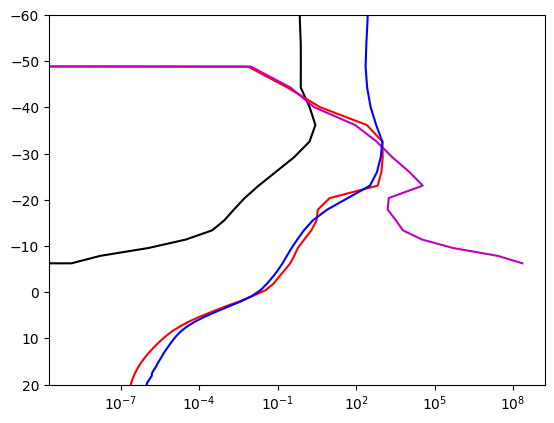

In [27]:

ninp_act_perl = ds_4sip.inp_perl.diff('time')
inc_sip_perl = ds_4sip.inc_sip_perl.diff('time')
ice_enhancement_factor = inc_sip_perl/ninp_act_perl

plt.style.use('default')
plt.plot(ninp_act_perl.mean(dim=('time', 'ncells')), mean_tempc_4sip, 'k-')
plt.plot(inc_sip_perl.mean(dim=('time', 'ncells')), mean_tempc_4sip, 'r-')
plt.plot(inc_sip_perl.mean(dim=('time', 'ncells'))/ninp_act_perl.mean(dim=('time', 'ncells')), mean_tempc_4sip, 'm-')
plt.plot(ds_4sip.inc_perl.mean(dim=('time', 'ncells')), mean_tempc_4sip, 'b-')
plt.ylim(20, -60)
plt.xscale('log')

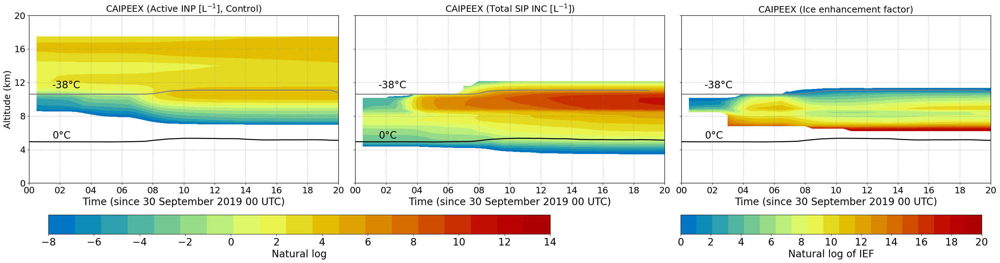

In [47]:

import matplotlib.lines as mlines

mean_inp_4sip = ds_4sip.inp_perl.mean(dim=('ncells'), skipna=True)
mean_inc_sip_4sip = ds_4sip.inc_sip_perl.mean(dim=('ncells'), skipna=True)
mean_tinc_4sip = ds_4sip.inc_perl.mean(dim=('ncells'), skipna=True)
mean_ief_4sip = mean_inc_sip_4sip/mean_inp_4sip


fnt=18;
fnt1=18;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-8, 14, 20)
#lev1 = np.linspace(0, 0.1, 20)
lev2 = np.linspace(0, 20, 20)

plt.figure(figsize=(28, 6))
plt.style.use('default')

plt.subplot(1,3,1)
cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(mean_inp_4sip.T), levels=lev1, cmap='HomeyerRainbow')

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='gray', linewidth=ln)

plt.text(ds_4sip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[3], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (Active INP [L$^{-1}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)
cnt2=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(mean_inc_sip_4sip.T), levels=lev1, cmap='HomeyerRainbow')

plt.plot(ds_4sip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_4sip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[3], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (Total SIP INC [L$^{-1}$])', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax1 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax1 = fig.add_axes([0.05, -0.1, 0.5, 0.09])
#cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[-8, -7, -6, -5, -4, -3, -2, -1, 0, 1, 2], orientation='horizontal')
cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[-8, -6, -4, -2, 0, 2, 4, 6, 8, 10, 12, 14], orientation='horizontal')
#cbar.set_label('Natural log of total INC', fontsize=fnt+2)
cbar.set_label('Natural log', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)

plt.subplot(1,3,3)
cnt3=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(mean_ief_4sip.T), levels=lev2, cmap='HomeyerRainbow')

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='gray', linewidth=ln)

plt.text(ds_4sip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[3], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (Ice enhancement factor)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax2 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax2 = fig.add_axes([0.68, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[0, 2, 4, 6, 8, 10, 12, 14, 16, 18, 20], orientation='horizontal')
#cbar.set_label('Natural log of change in LWC', fontsize=fnt+2)
cbar.set_label('Natural log of IEF', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)


plt.tight_layout()
plt.show()


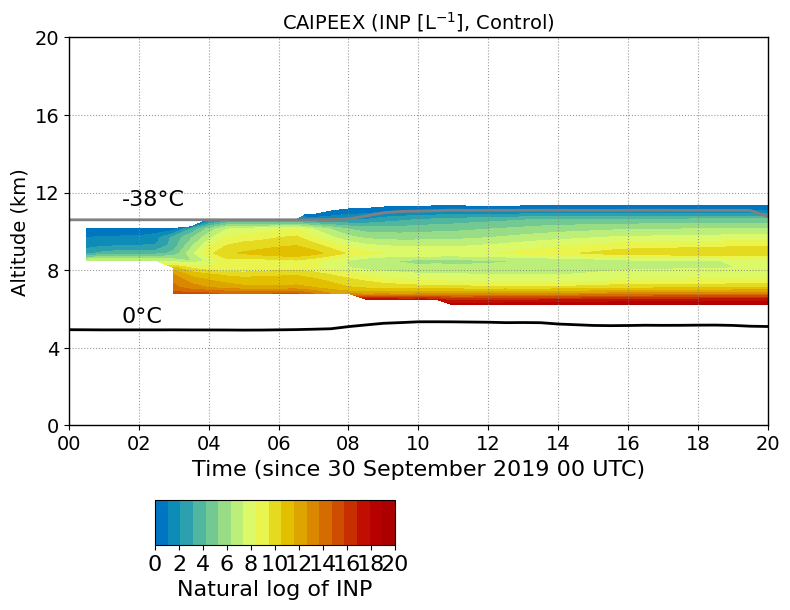

In [44]:

import matplotlib.lines as mlines

mean_inp_4sip = ds_4sip.inp_perl.mean(dim=('ncells'), skipna=True)
mean_inc_sip_4sip = ds_4sip.inc_sip_perl.mean(dim=('ncells'), skipna=True)
mean_tinc_4sip = ds_4sip.inc_perl.mean(dim=('ncells'), skipna=True)
mean_ief_4sip = mean_inc_sip_4sip/mean_inp_4sip

fnt=14;
fnt1=14;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(0, 20, 20)

plt.figure(figsize=(8, 5))
plt.style.use('default')

#plt.subplot(1,3,1)
cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(mean_ief_4sip.T), levels=lev1, cmap='HomeyerRainbow')

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='gray', linewidth=ln)

plt.text(ds_4sip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[3], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (INP [L$^{-1}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

#contour_levels = np.linspace(-8, 8, 8)
#contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(mean_tinc_4sip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%1d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
cbar_ax = fig.add_axes([0.2, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
#cbar = fig.colorbar(cnt1, cax=cbar_ax, ticks=[-8, -6, -4, -2, 0, 2, 4, 6, 8], orientation='horizontal')
cbar = fig.colorbar(cnt1, cax=cbar_ax, ticks=[0, 2, 4, 6, 8, 10, 12, 14, 16, 18, 20], orientation='horizontal')
#cbar.set_label('Natural log of change in LWC', fontsize=fnt+2)
cbar.set_label('Natural log of INP', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)

plt.tight_layout()
plt.show()

## Freezing level

In [7]:
mask = (ds_4sip.tempc > -0.5) & (ds_4sip.tempc < 0.5)
mean_freez_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_4sip.tempc > -38.5) & (ds_4sip.tempc < -37.5)
mean_hom_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))

mask = (ds_nosip.tempc > -0.5) & (ds_nosip.tempc < 0.5)
mean_freez_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_nosip.tempc > -38.5) & (ds_nosip.tempc < -37.5)
mean_hom_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))



#plt.plot(ds_4sip.time, mean_hom_lev_4sip, 'k-', linewidth=ln, label='Control')

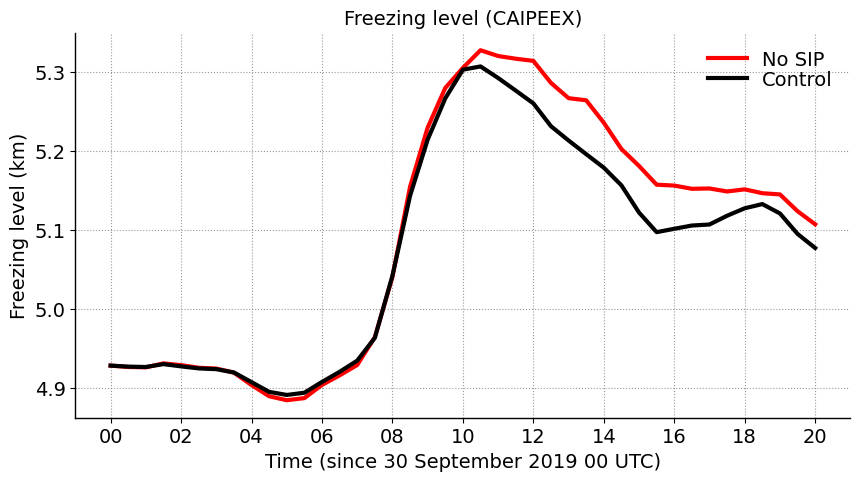

In [85]:



fnt=14;
ln=3;
plt.figure(figsize=(10,5))
plt.style.use('default')

plt.plot(ds_nosip.time, mean_freez_lev_nosip, 'r-', color='r', linewidth=ln, label='No SIP')
plt.plot(ds_4sip.time, mean_freez_lev_4sip, 'k-', linewidth=ln, label='Control')
#plt.plot(ds_norf.time, mean_freez_lev_norf, 'r--', linewidth=ln, label='No RDS')
#plt.plot(ds_nohm.time, mean_freez_lev_nohm, 'b--', linewidth=ln, label='No HM')
#plt.plot(ds_nobr.time, mean_freez_lev_nobr, 'm--', linewidth=ln, label='No IIC')
#plt.plot(ds_nosb.time, mean_freez_lev_nosb, 'g--', linewidth=ln, label='No SB')

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

#plt.ylim(20, -60)
#plt.ylim(3.6, 4.4)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Freezing level (km)', fontsize=fnt)
plt.title('Freezing level (CAIPEEX)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, loc='best')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

In [61]:

## Freezing and cloud top height

mask = (ds_4sip.tempc > -0.5) & (ds_4sip.tempc < 0.5)
mean_freez_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_4sip.tempc > -38.5) & (ds_4sip.tempc < -37.5)
mean_hom_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))

mask = (ds_nosip.tempc > -0.5) & (ds_nosip.tempc < 0.5)
mean_freez_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_nosip.tempc > -38.5) & (ds_nosip.tempc < -37.5)
mean_hom_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))

## Cloud top height

thres_q = 1.e-3
cld_mask = ds_4sip.twc_gperm3 > thres_q;
mean_cld_top_ht = ds_4sip.z_mc.where(cld_mask)
mean_cld_top_ht_4sip = (mean_cld_top_ht.max(dim='height')).mean(dim=('ncells'))

cld_mask = (ds_nosip.twc_gperm3 > thres_q) & (ds_nosip.w_vel > 0.);
mean_cld_top_ht = ds_nosip.z_mc.where(cld_mask)
mean_cld_top_ht_nosip = (mean_cld_top_ht.max(dim='height')).mean(dim=('ncells'))
#plt.plot(ds_4sip.time, mean_hom_lev_4sip, 'k-', linewidth=ln, label='Control')

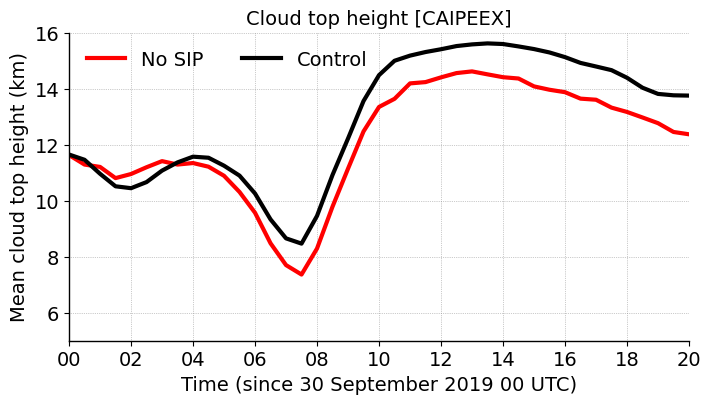

In [52]:




plt.figure(figsize=(8, 4))
plt.style.use('default')

lnwdth=3
fontsize=14

plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, 1.e-3*mean_cld_top_ht_nosip, 'r-', color='r', linewidth=lnwdth, label='No SIP')
#plt.plot(ds_norf.time, 1.e-3*mean_cld_top_ht_norf, 'r--', linewidth=lnwdth, label='No RDS')
#plt.plot(ds_nohm.time, 1.e-3*mean_cld_top_ht_nohm, 'b--', linewidth=lnwdth, label='No HM')
#plt.plot(ds_nobr.time, 1.e-3*mean_cld_top_ht_nobr, 'm--', linewidth=lnwdth, label='No IIC')
#plt.plot(ds_nosb.time, 1.e-3*mean_cld_top_ht_nosb, 'g--', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time, 1.e-3*mean_cld_top_ht_4sip, 'k-', linewidth=lnwdth, label='Control')

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fontsize)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(5,16)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Mean cloud top height (km)', fontsize=fontsize)#, fontweight='bold')
plt.title('Cloud top height [CAIPEEX]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, ncols=3, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)
plt.show()


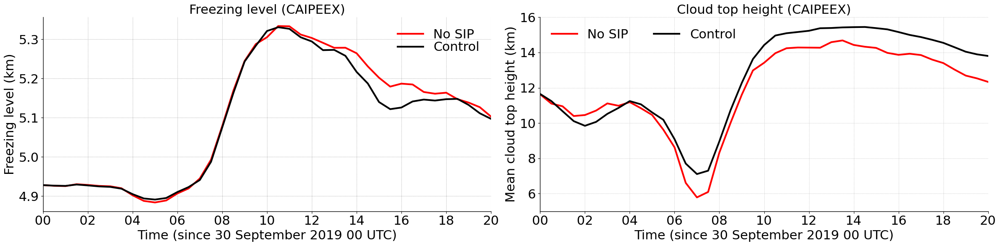

In [62]:



fnt=22;
ln=3;
plt.figure(figsize=(24, 6))
plt.style.use('default')

plt.subplot(1,2,1)
plt.plot(ds_nosip.time, mean_freez_lev_nosip, 'r-', color='r', linewidth=ln, label='No SIP')
plt.plot(ds_4sip.time, mean_freez_lev_4sip, 'k-', linewidth=ln, label='Control')
#plt.plot(ds_norf.time, mean_freez_lev_norf, 'r--', linewidth=ln, label='No RDS')
#plt.plot(ds_nohm.time, mean_freez_lev_nohm, 'b--', linewidth=ln, label='No HM')
#plt.plot(ds_nobr.time, mean_freez_lev_nobr, 'm--', linewidth=ln, label='No IIC')
#plt.plot(ds_nosb.time, mean_freez_lev_nosb, 'g--', linewidth=ln, label='No SB')

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
#plt.ylim(3.6, 4.4)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Freezing level (km)', fontsize=fnt)
plt.title('Freezing level (CAIPEEX)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, loc='best')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.subplot(1,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, 1.e-3*mean_cld_top_ht_nosip, 'r-', color='r', linewidth=ln, label='No SIP')
plt.plot(ds_4sip.time, 1.e-3*mean_cld_top_ht_4sip, 'k-', linewidth=ln, label='Control')

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(5,16)
plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Mean cloud top height (km)', fontsize=fnt)#, fontweight='bold')
plt.title('Cloud top height (CAIPEEX)', fontsize=fnt)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, ncols=3, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()

## TOA Radiative Fluxes

#### Calculating CRE
##### SW CRE = (Qcld_sw_dn - Qcld_sw_up) - (Qclear_sw_dn - Qclear_sw_up)
##### LW CRE = (Qcld_lw_dn - Qcld_lw_up) - (Qclear_lw_dn - Qclear_lw_up)
##### Net CRE = SW_CRE + LW_CRE

In [9]:

#### SIP
toa_sw_up_4sip = ds_4sip.swflx_up.isel(height_2=0)
toa_sw_up_clr_4sip = ds_4sip.swflx_up_clr.isel(height_2=0)
toa_lw_up_4sip = ds_4sip.lwflx_up.isel(height_2=0)
toa_lw_up_clr_4sip = ds_4sip.lwflx_up_clr.isel(height_2=0)

toa_sw_dn_4sip = ds_4sip.swflx_dn.isel(height_2=0)
toa_sw_dn_clr_4sip = ds_4sip.swflx_dn_clr.isel(height_2=0)
toa_lw_dn_4sip = ds_4sip.lwflx_dn.isel(height_2=0)
toa_lw_dn_clr_4sip = ds_4sip.lwflx_dn_clr.isel(height_2=0)

toa_sw_cre_4sip = (toa_sw_dn_4sip-toa_sw_up_4sip) - (toa_sw_dn_clr_4sip-toa_sw_up_clr_4sip)
toa_lw_cre_4sip = (toa_lw_dn_4sip-toa_lw_up_4sip) - (toa_lw_dn_clr_4sip-toa_lw_up_clr_4sip)
toa_net_cre_4sip = toa_sw_cre_4sip+toa_lw_cre_4sip

ds_4sip['toa_sw_cre'] = toa_sw_cre_4sip
ds_4sip['toa_lw_cre'] = toa_lw_cre_4sip
ds_4sip['toa_net_cre'] = toa_net_cre_4sip

surf_sw_up_4sip = ds_4sip.swflx_up.isel(height_2=65)
surf_sw_up_clr_4sip = ds_4sip.swflx_up_clr.isel(height_2=65) 
surf_lw_up_4sip = ds_4sip.lwflx_up.isel(height_2=65)
surf_lw_up_clr_4sip = ds_4sip.lwflx_up_clr.isel(height_2=65) 

surf_sw_dn_4sip = ds_4sip.swflx_dn.isel(height_2=65) 
surf_sw_dn_clr_4sip = ds_4sip.swflx_dn_clr.isel(height_2=65) 
surf_lw_dn_4sip = ds_4sip.lwflx_dn.isel(height_2=65) 
surf_lw_dn_clr_4sip = ds_4sip.lwflx_dn_clr.isel(height_2=65) 

surf_sw_cre_4sip = (surf_sw_dn_4sip-surf_sw_up_4sip) - (surf_sw_dn_clr_4sip-surf_sw_up_clr_4sip)
surf_lw_cre_4sip = (surf_lw_dn_4sip-surf_lw_up_4sip) - (surf_lw_dn_clr_4sip-surf_lw_up_clr_4sip)
surf_net_cre_4sip = surf_sw_cre_4sip+surf_lw_cre_4sip

ds_4sip['surf_sw_cre'] = surf_sw_cre_4sip
ds_4sip['surf_lw_cre'] = surf_lw_cre_4sip
ds_4sip['surf_net_cre'] = surf_net_cre_4sip


#### No SIP
toa_sw_up_nosip = ds_nosip.swflx_up.isel(height_2=0)
toa_sw_up_clr_nosip = ds_nosip.swflx_up_clr.isel(height_2=0)
toa_lw_up_nosip = ds_nosip.lwflx_up.isel(height_2=0)
toa_lw_up_clr_nosip = ds_nosip.lwflx_up_clr.isel(height_2=0)

toa_sw_dn_nosip = ds_nosip.swflx_dn.isel(height_2=0)
toa_sw_dn_clr_nosip = ds_nosip.swflx_dn_clr.isel(height_2=0)
toa_lw_dn_nosip = ds_nosip.lwflx_dn.isel(height_2=0)
toa_lw_dn_clr_nosip = ds_nosip.lwflx_dn_clr.isel(height_2=0)

toa_sw_cre_nosip = (toa_sw_dn_nosip-toa_sw_up_nosip) - (toa_sw_dn_clr_nosip-toa_sw_up_clr_nosip)
toa_lw_cre_nosip = (toa_lw_dn_nosip-toa_lw_up_nosip) - (toa_lw_dn_clr_nosip-toa_lw_up_clr_nosip)
toa_net_cre_nosip = toa_sw_cre_nosip+toa_lw_cre_nosip

ds_nosip['toa_sw_cre'] = toa_sw_cre_nosip
ds_nosip['toa_lw_cre'] = toa_lw_cre_nosip
ds_nosip['toa_net_cre'] = toa_net_cre_nosip

surf_sw_up_nosip = ds_nosip.swflx_up.isel(height_2=65)
surf_sw_up_clr_nosip = ds_nosip.swflx_up_clr.isel(height_2=65)
surf_lw_up_nosip = ds_nosip.lwflx_up.isel(height_2=65)
surf_lw_up_clr_nosip = ds_nosip.lwflx_up_clr.isel(height_2=65)

surf_sw_dn_nosip = ds_nosip.swflx_dn.isel(height_2=65)
surf_sw_dn_clr_nosip = ds_nosip.swflx_dn_clr.isel(height_2=65)
surf_lw_dn_nosip = ds_nosip.lwflx_dn.isel(height_2=65)
surf_lw_dn_clr_nosip = ds_nosip.lwflx_dn_clr.isel(height_2=65)

surf_sw_cre_nosip = (surf_sw_dn_nosip-surf_sw_up_nosip) - (surf_sw_dn_clr_nosip-surf_sw_up_clr_nosip)
surf_lw_cre_nosip = (surf_lw_dn_nosip-surf_lw_up_nosip) - (surf_lw_dn_clr_nosip-surf_lw_up_clr_nosip)
surf_net_cre_nosip = surf_sw_cre_nosip+surf_lw_cre_nosip

ds_nosip['surf_sw_cre'] = surf_sw_cre_nosip
ds_nosip['surf_lw_cre'] = surf_lw_cre_nosip
ds_nosip['surf_net_cre'] = surf_net_cre_nosip


In [ ]:

print('============ SURFACE LW ============')
print('surf_lw_dn_4sip     :: ', surf_lw_dn_4sip.mean().values)
print('surf_lw_up_4sip     :: ', surf_lw_up_4sip.mean().values)
print('surf_lw_dn_clr_4sip :: ', surf_lw_dn_clr_4sip.mean().values)
print('surf_lw_up_clr_4sip :: ', surf_lw_up_clr_4sip.mean().values)
print('surf_lw_cre_4sip    :: ', surf_lw_cre_4sip.mean().values)

print()

print('surf_lw_dn_nosip     :: ', surf_lw_dn_nosip.mean().values)
print('surf_lw_up_nosip     :: ', surf_lw_up_nosip.mean().values)
print('surf_lw_dn_clr_nosip :: ', surf_lw_dn_clr_nosip.mean().values)
print('surf_lw_up_clr_nosip :: ', surf_lw_up_clr_nosip.mean().values)
print('surf_lw_cre_nosip    :: ', surf_lw_cre_nosip.mean().values)

print()

print('============ SURFACE SW ============')
print('surf_sw_dn_4sip     :: ', surf_sw_dn_4sip.mean().values)
print('surf_sw_up_4sip     :: ', surf_sw_up_4sip.mean().values)
print('surf_sw_dn_clr_4sip :: ', surf_sw_dn_clr_4sip.mean().values)
print('surf_sw_up_clr_4sip :: ', surf_sw_up_clr_4sip.mean().values)
print('surf_sw_cre_4sip    :: ', surf_sw_cre_4sip.mean().values)

print()

print('surf_sw_dn_nosip     :: ', surf_sw_dn_nosip.mean().values)
print('surf_sw_up_nosip     :: ', surf_sw_up_nosip.mean().values)
print('surf_sw_dn_clr_nosip :: ', surf_sw_dn_clr_nosip.mean().values)
print('surf_sw_up_clr_nosip :: ', surf_sw_up_clr_nosip.mean().values)
print('surf_sw_cre_nosip    :: ', surf_sw_cre_nosip.mean().values)


============ SURFACE LW ============
surf_lw_dn_4sip     ::  373.4495
surf_lw_up_4sip     ::  414.6899


In [40]:

print('============ TOA LW ============')
print('toa_lw_dn_4sip     :: ', toa_lw_dn_4sip.mean().values)
print('toa_lw_up_4sip     :: ', toa_lw_up_4sip.mean().values)
print('toa_lw_dn_clr_4sip :: ', toa_lw_dn_clr_4sip.mean().values)
print('toa_lw_up_clr_4sip :: ', toa_lw_up_clr_4sip.mean().values)
print('toa_lw_cre_4sip    :: ', toa_lw_cre_4sip.mean().values)

print()

print('toa_lw_dn_nosip     :: ', toa_lw_dn_nosip.mean().values)
print('toa_lw_up_nosip     :: ', toa_lw_up_nosip.mean().values)
print('toa_lw_dn_clr_nosip :: ', toa_lw_dn_clr_nosip.mean().values)
print('toa_lw_up_clr_nosip :: ', toa_lw_up_clr_nosip.mean().values)
print('toa_lw_cre_nosip    :: ', toa_lw_cre_nosip.mean().values)

print()

print('============ TOA SW ============')
print('toa_sw_dn_4sip     :: ', toa_sw_dn_4sip.mean().values)
print('toa_sw_up_4sip     :: ', toa_sw_up_4sip.mean().values)
print('toa_sw_dn_clr_4sip :: ', toa_sw_dn_clr_4sip.mean().values)
print('toa_sw_up_clr_4sip :: ', toa_sw_up_clr_4sip.mean().values)
print('toa_sw_cre_4sip    :: ', toa_sw_cre_4sip.mean().values)

print()

print('toa_sw_dn_nosip     :: ', toa_sw_dn_nosip.mean().values)
print('toa_sw_up_nosip     :: ', toa_sw_up_nosip.mean().values)
print('toa_sw_dn_clr_nosip :: ', toa_sw_dn_clr_nosip.mean().values)
print('toa_sw_up_clr_nosip :: ', toa_sw_up_clr_nosip.mean().values)
print('toa_sw_cre_nosip    :: ', toa_sw_cre_nosip.mean().values)

============ TOA LW ============
toa_lw_dn_4sip     ::  0.0
toa_lw_up_4sip     ::  161.8969
toa_lw_dn_clr_4sip ::  0.0
toa_lw_up_clr_4sip ::  247.88895
toa_lw_cre_4sip    ::  85.99204

toa_lw_dn_nosip     ::  0.0
toa_lw_up_nosip     ::  161.40215
toa_lw_dn_clr_nosip ::  0.0
toa_lw_up_clr_nosip ::  247.83548
toa_lw_cre_nosip    ::  86.43336

============ TOA SW ============
toa_sw_dn_4sip     ::  431.4768
toa_sw_up_4sip     ::  130.26915
toa_sw_dn_clr_4sip ::  431.4768
toa_sw_up_clr_4sip ::  68.8578
toa_sw_cre_4sip    ::  -61.411358

toa_sw_dn_nosip     ::  431.4768
toa_sw_up_nosip     ::  129.88638
toa_sw_dn_clr_nosip ::  431.4768
toa_sw_up_clr_nosip ::  68.86181
toa_sw_cre_nosip    ::  -61.02457


In [18]:
ds_4sip.toa_sw_cre

<xarray.DataArray 'toa_sw_cre' (time: 41, ncells: 68960)> Size: 11MB
dask.array<sub, shape=(41, 68960), dtype=float32, chunksize=(1, 68960), chunktype=numpy.ndarray>
Coordinates:
  * time     (time) datetime64[ns] 328B 2019-09-30 ... 2019-09-30T20:00:00
    clon     (ncells) float64 552kB dask.array<chunksize=(68960,), meta=np.ndarray>
    clat     (ncells) float64 552kB dask.array<chunksize=(68960,), meta=np.ndarray>
Dimensions without coordinates: ncells

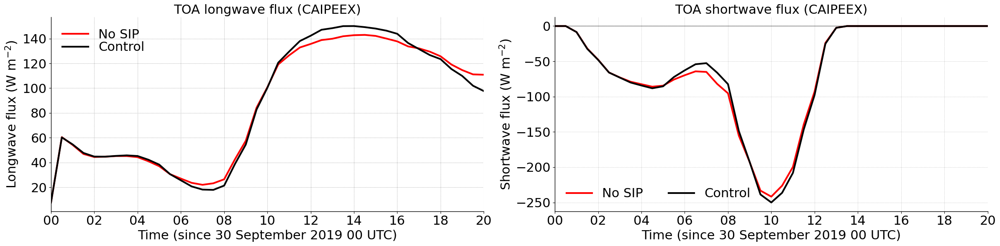

In [19]:



fnt=22;
ln=3;
plt.figure(figsize=(24, 6))
plt.style.use('default')

plt.subplot(1,2,1)
plt.plot(ds_nosip.time, ds_4sip.toa_lw_cre.mean('ncells'), 'r-', color='r', linewidth=ln, label='No SIP')
plt.plot(ds_4sip.time, ds_nosip.toa_lw_cre.mean('ncells'), 'k-', linewidth=ln, label='Control')

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
#plt.ylim(3.6, 4.4)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Longwave flux (W m$^{-2}$)', fontsize=fnt)
plt.title('TOA longwave flux (CAIPEEX)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, loc='best')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.subplot(1,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, ds_4sip.toa_sw_cre.mean('ncells'), 'r-', color='r', linewidth=ln, label='No SIP')
plt.plot(ds_4sip.time, ds_nosip.toa_sw_cre.mean('ncells'), 'k-', linewidth=ln, label='Control')

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
#plt.ylim(5,16)
plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Shortwave flux (W m$^{-2}$)', fontsize=fnt)
plt.title('TOA shortwave flux (CAIPEEX)', fontsize=fnt)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, ncols=3, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()

In [9]:

#### SIP 
toa_sw_up_4sip = ds_4sip.swflx_up.isel(height_2=0).mean('ncells') 
toa_sw_up_clr_4sip = ds_4sip.swflx_up_clr.isel(height_2=0).mean('ncells') 
toa_lw_up_4sip = ds_4sip.lwflx_up.isel(height_2=0).mean('ncells') 
toa_lw_up_clr_4sip = ds_4sip.lwflx_up_clr.isel(height_2=0).mean('ncells') 

toa_sw_dn_4sip = ds_4sip.swflx_dn.isel(height_2=0).mean('ncells') 
toa_sw_dn_clr_4sip = ds_4sip.swflx_dn_clr.isel(height_2=0).mean('ncells') 
toa_lw_dn_4sip = ds_4sip.lwflx_dn.isel(height_2=0).mean('ncells') 
toa_lw_dn_clr_4sip = ds_4sip.lwflx_dn_clr.isel(height_2=0).mean('ncells') 

toa_sw_cre_4sip = (toa_sw_dn_4sip-toa_sw_up_4sip) - (toa_sw_dn_clr_4sip-toa_sw_up_clr_4sip)
toa_lw_cre_4sip = (toa_lw_dn_4sip-toa_lw_up_4sip) - (toa_lw_dn_clr_4sip-toa_lw_up_clr_4sip)
toa_net_cre_4sip = toa_sw_cre_4sip+toa_lw_cre_4sip

ds_4sip['toa_sw_cre'] = toa_sw_cre_4sip
ds_4sip['toa_lw_cre'] = toa_lw_cre_4sip
ds_4sip['toa_net_cre'] = toa_net_cre_4sip

surf_sw_up_4sip = ds_4sip.swflx_up.isel(height_2=65).mean('ncells') 
surf_sw_up_clr_4sip = ds_4sip.swflx_up_clr.isel(height_2=65).mean('ncells') 
surf_lw_up_4sip = ds_4sip.lwflx_up.isel(height_2=65).mean('ncells') 
surf_lw_up_clr_4sip = ds_4sip.lwflx_up_clr.isel(height_2=65).mean('ncells') 

surf_sw_dn_4sip = ds_4sip.swflx_dn.isel(height_2=65).mean('ncells') 
surf_sw_dn_clr_4sip = ds_4sip.swflx_dn_clr.isel(height_2=65).mean('ncells') 
surf_lw_dn_4sip = ds_4sip.lwflx_dn.isel(height_2=65).mean('ncells') 
surf_lw_dn_clr_4sip = ds_4sip.lwflx_dn_clr.isel(height_2=65).mean('ncells') 

surf_sw_cre_4sip = (surf_sw_dn_4sip-surf_sw_up_4sip) - (surf_sw_dn_clr_4sip-surf_sw_up_clr_4sip)
surf_lw_cre_4sip = (surf_lw_dn_4sip-surf_lw_up_4sip) - (surf_lw_dn_clr_4sip-surf_lw_up_clr_4sip)
surf_net_cre_4sip = surf_sw_cre_4sip+surf_lw_cre_4sip

ds_4sip['surf_sw_cre'] = surf_sw_cre_4sip
ds_4sip['surf_lw_cre'] = surf_lw_cre_4sip
ds_4sip['surf_net_cre'] = surf_net_cre_4sip

#### No SIP 
toa_sw_up_nosip = ds_nosip.swflx_up.isel(height_2=0).mean('ncells') #ds_nosip.swflx_up[:,0,:]
toa_sw_up_clr_nosip = ds_nosip.swflx_up_clr.isel(height_2=0).mean('ncells') #ds_nosip.swflx_up_clr[:,0,:]
toa_lw_up_nosip = ds_nosip.lwflx_up.isel(height_2=0).mean('ncells') #ds_nosip.lwflx_up[:,0,:]
toa_lw_up_clr_nosip = ds_nosip.lwflx_up_clr.isel(height_2=0).mean('ncells') #ds_nosip.lwflx_up_clr[:,0,:]

toa_sw_dn_nosip = ds_nosip.swflx_dn.isel(height_2=0).mean('ncells') #ds_nosip.swflx_dn[:,0,:]
toa_sw_dn_clr_nosip = ds_nosip.swflx_dn_clr.isel(height_2=0).mean('ncells') #ds_nosip.swflx_dn_clr[:,0,:]
toa_lw_dn_nosip = ds_nosip.lwflx_dn.isel(height_2=0).mean('ncells') #ds_nosip.lwflx_dn[:,0,:]
toa_lw_dn_clr_nosip = ds_nosip.lwflx_dn_clr.isel(height_2=0).mean('ncells') #ds_nosip.lwflx_dn_clr[:,0,:]


toa_sw_cre_nosip = (toa_sw_dn_nosip-toa_sw_up_nosip) - (toa_sw_dn_clr_nosip-toa_sw_up_clr_nosip)
toa_lw_cre_nosip = (toa_lw_dn_nosip-toa_lw_up_nosip) - (toa_lw_dn_clr_nosip-toa_lw_up_clr_nosip)
toa_net_cre_nosip = toa_sw_cre_nosip+toa_lw_cre_nosip

ds_nosip['toa_sw_cre'] = toa_sw_cre_nosip
ds_nosip['toa_lw_cre'] = toa_lw_cre_nosip
ds_nosip['toa_net_cre'] = toa_net_cre_nosip
ds_nosip['del_toa_sw_cre'] = toa_sw_cre_4sip-toa_sw_cre_nosip
ds_nosip['del_toa_lw_cre'] = toa_lw_cre_4sip-toa_lw_cre_nosip
ds_nosip['del_toa_net_cre'] = toa_net_cre_4sip-toa_net_cre_nosip

surf_sw_up_nosip = ds_nosip.swflx_up.isel(height_2=65).mean('ncells') 
surf_sw_up_clr_nosip = ds_nosip.swflx_up_clr.isel(height_2=65).mean('ncells') 
surf_lw_up_nosip = ds_nosip.lwflx_up.isel(height_2=65).mean('ncells') 
surf_lw_up_clr_nosip = ds_nosip.lwflx_up_clr.isel(height_2=65).mean('ncells') 

surf_sw_dn_nosip = ds_nosip.swflx_dn.isel(height_2=65).mean('ncells') 
surf_sw_dn_clr_nosip = ds_nosip.swflx_dn_clr.isel(height_2=65).mean('ncells') 
surf_lw_dn_nosip = ds_nosip.lwflx_dn.isel(height_2=65).mean('ncells') 
surf_lw_dn_clr_nosip = ds_nosip.lwflx_dn_clr.isel(height_2=65).mean('ncells') 

surf_sw_cre_nosip = (surf_sw_dn_nosip-surf_sw_up_nosip) - (surf_sw_dn_clr_nosip-surf_sw_up_clr_nosip)
surf_lw_cre_nosip = (surf_lw_dn_nosip-surf_lw_up_nosip) - (surf_lw_dn_clr_nosip-surf_lw_up_clr_nosip)
surf_net_cre_nosip = surf_sw_cre_nosip+surf_lw_cre_nosip

ds_nosip['surf_sw_cre'] = surf_sw_cre_nosip
ds_nosip['surf_lw_cre'] = surf_lw_cre_nosip
ds_nosip['surf_net_cre'] = surf_net_cre_nosip

#### Change in CRE w.r.t. 4-SIP (control run)
del_toa_sw_cre_nosip = toa_sw_cre_4sip-toa_sw_cre_nosip
del_toa_lw_cre_nosip = toa_lw_cre_4sip-toa_lw_cre_nosip
del_toa_net_cre_nosip = toa_net_cre_4sip-toa_net_cre_nosip 
per_del_toa_sw_cre_nosip = 100*(del_toa_sw_cre_nosip)/np.abs(toa_sw_cre_4sip)
per_del_toa_sw_cre_nosip = per_del_toa_sw_cre_nosip.fillna(0)
per_del_toa_lw_cre_nosip = 100*(del_toa_lw_cre_nosip)/np.abs(toa_lw_cre_4sip)
per_del_toa_net_cre_nosip = 100*(del_toa_net_cre_nosip)/np.abs(toa_net_cre_4sip)


## Box plot of radiative fluxes, cloud cover and precipitation

In [12]:

dt_hours = (ds_nosip.time.diff('time') / np.timedelta64(1, 'h'))

acc_precip_nosip = ds_nosip.tot_prec.mean('ncells')
acc_precip_4sip = ds_4sip.tot_prec.mean('ncells')

del_prec_nosip = ds_nosip.tot_prec.diff('time')
del_prec_4sip = ds_4sip.tot_prec.diff('time')

precip_rate_nosip = del_prec_nosip/dt_hours #0.5    # output is over 30 min
precip_rate_4sip = del_prec_4sip/dt_hours

tot_acc_precip_4sip = np.nanmax(ds_4sip.tot_prec.mean('ncells'))
tot_acc_precip_nosip = np.nanmax(ds_nosip.tot_prec.mean('ncells'))

std_tot_precip_4sip = np.nanstd(ds_4sip.tot_prec.mean('ncells'))
std_tot_precip_nosip = np.nanstd(ds_nosip.tot_prec.mean('ncells'))

n_cells = ds_4sip.tot_prec.mean('ncells').count()  # count valid 'ncells'
stderr_tot_precip_4sip = std_tot_precip_4sip / np.sqrt(n_cells)

n_cells = ds_nosip.tot_prec.mean('ncells').count()  # count valid 'ncells'
stderr_tot_precip_nosip = std_tot_precip_nosip / np.sqrt(n_cells)


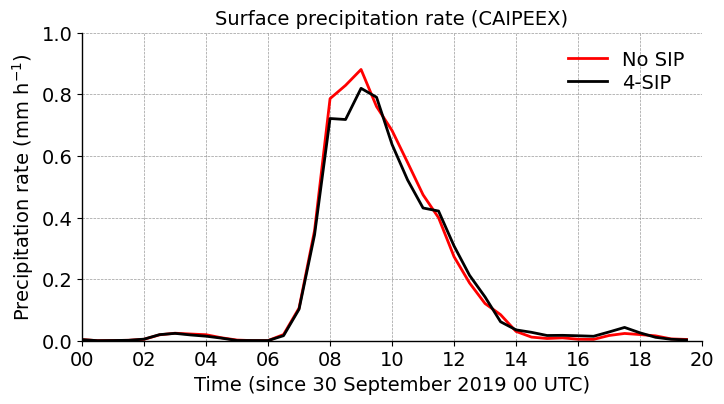

In [13]:


fontsize=14
lnwdth = 2
plt.figure(figsize=(8, 4))
plt.style.use('default')

plt.plot(ds_nosip.time[:-1], precip_rate_nosip.mean('ncells'), 'r-', linewidth=lnwdth, label='No SIP')
plt.plot(ds_4sip.time[:-1], precip_rate_4sip.mean('ncells'), 'k-', linewidth=lnwdth, label='4-SIP')

plt.grid(True, linestyle='--', color='grey', linewidth=0.5, alpha=0.8)

plt.ylabel('Precipitation rate (mm h$^{-1}$)', fontsize=fontsize)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 1)

plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.title('Surface precipitation rate (CAIPEEX)', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.2, fontsize=fontsize, loc='best')#, ncol = 1, fontsize='16', bbox_to_anchor=(1.02, 1.02))


plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_linewidth(1)
plt.gca().spines['left'].set_linewidth(1)

plt.show()


In [38]:

start_time='2019-09-30T06:00:00.000000000';
end_time='2019-09-30T14:00:00.000000000'

## 4 SIP

## TOA LW
min_toa_lw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_lw_cre.min(dim=('time','ncells')).values; 
max_toa_lw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_lw_cre.max(dim=('time','ncells')).values
mean_toa_lw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_lw_cre.mean(dim=('time','ncells')).values

std_toa_lw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_lw_cre.std(dim=('time','ncells')).values
stderr_toa_lw_cre_4sip = std_toa_lw_cre_4sip / np.sqrt(ds_4sip.sel(time=slice(start_time, end_time)).toa_lw_cre.count(dim=('time','ncells')).values)

## TOA SW
min_toa_sw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_sw_cre.min(dim=('time','ncells')).values; 
max_toa_sw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_sw_cre.max(dim=('time','ncells')).values
mean_toa_sw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_sw_cre.mean(dim=('time','ncells')).values

std_toa_sw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_sw_cre.std(dim=('time','ncells')).values
stderr_toa_sw_cre_4sip = std_toa_sw_cre_4sip / np.sqrt(ds_4sip.sel(time=slice(start_time, end_time)).toa_sw_cre.count(dim=('time','ncells')).values)

## TOA NET
min_toa_net_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_net_cre.min(dim=('time','ncells')).values; 
max_toa_net_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_net_cre.max(dim=('time','ncells')).values
mean_toa_net_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_net_cre.mean(dim=('time','ncells')).values

std_toa_net_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_net_cre.std(dim=('time','ncells')).values
stderr_toa_net_cre_4sip = std_toa_net_cre_4sip / np.sqrt(ds_4sip.sel(time=slice(start_time, end_time)).toa_net_cre.count(dim=('time','ncells')).values)

## Surface LW
min_surf_lw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_lw_cre.min(dim=('time','ncells')).values; 
max_surf_lw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_lw_cre.max(dim=('time','ncells')).values
mean_surf_lw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_lw_cre.mean(dim=('time','ncells')).values

std_surf_lw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_lw_cre.std(dim=('time','ncells')).values
stderr_surf_lw_cre_4sip = std_surf_lw_cre_4sip / np.sqrt(ds_4sip.sel(time=slice(start_time, end_time)).surf_lw_cre.count(dim=('time','ncells')).values)

## Surface SW
min_surf_sw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_sw_cre.min(dim=('time','ncells')).values; 
max_surf_sw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_sw_cre.max(dim=('time','ncells')).values
mean_surf_sw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_sw_cre.mean(dim=('time','ncells')).values

std_surf_sw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_sw_cre.std(dim=('time','ncells')).values
stderr_surf_sw_cre_4sip = std_surf_sw_cre_4sip / np.sqrt(ds_4sip.sel(time=slice(start_time, end_time)).surf_sw_cre.count(dim=('time','ncells')).values)

## Surface NET
min_surf_net_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_net_cre.min(dim=('time','ncells')).values; 
max_surf_net_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_net_cre.max(dim=('time','ncells')).values
mean_surf_net_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_net_cre.mean(dim=('time','ncells')).values

std_surf_net_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_net_cre.std(dim=('time','ncells')).values
stderr_surf_net_cre_4sip = std_surf_net_cre_4sip / np.sqrt(ds_4sip.sel(time=slice(start_time, end_time)).surf_net_cre.count(dim=('time','ncells')).values)

## No SIP
min_toa_lw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_lw_cre.min(dim=('time','ncells')).values; 
max_toa_lw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_lw_cre.max(dim=('time','ncells')).values
mean_toa_lw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_lw_cre.mean(dim=('time','ncells')).values

std_toa_lw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_lw_cre.std(dim=('time','ncells')).values
stderr_toa_lw_cre_nosip = std_toa_lw_cre_nosip / np.sqrt(ds_nosip.sel(time=slice(start_time, end_time)).toa_lw_cre.count(dim=('time','ncells')).values)

min_toa_sw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_sw_cre.min(dim=('time','ncells')).values; 
max_toa_sw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_sw_cre.max(dim=('time','ncells')).values
mean_toa_sw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_sw_cre.mean(dim=('time','ncells')).values

std_toa_sw_cre_nosip = ds_nosip.toa_sw_cre.std(dim=('time','ncells')).values
stderr_toa_sw_cre_nosip = std_toa_sw_cre_nosip / np.sqrt(ds_nosip.sel(time=slice(start_time, end_time)).toa_sw_cre.count(dim=('time','ncells')).values)

min_toa_net_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_net_cre.min(dim=('time','ncells')).values; 
max_toa_net_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_net_cre.max(dim=('time','ncells')).values
mean_toa_net_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_net_cre.mean(dim=('time','ncells')).values

std_toa_net_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_net_cre.std(dim=('time','ncells')).values
stderr_toa_net_cre_nosip = std_toa_net_cre_nosip / np.sqrt(ds_nosip.sel(time=slice(start_time, end_time)).toa_net_cre.count(dim=('time','ncells')).values)

## surface
min_surf_lw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_lw_cre.min(dim=('time','ncells')).values; 
max_surf_lw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_lw_cre.max(dim=('time','ncells')).values
mean_surf_lw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_lw_cre.mean(dim=('time','ncells')).values

std_surf_lw_cre_nosip = ds_nosip.surf_lw_cre.std(dim=('time','ncells')).values
stderr_surf_lw_cre_nosip = std_surf_lw_cre_nosip / np.sqrt(ds_nosip.sel(time=slice(start_time, end_time)).surf_lw_cre.count(dim=('time','ncells')).values)

min_surf_sw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_sw_cre.min(dim=('time','ncells')).values; 
max_surf_sw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_sw_cre.max(dim=('time','ncells')).values
mean_surf_sw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_sw_cre.mean(dim=('time','ncells')).values

std_surf_sw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_sw_cre.std(dim=('time','ncells')).values
stderr_surf_sw_cre_nosip = std_surf_sw_cre_nosip / np.sqrt(ds_nosip.sel(time=slice(start_time, end_time)).surf_sw_cre.count(dim=('time','ncells')).values)

min_surf_net_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_net_cre.min(dim=('time','ncells')).values; 
max_surf_net_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_net_cre.max(dim=('time','ncells')).values
mean_surf_net_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_net_cre.mean(dim=('time','ncells')).values

std_surf_net_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_net_cre.std(dim=('time','ncells')).values
stderr_surf_net_cre_nosip = std_surf_net_cre_nosip / np.sqrt(ds_nosip.sel(time=slice(start_time, end_time)).surf_net_cre.count(dim=('time','ncells')).values)

del_min_toa_lw_cre_nosip = min_toa_lw_cre_4sip-min_toa_lw_cre_nosip; del_max_toa_lw_cre_nosip = max_toa_lw_cre_4sip-max_toa_lw_cre_nosip;
del_mean_toa_lw_cre_nosip = mean_toa_lw_cre_4sip-mean_toa_lw_cre_nosip; 
del_min_toa_sw_cre_nosip = min_toa_sw_cre_4sip-min_toa_sw_cre_nosip; del_max_toa_sw_cre_nosip = max_toa_sw_cre_4sip-max_toa_sw_cre_nosip;
del_mean_toa_sw_cre_nosip = mean_toa_sw_cre_4sip-mean_toa_sw_cre_nosip; 
del_min_toa_net_cre_nosip = min_toa_net_cre_4sip-min_toa_net_cre_nosip; del_max_toa_net_cre_nosip = max_toa_net_cre_4sip-max_toa_net_cre_nosip;
del_mean_toa_net_cre_nosip = mean_toa_net_cre_4sip-mean_toa_net_cre_nosip; 



In [30]:

start_time='2019-09-30T06:00:00.000000000';
end_time='2019-09-30T14:00:00.000000000'

low_cld_cover_4sip = np.nanmean(ds_4sip.clcl.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev'))
std_low_cld_cover_4sip = np.nanstd(ds_4sip.clcl.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev'))
n_cells = ds_4sip.clcl.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev').count()
stderr_low_cld_cover_4sip = std_low_cld_cover_4sip / np.sqrt(n_cells)

low_cld_cover_nosip = np.nanmean(ds_nosip.clcl.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev'))
std_low_cld_cover_nosip = np.nanstd(ds_nosip.clcl.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev'))
n_cells = ds_nosip.clcl.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev').count()
stderr_low_cld_cover_nosip = std_low_cld_cover_nosip / np.sqrt(n_cells)

mid_cld_cover_4sip = np.nanmean(ds_4sip.clcm.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_2'))
std_mid_cld_cover_4sip = np.nanstd(ds_4sip.clcm.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_2'))
n_cells = ds_4sip.clcm.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_2').count()
stderr_mid_cld_cover_4sip = std_mid_cld_cover_4sip / np.sqrt(n_cells)

mid_cld_cover_nosip = np.nanmean(ds_nosip.clcm.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_2'))
std_mid_cld_cover_nosip = np.nanstd(ds_nosip.clcm.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_2'))
n_cells = ds_nosip.clcm.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_2').count()
stderr_mid_cld_cover_nosip = std_mid_cld_cover_nosip / np.sqrt(n_cells)

high_cld_cover_4sip = np.nanmean(ds_4sip.clch.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_3'))
std_high_cld_cover_4sip = np.nanstd(ds_4sip.clch.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_3'))
n_cells = ds_4sip.clch.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_3').count()
stderr_high_cld_cover_4sip = std_high_cld_cover_4sip / np.sqrt(n_cells)

high_cld_cover_nosip = np.nanmean(ds_nosip.clch.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_3'))
std_high_cld_cover_nosip = np.nanstd(ds_nosip.clch.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_3'))
n_cells = ds_nosip.clch.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_3').count()
stderr_high_cld_cover_nosip = std_high_cld_cover_nosip / np.sqrt(n_cells)

tot_cld_cover_4sip = np.nanmean(ds_4sip.clct.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('ncells'))
std_tot_cld_cover_4sip = np.nanstd(ds_4sip.clct.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('ncells'))
n_cells = ds_4sip.clct.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('ncells').count()
stderr_tot_cld_cover_4sip = std_tot_cld_cover_4sip / np.sqrt(n_cells)

tot_cld_cover_nosip = np.nanmean(ds_nosip.clct.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('ncells'))
std_tot_cld_cover_nosip = np.nanstd(ds_nosip.clct.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('ncells'))
n_cells = ds_nosip.clct.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('ncells').count()
stderr_tot_cld_cover_nosip = std_tot_cld_cover_nosip / np.sqrt(n_cells)

#low_cld_cover_4sip = np.nanmean(ds_4sip.clcl.mean('plev'))
#low_cld_cover_nosip = np.nanmean(ds_nosip.clcl.mean('plev'))

#mid_cld_cover_4sip = np.nanmean(ds_4sip.clcm.mean('plev_2'))
#mid_cld_cover_nosip = np.nanmean(ds_nosip.clcm.mean('plev_2'))

#high_cld_cover_4sip = np.nanmean(ds_4sip.clch.mean('plev_3'))
#high_cld_cover_nosip = np.nanmean(ds_nosip.clch.mean('plev_3'))

#tot_cld_cover_4sip = np.nanmean(ds_4sip.clct.mean('ncells'))
#tot_cld_cover_nosip = np.nanmean(ds_nosip.clct.mean('ncells'))


In [ ]:
#stderr_tot_precip_4sip = stderr_tot_precip_4sip.values
#stderr_tot_precip_nosip = stderr_tot_precip_nosip.values

#stderr_low_cld_cover_4sip = stderr_low_cld_cover_4sip.values
#stderr_low_cld_cover_nosip = stderr_low_cld_cover_nosip.values
#stderr_mid_cld_cover_4sip = stderr_mid_cld_cover_4sip.values
#stderr_mid_cld_cover_nosip = stderr_mid_cld_cover_nosip.values
#stderr_high_cld_cover_4sip = stderr_high_cld_cover_4sip.values
#stderr_high_cld_cover_nosip = stderr_high_cld_cover_nosip.values
#stderr_tot_cld_cover_4sip = stderr_tot_cld_cover_4sip.values
#stderr_tot_cld_cover_nosip = stderr_tot_cld_cover_nosip.values

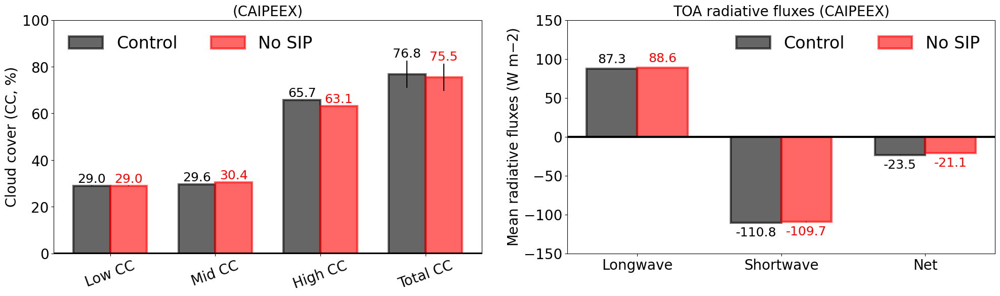

In [41]:

#group_cc_4sip = [tot_acc_precip_4sip, low_cld_cover_4sip, mid_cld_cover_4sip, high_cld_cover_4sip, tot_cld_cover_4sip]
#group_cc_nosip = [tot_acc_precip_nosip, low_cld_cover_nosip, mid_cld_cover_nosip, high_cld_cover_nosip, tot_cld_cover_nosip]

group_cc_4sip = [low_cld_cover_4sip, mid_cld_cover_4sip, high_cld_cover_4sip, tot_cld_cover_4sip]
group_cc_nosip = [low_cld_cover_nosip, mid_cld_cover_nosip, high_cld_cover_nosip, tot_cld_cover_nosip]

#stderr_cc_4sip = [stderr_tot_precip_4sip, stderr_low_cld_cover_4sip, stderr_mid_cld_cover_4sip, stderr_high_cld_cover_4sip, stderr_tot_cld_cover_4sip];
#stderr_cc_nosip = [stderr_tot_precip_nosip, stderr_low_cld_cover_nosip, stderr_mid_cld_cover_nosip, stderr_high_cld_cover_nosip, stderr_tot_cld_cover_nosip];

stderr_cc_4sip = [stderr_low_cld_cover_4sip, stderr_mid_cld_cover_4sip, stderr_high_cld_cover_4sip, stderr_tot_cld_cover_4sip];
stderr_cc_nosip = [stderr_low_cld_cover_nosip, stderr_mid_cld_cover_nosip, stderr_high_cld_cover_nosip, stderr_tot_cld_cover_nosip];

#stderr_cc_4sip = [std_tot_precip_4sip, std_low_cld_cover_4sip, std_mid_cld_cover_4sip, std_high_cld_cover_4sip, std_tot_cld_cover_4sip];
#stderr_cc_nosip = [std_tot_precip_nosip, std_low_cld_cover_nosip, std_mid_cld_cover_nosip, std_high_cld_cover_nosip, std_tot_cld_cover_nosip];

group_flux_4sip = [mean_toa_lw_cre_4sip, mean_toa_sw_cre_4sip, mean_toa_net_cre_4sip]
group_flux_nosip = [mean_toa_lw_cre_nosip, mean_toa_sw_cre_nosip, mean_toa_net_cre_nosip]

stderr_flux_4sip = [stderr_toa_lw_cre_4sip, stderr_toa_sw_cre_4sip, stderr_toa_net_cre_4sip];
stderr_flux_nosip = [stderr_toa_lw_cre_nosip, stderr_toa_sw_cre_nosip, stderr_toa_net_cre_nosip];

#stderr_flux_4sip = [std_toa_lw_cre_4sip, std_toa_sw_cre_4sip, std_toa_net_cre_4sip];
#stderr_flux_nosip = [std_toa_lw_cre_nosip, std_toa_sw_cre_nosip, std_toa_net_cre_nosip];

#cc_comp_groups = ['Precipitation', 'Low CC', 'Mid CC', 'High CC', 'Total CC']
cc_comp_groups = ['Low CC', 'Mid CC', 'High CC', 'Total CC']
rad_flux_comp_groups = ['Longwave', 'Shortwave', 'Net']

x_cc = np.arange(len(cc_comp_groups))
x_flux = np.arange(len(rad_flux_comp_groups))

fnt=20;
ln=3;
alp=0.6
width = 0.35  # width of the bars

fig, axs = plt.subplots(1, 2, figsize=(24, 6), sharey=False)
plt.style.use('default')

ax1 = axs[0]

ax1.axhline(y=0, color='k', linewidth=ln, linestyle='-')

rects1 = ax1.bar(x_cc - width/2, group_cc_4sip, width, yerr=stderr_cc_4sip, color='black', facecolor='k', edgecolor='k', linewidth=ln, alpha=alp, label='Control')
rects2 = ax1.bar(x_cc + width/2, group_cc_nosip, width, yerr=stderr_cc_nosip, color='red', facecolor='r', edgecolor='r', linewidth=ln, alpha=alp, label='No SIP')

ax1.bar_label(rects1, padding=1, color='k', fontsize=fnt-2, fmt='%.1f')
ax1.bar_label(rects2, padding=1, color='r', fontsize=fnt-2, fmt='%.1f')

# For the left bars (rects1)
#for rect in rects1:
#    # Shift left by a small amount (e.g., -0.1)
#    x = rect.get_x() + rect.get_width() / 2 - 0.1  # Shift left for left bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='k', fontsize=fnt-2)

# For the right bars (rects2)
#for rect in rects2:
#    # Shift right by a small amount (e.g., +0.1)
#    x = rect.get_x() + rect.get_width() / 2 + 0.1  # Shift right for right bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='r', fontsize=fnt-2)
    
# Customization
ax1.set_ylim(0,100)
#ax1.set_ylabel('Accumulated precipitation (mm) \nand cloud cover (CC, %)', fontsize=fnt)
ax1.set_ylabel('Cloud cover (CC, %)', fontsize=fnt)
ax1.set_xticks(x_cc)
ax1.set_xticklabels(cc_comp_groups, rotation=20)
ax1.set_title('(CAIPEEX)', fontsize=fnt)
ax1.tick_params(axis='both', labelsize=fnt)

ax1.legend(frameon=False, handlelength=2, labelspacing=0.2, ncols=2, fontsize=fnt+4, loc='best')

# ---------------------------------------------
# Subplot 2: Vertical velocity (w)
# ---------------------------------------------

ax2 = axs[1]

ax2.axhline(y=0, color='k', linewidth=ln, linestyle='-')

rects1 = ax2.bar(x_flux - width/2, group_flux_4sip, width, yerr=stderr_flux_4sip, color='black', facecolor='k', edgecolor='k', linewidth=ln, alpha=alp, label='Control')
rects2 = ax2.bar(x_flux + width/2, group_flux_nosip, width, yerr=stderr_flux_nosip, color='red', facecolor='r', edgecolor='r', linewidth=ln, alpha=alp, label='No SIP')

ax2.bar_label(rects1, padding=5, color='k', fontsize=fnt-2, fmt='%.1f')
ax2.bar_label(rects2, padding=5, color='r', fontsize=fnt-2, fmt='%.1f')

# For the left bars (rects1)
#for rect in rects1:
#    # Shift left by a small amount (e.g., -0.1)
#    x = rect.get_x() + rect.get_width() / 2 - 0.1  # Shift left for left bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='k', fontsize=fnt-2)

# For the right bars (rects2)
#for rect in rects2:
#    # Shift right by a small amount (e.g., +0.1)
#    x = rect.get_x() + rect.get_width() / 2 + 0.1  # Shift right for right bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='r', fontsize=fnt-2)
    
# Customization
ax2.set_ylim(-150,150)
ax2.set_ylabel('Mean radiative fluxes (W m${-2}$)', fontsize=fnt)
ax2.set_xticks(x_flux)
ax2.set_xticklabels(rad_flux_comp_groups, rotation=0)
ax2.set_title('TOA radiative fluxes (CAIPEEX)', fontsize=fnt)
ax2.tick_params(axis='both', labelsize=fnt)

ax2.legend(frameon=False, handlelength=2, labelspacing=0.2, ncols=2, fontsize=fnt+4, loc='best')

#plt.tight_layout()
plt.show()


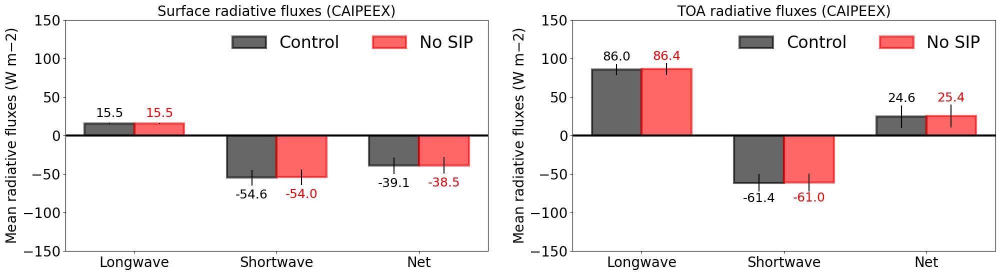

In [101]:

group_surf_flux_4sip = [mean_surf_lw_cre_4sip, mean_surf_sw_cre_4sip, mean_surf_net_cre_4sip]
group_surf_flux_nosip = [mean_surf_lw_cre_nosip, mean_surf_sw_cre_nosip, mean_surf_net_cre_nosip]

err_surf_flux_4sip = [stderr_surf_lw_cre_4sip, stderr_surf_sw_cre_4sip, stderr_surf_net_cre_4sip];
err_surf_flux_nosip = [stderr_surf_lw_cre_nosip, stderr_surf_sw_cre_nosip, stderr_surf_net_cre_nosip];

#err_surf_flux_4sip = [std_surf_lw_cre_4sip, std_surf_sw_cre_4sip, std_surf_net_cre_4sip];
#err_surf_flux_nosip = [std_surf_lw_cre_nosip, std_surf_sw_cre_nosip, std_surf_net_cre_nosip];

group_toa_flux_4sip = [mean_toa_lw_cre_4sip, mean_toa_sw_cre_4sip, mean_toa_net_cre_4sip]
group_toa_flux_nosip = [mean_toa_lw_cre_nosip, mean_toa_sw_cre_nosip, mean_toa_net_cre_nosip]

err_toa_flux_4sip = [stderr_toa_lw_cre_4sip, stderr_toa_sw_cre_4sip, stderr_toa_net_cre_4sip];
err_toa_flux_nosip = [stderr_toa_lw_cre_nosip, stderr_toa_sw_cre_nosip, stderr_toa_net_cre_nosip];

#err_toa_flux_4sip = [std_toa_lw_cre_4sip, std_toa_sw_cre_4sip, std_toa_net_cre_4sip];
#err_toa_flux_nosip = [std_toa_lw_cre_nosip, std_toa_sw_cre_nosip, std_toa_net_cre_nosip];

#stderr_flux_4sip = [std_toa_lw_cre_4sip, std_toa_sw_cre_4sip, std_toa_net_cre_4sip];
#stderr_flux_nosip = [std_toa_lw_cre_nosip, std_toa_sw_cre_nosip, std_toa_net_cre_nosip];

cc_comp_groups = ['Precipitation', 'Low CC', 'Mid CC', 'High CC', 'Total CC']
rad_flux_comp_groups = ['Longwave', 'Shortwave', 'Net']

x_cc = np.arange(len(cc_comp_groups))
x_flux = np.arange(len(rad_flux_comp_groups))

fnt=20;
ln=3;
alp=0.6
width = 0.35  # width of the bars

fig, axs = plt.subplots(1, 2, figsize=(24, 6), sharey=False)
plt.style.use('default')

ax1 = axs[0]

ax1.axhline(y=0, color='k', linewidth=ln, linestyle='-')

rects1 = ax1.bar(x_flux - width/2, group_surf_flux_4sip, width, yerr=err_surf_flux_4sip, color='black', facecolor='k', edgecolor='k', linewidth=ln, alpha=alp, label='Control')
rects2 = ax1.bar(x_flux + width/2, group_surf_flux_nosip, width, yerr=err_surf_flux_nosip, color='red', facecolor='r', edgecolor='r', linewidth=ln, alpha=alp, label='No SIP')

ax1.bar_label(rects1, padding=5, color='k', fontsize=fnt-2, fmt='%.1f')
ax1.bar_label(rects2, padding=5, color='r', fontsize=fnt-2, fmt='%.1f')

# For the left bars (rects1)
#for rect in rects1:
#    # Shift left by a small amount (e.g., -0.1)
#    x = rect.get_x() + rect.get_width() / 2 - 0.1  # Shift left for left bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='k', fontsize=fnt-2)

# For the right bars (rects2)
#for rect in rects2:
#    # Shift right by a small amount (e.g., +0.1)
#    x = rect.get_x() + rect.get_width() / 2 + 0.1  # Shift right for right bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='r', fontsize=fnt-2)
    
# Customization
ax1.set_ylim(-150,150)
ax1.set_ylabel('Mean radiative fluxes (W m${-2}$)', fontsize=fnt)
ax1.set_xticks(x_flux)
ax1.set_xticklabels(rad_flux_comp_groups, rotation=0)
ax1.set_title('Surface radiative fluxes (CAIPEEX)', fontsize=fnt)
ax1.tick_params(axis='both', labelsize=fnt)

ax1.legend(frameon=False, handlelength=2, labelspacing=0.2, ncols=2, fontsize=fnt+4, loc='best')

# ---------------------------------------------
# Subplot 2: Vertical velocity (w)
# ---------------------------------------------

ax2 = axs[1]

ax2.axhline(y=0, color='k', linewidth=ln, linestyle='-')

rects1 = ax2.bar(x_flux - width/2, group_toa_flux_4sip, width, yerr=err_toa_flux_4sip, color='black', facecolor='k', edgecolor='k', linewidth=ln, alpha=alp, label='Control')
rects2 = ax2.bar(x_flux + width/2, group_toa_flux_nosip, width, yerr=err_toa_flux_nosip, color='red', facecolor='r', edgecolor='r', linewidth=ln, alpha=alp, label='No SIP')

ax2.bar_label(rects1, padding=1, color='k', fontsize=fnt-2, fmt='%.1f')
ax2.bar_label(rects2, padding=1, color='r', fontsize=fnt-2, fmt='%.1f')

# For the left bars (rects1)
#for rect in rects1:
#    # Shift left by a small amount (e.g., -0.1)
#    x = rect.get_x() + rect.get_width() / 2 - 0.1  # Shift left for left bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='k', fontsize=fnt-2)

# For the right bars (rects2)
#for rect in rects2:
#    # Shift right by a small amount (e.g., +0.1)
#    x = rect.get_x() + rect.get_width() / 2 + 0.1  # Shift right for right bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='r', fontsize=fnt-2)
    
# Customization
ax2.set_ylim(-150,150)
ax2.set_ylabel('Mean radiative fluxes (W m${-2}$)', fontsize=fnt)
ax2.set_xticks(x_flux)
ax2.set_xticklabels(rad_flux_comp_groups, rotation=0)
ax2.set_title('TOA radiative fluxes (CAIPEEX)', fontsize=fnt)
ax2.tick_params(axis='both', labelsize=fnt)


ax2.legend(frameon=False, handlelength=2, labelspacing=0.2, ncols=2, fontsize=fnt+4, loc='best')

#plt.tight_layout()
plt.show()


In [19]:

#SW CRE = (Qcld_sw_dn - Qcld_sw_up) - (Qclear_sw_dn - Qclear_sw_up)
#LW CRE = (Qcld_lw_dn - Qcld_lw_up) - (Qclear_lw_dn - Qclear_lw_up)

ds_4sip['net_sw_cre'] = (ds_4sip.swflx_dn - ds_4sip.swflx_up) - (ds_4sip.swflx_dn_clr - ds_4sip.swflx_up_clr)
ds_4sip['net_lw_cre'] = (ds_4sip.lwflx_dn - ds_4sip.lwflx_up) - (ds_4sip.lwflx_dn_clr - ds_4sip.lwflx_up_clr)
ds_4sip['net_tot_cre'] = ds_4sip.net_sw_cre + ds_4sip.net_lw_cre

ds_nosip['net_sw_cre'] = (ds_nosip.swflx_dn - ds_nosip.swflx_up) - (ds_nosip.swflx_dn_clr - ds_nosip.swflx_up_clr)
ds_nosip['net_lw_cre'] = (ds_nosip.lwflx_dn - ds_nosip.lwflx_up) - (ds_nosip.lwflx_dn_clr - ds_nosip.lwflx_up_clr)
ds_nosip['net_tot_cre'] = ds_nosip.net_sw_cre + ds_nosip.net_lw_cre

In [93]:

print(ds_4sip.net_sw_cre.mean(dim=('ncells')).min().values, ds_4sip.net_sw_cre.mean(dim=('ncells')).max().values)
print(ds_4sip.net_lw_cre.mean(dim=('ncells')).min().values, ds_4sip.net_lw_cre.mean(dim=('ncells')).max().values)
print(ds_4sip.net_tot_cre.mean(dim=('ncells')).min().values, ds_4sip.net_tot_cre.mean(dim=('ncells')).max().values)

-282.99152 0.0
2.9681323 166.4839
-221.28284 166.4839


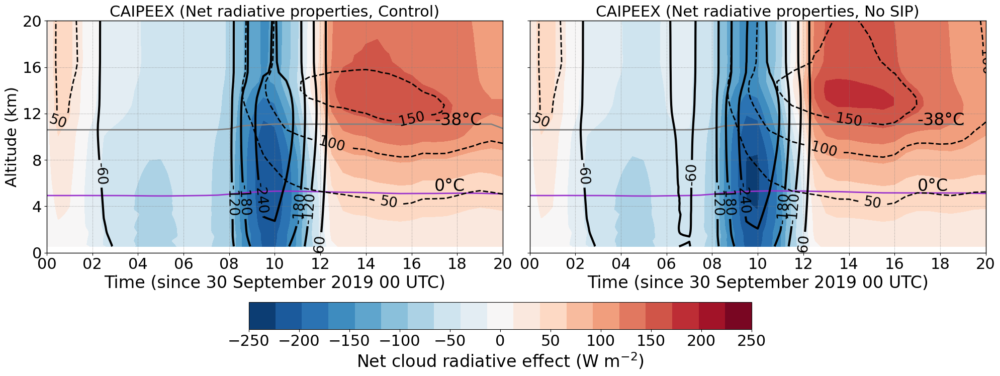

In [96]:

import matplotlib.lines as mlines

fnt=22;
fnt1=22;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-250, 250, 20)
#lev1 = np.linspace(1, 1200, 20)
#lev2 = np.linspace(-4, 10, 20)
plt.figure(figsize=(20, 6))
plt.style.use('default')

plt.subplot(1,2,1)
cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, ds_4sip.net_tot_cre.mean(dim=('ncells')).isel(height_2=slice(0, 65)).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[0, 2, 4, 6, 8, 10, 12])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[34], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[34], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (Net radiative properties, Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.arange(-300, 0, 60)
#contour_levels = np.linspace(1, 1200, 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.net_sw_cre.mean(dim=('ncells')).isel(height_2=slice(0, 65)).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1+1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

contour_levels = np.arange(0, 200, 50)
#contour_levels = np.linspace(1, 1200, 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.net_lw_cre.mean(dim=('ncells')).isel(height_2=slice(0, 65)).T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,2,2)
cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_nosip.net_tot_cre.mean(dim=('ncells')).isel(height_2=slice(0, 65)).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-4, -2, 0, 2, 4, 6, 8, 10, 12])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of Total INC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[34], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[34], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (Net radiative properties, No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.arange(-300, 0, 60)
#contour_levels = np.linspace(1, 1200, 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.net_sw_cre.mean(dim=('ncells')).isel(height_2=slice(0, 65)).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1+1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

contour_levels = np.arange(0, 200, 50)
#contour_levels = np.linspace(1, 1200, 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.net_lw_cre.mean(dim=('ncells')).isel(height_2=slice(0, 65)).T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()  # Get the current figure
cbar_ax = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar = fig.colorbar(cnt, cax=cbar_ax, ticks=[-250, -200, -150, -100, -50, 0, 50, 100, 150, 200, 250], orientation='horizontal')
#cbar = fig.colorbar(cnt, cax=cbar_ax, ticks=[1, 1000, 2000, 3000, 4000], orientation='horizontal')#, ticks=[-4, -2, 0, 2, 4, 6, 8, 10, 12], orientation='horizontal')
cbar.set_label('Net cloud radiative effect (W m$^{-2}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt)

plt.tight_layout()
plt.show()


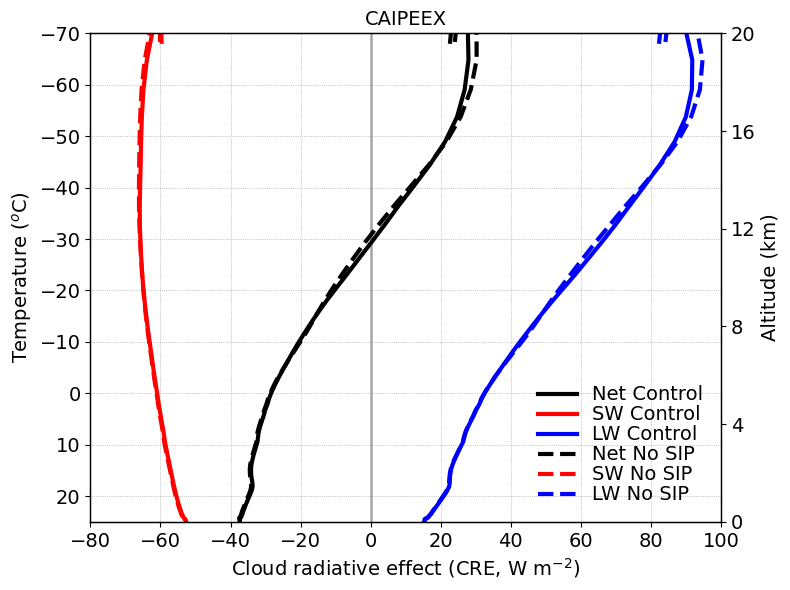

In [20]:

fontsize=14;
lnwdth=3;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(ds_4sip.net_tot_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Net Control')
plt1.plot(ds_4sip.net_sw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'r-', linewidth=lnwdth, label='SW Control')
plt1.plot(ds_4sip.net_lw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'b-', linewidth=lnwdth, label='LW Control')

plt1.plot(ds_nosip.net_tot_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'k--', linewidth=lnwdth, label='Net No SIP')
plt1.plot(ds_nosip.net_sw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'r--', linewidth=lnwdth, label='SW No SIP')
plt1.plot(ds_nosip.net_lw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'b--', linewidth=lnwdth, label='LW No SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(ds_nosip.net_lw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(-80., 100)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([-4, -2, 0, 2, 4, 6, 8, 10])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Cloud radiative effect (CRE, W m$^{-2}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt.title('CAIPEEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


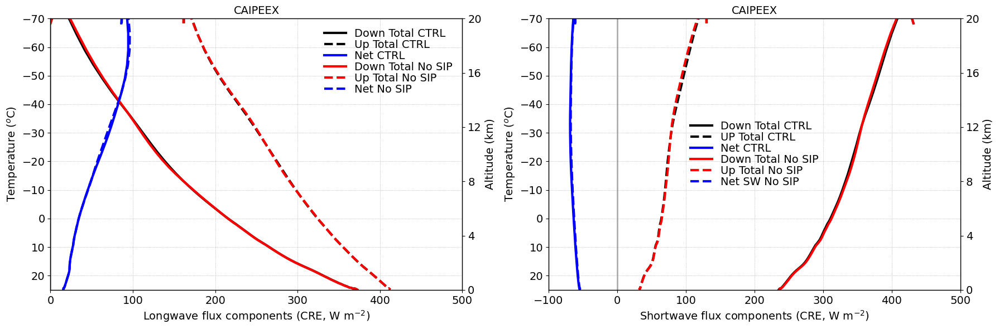

In [20]:

fontsize=14;
lnwdth=3;
alpha=0.8;

plt.figure(figsize=(18, 6))
plt.style.use('default')

plt.subplot(1,2,1)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(ds_4sip.lwflx_dn.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Down Total CTRL')
plt1.plot(ds_4sip.lwflx_up.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'k--', linewidth=lnwdth, label='Up Total CTRL')
plt1.plot(ds_4sip.net_lw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'b-', linewidth=lnwdth, label='Net CTRL')

plt1.plot(ds_nosip.lwflx_dn.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'r-', linewidth=lnwdth, label='Down Total No SIP')
plt1.plot(ds_nosip.lwflx_up.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'r--', linewidth=lnwdth, label='Up Total No SIP')
plt1.plot(ds_nosip.net_lw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'b--', linewidth=lnwdth, label='Net No SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(ds_nosip.net_lw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(00., 500)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([-4, -2, 0, 2, 4, 6, 8, 10])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Longwave flux components (CRE, W m$^{-2}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt.title('CAIPEEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)


plt.subplot(1,2,2)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(ds_4sip.swflx_dn.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Down Total CTRL')
plt1.plot(ds_4sip.swflx_up.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'k--', linewidth=lnwdth, label='UP Total CTRL')
plt1.plot(ds_4sip.net_sw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'b-', linewidth=lnwdth, label='Net CTRL')

plt1.plot(ds_nosip.swflx_dn.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'r-', linewidth=lnwdth, label='Down Total No SIP')
plt1.plot(ds_nosip.swflx_up.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'r--', linewidth=lnwdth, label='Up Total No SIP')
plt1.plot(ds_nosip.net_sw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'b--', linewidth=lnwdth, label='Net SW No SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(ds_nosip.net_lw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(-100., 500)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([-4, -2, 0, 2, 4, 6, 8, 10])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Shortwave flux components (CRE, W m$^{-2}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt.title('CAIPEEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)
plt.tight_layout()
plt.show()


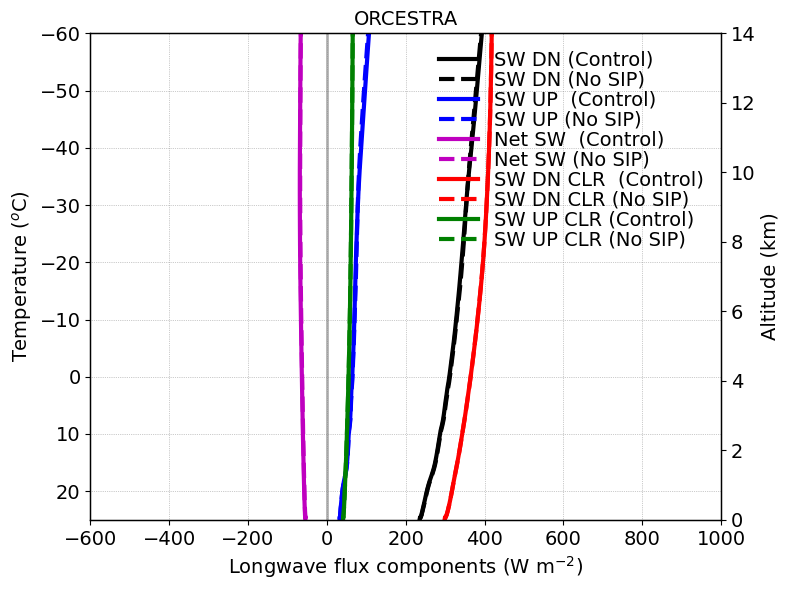

In [21]:

fontsize=14;
lnwdth=3;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)

plt1.plot(ds_4sip.swflx_dn.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'k-', linewidth=lnwdth, label='SW DN (Control)')
plt1.plot(ds_nosip.swflx_dn.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'k--', linewidth=lnwdth, label='SW DN (No SIP)')

plt1.plot(ds_4sip.swflx_up.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'b-', linewidth=lnwdth, label='SW UP  (Control)')
plt1.plot(ds_nosip.swflx_up.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'b--', linewidth=lnwdth, label='SW UP (No SIP)')

plt1.plot(ds_4sip.net_sw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'm-', linewidth=lnwdth, label='Net SW  (Control)')
plt1.plot(ds_nosip.net_sw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'm--', linewidth=lnwdth, label='Net SW (No SIP)')


plt1.plot(ds_4sip.swflx_dn_clr.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'r-', linewidth=lnwdth, label='SW DN CLR  (Control)')
plt1.plot(ds_nosip.swflx_dn_clr.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'r--', linewidth=lnwdth, label='SW DN CLR (No SIP)')

plt1.plot(ds_4sip.swflx_up_clr.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'g-', linewidth=lnwdth, label='SW UP CLR (Control)')
plt1.plot(ds_nosip.swflx_up_clr.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'g--', linewidth=lnwdth, label='SW UP CLR (No SIP)')


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(ds_nosip.net_lw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(-600., 1000)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([-40, -20, 0, 20, 40, 60, 80, 100])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Longwave flux components (W m$^{-2}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


In [7]:

#SW CRE = (Qcld_sw_dn - Qcld_sw_up) - (Qclear_sw_dn - Qclear_sw_up)
#LW CRE = (Qcld_lw_dn - Qcld_lw_up) - (Qclear_lw_dn - Qclear_lw_up)

ds_4sip['net_sw_cre'] = (ds_4sip.swflx_dn - ds_4sip.swflx_up) - (ds_4sip.swflx_dn_clr - ds_4sip.swflx_up_clr)
ds_4sip['net_lw_cre'] = (ds_4sip.lwflx_dn - ds_4sip.lwflx_up) - (ds_4sip.lwflx_dn_clr - ds_4sip.lwflx_up_clr)
ds_4sip['net_tot_cre'] = ds_4sip.net_sw_cre + ds_4sip.net_lw_cre

ds_nosip['net_sw_cre'] = (ds_nosip.swflx_dn - ds_nosip.swflx_up) - (ds_nosip.swflx_dn_clr - ds_nosip.swflx_up_clr)
ds_nosip['net_lw_cre'] = (ds_nosip.lwflx_dn - ds_nosip.lwflx_up) - (ds_nosip.lwflx_dn_clr - ds_nosip.lwflx_up_clr)
ds_nosip['net_tot_cre'] = ds_nosip.net_sw_cre + ds_nosip.net_lw_cre


In [55]:

def lwc_netcre_ht_avg(ds, lwc_var='lwc_gperm3', netcre_var='net_tot_cre', height='height', height2='height_2'):
    # Average over height for lwc
    lwc_mean = ds[lwc_var].mean(dim=height)

    # Interpolate net CRE to match height, then average
    netcre_interp = ds[netcre_var].interp({height2: ds[height]})
    netcre_mean = netcre_interp.mean(dim=height)

    return lwc_mean, netcre_mean

def lwc_swcre_ht_avg(ds, lwc_var='lwc_gperm3', swcre_var='net_sw_cre', height='height', height2='height_2'):
    # Average over height for lwc
    lwc_mean = ds[lwc_var].mean(dim=height)

    # Interpolate net CRE to match height, then average    
    swcre_interp = ds[swcre_var].interp({height2: ds[height]})
    swcre_mean = swcre_interp.mean(dim=height)

    return lwc_mean, swcre_mean

def lwc_lwcre_ht_avg(ds, lwc_var='lwc_gperm3', lwcre_var='net_lw_cre', height='height', height2='height_2'):
    # Average over height for lwc
    lwc_mean = ds[lwc_var].mean(dim=height)

    # Interpolate net CRE to match height, then average
    lwcre_interp = ds[lwcre_var].interp({height2: ds[height]})
    lwcre_mean = lwcre_interp.mean(dim=height)

    return lwc_mean, lwcre_mean




def iwc_ht_avg(ds, iwc_var='tiwc_gperm3', height='height'):
    # Average over height for lwc
    iwc_mean = ds[iwc_var].mean(dim=height)

    return iwc_mean


def cdnc_ht_avg(ds, cdnc_var='cdnc_percm3', height='height'):
    # Average over height for lwc
    cdnc_mean = ds[cdnc_var].mean(dim=height)

    return cdnc_mean

def tinc_ht_avg(ds, tinc_var='inc_perl', height='height'):
    # Average over height for lwc
    tinc_mean = ds[tinc_var].mean(dim=height)

    return tinc_mean


def wvel_lhr_ncells_avg(ds, w_var='w_vel', lhr_var='lhr_kperd', height='height', ncells='ncells', time='time'):
    w_mean = ds[w_var].mean(dim=ncells)
    w_min = ds[w_var].min(dim=ncells)
    w_max = ds[w_var].max(dim=ncells)
    lhr_mean = ds[lhr_var].mean(dim=ncells)
    return lhr_mean, w_mean, w_min, w_max 

    
#def average_over_height(ds, lwc_var='lwc_gperm3', netcre_var='net_tot_cre', height='height', height2='height_2'):
#    # Average over height for lwc
#    lwc_mean = ds[lwc_var].mean(dim=height)#
#
#    # Interpolate net CRE to match height, then average
#    netcre_interp = ds[netcre_var].interp({height2: ds[height]})
#    netcre_mean = netcre_interp.mean(dim=height)
#
#    return lwc_mean, netcre_mean



In [9]:

lwc_4sip, netcre_4sip = lwc_netcre_ht_avg(ds_4sip)
lwc_nosip, netcre_nosip = lwc_netcre_ht_avg(ds_nosip)

lwc_4sip, swcre_4sip = lwc_swcre_ht_avg(ds_4sip)
lwc_nosip, swcre_nosip = lwc_swcre_ht_avg(ds_nosip)

lwc_4sip, lwcre_4sip = lwc_lwcre_ht_avg(ds_4sip)
lwc_nosip, lwcre_nosip = lwc_lwcre_ht_avg(ds_nosip)


# Flatten to 1D
lwc_4sip = lwc_4sip.values.flatten()
netcre_4sip = netcre_4sip.values.flatten()
swcre_4sip = swcre_4sip.values.flatten()
lwcre_4sip = lwcre_4sip.values.flatten()

lwc_nosip = lwc_nosip.values.flatten()
netcre_nosip = netcre_nosip.values.flatten()
swcre_nosip = swcre_nosip.values.flatten()
lwcre_nosip = lwcre_nosip.values.flatten()


iwc_4sip= iwc_ht_avg(ds_4sip)
iwc_nosip = iwc_ht_avg(ds_nosip)

iwc_4sip = iwc_4sip.values.flatten()
iwc_nosip = iwc_nosip.values.flatten()


cdnc_4sip= cdnc_ht_avg(ds_4sip)
cdnc_nosip = cdnc_ht_avg(ds_nosip)

cdnc_4sip = cdnc_4sip.values.flatten()
cdnc_nosip = cdnc_nosip.values.flatten()

tinc_4sip= tinc_ht_avg(ds_4sip)
tinc_nosip = tinc_ht_avg(ds_nosip)

tinc_4sip = tinc_4sip.values.flatten()
tinc_nosip = tinc_nosip.values.flatten()


In [29]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import binned_statistic

def bin_avg(x, y, bins):
    # Compute bin means and stds
    bin_means, bin_edges, _ = binned_statistic(x, y, statistic='mean', bins=bins)
    bin_x_means, _, _ = binned_statistic(x, x, statistic='mean', bins=bins)
    bin_x_stds, _, _ = binned_statistic(x, x, statistic='std', bins=bins)
    bin_y_stds, _, _ = binned_statistic(x, y, statistic='std', bins=bins)

    # Count per bin for std error
    bin_counts, _, _ = binned_statistic(x, y, statistic='count', bins=bins)
    bin_x_err = bin_x_stds / np.sqrt(bin_counts)
    bin_y_err = bin_y_stds / np.sqrt(bin_counts)

    return bin_x_means, bin_means, bin_x_err, bin_y_err


In [12]:
# Filter to reasonable LWC range (e.g., non-zero, realistic values)
mask_lwc_4sip = (lwc_4sip > 1e-3)
mask_lwc_nosip = (lwc_nosip > 1e-3)

mask_iwc_4sip = (iwc_4sip > 1e-3)
mask_iwc_nosip = (iwc_nosip > 1e-3)

mask_cdnc_4sip = (cdnc_4sip > 1e-3)
mask_cdnc_nosip = (cdnc_nosip > 1e-3)

mask_tinc_4sip = (tinc_4sip > 1e-3)
mask_tinc_nosip = (tinc_nosip > 1e-3)

lwc_bins = np.linspace(0, np.nanmax([lwc_4sip, lwc_nosip]), 8)  # ~25 bins
iwc_bins = np.linspace(0, np.nanmax([iwc_4sip, iwc_nosip]), 8)

# CONTROL
binned_lwc_4sip, binned_netcre_4sip, err_lwc_4sip, err_netcre_4sip = bin_avg(lwc_4sip[mask_lwc_4sip], netcre_4sip[mask_lwc_4sip], lwc_bins)
binned_lwc_4sip, binned_swcre_4sip, err_lwc_4sip, err_swcre_4sip = bin_avg(lwc_4sip[mask_lwc_4sip], swcre_4sip[mask_lwc_4sip], lwc_bins)
binned_lwc_4sip, binned_lwcre_4sip, err_lwc_4sip, err_lwcre_4sip = bin_avg(lwc_4sip[mask_lwc_4sip], lwcre_4sip[mask_lwc_4sip], lwc_bins)

binned_iwc_4sip, binned_netcre_4sip, err_iwc_4sip, err_netcre_4sip = bin_avg(iwc_4sip[mask_iwc_4sip], netcre_4sip[mask_iwc_4sip], iwc_bins)
binned_iwc_4sip, binned_swcre_4sip, err_iwc_4sip, err_swcre_4sip = bin_avg(iwc_4sip[mask_iwc_4sip], swcre_4sip[mask_iwc_4sip], iwc_bins)
binned_iwc_4sip, binned_lwcre_4sip, err_iwc_4sip, err_lwcre_4sip = bin_avg(iwc_4sip[mask_iwc_4sip], lwcre_4sip[mask_iwc_4sip], iwc_bins)

binned_lwc_4sip, binned_cdnc_4sip, err_lwc_4sip, err_cdnc_4sip = bin_avg(lwc_4sip[mask_lwc_4sip], cdnc_4sip[mask_lwc_4sip], lwc_bins)

binned_iwc_4sip, binned_tinc_4sip, err_iwc_4sip, err_tinc_4sip = bin_avg(iwc_4sip[mask_iwc_4sip], tinc_4sip[mask_iwc_4sip], iwc_bins)

# NO SIP
binned_lwc_nosip, binned_netcre_nosip, err_lwc_nosip, err_netcre_nosip = bin_avg(lwc_nosip[mask_lwc_nosip], netcre_nosip[mask_lwc_nosip], lwc_bins)
binned_lwc_nosip, binned_swcre_nosip, err_lwc_nosip, err_swcre_nosip = bin_avg(lwc_nosip[mask_lwc_nosip], swcre_4sip[mask_lwc_nosip], lwc_bins)
binned_lwc_nosip, binned_lwcre_nosip, err_lwc_nosip, err_lwcre_nosip = bin_avg(lwc_nosip[mask_lwc_nosip], lwcre_4sip[mask_lwc_nosip], lwc_bins)

binned_iwc_nosip, binned_netcre_nosip, err_iwc_nosip, err_netcre_nosip = bin_avg(iwc_nosip[mask_iwc_nosip], netcre_nosip[mask_iwc_nosip], iwc_bins)
binned_iwc_nosip, binned_swcre_nosip, err_iwc_nosip, err_swcre_nosip = bin_avg(iwc_nosip[mask_iwc_nosip], swcre_nosip[mask_iwc_nosip], iwc_bins)
binned_iwc_nosip, binned_lwcre_nosip, err_iwc_nosip, err_lwcre_nosip = bin_avg(iwc_nosip[mask_iwc_nosip], lwcre_nosip[mask_iwc_nosip], iwc_bins)

binned_lwc_nosip, binned_cdnc_nosip, err_lwc_nosip, err_cdnc_nosip = bin_avg(lwc_nosip[mask_lwc_nosip], cdnc_nosip[mask_lwc_nosip], lwc_bins)

binned_iwc_nosip, binned_tinc_nosip, err_iwc_nosip, err_tinc_nosip = bin_avg(iwc_nosip[mask_iwc_nosip], tinc_nosip[mask_iwc_nosip], iwc_bins)


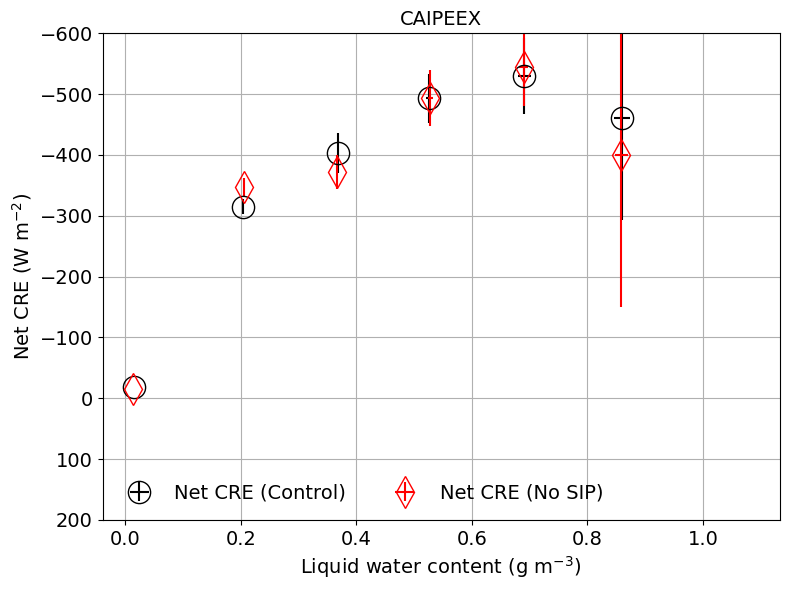

In [14]:

fnt=14;
ms=16
plt.figure(figsize=(8, 6))
plt.style.use('default')

# Plot Control with black error bars
plt.errorbar(binned_lwc_4sip, binned_netcre_4sip, xerr=err_lwc_4sip, yerr=err_netcre_4sip, 
             fmt='o', color='black', markersize=ms, markerfacecolor='none', label='Net CRE (Control)', capsize=0)
plt.errorbar(binned_lwc_nosip, binned_netcre_nosip, xerr=err_lwc_nosip, yerr=err_netcre_nosip, 
             fmt='d', color='red', markersize=ms, markerfacecolor='none', label='Net CRE (No SIP)',capsize=0)

#plt.errorbar(binned_lwc_4sip, binned_swcre_4sip, xerr=err_lwc_4sip, yerr=err_swcre_4sip, 
#             fmt='o', color='b', markersize=ms, markerfacecolor='none', label='SW CRE (Control)', capsize=0)
#plt.errorbar(binned_lwc_nosip, binned_swcre_nosip, xerr=err_lwc_nosip, yerr=err_swcre_nosip, 
#             fmt='d', color='b', markersize=ms, markerfacecolor='none', label='SW CRE (No SIP)', capsize=0)

#plt.errorbar(binned_lwc_4sip, binned_lwcre_4sip, xerr=err_lwc_4sip, yerr=err_lwcre_4sip, 
#             fmt='o', color='g', markersize=ms, markerfacecolor='none', label='LW CRE (Control)', capsize=0)
#plt.errorbar(binned_lwc_nosip, binned_lwcre_nosip, xerr=err_lwc_nosip, yerr=err_lwcre_nosip, 
#             fmt='d', color='g', markersize=ms, markerfacecolor='none', label='LW CRE (No SIP)', capsize=0)


#plt.xlim(0., 0.007)
plt.ylim(200, -600)
plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.title('CAIPEEX', fontsize=fnt)
plt.xlabel('Liquid water content (g m$^{-3}$)', fontsize=fnt)
plt.ylabel('Net CRE (W m$^{-2}$)', fontsize=fnt)

plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.5, ncols=2, fontsize=fnt, loc='best')
plt.grid(True)
plt.tight_layout()
plt.show()


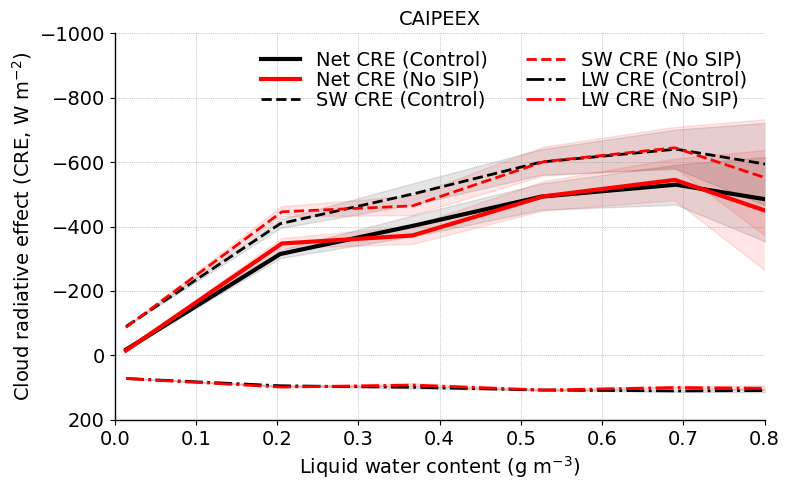

In [16]:


ln1=3;
ln2=2;
fnt=14;

def plot_with_shaded_error_lwc_netcre(ax, x, y, xerr, yerr, color, label, linestyle='-', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

def plot_with_shaded_error_lwc_swcre(ax, x, y, xerr, yerr, color, label, linestyle='--', linewidth=ln2):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

def plot_with_shaded_error_lwc_lwcre(ax, x, y, xerr, yerr, color, label, linestyle='-.', linewidth=ln2):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)


fig, ax = plt.subplots(figsize=(8, 5))
plt.style.use('default')

plot_with_shaded_error_lwc_netcre(ax, binned_lwc_4sip, binned_netcre_4sip, err_lwc_4sip, err_netcre_4sip, 'k', 'Net CRE (Control)')
plot_with_shaded_error_lwc_netcre(ax, binned_lwc_nosip, binned_netcre_nosip, err_lwc_nosip, err_netcre_nosip, 'r', 'Net CRE (No SIP)')

plot_with_shaded_error_lwc_swcre(ax, binned_lwc_4sip, binned_swcre_4sip, err_lwc_4sip, err_swcre_4sip, 'k', 'SW CRE (Control)')
plot_with_shaded_error_lwc_swcre(ax, binned_lwc_nosip, binned_swcre_nosip, err_lwc_nosip, err_swcre_nosip, 'r', 'SW CRE (No SIP)')

plot_with_shaded_error_lwc_lwcre(ax, binned_lwc_4sip, binned_lwcre_4sip, err_lwc_4sip, err_lwcre_4sip, 'k', 'LW CRE (Control)')
plot_with_shaded_error_lwc_lwcre(ax, binned_lwc_nosip, binned_lwcre_nosip, err_lwc_nosip, err_lwcre_nosip, 'r', 'LW CRE (No SIP)')

# Repeat for SW and LW

ax.set_xlim(0, 0.8)
ax.set_ylim(200, -1000)

#ax.set_xticks([-1, -0.5, 0, 0.5, 1])
#ax.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
#ax.set_yticks([0, 4, 8, 12, 16])

ax.tick_params(axis='x', labelsize=fnt)
ax.tick_params(axis='y', labelsize=fnt)
ax.set_xlabel('Liquid water content (g m$^{-3}$)', fontsize=fnt)
ax.set_ylabel('Cloud radiative effect (CRE, W m$^{-2}$)', fontsize=fnt)
ax.set_title('CAIPEEX', fontsize=fnt)

ax.legend(frameon=False, handlelength=2, labelspacing=0.05, ncols=2, fontsize=fnt, loc='best')
ax.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

ax.spines['top'].set_linewidth(1)
ax.spines['right'].set_linewidth(1)
ax.spines['left'].set_linewidth(1)
ax.spines['bottom'].set_linewidth(1)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.tight_layout()
plt.show()


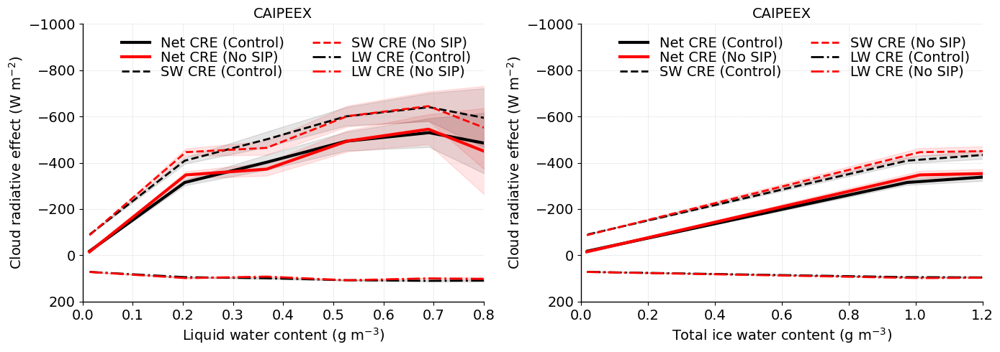

In [18]:

def plot_with_shaded_error_lwc_netcre(ax, x, y, xerr, yerr, color, label, linestyle='-', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

def plot_with_shaded_error_lwc_swcre(ax, x, y, xerr, yerr, color, label, linestyle='--', linewidth=ln2):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

def plot_with_shaded_error_lwc_lwcre(ax, x, y, xerr, yerr, color, label, linestyle='-.', linewidth=ln2):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)


fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(14, 5), sharex=False)
plt.style.use('default')

### ───── TOP PANEL: Absolute CREs ─────
plot_with_shaded_error_lwc_netcre(ax1, binned_lwc_4sip, binned_netcre_4sip, err_lwc_4sip, err_netcre_4sip, 'k', 'Net CRE (Control)')
plot_with_shaded_error_lwc_netcre(ax1, binned_lwc_nosip, binned_netcre_nosip, err_lwc_nosip, err_netcre_nosip, 'r', 'Net CRE (No SIP)')

plot_with_shaded_error_lwc_swcre(ax1, binned_lwc_4sip, binned_swcre_4sip, err_lwc_4sip, err_swcre_4sip, 'k', 'SW CRE (Control)')
plot_with_shaded_error_lwc_swcre(ax1, binned_lwc_nosip, binned_swcre_nosip, err_lwc_nosip, err_swcre_nosip, 'r', 'SW CRE (No SIP)')

plot_with_shaded_error_lwc_lwcre(ax1, binned_lwc_4sip, binned_lwcre_4sip, err_lwc_4sip, err_lwcre_4sip, 'k', 'LW CRE (Control)')
plot_with_shaded_error_lwc_lwcre(ax1, binned_lwc_nosip, binned_lwcre_nosip, err_lwc_nosip, err_lwcre_nosip, 'r', 'LW CRE (No SIP)')

ax1.set_xlim(0, 0.8)
ax1.set_ylim(200, -1000)
#ax1.set_xticks([0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6])
ax1.set_xlabel('Liquid water content (g m$^{-3}$)', fontsize=fnt)
ax1.set_ylabel('Cloud radiative effect (W m$^{-2}$)', fontsize=fnt)
ax1.set_title('CAIPEEX', fontsize=fnt)
ax1.legend(frameon=False, ncols=2, labelspacing=0.05, fontsize=fnt, loc='best')
ax1.grid(True, linestyle=':', linewidth=0.5, alpha=0.8)

### ───── BOTTOM PANEL: ΔCRE (Control - No SIP) ─────

plot_with_shaded_error_lwc_netcre(ax2, binned_iwc_4sip, binned_netcre_4sip, err_iwc_4sip, err_netcre_4sip, 'k', 'Net CRE (Control)')
plot_with_shaded_error_lwc_netcre(ax2, binned_iwc_nosip, binned_netcre_nosip, err_iwc_nosip, err_netcre_nosip, 'r', 'Net CRE (No SIP)')

plot_with_shaded_error_lwc_swcre(ax2, binned_iwc_4sip, binned_swcre_4sip, err_iwc_4sip, err_swcre_4sip, 'k', 'SW CRE (Control)')
plot_with_shaded_error_lwc_swcre(ax2, binned_iwc_nosip, binned_swcre_nosip, err_iwc_nosip, err_swcre_nosip, 'r', 'SW CRE (No SIP)')

plot_with_shaded_error_lwc_lwcre(ax2, binned_iwc_4sip, binned_lwcre_4sip, err_iwc_4sip, err_lwcre_4sip, 'k', 'LW CRE (Control)')
plot_with_shaded_error_lwc_lwcre(ax2, binned_iwc_nosip, binned_lwcre_nosip, err_iwc_nosip, err_lwcre_nosip, 'r', 'LW CRE (No SIP)')

ax2.set_xlim(0, 1.2)
ax2.set_ylim(200, -1000)
ax2.set_xlabel('Total ice water content (g m$^{-3}$)', fontsize=fnt)
ax2.set_ylabel('Cloud radiative effect (W m$^{-2}$)', fontsize=fnt)
ax2.set_title('CAIPEEX', fontsize=fnt)
ax2.legend(frameon=False, ncols=2, labelspacing=0.05, fontsize=fnt, loc='best')
ax2.grid(True, linestyle=':', linewidth=0.5, alpha=0.8)

for ax in [ax1, ax2]:
    ax.tick_params(labelsize=fnt)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_linewidth(1)
    ax.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


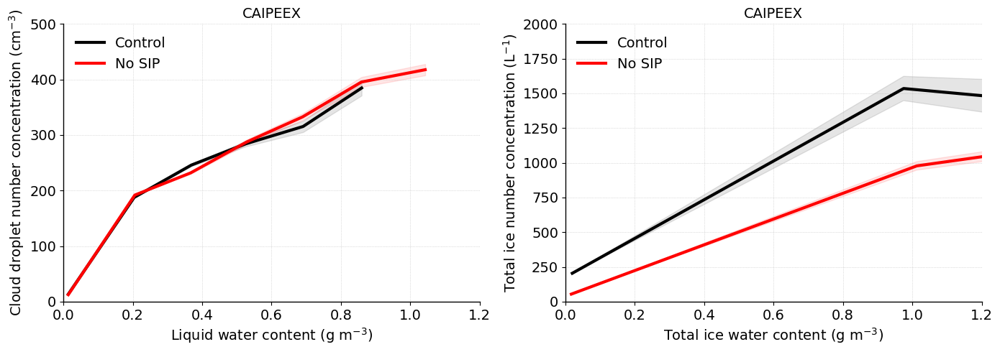

In [21]:

def plot_with_shaded_error_lwc_cdnc(ax, x, y, xerr, yerr, color, label, linestyle='-', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)
    
def plot_with_shaded_error_lwc_tinc(ax, x, y, xerr, yerr, color, label, linestyle='-', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)


fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(14, 5), sharex=False)
plt.style.use('default')

### ───── TOP PANEL: Absolute CREs ─────
plot_with_shaded_error_lwc_cdnc(ax1, binned_lwc_4sip, binned_cdnc_4sip, err_lwc_4sip, err_cdnc_4sip, 'k', 'Control')
plot_with_shaded_error_lwc_cdnc(ax1, binned_lwc_nosip, binned_cdnc_nosip, err_lwc_nosip, err_cdnc_nosip, 'r', 'No SIP')

ax1.set_xlim(0, 1.2)
ax1.set_ylim(0, 500)
ax1.set_xlabel('Liquid water content (g m$^{-3}$)', fontsize=fnt)
ax1.set_ylabel('Cloud droplet number concentration (cm$^{-3}$)', fontsize=fnt)
ax1.set_title('CAIPEEX', fontsize=fnt)
ax1.legend(frameon=False, ncols=1, fontsize=fnt, loc='best')
ax1.grid(True, linestyle=':', linewidth=0.5, alpha=0.8)

### ───── BOTTOM PANEL: ΔCRE (Control - No SIP) ─────

plot_with_shaded_error_lwc_tinc(ax2, binned_iwc_4sip, binned_tinc_4sip, err_iwc_4sip, err_tinc_4sip, 'k', 'Control')
plot_with_shaded_error_lwc_tinc(ax2, binned_iwc_nosip, binned_tinc_nosip, err_iwc_nosip, err_tinc_nosip, 'r', 'No SIP')

ax2.set_xlim(0, 1.2)
ax2.set_ylim(0, 2000)
ax2.set_xlabel('Total ice water content (g m$^{-3}$)', fontsize=fnt)
ax2.set_ylabel('Total ice number concentration (L$^{-1}$)', fontsize=fnt)
ax2.set_title('CAIPEEX', fontsize=fnt)
ax2.legend(frameon=False, ncols=1, fontsize=fnt, loc='best')
ax2.grid(True, linestyle=':', linewidth=0.5, alpha=0.8)

for ax in [ax1, ax2]:
    ax.tick_params(labelsize=fnt)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_linewidth(1)
    ax.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


In [56]:

lhr_4sip, wvel_mean_4sip, wvel_min_4sip, wvel_max_4sip = wvel_lhr_ncells_avg(ds_4sip)
lhr_nosip, wvel_mean_nosip, wvel_min_nosip, wvel_max_nosip = wvel_lhr_ncells_avg(ds_nosip)

# Flatten to 1D
lhr_4sip = lhr_4sip.values.flatten()
wvel_mean_4sip = wvel_mean_4sip.values.flatten()
wvel_min_4sip = wvel_min_4sip.values.flatten()
wvel_max_4sip = wvel_max_4sip.values.flatten()

lhr_nosip = lhr_nosip.values.flatten()
wvel_mean_nosip = wvel_mean_nosip.values.flatten()
wvel_min_nosip = wvel_min_nosip.values.flatten()
wvel_max_nosip = wvel_max_nosip.values.flatten()


In [68]:
mask_lhr_4sip = (lhr_4sip > -20)
mask_lhr_nosip = (lhr_nosip > -20)

lhr_bins = np.linspace(0, np.nanmax([lhr_4sip, lhr_nosip]), 10)  # ~25 bins

binned_lhr_4sip, binned_wvel_mean_4sip, err_lhr_4sip, err_wvel_mean_4sip = bin_avg(lhr_4sip[mask_lhr_4sip], wvel_mean_4sip[mask_lhr_4sip], lhr_bins)
binned_lhr_nosip, binned_wvel_mean_nosip, err_lhr_nosip, err_wvel_mean_nosip = bin_avg(lhr_nosip[mask_lhr_nosip], wvel_mean_nosip[mask_lhr_nosip], lhr_bins)

binned_lhr_4sip, binned_wvel_min_4sip, err_lhr_4sip, err_wvel_min_4sip = bin_avg(lhr_4sip[mask_lhr_4sip], wvel_min_4sip[mask_lhr_4sip], lhr_bins)
binned_lhr_nosip, binned_wvel_min_nosip, err_lhr_nosip, err_wvel_min_nosip = bin_avg(lhr_nosip[mask_lhr_nosip], wvel_min_nosip[mask_lhr_nosip], lhr_bins)

binned_lhr_4sip, binned_wvel_max_4sip, err_lhr_4sip, err_wvel_max_4sip = bin_avg(lhr_4sip[mask_lhr_4sip], wvel_max_4sip[mask_lhr_4sip], lhr_bins)
binned_lhr_nosip, binned_wvel_max_nosip, err_lhr_nosip, err_wvel_max_nosip = bin_avg(lhr_nosip[mask_lhr_nosip], wvel_max_nosip[mask_lhr_nosip], lhr_bins)


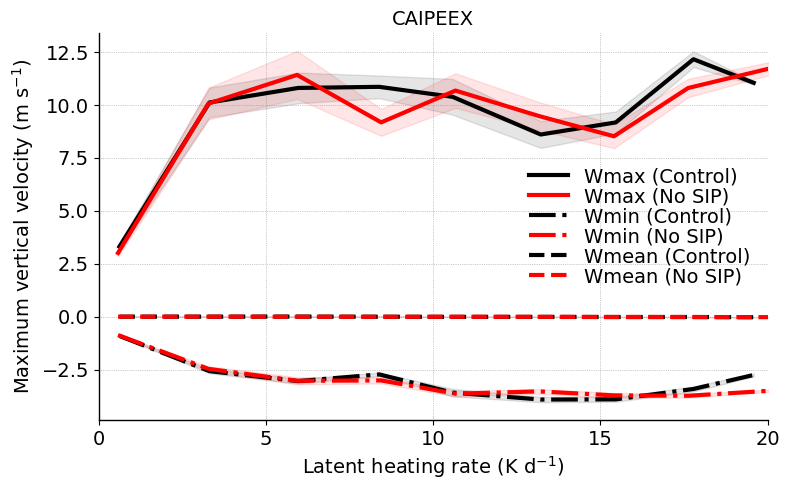

In [69]:


ln1=3;
ln2=2;
fnt=14;

def plot_with_shaded_error_lhr_wvel_mean(ax, x, y, xerr, yerr, color, label, linestyle='--', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

def plot_with_shaded_error_lhr_wvel_min(ax, x, y, xerr, yerr, color, label, linestyle='-.', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

def plot_with_shaded_error_lhr_wvel_max(ax, x, y, xerr, yerr, color, label, linestyle='-', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

fig, ax = plt.subplots(figsize=(8, 5))
plt.style.use('default')


plot_with_shaded_error_lhr_wvel_max(ax, binned_lhr_4sip, binned_wvel_max_4sip, err_lhr_4sip, err_wvel_max_4sip, 'k', 'Wmax (Control)')
plot_with_shaded_error_lhr_wvel_max(ax, binned_lhr_nosip, binned_wvel_max_nosip, err_lhr_nosip, err_wvel_max_nosip, 'r', 'Wmax (No SIP)')

plot_with_shaded_error_lhr_wvel_min(ax, binned_lhr_4sip, binned_wvel_min_4sip, err_lhr_4sip, err_wvel_min_4sip, 'k', 'Wmin (Control)')
plot_with_shaded_error_lhr_wvel_min(ax, binned_lhr_nosip, binned_wvel_min_nosip, err_lhr_nosip, err_wvel_min_nosip, 'r', 'Wmin (No SIP)')

plot_with_shaded_error_lhr_wvel_mean(ax, binned_lhr_4sip, binned_wvel_mean_4sip, err_lhr_4sip, err_wvel_mean_4sip, 'k', 'Wmean (Control)')
plot_with_shaded_error_lhr_wvel_mean(ax, binned_lhr_nosip, binned_wvel_mean_nosip, err_lhr_nosip, err_wvel_mean_nosip, 'r', 'Wmean (No SIP)')


# Repeat for SW and LW

ax.set_xlim(0, 20)
#ax.set_ylim(200, -1000)

ax.set_xticks([0, 5, 10, 15, 20])
#ax.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
#ax.set_yticks([0, 4, 8, 12, 16])

ax.tick_params(axis='x', labelsize=fnt)
ax.tick_params(axis='y', labelsize=fnt)
ax.set_xlabel('Latent heating rate (K d$^{-1}$)', fontsize=fnt)
ax.set_ylabel('Maximum vertical velocity (m s$^{-1}$)', fontsize=fnt)
ax.set_title('CAIPEEX', fontsize=fnt)

ax.legend(frameon=False, handlelength=2, labelspacing=0.05, ncols=1, fontsize=fnt, loc='best')
ax.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

ax.spines['top'].set_linewidth(1)
ax.spines['right'].set_linewidth(1)
ax.spines['left'].set_linewidth(1)
ax.spines['bottom'].set_linewidth(1)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.tight_layout()
plt.show()


In [8]:

w_thres = 2.
# Latent heating rate with No SIP
dims1 = ds_nosip.tempc.dims
dims2 = ds_nosip.tempc.mean(dim=('time','ncells')).dims
filt_lhr = xr.where((ds_nosip.tq > 1.e-6) & (ds_nosip.w_vel > w_thres), ds_nosip.d_lhr, np.nan)
lhr_kpers_nosip = (1./1800.) * np.gradient(ds_nosip.d_lhr, axis=0) # w.r.t. time
lhr_kperd_nosip = lhr_kpers_nosip * 86400.
#ds_nosip['lhr_kperd'] = xr.where((ds_nosip.lhr_kperd > -10.) & (ds_nosip.lhr_kperd < 20.), ds_nosip.lhr_kperd, np.nan)
mean_lhr_kperd_nosip = np.mean(lhr_kperd_nosip, axis=(0,2))
ds_nosip['lhr_kperd'] = (dims1, lhr_kperd_nosip)
ds_nosip['mean_lhr_kperd'] = (dims2, mean_lhr_kperd_nosip)

# Latent heating rate with 4-SIP
dims1 = ds_4sip.tempc.dims
dims = ds_4sip.tempc.mean(dim=('time','ncells')).dims
filt_lhr = xr.where((ds_4sip.tq > 1.e-6) & (ds_4sip.w_vel > w_thres), ds_4sip.d_lhr, np.nan)
lhr_kpers_4sip = (1./1800.) * np.gradient(ds_4sip.d_lhr, axis=0) # w.r.t. time
lhr_kperd_4sip = lhr_kpers_4sip * 86400.
#ds_4sip['lhr_kperd'] = (dims, lhr_kperd_4sip)
#ds_4sip['lhr_kperd'] = xr.where((ds_4sip.lhr_kperd > -10.) & (ds_4sip.lhr_kperd < 20.), ds_4sip.lhr_kperd, np.nan)
mean_lhr_kperd_4sip = np.mean(lhr_kperd_4sip, axis=(0,2))
ds_4sip['lhr_kperd'] = (dims1, lhr_kperd_4sip)
ds_4sip['mean_lhr_kperd'] = (dims, mean_lhr_kperd_4sip)



In [15]:

#######
min_tempc_4sip = ds_4sip.tempc.min().values
max_tempc_4sip = ds_4sip.tempc.max().values

min_lhr_4sip = ds_4sip.lhr_kperd.mean('ncells').min().values
max_lhr_4sip = ds_4sip.lhr_kperd.mean('ncells').max().values
#######

n_bin = 12;

temp_4sip_bin = np.linspace(min_tempc_4sip, max_tempc_4sip, n_bin+1)
lhr_4sip_bin = np.linspace(min_lhr_4sip, max_lhr_4sip, n_bin+1)
#######

#######
tempc_4sip_flat = ds_4sip.tempc.mean('ncells').values.flatten()
lhr_4sip_flat = ds_4sip.lhr_kperd.mean('ncells').values.flatten()
wvel_4sip_flat = ds_4sip.w_vel.max('ncells').values.flatten()


#######
hist_4sip, temp_edges_4sip, wvel_edges_4sip = np.histogram2d(tempc_4sip_flat, lhr_4sip_flat, bins=(temp_4sip_bin, lhr_4sip_bin))
#######

#######
wvel_sum_4sip = np.histogram2d(tempc_4sip_flat, lhr_4sip_flat, bins=(temp_4sip_bin, lhr_4sip_bin), weights = wvel_4sip_flat)[0]
#######

#######
wvel_temp_lhr_4sip = wvel_sum_4sip/hist_4sip
#######

In [13]:

#######
min_tempc_nosip = ds_nosip.tempc.min().values
max_tempc_nosip = ds_nosip.tempc.max().values

min_lhr_nosip = ds_nosip.lhr_kperd.mean('ncells').min().values
max_lhr_nosip = ds_nosip.lhr_kperd.mean('ncells').max().values
#######

n_bin = 12;

temp_nosip_bin = np.linspace(min_tempc_nosip, max_tempc_nosip, n_bin+1)
lhr_nosip_bin = np.linspace(min_lhr_nosip, max_lhr_nosip, n_bin+1)
#######

#######
tempc_nosip_flat = ds_nosip.tempc.mean('ncells').values.flatten()
lhr_nosip_flat = ds_nosip.lhr_kperd.mean('ncells').values.flatten()
wvel_nosip_flat = ds_nosip.w_vel.max('ncells').values.flatten()


#######
hist_nosip, temp_edges_nosip, wvel_edges_nosip = np.histogram2d(tempc_nosip_flat, lhr_nosip_flat, bins=(temp_nosip_bin, lhr_nosip_bin))
#######

#######
wvel_sum_nosip = np.histogram2d(tempc_nosip_flat, lhr_nosip_flat, bins=(temp_nosip_bin, lhr_nosip_bin), weights = wvel_nosip_flat)[0]
#######

#######
wvel_temp_lhr_nosip = wvel_sum_nosip/hist_nosip
#######


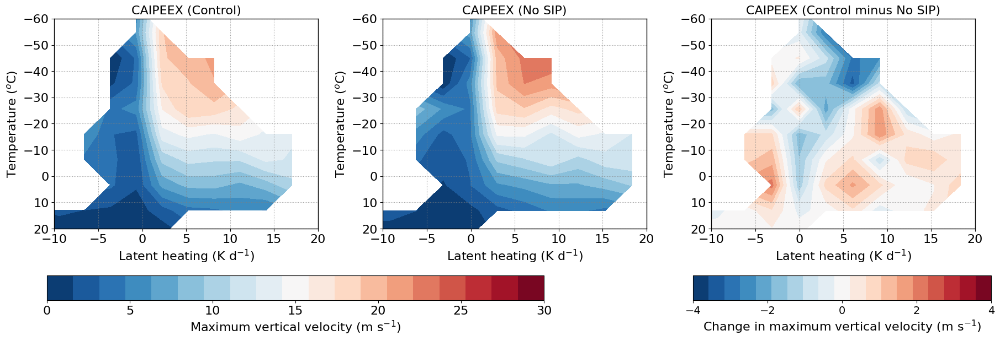

In [26]:

import matplotlib.lines as mlines

fnt=14;
fnt1=14;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;
vmin, vmax = -1000, 200

lev1 = np.linspace(0, 30, 20)
lev2 = np.arange(0, 30, 20)
lev3 = np.arange(-40, 40, 20)

plt.figure(figsize=(18, 5))
plt.style.use('default')

plt.subplot(1,3,1)

cnt1=plt.contourf(lhr_4sip_bin[:-1], temp_4sip_bin[:-1], wvel_temp_lhr_4sip, levels=lev1, cmap='RdBu_r')

#contour_levels=np.arange(-1000, 200, 20)
#contours = plt.contour(lwc_4sip_bin[:-1], temp_4sip_bin[:-1], net_cre_temp_lwc_4sip, levels=contour_levels, colors=color, 
#                           linestyles='--', linewidths=1)
#plt.clabel(contours, inline=True, fontsize=fontsize-8, fmt='%.0e')


plt.xlim(-10, 20)
plt.ylim(20, -60)
#plt.xticks([0, 1, 2, 3, 4])
plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
plt.xlabel('Latent heating (K d$^{-1}$)', fontsize=fnt+2)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fnt+2)
#plt.gca().set_yticks([])
#plt.gca().set_xticks([])
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.title('CAIPEEX (Control)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

#contour_levels = np.linspace(-40, 40., 7)
#contours = plt.contour(lhr_4sip_bin[:-1], temp_4sip_bin[:-1], wvel_temp_lhr_4sip, levels=contour_levels, colors='k', linestyles='-', linewidths=1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)

cnt2=plt.contourf(lhr_nosip_bin[:-1], temp_nosip_bin[:-1], wvel_temp_lhr_nosip, levels=lev1, cmap='RdBu_r')


plt.xlim(-10, 20)
plt.ylim(20, -60)
#plt.xticks([0, 1, 2, 3, 4])
plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
plt.xlabel('Latent heating (K d$^{-1}$)', fontsize=fnt+2)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fnt+2)
#plt.gca().set_yticks([])
#plt.gca().set_xticks([])
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.title('CAIPEEX (No SIP)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

#contour_levels = np.linspace(-40, 40., 7)
#contours = plt.contour(lhr_nosip_bin[:-1], temp_nosip_bin[:-1], wvel_temp_lhr_nosip, levels=contour_levels, colors='k', linestyles='-', linewidths=1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()  # Get the current figure
#cbar_ax = fig.add_axes([0.10, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar_ax = fig.add_axes([0.05, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar = fig.colorbar(cnt1, cax=cbar_ax, ticks=[0, 5, 10, 15, 20, 25, 30], orientation='horizontal')
cbar.set_label('Maximum vertical velocity (m s$^{-1}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt1+2)

plt.subplot(1,3,3)

lev3 = np.linspace(-4, 4, 20)
#cnt3=plt.imshow(net_cre_temp_lwc_4sip-net_cre_temp_lwc_nosip, extent=[lwc_nosip_bin[0], lwc_nosip_bin[-1], temp_nosip_bin[0], temp_nosip_bin[-1]],
#                     vmin=-1000, vmax=200, aspect='auto', origin='lower', cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')


cnt3=plt.contourf(lhr_nosip_bin[:-1], temp_nosip_bin[:-1], wvel_temp_lhr_4sip-wvel_temp_lhr_nosip, levels=lev3, cmap='RdBu_r')

#colorbar = plt.colorbar(cnt3, ticks=[-400, -300, -200, -100, 0, 100, 200, 300, 400])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Change in net CRE (W m$^{-2}$)', size=fnt)

#contours = plt.contour(lwc_nosip_bin[:-1], temp_nosip_bin[:-1], net_cre_temp_lwc_4sip-net_cre_temp_lwc_nosip, levels=np.linspace(0, 300, 7), colors=color, 
#                           linestyles='--', linewidths=1)
#plt.clabel(contours, inline=True, fontsize=fontsize-8, fmt='%2d')


plt.xlim(-10, 20)
plt.ylim(20, -60)
#plt.xticks([0, 1, 2, 3, 4])
plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
plt.xlabel('Latent heating (K d$^{-1}$)', fontsize=fnt+2)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fnt+2)
#plt.gca().set_yticks([])
#plt.gca().set_xticks([])
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.title('CAIPEEX (Control minus No SIP)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()  # Get the current figure
cbar_ax = fig.add_axes([0.70, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
cbar = fig.colorbar(cnt3, cax=cbar_ax, ticks=[-4, -2, 0, 2, 4], orientation='horizontal')
cbar.set_label('Change in maximum vertical velocity (m s$^{-1}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt1)

plt.tight_layout()
plt.show()


In [9]:

w_thres = 2.
# Latent heating rate with No SIP
dims1 = ds_nosip.tempc.dims
dims2 = ds_nosip.tempc.mean(dim=('time','ncells')).dims
filt_lhr = xr.where((ds_nosip.tq > 1.e-6) & (ds_nosip.w_vel > w_thres), ds_nosip.d_lhr, np.nan)
lhr_kpers_nosip = (1./1800.) * np.gradient(ds_nosip.d_lhr, axis=0) # w.r.t. time
lhr_kperd_nosip = lhr_kpers_nosip * 86400.
#ds_nosip['lhr_kperd'] = xr.where((ds_nosip.lhr_kperd > -10.) & (ds_nosip.lhr_kperd < 20.), ds_nosip.lhr_kperd, np.nan)
mean_lhr_kperd_nosip = np.mean(lhr_kperd_nosip, axis=(0,2))
ds_nosip['lhr_kperd'] = (dims1, lhr_kperd_nosip)
ds_nosip['mean_lhr_kperd'] = (dims2, mean_lhr_kperd_nosip)

# Latent heating rate with 4-SIP
dims1 = ds_4sip.tempc.dims
dims = ds_4sip.tempc.mean(dim=('time','ncells')).dims
filt_lhr = xr.where((ds_4sip.tq > 1.e-6) & (ds_4sip.w_vel > w_thres), ds_4sip.d_lhr, np.nan)
lhr_kpers_4sip = (1./1800.) * np.gradient(ds_4sip.d_lhr, axis=0) # w.r.t. time
lhr_kperd_4sip = lhr_kpers_4sip * 86400.
#ds_4sip['lhr_kperd'] = (dims, lhr_kperd_4sip)
#ds_4sip['lhr_kperd'] = xr.where((ds_4sip.lhr_kperd > -10.) & (ds_4sip.lhr_kperd < 20.), ds_4sip.lhr_kperd, np.nan)
mean_lhr_kperd_4sip = np.mean(lhr_kperd_4sip, axis=(0,2))
ds_4sip['lhr_kperd'] = (dims1, lhr_kperd_4sip)
ds_4sip['mean_lhr_kperd'] = (dims, mean_lhr_kperd_4sip)



In [48]:

import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import binned_statistic

def wvel_lhr_ncells_avg(ds, w_var='w_vel', lhr_var='lhr_kperd', height='height', ncells='ncells', time='time'):
    w_mean = ds[w_var].mean(dim=ncells)
    w_min = ds[w_var].min(dim=ncells)
    w_max = ds[w_var].max(dim=ncells)
    lhr_mean = ds[lhr_var].mean(dim=ncells)
    lhr_min = ds[lhr_var].min(dim=ncells)
    lhr_max = ds[lhr_var].max(dim=ncells)
    return lhr_mean, lhr_min, lhr_max, w_mean, w_min, w_max 


def bin_avg(x, y, bins):
    # Compute bin means and stds
    bin_means, bin_edges, _ = binned_statistic(x, y, statistic='mean', bins=bins)
    bin_x_means, _, _ = binned_statistic(x, x, statistic='mean', bins=bins)
    bin_x_stds, _, _ = binned_statistic(x, x, statistic='std', bins=bins)
    bin_y_stds, _, _ = binned_statistic(x, y, statistic='std', bins=bins)

    # Count per bin for std error
    bin_counts, _, _ = binned_statistic(x, y, statistic='count', bins=bins)
    bin_x_err = bin_x_stds / np.sqrt(bin_counts)
    bin_y_err = bin_y_stds / np.sqrt(bin_counts)

    return bin_x_means, bin_means, bin_x_err, bin_y_err
    

In [49]:

lhr_mean_4sip, lhr_min_4sip, lhr_max_4sip, wvel_mean_4sip, wvel_min_4sip, wvel_max_4sip = wvel_lhr_ncells_avg(ds_4sip)
lhr_mean_nosip, lhr_min_nosip, lhr_max_nosip, wvel_mean_nosip, wvel_min_nosip, wvel_max_nosip = wvel_lhr_ncells_avg(ds_nosip)

# Flatten to 1D
lhr_mean_4sip = lhr_mean_4sip.values.flatten()
lhr_min_4sip = lhr_min_4sip.values.flatten()
lhr_max_4sip = lhr_max_4sip.values.flatten()
wvel_mean_4sip = wvel_mean_4sip.values.flatten()
wvel_min_4sip = wvel_min_4sip.values.flatten()
wvel_max_4sip = wvel_max_4sip.values.flatten()

lhr_mean_nosip = lhr_mean_nosip.values.flatten()
lhr_min_nosip = lhr_min_nosip.values.flatten()
lhr_max_nosip = lhr_max_nosip.values.flatten()
wvel_mean_nosip = wvel_mean_nosip.values.flatten()
wvel_min_nosip = wvel_min_nosip.values.flatten()
wvel_max_nosip = wvel_max_nosip.values.flatten()


In [50]:
mask_lhr_mean_4sip = (lhr_mean_4sip > -20)
mask_lhr_mean_nosip = (lhr_mean_nosip > -20)

mask_lhr_min_4sip = (lhr_min_4sip > -30)
mask_lhr_min_nosip = (lhr_min_nosip > -30)

lhr_mean_bins = np.linspace(0, np.nanmax([lhr_mean_4sip, lhr_mean_nosip]), 10)  # ~25 bins
lhr_min_bins = np.linspace(0, np.nanmax([lhr_min_4sip, lhr_min_nosip]), 10)

binned_lhr_mean_4sip, binned_wvel_mean_4sip, err_lhr_mean_4sip, err_wvel_mean_4sip = bin_avg(lhr_mean_4sip[mask_lhr_mean_4sip], wvel_mean_4sip[mask_lhr_mean_4sip], lhr_mean_bins)
binned_lhr_mean_nosip, binned_wvel_mean_nosip, err_lhr_mean_nosip, err_wvel_mean_nosip = bin_avg(lhr_mean_nosip[mask_lhr_mean_nosip], wvel_mean_nosip[mask_lhr_mean_nosip], lhr_mean_bins)

binned_lhr_mean_4sip, binned_wvel_min_4sip, err_lhr_mean_4sip, err_wvel_min_4sip = bin_avg(lhr_mean_4sip[mask_lhr_mean_4sip], wvel_min_4sip[mask_lhr_mean_4sip], lhr_mean_bins)
binned_lhr_mean_nosip, binned_wvel_min_nosip, err_lhr_mean_nosip, err_wvel_min_nosip = bin_avg(lhr_mean_nosip[mask_lhr_mean_nosip], wvel_min_nosip[mask_lhr_mean_nosip], lhr_mean_bins)

binned_lhr_mean_4sip, binned_wvel_max_4sip, err_lhr_mean_4sip, err_wvel_max_4sip = bin_avg(lhr_mean_4sip[mask_lhr_mean_4sip], wvel_max_4sip[mask_lhr_mean_4sip], lhr_mean_bins)
binned_lhr_mean_nosip, binned_wvel_max_nosip, err_lhr_mean_nosip, err_wvel_max_nosip = bin_avg(lhr_mean_nosip[mask_lhr_mean_nosip], wvel_max_nosip[mask_lhr_mean_nosip], lhr_mean_bins)



In [122]:
#mask_lhr_mean_4sip = (lhr_mean_4sip > -20)
#mask_lhr_mean_nosip = (lhr_mean_nosip > -20)

#lhr_mean_bins = np.linspace(0, np.nanmax([lhr_mean_4sip, lhr_mean_nosip]), 10)  # ~25 bins

#binned_lhr_mean_4sip, binned_wvel_mean_4sip, err_lhr_mean_4sip, err_wvel_mean_4sip = bin_avg(lhr_mean_4sip[mask_lhr_mean_4sip], wvel_mean_4sip[mask_lhr_mean_4sip], lhr_mean_bins)
#binned_lhr_mean_nosip, binned_wvel_mean_nosip, err_lhr_mean_nosip, err_wvel_mean_nosip = bin_avg(lhr_mean_nosip[mask_lhr_mean_nosip], wvel_mean_nosip[mask_lhr_mean_nosip], lhr_mean_bins)

#binned_lhr_mean_4sip, binned_wvel_min_4sip, err_lhr_mean_4sip, err_wvel_min_4sip = bin_avg(lhr_4sip[mask_lhr_mean_4sip], wvel_min_4sip[mask_lhr_mean_4sip], lhr_mean_bins)
#binned_lhr_mean_nosip, binned_wvel_min_nosip, err_lhr_mean_nosip, err_wvel_min_nosip = bin_avg(lhr_nosip[mask_lhr_mean_nosip], wvel_min_nosip[mask_lhr_mean_nosip], lhr_mean_bins)

#binned_lhr_mean_4sip, binned_wvel_max_4sip, err_lhr_mean_4sip, err_wvel_max_4sip = bin_avg(lhr_4sip[mask_lhr_mean_4sip], wvel_max_4sip[mask_lhr_mean_4sip], lhr_mean_bins)
#binned_lhr_mean_nosip, binned_wvel_max_nosip, err_lhr_mean_nosip, err_wvel_max_nosip = bin_avg(lhr_nosip[mask_lhr_mean_nosip], wvel_max_nosip[mask_lhr_mean_nosip], lhr_mean_bins)


In [15]:
print(len(binned_lhr_mean_4sip), len(binned_wvel_min_4sip), len(err_lhr_mean_4sip), len(err_wvel_min_4sip))

9 9 9 9


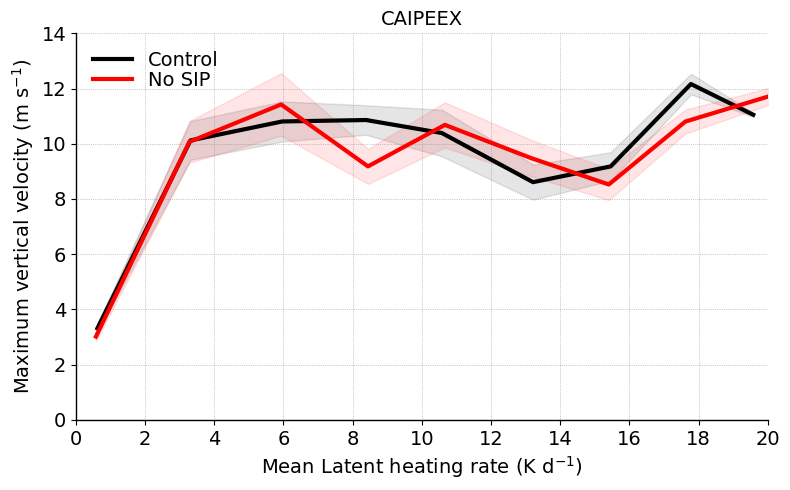

In [17]:


ln1=3;
ln2=2;
fnt=14;

def plot_with_shaded_error_lhr_wvel_mean(ax, x, y, xerr, yerr, color, label, linestyle='--', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

def plot_with_shaded_error_lhr_wvel_min(ax, x, y, xerr, yerr, color, label, linestyle='-.', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

def plot_with_shaded_error_lhr_wvel_max(ax, x, y, xerr, yerr, color, label, linestyle='-', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

fig, ax = plt.subplots(figsize=(8, 5))
plt.style.use('default')


plot_with_shaded_error_lhr_wvel_max(ax, binned_lhr_mean_4sip, binned_wvel_max_4sip, err_lhr_mean_4sip, err_wvel_max_4sip, 'k', 'Control')
plot_with_shaded_error_lhr_wvel_max(ax, binned_lhr_mean_nosip, binned_wvel_max_nosip, err_lhr_mean_nosip, err_wvel_max_nosip, 'r', 'No SIP')

#plot_with_shaded_error_lhr_wvel_min(ax, binned_lhr_mean_4sip, binned_wvel_min_4sip, err_lhr_mean_4sip, err_wvel_min_4sip, 'k', 'Control')
#plot_with_shaded_error_lhr_wvel_min(ax, binned_lhr_mean_nosip, binned_wvel_min_nosip, err_lhr_mean_nosip, err_wvel_min_nosip, 'r', 'No SIP')

#plot_with_shaded_error_lhr_wvel_mean(ax, binned_lhr_mean_4sip, binned_wvel_mean_4sip, err_lhr_mean_4sip, err_wvel_mean_4sip, 'k', 'Control')
#plot_with_shaded_error_lhr_wvel_mean(ax, binned_lhr_mean_nosip, binned_wvel_mean_nosip, err_lhr_mean_nosip, err_wvel_mean_nosip, 'r', 'No SIP')


# Repeat for SW and LW

ax.set_xlim(0, 20)
ax.set_ylim(0, 14)

ax.set_xticks([0, 2, 4, 6, 8, 10, 12, 14, 16, 18, 20])
#ax.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
#ax.set_yticks([0, 4, 8, 12, 16])

ax.tick_params(axis='x', labelsize=fnt)
ax.tick_params(axis='y', labelsize=fnt)
ax.set_xlabel('Mean Latent heating rate (K d$^{-1}$)', fontsize=fnt)
ax.set_ylabel('Maximum vertical velocity (m s$^{-1}$)', fontsize=fnt)
ax.set_title('CAIPEEX', fontsize=fnt)

ax.legend(frameon=False, handlelength=2, labelspacing=0.05, ncols=1, fontsize=fnt, loc='best')
ax.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

ax.spines['top'].set_linewidth(1)
ax.spines['right'].set_linewidth(1)
ax.spines['left'].set_linewidth(1)
ax.spines['bottom'].set_linewidth(1)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.tight_layout()
plt.show()


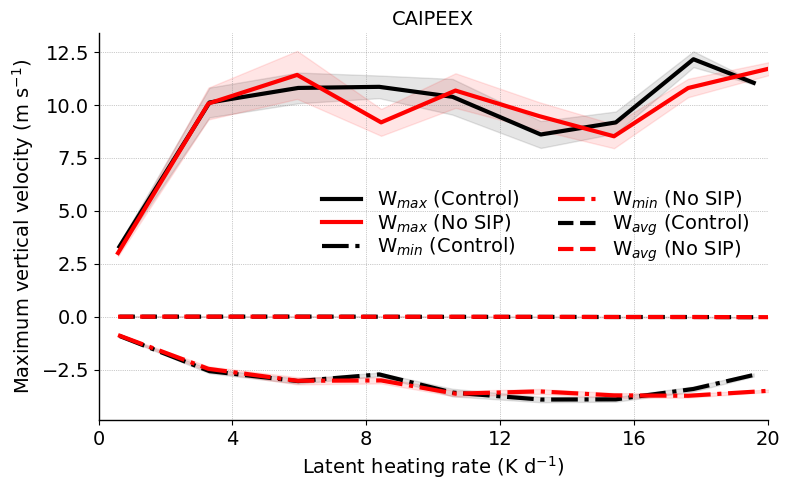

In [47]:


ln1=3;
ln2=2;
fnt=14;

def plot_with_shaded_error_lhr_wvel_mean(ax, x, y, xerr, yerr, color, label, linestyle='--', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

def plot_with_shaded_error_lhr_wvel_min(ax, x, y, xerr, yerr, color, label, linestyle='-.', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

def plot_with_shaded_error_lhr_wvel_max(ax, x, y, xerr, yerr, color, label, linestyle='-', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

fig, ax = plt.subplots(figsize=(8, 5))
plt.style.use('default')


plot_with_shaded_error_lhr_wvel_max(ax, binned_lhr_mean_4sip, binned_wvel_max_4sip, err_lhr_mean_4sip, err_wvel_max_4sip, 'k', 'W$_{max}$ (Control)')
plot_with_shaded_error_lhr_wvel_max(ax, binned_lhr_mean_nosip, binned_wvel_max_nosip, err_lhr_mean_nosip, err_wvel_max_nosip, 'r', 'W$_{max}$ (No SIP)')

plot_with_shaded_error_lhr_wvel_min(ax, binned_lhr_mean_4sip, binned_wvel_min_4sip, err_lhr_mean_4sip, err_wvel_min_4sip, 'k', 'W$_{min}$ (Control)')
plot_with_shaded_error_lhr_wvel_min(ax, binned_lhr_mean_nosip, binned_wvel_min_nosip, err_lhr_mean_nosip, err_wvel_min_nosip, 'r', 'W$_{min}$ (No SIP)')

plot_with_shaded_error_lhr_wvel_mean(ax, binned_lhr_mean_4sip, binned_wvel_mean_4sip, err_lhr_mean_4sip, err_wvel_mean_4sip, 'k', 'W$_{avg}$ (Control)')
plot_with_shaded_error_lhr_wvel_mean(ax, binned_lhr_mean_nosip, binned_wvel_mean_nosip, err_lhr_mean_nosip, err_wvel_mean_nosip, 'r', 'W$_{avg}$ (No SIP)')


# Repeat for SW and LW

ax.set_xlim(0, 20)
#ax.set_ylim(200, -1000)

ax.set_xticks([0, 4, 8, 12, 16, 20])
#ax.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
#ax.set_yticks([0, 4, 8, 12, 16])

ax.tick_params(axis='x', labelsize=fnt)
ax.tick_params(axis='y', labelsize=fnt)
ax.set_xlabel('Latent heating rate (K d$^{-1}$)', fontsize=fnt)
ax.set_ylabel('Maximum vertical velocity (m s$^{-1}$)', fontsize=fnt)
ax.set_title('CAIPEEX', fontsize=fnt)

ax.legend(frameon=False, handlelength=2, labelspacing=0.05, ncols=2, fontsize=fnt, loc='best')
ax.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

ax.spines['top'].set_linewidth(1)
ax.spines['right'].set_linewidth(1)
ax.spines['left'].set_linewidth(1)
ax.spines['bottom'].set_linewidth(1)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.tight_layout()
plt.show()


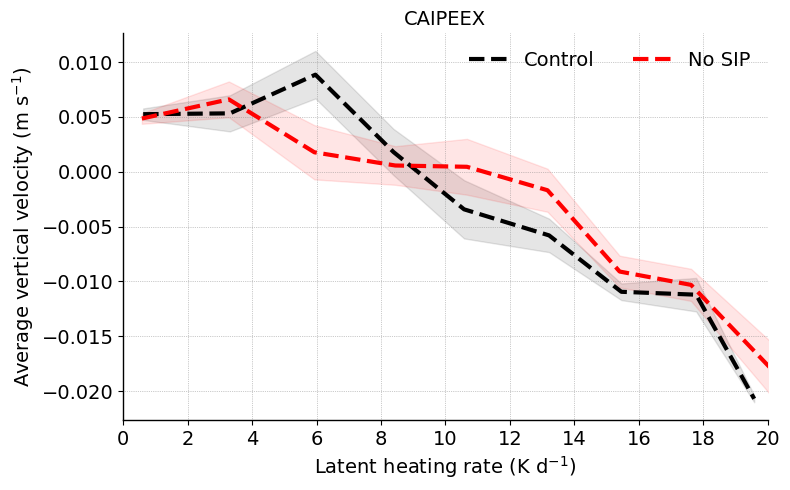

In [117]:


ln1=3;
ln2=2;
fnt=14;

def plot_with_shaded_error_lhr_wvel_mean(ax, x, y, xerr, yerr, color, label, linestyle='--', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

def plot_with_shaded_error_lhr_wvel_min(ax, x, y, xerr, yerr, color, label, linestyle='-.', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

def plot_with_shaded_error_lhr_wvel_max(ax, x, y, xerr, yerr, color, label, linestyle='-', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

fig, ax = plt.subplots(figsize=(8, 5))
plt.style.use('default')


#plot_with_shaded_error_lhr_wvel_max(ax, binned_lhr_mean_4sip, binned_wvel_max_4sip, err_lhr_mean_4sip, err_wvel_max_4sip, 'k', 'W$_{max}$ (Control)')
#plot_with_shaded_error_lhr_wvel_max(ax, binned_lhr_mean_nosip, binned_wvel_max_nosip, err_lhr_mean_nosip, err_wvel_max_nosip, 'r', 'W$_{max}$ (No SIP)')

#plot_with_shaded_error_lhr_wvel_min(ax, binned_lhr_mean_4sip, binned_wvel_min_4sip, err_lhr_mean_4sip, err_wvel_min_4sip, 'k', 'W$_{min}$ (Control)')
#plot_with_shaded_error_lhr_wvel_min(ax, binned_lhr_mean_nosip, binned_wvel_min_nosip, err_lhr_mean_nosip, err_wvel_min_nosip, 'r', 'W$_{min}$ (No SIP)')

plot_with_shaded_error_lhr_wvel_mean(ax, binned_lhr_mean_4sip, binned_wvel_mean_4sip, err_lhr_mean_4sip, err_wvel_mean_4sip, 'k', 'Control')
plot_with_shaded_error_lhr_wvel_mean(ax, binned_lhr_mean_nosip, binned_wvel_mean_nosip, err_lhr_mean_nosip, err_wvel_mean_nosip, 'r', 'No SIP')


# Repeat for SW and LW

ax.set_xlim(0, 20)
#ax.set_ylim(200, -1000)

ax.set_xticks([0, 2, 4, 6, 8, 10, 12, 14, 16, 18, 20])
#ax.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
#ax.set_yticks([0, 4, 8, 12, 16])

ax.tick_params(axis='x', labelsize=fnt)
ax.tick_params(axis='y', labelsize=fnt)
ax.set_xlabel('Latent heating rate (K d$^{-1}$)', fontsize=fnt)
ax.set_ylabel('Average vertical velocity (m s$^{-1}$)', fontsize=fnt)
ax.set_title('CAIPEEX', fontsize=fnt)

ax.legend(frameon=False, handlelength=2, labelspacing=0.05, ncols=2, fontsize=fnt, loc='best')
ax.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

ax.spines['top'].set_linewidth(1)
ax.spines['right'].set_linewidth(1)
ax.spines['left'].set_linewidth(1)
ax.spines['bottom'].set_linewidth(1)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.tight_layout()
plt.show()


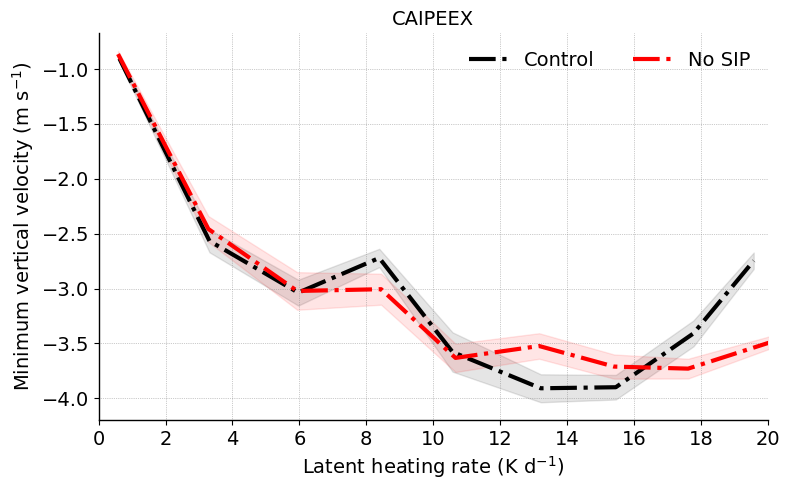

In [125]:


ln1=3;
ln2=2;
fnt=14;

def plot_with_shaded_error_lhr_wvel_mean(ax, x, y, xerr, yerr, color, label, linestyle='--', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

def plot_with_shaded_error_lhr_wvel_min(ax, x, y, xerr, yerr, color, label, linestyle='-.', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

def plot_with_shaded_error_lhr_wvel_max(ax, x, y, xerr, yerr, color, label, linestyle='-', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

fig, ax = plt.subplots(figsize=(8, 5))
plt.style.use('default')


#plot_with_shaded_error_lhr_wvel_max(ax, binned_lhr_mean_4sip, binned_wvel_max_4sip, err_lhr_mean_4sip, err_wvel_max_4sip, 'k', 'W$_{max}$ (Control)')
#plot_with_shaded_error_lhr_wvel_max(ax, binned_lhr_mean_nosip, binned_wvel_max_nosip, err_lhr_mean_nosip, err_wvel_max_nosip, 'r', 'W$_{max}$ (No SIP)')

plot_with_shaded_error_lhr_wvel_min(ax, binned_lhr_mean_4sip, binned_wvel_min_4sip, err_lhr_mean_4sip, err_wvel_min_4sip, 'k', 'Control')
plot_with_shaded_error_lhr_wvel_min(ax, binned_lhr_mean_nosip, binned_wvel_min_nosip, err_lhr_mean_nosip, err_wvel_min_nosip, 'r', 'No SIP')

#plot_with_shaded_error_lhr_wvel_mean(ax, binned_lhr_mean_4sip, binned_wvel_mean_4sip, err_lhr_mean_4sip, err_wvel_mean_4sip, 'k', 'Control')
#plot_with_shaded_error_lhr_wvel_mean(ax, binned_lhr_mean_nosip, binned_wvel_mean_nosip, err_lhr_mean_nosip, err_wvel_mean_nosip, 'r', 'No SIP')


# Repeat for SW and LW

ax.set_xlim(0, 20)
#ax.set_ylim(200, -1000)

ax.set_xticks([0, 2, 4, 6, 8, 10, 12, 14, 16, 18, 20])
#ax.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
#ax.set_yticks([0, 4, 8, 12, 16])

ax.tick_params(axis='x', labelsize=fnt)
ax.tick_params(axis='y', labelsize=fnt)
ax.set_xlabel('Latent heating rate (K d$^{-1}$)', fontsize=fnt)
ax.set_ylabel('Minimum vertical velocity (m s$^{-1}$)', fontsize=fnt)
ax.set_title('CAIPEEX', fontsize=fnt)

ax.legend(frameon=False, handlelength=2, labelspacing=0.05, ncols=2, fontsize=fnt, loc='best')
ax.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

ax.spines['top'].set_linewidth(1)
ax.spines['right'].set_linewidth(1)
ax.spines['left'].set_linewidth(1)
ax.spines['bottom'].set_linewidth(1)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.tight_layout()
plt.show()


In [8]:
import numpy as np
from scipy.stats import pearsonr

def calc_lhr_wvel_correlation(lhr_kperd, w_vel):
    time, height, ncells = lhr_kperd.shape
    corr_profile = np.zeros(height)
    for z in range(height):
        lh_flat = lhr_kperd[:, z, :].flatten()
        w_flat = w_vel[:, z, :].flatten()
        mask = ~np.isnan(lh_flat) & ~np.isnan(w_flat)
        if np.sum(mask) > 0:  # this can be higher, arbitrary threshold
            corr_profile[z], _ = pearsonr(lh_flat[mask], w_flat[mask])
        else:
            corr_profile[z] = np.nan
    return corr_profile

corr_lhr_wvel_4sip = calc_lhr_wvel_correlation(ds_4sip['lhr_kperd'].values, ds_4sip['w_vel'].values)
corr_lhr_wvel_nosip = calc_lhr_wvel_correlation(ds_nosip['lhr_kperd'].values, ds_nosip['w_vel'].values)


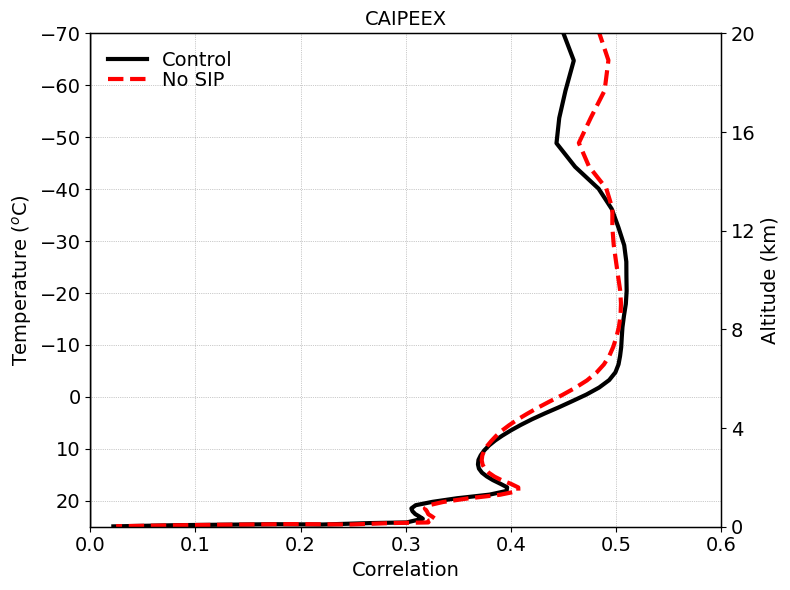

In [9]:

fontsize=14;
lnwdth=3;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)

plt1.plot(corr_lhr_wvel_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Control')
plt1.plot(corr_lhr_wvel_nosip, mean_tempc_nosip, 'r--', linewidth=lnwdth, label='No SIP')


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(corr_lhr_wvel_nosip, mean_tempc_nosip, '-', color='none', linewidth=lnwdth)

plt1.set_xlim(0., 0.6)
plt1.set_ylim(25, -70) 
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([-2, -1, 0, 1, 2]) 
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70]) 
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Correlation', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt.title('CAIPEEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


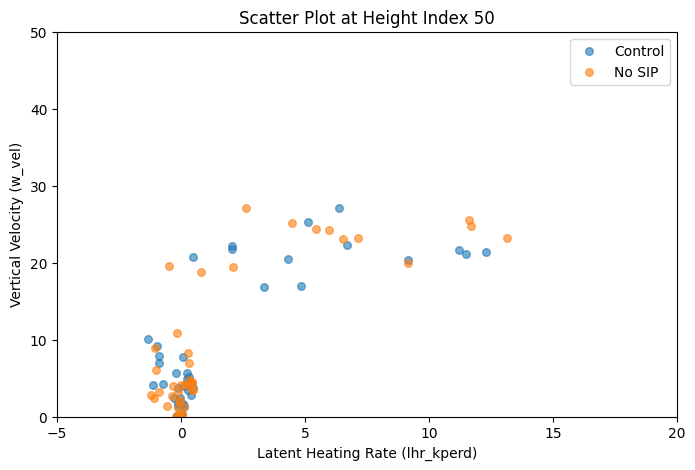

In [39]:
import numpy as np
import matplotlib.pyplot as plt

z_idx = 50  # Example: use height index 10 (choose relevant layer for your case)

# Flatten time and ncells for the selected height
lh_4sip = ds_4sip['lhr_kperd'][:, :z_idx, :].mean(dim=('height','ncells')).values.flatten()
w_4sip = ds_4sip['w_vel'][:, :z_idx, :].max(dim=('height','ncells')).values.flatten()
lh_nosip = ds_nosip['lhr_kperd'][:, :z_idx, :].mean(dim=('height','ncells')).values.flatten()
w_nosip = ds_nosip['w_vel'][:, :z_idx, :].max(dim=('height','ncells')).values.flatten()

# Optional: mask invalid data
mask_4sip = (~np.isnan(lh_4sip)) & (~np.isnan(w_4sip))
mask_nosip = (~np.isnan(lh_nosip)) & (~np.isnan(w_nosip))

plt.figure(figsize=(8, 5))
plt.scatter(lh_4sip[mask_4sip], w_4sip[mask_4sip], s=30, alpha=0.6, label='Control')
plt.scatter(lh_nosip[mask_nosip], w_nosip[mask_nosip], s=30, alpha=0.6, label='No SIP')

plt.xlim(-5,20)
plt.ylim(0,50)
plt.xlabel('Latent Heating Rate (lhr_kperd)')
plt.ylabel('Vertical Velocity (w_vel)')
plt.title('Scatter Plot at Height Index {}'.format(z_idx))
plt.legend()
plt.show()


In [40]:
from sklearn.linear_model import LinearRegression

def fit_slope(x, y):
    mask = (~np.isnan(x)) & (~np.isnan(y))
    x_ = x[mask].reshape(-1, 1)
    y_ = y[mask]
    model = LinearRegression()
    model.fit(x_, y_)
    slope = model.coef_[0]
    intercept = model.intercept_
    r2 = model.score(x_, y_)
    return slope, intercept, r2

slope_4sip, intercept_4sip, r2_4sip = fit_slope(lh_4sip, w_4sip)
slope_nosip, intercept_nosip, r2_nosip = fit_slope(lh_nosip, w_nosip)

print(f"SIP run:    Slope = {slope_4sip:.4f},  Intercept = {intercept_4sip:.4f},  R² = {r2_4sip:.3f}")
print(f"No SIP run: Slope = {slope_nosip:.4f},  Intercept = {intercept_nosip:.4f},  R² = {r2_nosip:.3f}")


SIP run:    Slope = 1.8158,  Intercept = 6.0681,  R² = 0.583
No SIP run: Slope = 1.9498,  Intercept = 6.1155,  R² = 0.617


In [43]:

lhr_4sip = ds_4sip['lhr_kperd'].values 
wvel_4sip = ds_4sip['w_vel'].values
ntime, nheight, ncells = lhr_4sip.shape

corr_lhr_wvel_4sip = np.full((ntime, nheight), np.nan)

for t in range(ntime):
    for z in range(nheight):
        lh_flat = lhr_4sip[t, z, :].flatten()
        w_flat = wvel_4sip[t, z, :].flatten()
        mask = (~np.isnan(lh_flat)) & (~np.isnan(w_flat))
        if np.sum(mask) > 10:  # at least 10 valid points
            corr_lhr_wvel_4sip[t, z], _ = pearsonr(lh_flat[mask], w_flat[mask])



lhr_nosip = ds_nosip['lhr_kperd'].values 
wvel_nosip = ds_nosip['w_vel'].values
ntime, nheight, ncells = lhr_nosip.shape

corr_lhr_wvel_nosip = np.full((ntime, nheight), np.nan)

for t in range(ntime):
    for z in range(nheight):
        lh_flat = lhr_nosip[t, z, :].flatten()
        w_flat = wvel_nosip[t, z, :].flatten()
        mask = (~np.isnan(lh_flat)) & (~np.isnan(w_flat))
        if np.sum(mask) > 10:  # at least 10 valid points
            corr_lhr_wvel_nosip[t, z], _ = pearsonr(lh_flat[mask], w_flat[mask])



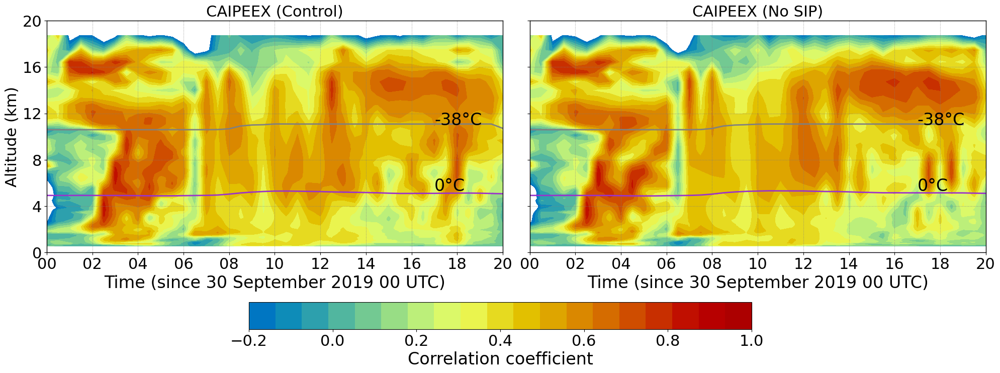

In [46]:

import matplotlib.lines as mlines

fnt=22;
fnt1=22;
ln=2;
ln1=1.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-0.2, 1, 20)
#lev1 = np.linspace(1, 1200, 20)
#lev2 = np.linspace(-4, 10, 20)
plt.figure(figsize=(20, 6))
plt.style.use('default')

plt.subplot(1,2,1)
cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, corr_lhr_wvel_4sip.T, levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[0, 2, 4, 6, 8, 10, 12])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[34], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[34], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-0.2, 1, 6)
#contours = plt.contour(ds_4sip.time, mean_ht_4sip, corr_lhr_wvel_4sip.T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,2,2)
cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, corr_lhr_wvel_nosip.T, levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-4, -2, 0, 2, 4, 6, 8, 10, 12])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of Total INC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[34], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[34], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('CAIPEEX (No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-0.2, 1, 6)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, corr_lhr_wvel_nosip.T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()  # Get the current figure
cbar_ax = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar = fig.colorbar(cnt, cax=cbar_ax, ticks=[-0.2, 0, 0.2, 0.4, 0.6, 0.8, 1], orientation='horizontal')
#cbar = fig.colorbar(cnt, cax=cbar_ax, ticks=[1, 1000, 2000, 3000, 4000], orientation='horizontal')#, ticks=[-4, -2, 0, 2, 4, 6, 8, 10, 12], orientation='horizontal')
cbar.set_label('Correlation coefficient', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt)

plt.tight_layout()
plt.show()


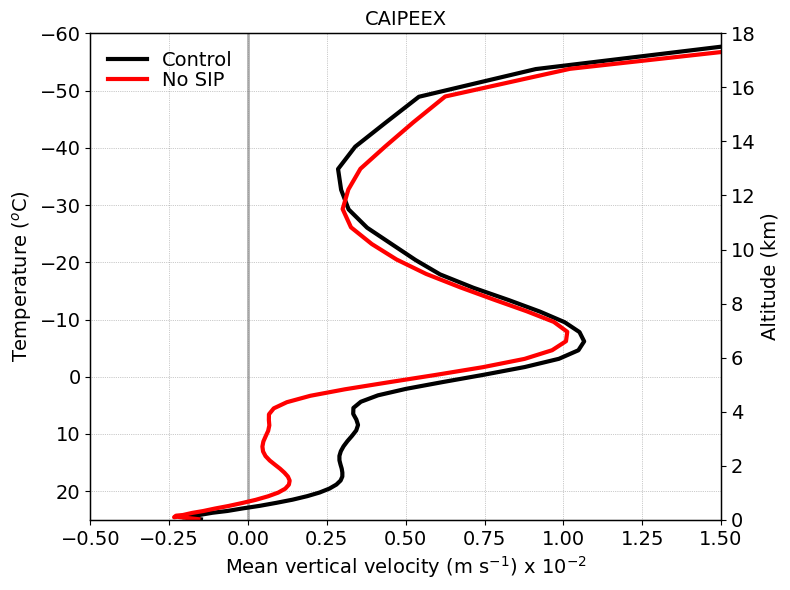

In [60]:
start_time='2019-09-30T08:00:00.000000000';
end_time='2019-09-30T14:00:00.000000000'

mean_wvel_4sip = ds_4sip.w_vel.sel(time=slice(start_time, end_time)).mean(dim=('time', 'ncells'))
mean_wvel_nosip = ds_nosip.w_vel.sel(time=slice(start_time, end_time)).mean(dim=('time', 'ncells'))

fontsize=14;
lnwdth=3;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1 = plt.gca()
plt2 = plt1.twinx()

fac=100.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(fac*mean_wvel_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Control')
plt1.plot(fac*mean_wvel_nosip, mean_tempc_nosip, 'r-', linewidth=lnwdth, label='No SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(ds_nosip.w_vel.mean(dim=('time','ncells')), mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(-0.5, 1.5)
plt1.set_ylim(25, -60) 
plt2.set_ylim(0.5, 18)

#plt1.set_xticks([-2, -1, 0, 1, 2]) 
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60]) 
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14, 16, 18])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Mean vertical velocity (m s$^{-1}$) x 10$^{-2}$', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt.title('CAIPEEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


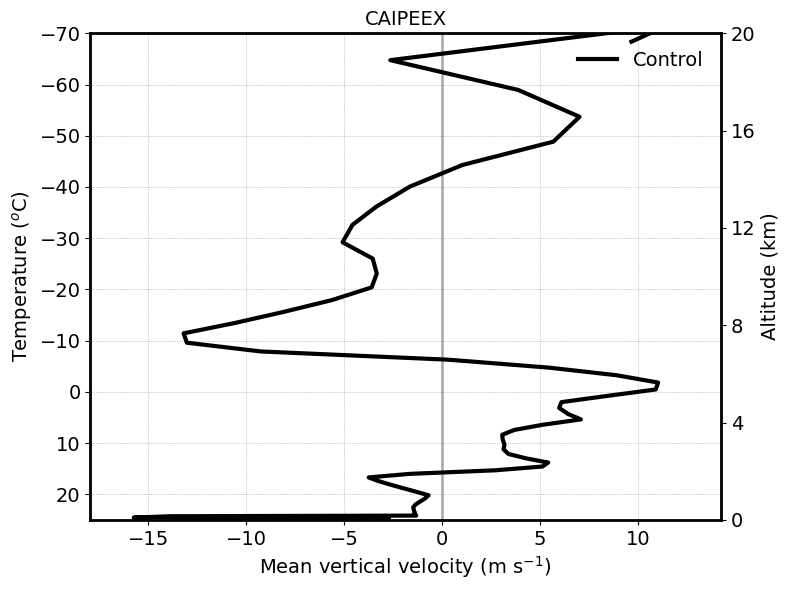

In [53]:

fontsize=14;
lnwdth=3;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(100*(ds_4sip.w_vel.max(dim=('time','ncells'))-ds_nosip.w_vel.max(dim=('time','ncells')))/ds_4sip.w_vel.max(dim=('time','ncells')), mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Control')
#plt1.plot(ds_nosip.w_vel.mean(dim=('time','ncells')), mean_tempc_nosip, 'r-', linewidth=lnwdth, label='No SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(ds_nosip.w_vel.mean(dim=('time','ncells')), mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

#plt1.set_xlim(-2., 3)
plt1.set_ylim(25, -70) 
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([-2, -1, 0, 1, 2]) 
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70]) 
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Mean vertical velocity (m s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt.title('CAIPEEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.tight_layout()
plt.show()


## Standardised regression coefficient

#### A standardized regression coefficient tells How many standard deviations the target variable (y, here TOA net flux)
#### changes for one standard deviation change in the predictor (x_i), holding other variables constant.

In [ ]:
from sklearn.ensemble import RandomForestRegressor  # ✅ Required import
from sklearn.metrics import r2_score
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
import xarray as xr
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Set TOA index
toa_idx = 0

# Extract variables without collapsing time/ncells — preserve data points
clcl_4sip = ds_4sip['clcl'].sel(time=slice(start_time, end_time)).squeeze(dim='plev')               # (time, ncells)
clcm_4sip = ds_4sip['clcm'].sel(time=slice(start_time, end_time)).squeeze(dim='plev_2')             # (time, ncells)
clch_4sip = ds_4sip['clch'].sel(time=slice(start_time, end_time)).squeeze(dim='plev_3')             # (time, ncells)
clct_4sip = ds_4sip['clct'].sel(time=slice(start_time, end_time))                                  # (time, ncells)
qc_4sip = ds_4sip['qc'].sel(time=slice(start_time, end_time)).mean('height')#isel(height=0)                        # (time, ncells)
qi_4sip = ds_4sip['qi'].sel(time=slice(start_time, end_time)).isel(height=0)                        # (time, ncells)
qs_4sip = ds_4sip['qs'].sel(time=slice(start_time, end_time)).isel(height=0)                        # (time, ncells)

clcl_nosip = ds_nosip['clcl'].sel(time=slice(start_time, end_time)).squeeze(dim='plev')               # (time, ncells)
clcm_nosip = ds_nosip['clcm'].sel(time=slice(start_time, end_time)).squeeze(dim='plev_2')             # (time, ncells)
clch_nosip = ds_nosip['clch'].sel(time=slice(start_time, end_time)).squeeze(dim='plev_3')             # (time, ncells)
clct_nosip = ds_nosip['clct'].sel(time=slice(start_time, end_time))                                   # (time, ncells)
qc_nosip = ds_nosip['qc'].sel(time=slice(start_time, end_time)).mean('height')#isel(height=0)                        # (time, ncells)
qi_nosip = ds_nosip['qi'].sel(time=slice(start_time, end_time)).isel(height=0)                        # (time, ncells)
qs_nosip = ds_nosip['qs'].sel(time=slice(start_time, end_time)).isel(height=0)                        # (time, ncells)

# Compute TOA net flux
net_flux_4sip = (
    (ds_4sip['swflx_dn'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx) - ds_4sip['swflx_up'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx)) -
    (ds_4sip['swflx_dn_clr'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx) - ds_4sip['swflx_up_clr'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx)) +
    (ds_4sip['lwflx_dn'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx) - ds_4sip['lwflx_up'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx)) -
    (ds_4sip['lwflx_dn_clr'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx) - ds_4sip['lwflx_up_clr'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx))
)

net_flux_nosip = (
    (ds_nosip['swflx_dn'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx) - ds_nosip['swflx_up'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx)) -
    (ds_nosip['swflx_dn_clr'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx) - ds_nosip['swflx_up_clr'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx)) +
    (ds_nosip['lwflx_dn'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx) - ds_nosip['lwflx_up'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx)) -
    (ds_nosip['lwflx_dn_clr'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx) - ds_nosip['lwflx_up_clr'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx))
)

# Build dataframe (flatten all variables)
df_4sip = pd.DataFrame({
    'clcl': clcl_4sip.values.flatten(),
    'clcm': clcm_4sip.values.flatten(),
    'clch': clch_4sip.values.flatten(),
    'clct': clct_4sip.values.flatten(),
    'qc': qc_4sip.values.flatten(),
    'qi': qi_4sip.values.flatten(),
    'qs': qs_4sip.values.flatten(),
    'net_flux': net_flux_4sip.values.flatten()
})

df_nosip = pd.DataFrame({
    'clcl': clcl_nosip.values.flatten(),
    'clcm': clcm_nosip.values.flatten(),
    'clch': clch_nosip.values.flatten(),
    'clct': clct_nosip.values.flatten(),
    'qc': qc_nosip.values.flatten(),
    'qi': qi_nosip.values.flatten(),
    'qs': qs_nosip.values.flatten(),
    'net_flux': net_flux_nosip.values.flatten()
})

# Drop missing values
df_4sip = df_4sip.dropna()
df_nosip = df_nosip.dropna()

# Prepare X and y for regression
X_4sip = df_4sip.drop('net_flux', axis=1).values
y_4sip = df_4sip['net_flux'].values

X_nosip = df_nosip.drop('net_flux', axis=1).values
y_nosip = df_nosip['net_flux'].values

# Standardize predictors
scaler_4sip = StandardScaler()
X_4sip_scaled = scaler_4sip.fit_transform(X_4sip)

scaler_nosip = StandardScaler()
X_nosip_scaled = scaler_nosip.fit_transform(X_nosip)

# Fit regression model
model_4sip = LinearRegression()
model_4sip.fit(X_4sip_scaled, y_4sip)

model_nosip = LinearRegression()
model_nosip.fit(X_nosip_scaled, y_nosip)


# Plot standardized coefficients
coefs_4sip = model_4sip.coef_
features_4sip = df_4sip.drop('net_flux', axis=1).columns

coefs_nosip = model_nosip.coef_
features_nosip = df_nosip.drop('net_flux', axis=1).columns



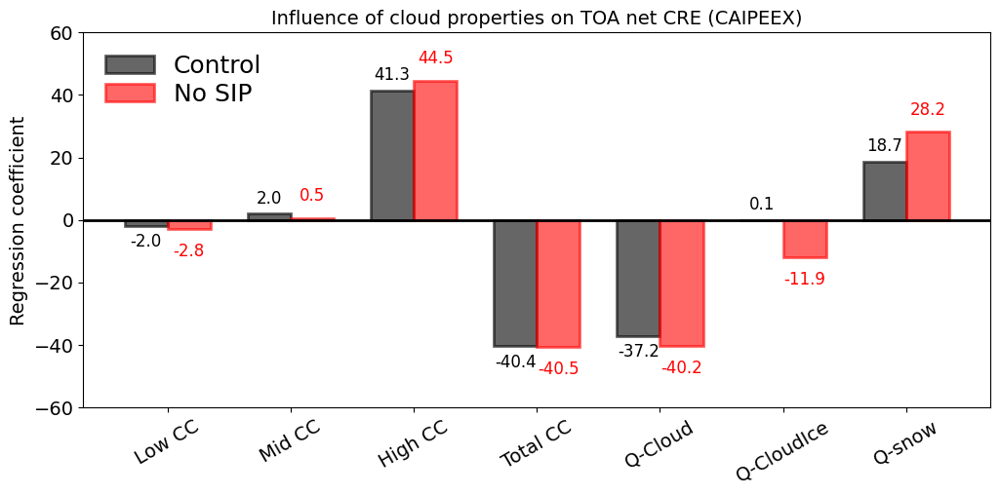

In [90]:

comp_groups = ['Low CC', 'Mid CC', 'High CC', 'Total CC', 'Q-Cloud', 'Q-CloudIce', 'Q-snow']

x_feature = np.arange(len(features_4sip))  # base x locations
width = 0.35

fnt=14;
ln=2;

fig, ax = plt.subplots(figsize=(12, 5))#, sharey=False)
plt.style.use('default')

#ax1 = axs[0]

ax.axhline(y=0, color='k', linewidth=ln, linestyle='-')

rects1 = ax.bar(x_feature - width/2, coefs_4sip, width, color='black', facecolor='k', edgecolor='k', linewidth=ln, alpha=alp, label='Control')
rects2 = ax.bar(x_feature + width/2, coefs_nosip, width, color='red', facecolor='r', edgecolor='r', linewidth=ln, alpha=alp, label='No SIP')

ax.bar_label(rects1, padding=5, color='k', fontsize=fnt-2, fmt='%.1f')
ax.bar_label(rects2, padding=10, color='r', fontsize=fnt-2, fmt='%.1f')

# For the left bars (rects1)
#for rect in rects1:
#    # Shift left by a small amount (e.g., -0.1)
#    x = rect.get_x() + rect.get_width() / 2 - 0.1  # Shift left for left bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='k', fontsize=fnt-2)

# For the right bars (rects2)
#for rect in rects2:
#    # Shift right by a small amount (e.g., +0.1)
#    x = rect.get_x() + rect.get_width() / 2 + 0.1  # Shift right for right bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='r', fontsize=fnt-2)
    
# Customization
ax.set_ylim(-60, 60)
ax.set_ylabel('Regression coefficient', fontsize=fnt)
ax.set_xticks(x_feature)
ax.set_xticklabels(comp_groups, rotation=30)
ax.set_title('Influence of cloud properties on TOA net CRE (CAIPEEX)', fontsize=fnt)
ax.tick_params(axis='both', labelsize=fnt)

ax.legend(frameon=False, handlelength=2, labelspacing=0.2, ncols=1, fontsize=fnt+4, loc='best')

plt.show()

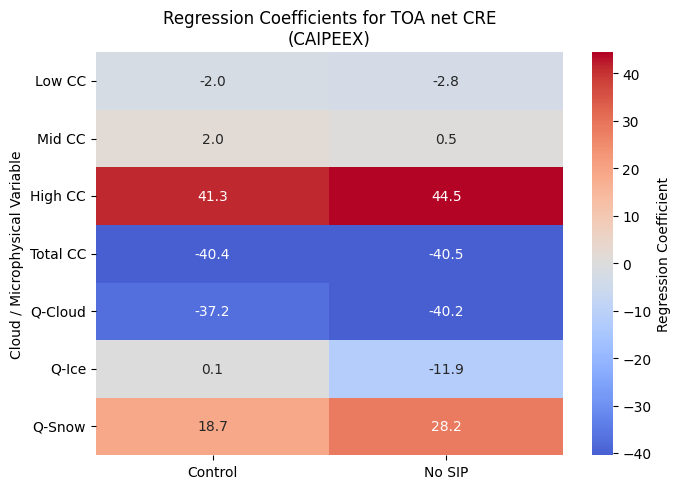

In [91]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Example coefficients
features = ['Low CC', 'Mid CC', 'High CC', 'Total CC', 'Q-Cloud', 'Q-Ice', 'Q-Snow']


# Create DataFrame for heatmap
df_heat = pd.DataFrame({
    'Control': coefs_4sip,
    'No SIP': coefs_nosip
}, index=features)

# Plot heatmap
plt.figure(figsize=(7, 5))
sns.heatmap(df_heat, annot=True, cmap='coolwarm', center=0, fmt='.1f',
            cbar_kws={'label': 'Regression Coefficient'})

plt.title('Regression Coefficients for TOA net CRE\n(CAIPEEX)')
plt.ylabel('Cloud / Microphysical Variable')
plt.tight_layout()
plt.show()


## Box plots of TOA radiative fluxes

In [98]:

## 4 SIP
min_toa_lw_cre_4sip = ds_4sip.toa_lw_cre.min().values; max_toa_lw_cre_4sip = ds_4sip.toa_lw_cre.max().values
mean_toa_lw_cre_4sip = ds_4sip.toa_lw_cre.mean().values

min_toa_sw_cre_4sip = ds_4sip.toa_sw_cre.min().values; max_toa_sw_cre_4sip = ds_4sip.toa_sw_cre.max().values
mean_toa_sw_cre_4sip = ds_4sip.toa_sw_cre.mean().values

min_toa_net_cre_4sip = ds_4sip.toa_net_cre.min().values; max_toa_net_cre_4sip = ds_4sip.toa_net_cre.max().values
mean_toa_net_cre_4sip = ds_4sip.toa_net_cre.mean().values


## No SIP
min_toa_lw_cre_nosip = ds_nosip.toa_lw_cre.min().values; max_toa_lw_cre_nosip = ds_nosip.toa_lw_cre.max().values
mean_toa_lw_cre_nosip = ds_nosip.toa_lw_cre.mean().values

min_toa_sw_cre_nosip = ds_nosip.toa_sw_cre.min().values; max_toa_sw_cre_nosip = ds_nosip.toa_sw_cre.max().values
mean_toa_sw_cre_nosip = ds_nosip.toa_sw_cre.mean().values

min_toa_net_cre_nosip = ds_nosip.toa_net_cre.min().values; max_toa_net_cre_nosip = ds_nosip.toa_net_cre.max().values
mean_toa_net_cre_nosip = ds_nosip.toa_net_cre.mean().values

del_min_toa_lw_cre_nosip = min_toa_lw_cre_4sip-min_toa_lw_cre_nosip; del_max_toa_lw_cre_nosip = max_toa_lw_cre_4sip-max_toa_lw_cre_nosip;
del_mean_toa_lw_cre_nosip = mean_toa_lw_cre_4sip-mean_toa_lw_cre_nosip; 
del_min_toa_sw_cre_nosip = min_toa_sw_cre_4sip-min_toa_sw_cre_nosip; del_max_toa_sw_cre_nosip = max_toa_sw_cre_4sip-max_toa_sw_cre_nosip;
del_mean_toa_sw_cre_nosip = mean_toa_sw_cre_4sip-mean_toa_sw_cre_nosip; 
del_min_toa_net_cre_nosip = min_toa_net_cre_4sip-min_toa_net_cre_nosip; del_max_toa_net_cre_nosip = max_toa_net_cre_4sip-max_toa_net_cre_nosip;
del_mean_toa_net_cre_nosip = mean_toa_net_cre_4sip-mean_toa_net_cre_nosip; 

## No RDS
min_toa_lw_cre_norf = ds_norf.toa_lw_cre.min().values; max_toa_lw_cre_norf = ds_norf.toa_lw_cre.max().values
mean_toa_lw_cre_norf = ds_norf.toa_lw_cre.mean().values

min_toa_sw_cre_norf = ds_norf.toa_sw_cre.min().values; max_toa_sw_cre_norf = ds_norf.toa_sw_cre.max().values
mean_toa_sw_cre_norf = ds_norf.toa_sw_cre.mean().values

min_toa_net_cre_norf = ds_norf.toa_net_cre.min().values; max_toa_net_cre_norf = ds_norf.toa_net_cre.max().values
mean_toa_net_cre_norf = ds_norf.toa_net_cre.mean().values

del_min_toa_lw_cre_norf = min_toa_lw_cre_4sip-min_toa_lw_cre_norf; del_max_toa_lw_cre_norf = max_toa_lw_cre_4sip-max_toa_lw_cre_norf;
del_mean_toa_lw_cre_norf = mean_toa_lw_cre_4sip-mean_toa_lw_cre_norf; 
del_min_toa_sw_cre_norf = min_toa_sw_cre_4sip-min_toa_sw_cre_norf; del_max_toa_sw_cre_norf = max_toa_sw_cre_4sip-max_toa_sw_cre_norf;
del_mean_toa_sw_cre_norf = mean_toa_sw_cre_4sip-mean_toa_sw_cre_norf; 
del_min_toa_net_cre_norf = min_toa_net_cre_4sip-min_toa_net_cre_norf; del_max_toa_net_cre_norf = max_toa_net_cre_4sip-max_toa_net_cre_norf;
del_mean_toa_net_cre_norf = mean_toa_net_cre_4sip-mean_toa_net_cre_norf;

## No HM
min_toa_lw_cre_nohm = ds_nohm.toa_lw_cre.min().values; max_toa_lw_cre_nohm = ds_nohm.toa_lw_cre.max().values
mean_toa_lw_cre_nohm = ds_nohm.toa_lw_cre.mean().values

min_toa_sw_cre_nohm = ds_nohm.toa_sw_cre.min().values; max_toa_sw_cre_nohm = ds_nohm.toa_sw_cre.max().values
mean_toa_sw_cre_nohm = ds_nohm.toa_sw_cre.mean().values

min_toa_net_cre_nohm = ds_nohm.toa_net_cre.min().values; max_toa_net_cre_nohm = ds_nohm.toa_net_cre.max().values
mean_toa_net_cre_nohm = ds_nohm.toa_net_cre.mean().values

del_min_toa_lw_cre_nohm = min_toa_lw_cre_4sip-min_toa_lw_cre_nohm; del_max_toa_lw_cre_nohm = max_toa_lw_cre_4sip-max_toa_lw_cre_nohm;
del_mean_toa_lw_cre_nohm = mean_toa_lw_cre_4sip-mean_toa_lw_cre_nohm; 
del_min_toa_sw_cre_nohm = min_toa_sw_cre_4sip-min_toa_sw_cre_nohm; del_max_toa_sw_cre_nohm = max_toa_sw_cre_4sip-max_toa_sw_cre_nohm;
del_mean_toa_sw_cre_nohm = mean_toa_sw_cre_4sip-mean_toa_sw_cre_nohm; 
del_min_toa_net_cre_nohm = min_toa_net_cre_4sip-min_toa_net_cre_nohm; del_max_toa_net_cre_nohm = max_toa_net_cre_4sip-max_toa_net_cre_nohm;
del_mean_toa_net_cre_nohm = mean_toa_net_cre_4sip-mean_toa_net_cre_nohm;

## No BR
min_toa_lw_cre_nobr = ds_nobr.toa_lw_cre.min().values; max_toa_lw_cre_nobr = ds_nobr.toa_lw_cre.max().values
mean_toa_lw_cre_nobr = ds_nobr.toa_lw_cre.mean().values

min_toa_sw_cre_nobr = ds_nobr.toa_sw_cre.min().values; max_toa_sw_cre_nobr = ds_nobr.toa_sw_cre.max().values
mean_toa_sw_cre_nobr = ds_nobr.toa_sw_cre.mean().values

min_toa_net_cre_nobr = ds_nobr.toa_net_cre.min().values; max_toa_net_cre_nobr = ds_nobr.toa_net_cre.max().values
mean_toa_net_cre_nobr = ds_nobr.toa_net_cre.mean().values

del_min_toa_lw_cre_nobr = min_toa_lw_cre_4sip-min_toa_lw_cre_nobr; del_max_toa_lw_cre_nobr = max_toa_lw_cre_4sip-max_toa_lw_cre_nobr;
del_mean_toa_lw_cre_nobr = mean_toa_lw_cre_4sip-mean_toa_lw_cre_nobr; 
del_min_toa_sw_cre_nobr = min_toa_sw_cre_4sip-min_toa_sw_cre_nobr; del_max_toa_sw_cre_nobr = max_toa_sw_cre_4sip-max_toa_sw_cre_nobr;
del_mean_toa_sw_cre_nobr = mean_toa_sw_cre_4sip-mean_toa_sw_cre_nobr; 
del_min_toa_net_cre_nobr = min_toa_net_cre_4sip-min_toa_net_cre_nobr; del_max_toa_net_cre_nobr = max_toa_net_cre_4sip-max_toa_net_cre_nobr;
del_mean_toa_net_cre_nobr = mean_toa_net_cre_4sip-mean_toa_net_cre_nobr;

## No SB
min_toa_lw_cre_nosb = ds_nosb.toa_lw_cre.min().values; max_toa_lw_cre_nosb = ds_nosb.toa_lw_cre.max().values
mean_toa_lw_cre_nosb = ds_nosb.toa_lw_cre.mean().values

min_toa_sw_cre_nosb = ds_nosb.toa_sw_cre.min().values; max_toa_sw_cre_nosb = ds_nosb.toa_sw_cre.max().values
mean_toa_sw_cre_nosb = ds_nosb.toa_sw_cre.mean().values

min_toa_net_cre_nosb = ds_nosb.toa_net_cre.min().values; max_toa_net_cre_nosb = ds_nosb.toa_net_cre.max().values
mean_toa_net_cre_nosb = ds_nosb.toa_net_cre.mean().values

del_min_toa_lw_cre_nosb = min_toa_lw_cre_4sip-min_toa_lw_cre_nosb; del_max_toa_lw_cre_nosb = max_toa_lw_cre_4sip-max_toa_lw_cre_nosb;
del_mean_toa_lw_cre_nosb = mean_toa_lw_cre_4sip-mean_toa_lw_cre_nosb; 
del_min_toa_sw_cre_nosb = min_toa_sw_cre_4sip-min_toa_sw_cre_nosb; del_max_toa_sw_cre_nosb = max_toa_sw_cre_4sip-max_toa_sw_cre_nosb;
del_mean_toa_sw_cre_nosb = mean_toa_sw_cre_4sip-mean_toa_sw_cre_nosb; 
del_min_toa_net_cre_nosb = min_toa_net_cre_4sip-min_toa_net_cre_nosb; del_max_toa_net_cre_nosb = max_toa_net_cre_4sip-max_toa_net_cre_nosb;
del_mean_toa_net_cre_nosb = mean_toa_net_cre_4sip-mean_toa_net_cre_nosb;


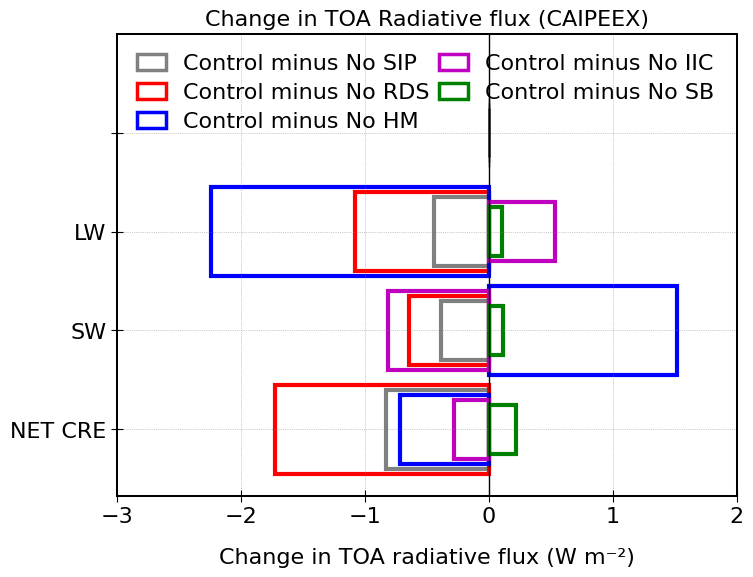

In [101]:
import matplotlib.pyplot as plt
import numpy as np

fnt = 16.0
ln=3;
x = np.array([1, 2, 3, 4])
#w1, w2, w3, w4, w5 = 0.9, 0.6, 0.7, 0.6, 0.5
w1, w2, w3, w4, w5 = 0.9, 0.8, 0.7, 0.6, 0.5

# Data for bars (assuming they are defined elsewhere in your code)
# Q_glc_lif_acm, Q_mix_lif_acm, Q_ice_lif_acm, etc.

#plt.figure('AIE CLOUDS', figsize=(12, 12))

# Plotting
#plt.figure('AIE CLOUDS')
plt.figure(figsize=(8,6))
plt.style.use('default')

plt.gca().tick_params(axis='both', which='major', labelsize=fnt)
plt.gca().tick_params(axis='both', which='minor', labelsize=fnt)
plt.gca().tick_params(axis='both', direction='inout')
plt.gca().tick_params(axis='both', length=8)


plt.barh(x[0], 0., height=w3, color='g', edgecolor='black')
plt.barh(x[0], 0., height=w4, color='b', edgecolor='black')
plt.barh(x[0], 0., height=w5, color='m', edgecolor='black')
plt.barh(x[0], 0., height=w5, color='g', edgecolor='black')
plt.barh(x[0], 0., height=w5, color='c', edgecolor='black')

# Total CLOUD AIE

plt.barh(x[1], del_mean_toa_lw_cre_nosip, height=w3, color='k', linewidth=ln, facecolor='none', edgecolor='grey')
plt.barh(x[1], del_mean_toa_lw_cre_norf, height=w2, color='r', linewidth=ln, facecolor='none', edgecolor='r')
plt.barh(x[1], del_mean_toa_lw_cre_nohm, height=w1, color='b', linewidth=ln, facecolor='none', edgecolor='b')
plt.barh(x[1], del_mean_toa_lw_cre_nobr, height=w4, color='m', linewidth=ln, facecolor='none', edgecolor='m')
plt.barh(x[1], del_mean_toa_lw_cre_nosb, height=w5, color='g', linewidth=ln, facecolor='none', edgecolor='g')


plt.barh(x[2], del_mean_toa_sw_cre_nosip, height=w4, color='k', linewidth=ln, facecolor='none', edgecolor='grey')
plt.barh(x[2], del_mean_toa_sw_cre_norf, height=w3, color='r', linewidth=ln, facecolor='none', edgecolor='r')
plt.barh(x[2], del_mean_toa_sw_cre_nohm, height=w1, color='b', linewidth=ln, facecolor='none', edgecolor='b')
plt.barh(x[2], del_mean_toa_sw_cre_nobr, height=w2, color='m', linewidth=ln, facecolor='none', edgecolor='m')
plt.barh(x[2], del_mean_toa_sw_cre_nosb, height=w5, color='g', linewidth=ln, facecolor='none', edgecolor='g')


plt.barh(x[3], del_mean_toa_net_cre_nosip, height=w2, color='k', linewidth=ln, facecolor='none', edgecolor='grey')
plt.barh(x[3], del_mean_toa_net_cre_norf, height=w1, color='r', linewidth=ln, facecolor='none', edgecolor='r')
plt.barh(x[3], del_mean_toa_net_cre_nohm, height=w3, color='b', linewidth=ln, facecolor='none', edgecolor='b')
plt.barh(x[3], del_mean_toa_net_cre_nobr, height=w4, color='m', linewidth=ln, facecolor='none', edgecolor='m')
plt.barh(x[3], del_mean_toa_net_cre_nosb, height=w5, color='g', linewidth=ln, facecolor='none', edgecolor='g')

plt.axvline(x=0, color='k', linewidth=ln-2, linestyle='-')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt.xlim([-3.0, 2.0])
plt.yticks(x,['', 'LW', 'SW', 'NET CRE'], fontsize=fnt, rotation=0.)
plt.xlabel('Change in TOA radiative flux (W m⁻²)', fontsize=fnt, labelpad=15)
plt.gca().invert_yaxis()

colors = ['grey', 'r', 'b', 'm', 'g']
#labels = ['Total clouds', 'Glaciated clouds', 'Liquid-only clouds', 'Mixed-phase clouds', 'Ice-only clouds']
labels = ['Control minus No SIP', 'Control minus No RDS', 'Control minus No HM', 'Control minus No IIC', 'Control minus No SB']
hBLG = [plt.bar([0, 0], [0, 0], color=colors[i]) for i in range(len(colors))]
legend=plt.legend(hBLG, labels, loc='upper left', fontsize=fnt, ncol=2, frameon=False, facecolor='none', 
                  handlelength=1.3, labelspacing=0.4, columnspacing=0.4)
for patch, color in zip(legend.get_patches(), colors):
    patch.set_facecolor('none')      # Transparent fill
    patch.set_edgecolor(color)       # Colored edge
    patch.set_linewidth(ln-0.5) 
    
#plt.tight_layout(pad=-1.0)

plt.title('Change in TOA Radiative flux (CAIPEEX)', fontsize=fnt)
#plt.grid(False)
plt.gca().spines['top'].set_linewidth(1.45)
plt.gca().spines['right'].set_linewidth(1.45)
plt.gca().spines['bottom'].set_linewidth(1.45)
plt.gca().spines['left'].set_linewidth(1.45)

plt.show()


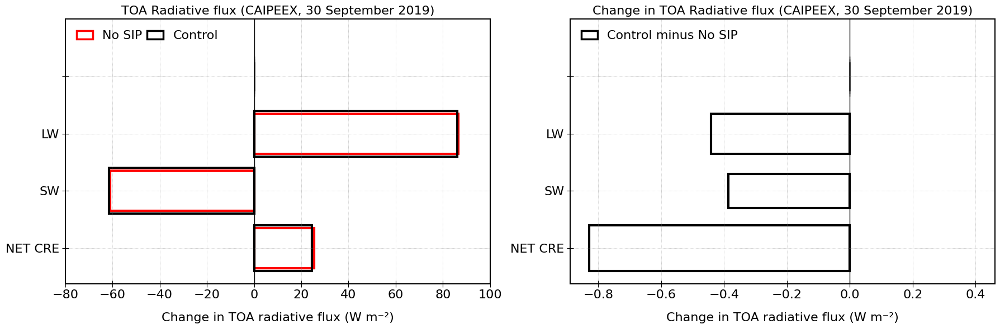

In [113]:
import matplotlib.pyplot as plt
import numpy as np

fnt = 16.0
ln=3;
x = np.array([1, 2, 3, 4])
#w1, w2, w3, w4, w5 = 0.9, 0.6, 0.7, 0.6, 0.5
w1, w2, w3, w4, w5 = 0.9, 0.8, 0.7, 0.6, 0.5

# Data for bars (assuming they are defined elsewhere in your code)
# Q_glc_lif_acm, Q_mix_lif_acm, Q_ice_lif_acm, etc.

#plt.figure('AIE CLOUDS', figsize=(12, 12))

# Plotting
#plt.figure('AIE CLOUDS')
plt.figure(figsize=(18,6))
plt.style.use('default')

plt.subplot(1,2,1)

plt.gca().tick_params(axis='both', which='major', labelsize=fnt)
plt.gca().tick_params(axis='both', which='minor', labelsize=fnt)
plt.gca().tick_params(axis='both', direction='inout')
plt.gca().tick_params(axis='both', length=8)


plt.barh(x[0], 0., height=w3, color='g', edgecolor='black')
plt.barh(x[0], 0., height=w4, color='b', edgecolor='black')
plt.barh(x[0], 0., height=w5, color='m', edgecolor='black')
plt.barh(x[0], 0., height=w5, color='g', edgecolor='black')
plt.barh(x[0], 0., height=w5, color='c', edgecolor='black')

# Total CLOUD AIE

plt.barh(x[1], mean_toa_lw_cre_nosip, height=w3, color='k', linewidth=ln, facecolor='none', edgecolor='r')
plt.barh(x[1], mean_toa_lw_cre_4sip, height=w2, color='r', linewidth=ln, facecolor='none', edgecolor='k')
#plt.barh(x[1], del_mean_toa_lw_cre_nohm, height=w1, color='b', linewidth=ln, facecolor='none', edgecolor='b')
#plt.barh(x[1], del_mean_toa_lw_cre_nobr, height=w4, color='m', linewidth=ln, facecolor='none', edgecolor='m')
#plt.barh(x[1], del_mean_toa_lw_cre_nosb, height=w5, color='g', linewidth=ln, facecolor='none', edgecolor='g')


plt.barh(x[2], mean_toa_sw_cre_nosip, height=w3, color='k', linewidth=ln, facecolor='none', edgecolor='r')
plt.barh(x[2], mean_toa_sw_cre_4sip, height=w2, color='r', linewidth=ln, facecolor='none', edgecolor='k')
#plt.barh(x[2], del_mean_toa_sw_cre_nohm, height=w1, color='b', linewidth=ln, facecolor='none', edgecolor='b')
#plt.barh(x[2], del_mean_toa_sw_cre_nobr, height=w2, color='m', linewidth=ln, facecolor='none', edgecolor='m')
#plt.barh(x[2], del_mean_toa_sw_cre_nosb, height=w5, color='g', linewidth=ln, facecolor='none', edgecolor='g')


plt.barh(x[3], mean_toa_net_cre_nosip, height=w3, color='k', linewidth=ln, facecolor='none', edgecolor='r')
plt.barh(x[3], mean_toa_net_cre_4sip, height=w2, color='r', linewidth=ln, facecolor='none', edgecolor='k')
#plt.barh(x[3], del_mean_toa_net_cre_nohm, height=w3, color='b', linewidth=ln, facecolor='none', edgecolor='b')
#plt.barh(x[3], del_mean_toa_net_cre_nobr, height=w4, color='m', linewidth=ln, facecolor='none', edgecolor='m')
#plt.barh(x[3], del_mean_toa_net_cre_nosb, height=w5, color='g', linewidth=ln, facecolor='none', edgecolor='g')

plt.axvline(x=0, color='k', linewidth=ln-2, linestyle='-')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt.xlim([-80.0, 100.0])
plt.yticks(x,['', 'LW', 'SW', 'NET CRE'], fontsize=fnt, rotation=0.)
plt.xlabel('Change in TOA radiative flux (W m⁻²)', fontsize=fnt, labelpad=15)
plt.gca().invert_yaxis()

colors = ['r', 'k']#, 'b', 'm', 'g']
#labels = ['Total clouds', 'Glaciated clouds', 'Liquid-only clouds', 'Mixed-phase clouds', 'Ice-only clouds']
#labels = ['Control minus No SIP', 'Control minus No RDS', 'Control minus No HM', 'Control minus No IIC', 'Control minus No SB']
labels = ['No SIP', 'Control']#, 'Control minus No HM', 'Control minus No IIC', 'Control minus No SB']
hBLG = [plt.bar([0, 0], [0, 0], color=colors[i]) for i in range(len(colors))]
legend=plt.legend(hBLG, labels, loc='upper left', fontsize=fnt, ncol=2, frameon=False, facecolor='none', 
                  handlelength=1.3, labelspacing=0.4, columnspacing=0.4)
for patch, color in zip(legend.get_patches(), colors):
    patch.set_facecolor('none')      # Transparent fill
    patch.set_edgecolor(color)       # Colored edge
    patch.set_linewidth(ln-0.5) 
    
#plt.tight_layout(pad=-1.0)

plt.title('TOA Radiative flux (CAIPEEX, 30 September 2019)', fontsize=fnt)
#plt.grid(False)
plt.gca().spines['top'].set_linewidth(1.45)
plt.gca().spines['right'].set_linewidth(1.45)
plt.gca().spines['bottom'].set_linewidth(1.45)
plt.gca().spines['left'].set_linewidth(1.45)

plt.subplot(1,2,2)

plt.gca().tick_params(axis='both', which='major', labelsize=fnt)
plt.gca().tick_params(axis='both', which='minor', labelsize=fnt)
plt.gca().tick_params(axis='both', direction='inout')
plt.gca().tick_params(axis='both', length=8)


plt.barh(x[0], 0., height=w3, color='g', edgecolor='black')
plt.barh(x[0], 0., height=w4, color='b', edgecolor='black')
plt.barh(x[0], 0., height=w5, color='m', edgecolor='black')
plt.barh(x[0], 0., height=w5, color='g', edgecolor='black')
plt.barh(x[0], 0., height=w5, color='c', edgecolor='black')

# Total CLOUD AIE

plt.barh(x[1], del_mean_toa_lw_cre_nosip, height=w3, color='k', linewidth=ln, facecolor='none', edgecolor='k')
#plt.barh(x[1], del_mean_toa_lw_cre_norf, height=w2, color='r', linewidth=ln, facecolor='none', edgecolor='r')
#plt.barh(x[1], del_mean_toa_lw_cre_nohm, height=w1, color='b', linewidth=ln, facecolor='none', edgecolor='b')
#plt.barh(x[1], del_mean_toa_lw_cre_nobr, height=w4, color='m', linewidth=ln, facecolor='none', edgecolor='m')
#plt.barh(x[1], del_mean_toa_lw_cre_nosb, height=w5, color='g', linewidth=ln, facecolor='none', edgecolor='g')


plt.barh(x[2], del_mean_toa_sw_cre_nosip, height=w4, color='k', linewidth=ln, facecolor='none', edgecolor='k')
#plt.barh(x[2], del_mean_toa_sw_cre_norf, height=w3, color='r', linewidth=ln, facecolor='none', edgecolor='r')
#plt.barh(x[2], del_mean_toa_sw_cre_nohm, height=w1, color='b', linewidth=ln, facecolor='none', edgecolor='b')
#plt.barh(x[2], del_mean_toa_sw_cre_nobr, height=w2, color='m', linewidth=ln, facecolor='none', edgecolor='m')
#plt.barh(x[2], del_mean_toa_sw_cre_nosb, height=w5, color='g', linewidth=ln, facecolor='none', edgecolor='g')


plt.barh(x[3], del_mean_toa_net_cre_nosip, height=w2, color='k', linewidth=ln, facecolor='none', edgecolor='k')
#plt.barh(x[3], del_mean_toa_net_cre_norf, height=w1, color='r', linewidth=ln, facecolor='none', edgecolor='r')
#plt.barh(x[3], del_mean_toa_net_cre_nohm, height=w3, color='b', linewidth=ln, facecolor='none', edgecolor='b')
#plt.barh(x[3], del_mean_toa_net_cre_nobr, height=w4, color='m', linewidth=ln, facecolor='none', edgecolor='m')
#plt.barh(x[3], del_mean_toa_net_cre_nosb, height=w5, color='g', linewidth=ln, facecolor='none', edgecolor='g')

plt.axvline(x=0, color='k', linewidth=ln-2, linestyle='-')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

#plt.xlim([-1.0, 1.0])
plt.yticks(x,['', 'LW', 'SW', 'NET CRE'], fontsize=fnt, rotation=0.)
plt.xlabel('Change in TOA radiative flux (W m⁻²)', fontsize=fnt, labelpad=15)
plt.gca().invert_yaxis()

colors = ['k']#, 'r', 'b', 'm', 'g']
#labels = ['Total clouds', 'Glaciated clouds', 'Liquid-only clouds', 'Mixed-phase clouds', 'Ice-only clouds']
#labels = ['Control minus No SIP', 'Control minus No RDS', 'Control minus No HM', 'Control minus No IIC', 'Control minus No SB']
labels = ['Control minus No SIP']
hBLG = [plt.bar([0, 0], [0, 0], color=colors[i]) for i in range(len(colors))]
legend=plt.legend(hBLG, labels, loc='upper left', fontsize=fnt, ncol=2, frameon=False, facecolor='none', 
                  handlelength=1.3, labelspacing=0.4, columnspacing=0.4)
for patch, color in zip(legend.get_patches(), colors):
    patch.set_facecolor('none')      # Transparent fill
    patch.set_edgecolor(color)       # Colored edge
    patch.set_linewidth(ln-0.5) 
    
#plt.tight_layout(pad=-1.0)

plt.title('Change in TOA Radiative flux (CAIPEEX, 30 September 2019)', fontsize=fnt)
#plt.grid(False)
plt.gca().spines['top'].set_linewidth(1.45)
plt.gca().spines['right'].set_linewidth(1.45)
plt.gca().spines['bottom'].set_linewidth(1.45)
plt.gca().spines['left'].set_linewidth(1.45)

plt.tight_layout()
plt.show()


In [115]:
print(mean_toa_net_cre_4sip,mean_toa_net_cre_nosip)
print(mean_toa_lw_cre_4sip,mean_toa_lw_cre_nosip)
print(mean_toa_sw_cre_4sip,mean_toa_sw_cre_nosip)

24.580683 25.408796
85.99204 86.433365
-61.411358 -61.02457


## Web plot of TOA radiative fluxes 

In [12]:
import xarray as xr
import numpy as np
import pandas as pd

# List of storm datasets and a standard prefix map
storm_datasets = {
    #'Control': ds_4sip,
    'No SIP': ds_nosip,
    'No RDS': ds_norf,
    'No HM': ds_nohm,
    'No IIC': ds_nobr,
    'No SB': ds_nosb
}

def extract_features(ds, prefix):
    def safe_stat(var, func):
        return func(ds[var].values[np.isfinite(ds[var].values)])
    
    return {
        'SW$_{min}$': safe_stat(f'del_toa_sw_cre', np.min),
        'SW$_{max}$': safe_stat(f'del_toa_sw_cre', np.max),
        'SW$_{mean}$': safe_stat(f'del_toa_sw_cre', np.mean),
        'LW$_{min}$': safe_stat(f'del_toa_lw_cre', np.min),
        'LW$_{max}$': safe_stat(f'del_toa_lw_cre', np.max),
        'LW$_{mean}$': safe_stat(f'del_toa_lw_cre', np.mean),
        'NET CRE$_{min}$': safe_stat(f'del_toa_net_cre', np.min),
        'NET CRE$_{mean}$': safe_stat(f'del_toa_net_cre', np.mean)#,
        #'PEAK_SW_time': np.nanargmin(ds[f'toa_sw_cre_4sip'].values),
        #'PEAK_LW_time': np.nanargmax(ds[f'toa_lw_cre_4sip'].values)
    }

features = []
labels = []

for name, ds in storm_datasets.items():
    feats = extract_features(ds, name)
    features.append(feats)
    labels.append(name.upper())

df = pd.DataFrame(features, index=labels)


In [8]:
df

,SW$_{min}$,SW$_{max}$,SW$_{mean}$,LW$_{min}$,LW$_{max}$,LW$_{mean}$,NET CRE$_{min}$,NET CRE$_{mean}$
NO SIP,-15.879761,10.095795,-0.386790,-8.550308,13.216141,-0.441322,-10.567932,-0.828111
NO RDS,-8.596741,1.011536,-0.642579,-4.438354,2.291931,-1.078156,-6.304810,-1.720736
NO HM,-1.738464,12.782745,1.519870,-7.213730,1.077576,-2.236931,-7.002930,-0.717061
NO IIC,-17.816040,12.123718,-0.812306,-8.584854,16.055740,0.536412,-12.176819,-0.275894
NO SB,-1.774963,1.707947,0.114196,-2.539093,5.388702,0.106405,-2.471695,0.220602


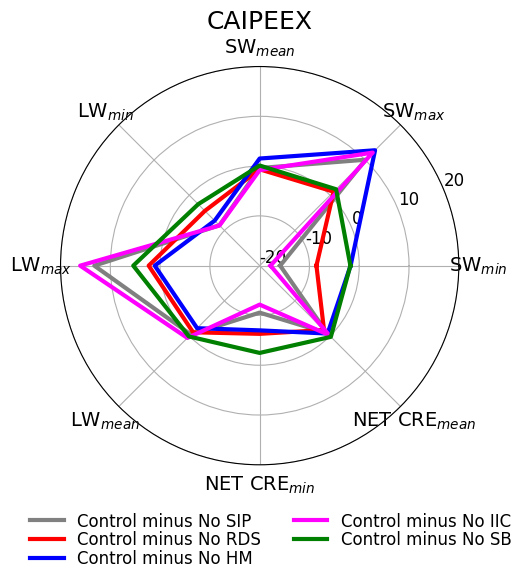

In [44]:
import matplotlib.pyplot as plt
import numpy as np
from math import pi

label_map = {
    "NO SIP": "Control minus No SIP",
    "NO RDS": "Control minus No RDS",
    "NO HM": "Control minus No HM",
    "NO IIC": "Control minus No IIC",
    "NO SB": "Control minus No SB"
}

fnt=14;
ln=3;
def multi_radar_plot(df):#, title="Storm Radiative properties"):
    labels = df.columns
    num_vars = len(labels)

    # Compute angles
    angles = [n / float(num_vars) * 2 * pi for n in range(num_vars)]
    angles += [angles[0]]  # to close the loop

    fig, ax = plt.subplots(figsize=(8, 6), subplot_kw=dict(polar=True))
    plt.style.use('default')
    # Plot each storm
    #colors = plt.cm.tab10.colors  # 10 distinct colors
    custom_colors = {
    #"CONTROL": "black",
    "NO SIP": "grey",
    "NO RDS": "red",
    "NO HM": "blue",
    "NO IIC": "magenta",
    "NO SB": "green"
    }
    for i, (storm_name, row) in enumerate(df.iterrows()):
        values = row.values
        values = np.concatenate([values, [values[0]]])
        color = custom_colors.get(storm_name, "gray")
        #ax.plot(angles, values, label=storm_name, color=colors[i % len(colors)], linewidth=ln)
        #ax.fill(angles, values, alpha=0.0, color=colors[i % len(colors)])
        #print(storm_name)
        label = label_map.get(storm_name, storm_name)
        ax.plot(angles, values, label=label, color=color, linewidth=ln)
        ax.fill(angles, values, alpha=0.0, color=color)

    # Axis settings
    ax.set_xticks(angles[:-1])
    ax.tick_params(axis='y', labelsize=fnt)
    #ax.set_rgrids(fontsize=fnt)
    ax.set_xticklabels(labels, fontsize=fnt)
    ax.set_ylim(-20, 20)
    ax.set_yticks([-20, -10, 0, 10, 20])
    ax.set_yticklabels(['-20', '-10', '0', '10', '20'], fontsize=fnt-2)
    #ax.set_ylim(200, -800)
    #ax.set_yticks([200, 0, -200, -400, -600, -800])
    #ax.set_yticklabels(['-600', '-400', '-200', '0'], fontsize=fnt)
    ax.set_title('CAIPEEX', fontsize=fnt+4)
    ax.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt-2, bbox_to_anchor=(1.17, -0.08), ncols=2, loc='best')#frameon=False, loc='best', ncols=1, fontsize=fnt, bbox_to_anchor=(1.2, 1.05))
    plt.tight_layout()
    plt.show()


multi_radar_plot(df)

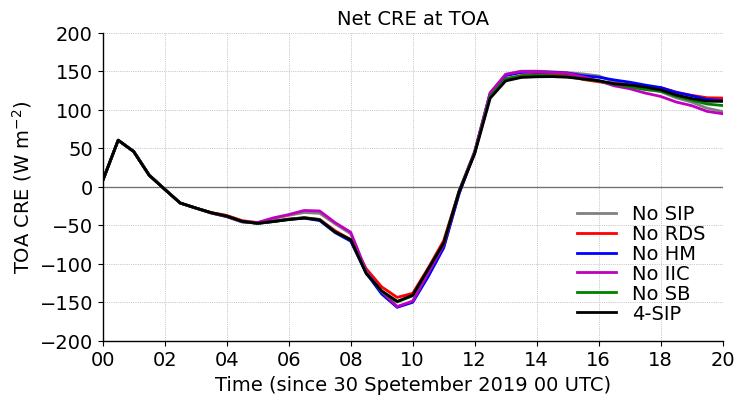

In [25]:
plt.figure(figsize=(8, 4))

lnwdth=2
fontsize=14

plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, toa_net_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, toa_net_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, toa_net_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, toa_net_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, toa_net_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time, toa_net_cre_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt.xlabel('Time (since 30 Spetember 2019 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
plt.ylim(-200, 200)
plt.yticks(fontsize=fontsize)
plt.ylabel('TOA CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Net CRE at TOA', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)
plt.show()


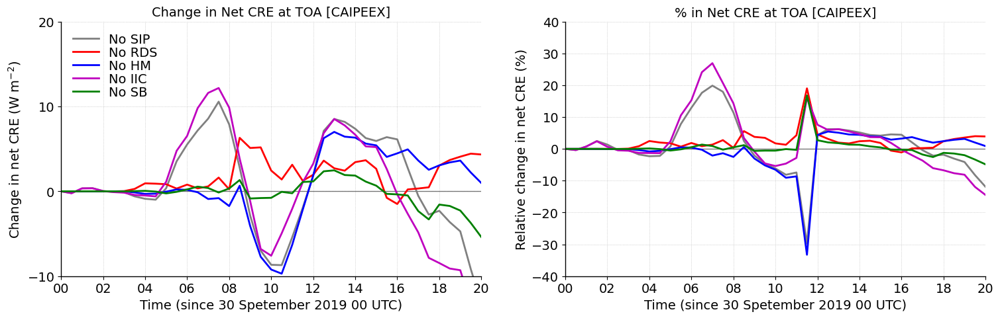

In [27]:
plt.figure(figsize=(18, 5))

lnwdth=2
fontsize=14

plt.subplot(1,2,1)

plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, del_toa_net_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, del_toa_net_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, del_toa_net_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, del_toa_net_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, del_toa_net_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 30 Spetember 2019 00 UTC)', fontsize=fontsize)#, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
plt.ylim(-10,20)
plt.yticks([-10, 0, 10, 20], fontsize=fontsize)
plt.ylabel('Change in net CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Change in Net CRE at TOA [CAIPEEX]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)


plt.subplot(1,2,2)

plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, per_del_toa_net_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, per_del_toa_net_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, per_del_toa_net_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, per_del_toa_net_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, per_del_toa_net_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 30 Spetember 2019 00 UTC)', fontsize=fontsize)#, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
plt.ylim(-40,40)
plt.yticks([-40, -30, -20, -10, 0, 10, 20, 30, 40], fontsize=fontsize)
plt.ylabel('Relative change in net CRE (%)', fontsize=fontsize)#, fontweight='bold')
plt.title('% in Net CRE at TOA [CAIPEEX]', fontsize=fontsize)#, fontweight='bold')
#plt.legend()
#plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)

plt.show()


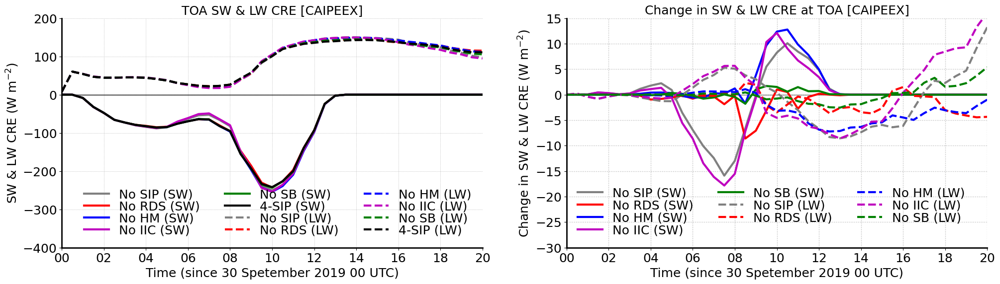

In [28]:


plt.figure(figsize=(24, 6))

lnwdth=3
fontsize=18

plt.subplot(1,2,1)
plt.axhline(y=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

plt.plot(ds_nosip.time, toa_sw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP (SW)')
plt.plot(ds_norf.time, toa_sw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS (SW)')
plt.plot(ds_nohm.time, toa_sw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM (SW)')
plt.plot(ds_nobr.time, toa_sw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC (SW)')
plt.plot(ds_nosb.time, toa_sw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB (SW)')
plt.plot(ds_4sip.time, toa_sw_cre_4sip, 'k-', linewidth=lnwdth, label='4-SIP (SW)')

plt.plot(ds_nosip.time, toa_lw_cre_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP (LW)')
plt.plot(ds_norf.time, toa_lw_cre_norf, 'r--', linewidth=lnwdth, label='No RDS (LW)')
plt.plot(ds_nohm.time, toa_lw_cre_nohm, 'b--', linewidth=lnwdth, label='No HM (LW)')
plt.plot(ds_nobr.time, toa_lw_cre_nobr, 'm--', linewidth=lnwdth, label='No IIC (LW)')
plt.plot(ds_nosb.time, toa_lw_cre_nosb, 'g--', linewidth=lnwdth, label='No SB (LW)')
plt.plot(ds_4sip.time, toa_lw_cre_4sip, 'k--', linewidth=lnwdth, label='4-SIP (LW)')

plt.xlabel('Time (since 30 Spetember 2019 00 UTC)', fontsize=fontsize)#, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(-400,200)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('SW & LW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('TOA SW & LW CRE [CAIPEEX]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.01, ncols=3, fontsize=fontsize, loc='lower right')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)

plt.subplot(1,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, del_toa_sw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP (SW)')
plt.plot(ds_norf.time, del_toa_sw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS (SW)')
plt.plot(ds_nohm.time, del_toa_sw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM (SW)')
plt.plot(ds_nobr.time, del_toa_sw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC (SW)')
plt.plot(ds_nosb.time, del_toa_sw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB (SW)')

plt.plot(ds_nosip.time, del_toa_lw_cre_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP (LW)')
plt.plot(ds_norf.time, del_toa_lw_cre_norf, 'r--', linewidth=lnwdth, label='No RDS (LW)')
plt.plot(ds_nohm.time, del_toa_lw_cre_nohm, 'b--', linewidth=lnwdth, label='No HM (LW)')
plt.plot(ds_nobr.time, del_toa_lw_cre_nobr, 'm--', linewidth=lnwdth, label='No IIC (LW)')
plt.plot(ds_nosb.time, del_toa_lw_cre_nosb, 'g--', linewidth=lnwdth, label='No SB (LW)')

plt.xlabel('Time (since 30 Spetember 2019 00 UTC)', fontsize=fontsize)#, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.ylim(-30, 15)
#plt.yticks([-8, -6, -4, -2, 0, 2, 4, 6, 8], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Change in SW & LW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Change in SW & LW CRE at TOA [CAIPEEX]', fontsize=fontsize)#, fontweight='bold')

plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, ncols=3, loc='best')

plt.grid(True, linestyle=':', linewidth=1, color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)

plt.show()


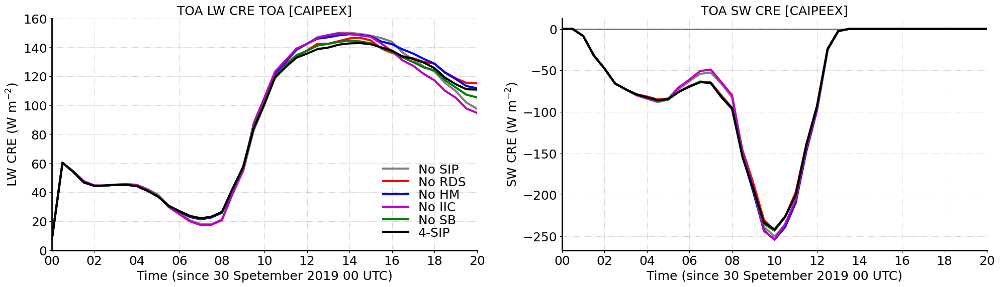

In [29]:


plt.figure(figsize=(24, 6))

lnwdth=3
fontsize=18

plt.subplot(1,2,1)
plt.axhline(y=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

plt.plot(ds_nosip.time, toa_lw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, toa_lw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, toa_lw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, toa_lw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, toa_lw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time, toa_lw_cre_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt.xlabel('Time (since 30 Spetember 2019 00 UTC)', fontsize=fontsize)#, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
plt.ylim(0,160)
plt.yticks(fontsize=fontsize)
plt.ylabel('LW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('TOA LW CRE TOA [CAIPEEX]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)

plt.subplot(1,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

plt.plot(ds_nosip.time, toa_sw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, toa_sw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, toa_sw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, toa_sw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, toa_sw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time, toa_sw_cre_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt.xlabel('Time (since 30 Spetember 2019 00 UTC)', fontsize=fontsize)#, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
#plt.ylim(-200,20)
plt.yticks(fontsize=fontsize)
plt.ylabel('SW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('TOA SW CRE [CAIPEEX]', fontsize=fontsize)#, fontweight='bold')
#plt.legend()
#plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()


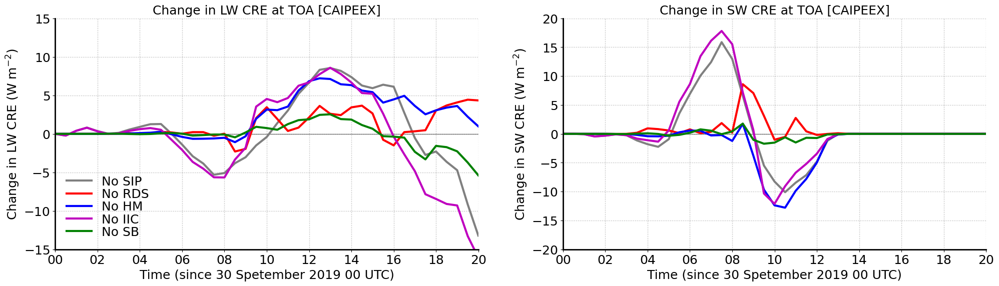

In [32]:

plt.figure(figsize=(24, 6))

lnwdth=3
fontsize=18

plt.subplot(1,2,1)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, del_toa_lw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, del_toa_lw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, del_toa_lw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, del_toa_lw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, del_toa_lw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 30 Spetember 2019 00 UTC)', fontsize=fontsize)#, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
plt.ylim(-15, 15)
plt.yticks([-15, -10, -5, 0, 5, 10, 15], fontsize=fontsize)
plt.ylabel('Change in LW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Change in LW CRE at TOA [CAIPEEX]', fontsize=fontsize)#, fontweight='bold')

plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower left')

plt.grid(True, linestyle=':', linewidth=1, color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, del_toa_sw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, del_toa_sw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, del_toa_sw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, del_toa_sw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, del_toa_sw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 30 Spetember 2019 00 UTC)', fontsize=fontsize)#, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
plt.ylim(-20,20)
plt.yticks([-20, -15, -10, -5, 0, 5, 10, 15, 20], fontsize=fontsize)
plt.ylabel('Change in SW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Change in SW CRE at TOA [CAIPEEX]', fontsize=fontsize)#, fontweight='bold')

#plt.legend()
#plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower left')

plt.grid(True, linestyle=':', linewidth=1, color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()

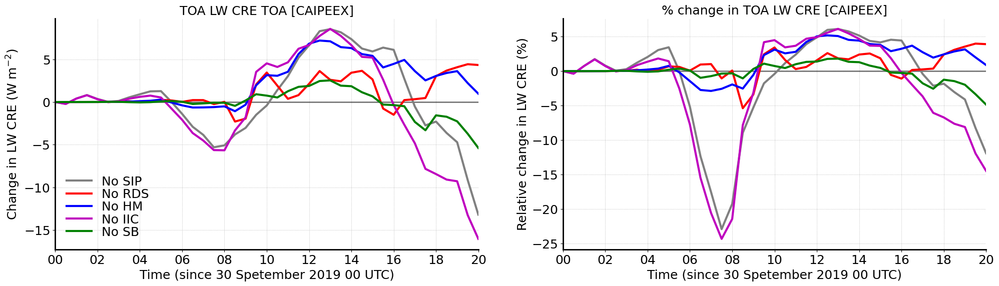

In [33]:


plt.figure(figsize=(24, 6))

lnwdth=3
fontsize=18

plt.subplot(1,2,1)
plt.axhline(y=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

plt.plot(ds_nosip.time, del_toa_lw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, del_toa_lw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, del_toa_lw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, del_toa_lw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, del_toa_lw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 30 Spetember 2019 00 UTC)', fontsize=fontsize)#, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
#plt.ylim(-12,6)
plt.yticks(fontsize=fontsize)
plt.ylabel('Change in LW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('TOA LW CRE TOA [CAIPEEX]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)

plt.subplot(1,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

plt.plot(ds_nosip.time, per_del_toa_lw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, per_del_toa_lw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, per_del_toa_lw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, per_del_toa_lw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, per_del_toa_lw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 30 Spetember 2019 00 UTC)', fontsize=fontsize)#, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
#plt.ylim(-15,10)
plt.yticks(fontsize=fontsize)
plt.ylabel('Relative change in LW CRE (%)', fontsize=fontsize)#, fontweight='bold')
plt.title('% change in TOA LW CRE [CAIPEEX]', fontsize=fontsize)#, fontweight='bold')
#plt.legend()
#plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()


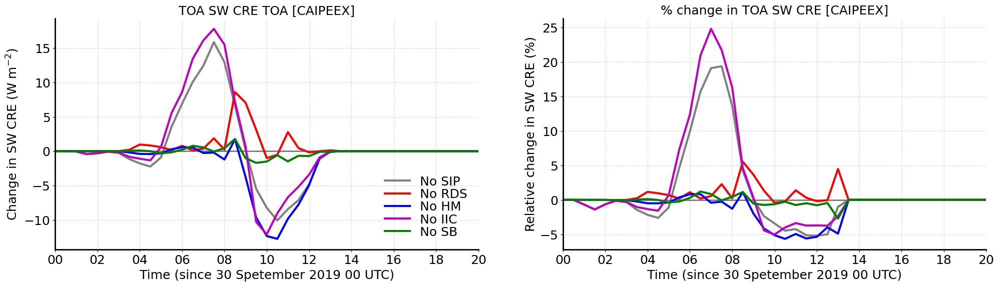

In [34]:


plt.figure(figsize=(24, 6))

lnwdth=3
fontsize=18

plt.subplot(1,2,1)
plt.axhline(y=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

plt.plot(ds_nosip.time, del_toa_sw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, del_toa_sw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, del_toa_sw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, del_toa_sw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, del_toa_sw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 30 Spetember 2019 00 UTC)', fontsize=fontsize)#, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
#plt.ylim(-10,12)
plt.yticks(fontsize=fontsize)
plt.ylabel('Change in SW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('TOA SW CRE TOA [CAIPEEX]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)

plt.subplot(1,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

plt.plot(ds_nosip.time, per_del_toa_sw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, per_del_toa_sw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, per_del_toa_sw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, per_del_toa_sw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, per_del_toa_sw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 30 Spetember 2019 00 UTC)', fontsize=fontsize)#, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2019, 9, 30, 0, 0) 
end_date = datetime(2019, 9, 30, 20, 0)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
#plt.ylim(-10,10)
plt.yticks(fontsize=fontsize)
plt.ylabel('Relative change in SW CRE (%)', fontsize=fontsize)#, fontweight='bold')
plt.title('% change in TOA SW CRE [CAIPEEX]', fontsize=fontsize)#, fontweight='bold')
#plt.legend()
#plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()


## Radiative Heating Rates

In [48]:


#mean_ht_nosip = 1.e-3*ds_nosip.z_mc.mean(dim=('time','ncells'))
#mean_tempc_nosip = ds_nosip.tempc.mean(dim=('time','ncells'))

#mean_ht_4sip = 1.e-3*ds_4sip.z_mc.mean(dim=('time','ncells'))
#mean_tempc_4sip = ds_4sip.tempc.mean(dim=('time','ncells'))

#mean_ht_norf = 1.e-3*ds_norf.z_mc.mean(dim=('time','ncells'))
#mean_tempc_norf = ds_norf.tempc.mean(dim=('time','ncells'))

#mean_ht_nohm = 1.e-3*ds_nohm.z_mc.mean(dim=('time','ncells'))
#mean_tempc_nohm = ds_nohm.tempc.mean(dim=('time','ncells'))

#mean_ht_nobr = 1.e-3*ds_nobr.z_mc.mean(dim=('time','ncells'))
#mean_tempc_nobr = ds_nobr.tempc.mean(dim=('time','ncells'))

#mean_ht_nosb = 1.e-3*ds_nosb.z_mc.mean(dim=('time','ncells'))
#mean_tempc_nosb = ds_nosb.tempc.mean(dim=('time','ncells'))

w_thres = 2.
# LW/SW heating rate with No SIP
mean_lwr_kperd_nosip = 86400.*ds_nosip.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_swr_kperd_nosip = 86400.*ds_nosip.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_tot_rad_kperd_nosip = mean_lwr_kperd_nosip + mean_swr_kperd_nosip

# LW/SW heating rate with 4 SIP
mean_lwr_kperd_4sip = 86400.*ds_4sip.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_swr_kperd_4sip = 86400.*ds_4sip.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_tot_rad_kperd_4sip = mean_lwr_kperd_4sip + mean_swr_kperd_4sip

# LW/SW heating rate with No RF
mean_lwr_kperd_norf = 86400.*ds_norf.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_swr_kperd_norf = 86400.*ds_norf.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_tot_rad_kperd_norf = mean_lwr_kperd_norf + mean_swr_kperd_norf

# LW/SW heating rate with No HM
mean_lwr_kperd_nohm = 86400.*ds_nohm.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_swr_kperd_nohm = 86400.*ds_nohm.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_tot_rad_kperd_nohm = mean_lwr_kperd_nohm + mean_swr_kperd_nohm

# LW/SW heating rate with No IIC
mean_lwr_kperd_nobr = 86400.*ds_nobr.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_swr_kperd_nobr = 86400.*ds_nobr.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_tot_rad_kperd_nobr = mean_lwr_kperd_nobr + mean_swr_kperd_nobr

# LW/SW heating rate with No SB
mean_lwr_kperd_nosb = 86400.*ds_nosb.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_swr_kperd_nosb = 86400.*ds_nosb.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_tot_rad_kperd_nosb = mean_lwr_kperd_nosb + mean_swr_kperd_nosb

# Change in tot rad. heating w.r.t. control
del_tot_rad_kperd_norf = mean_tot_rad_kperd_4sip-mean_tot_rad_kperd_norf
del_tot_rad_kperd_nohm = mean_tot_rad_kperd_4sip-mean_tot_rad_kperd_nohm
del_tot_rad_kperd_nobr = mean_tot_rad_kperd_4sip-mean_tot_rad_kperd_nobr
del_tot_rad_kperd_nosb = mean_tot_rad_kperd_4sip-mean_tot_rad_kperd_nosb
del_tot_rad_kperd_nosip = mean_tot_rad_kperd_4sip-mean_tot_rad_kperd_nosip

# Change in LW rad. heating w.r.t. control
del_lwr_kperd_norf = mean_lwr_kperd_4sip-mean_lwr_kperd_norf
del_lwr_kperd_nohm = mean_lwr_kperd_4sip-mean_lwr_kperd_nohm
del_lwr_kperd_nobr = mean_lwr_kperd_4sip-mean_lwr_kperd_nobr
del_lwr_kperd_nosb = mean_lwr_kperd_4sip-mean_lwr_kperd_nosb
del_lwr_kperd_nosip = mean_lwr_kperd_4sip-mean_lwr_kperd_nosip

# Change in SW rad. heating w.r.t. control
del_swr_kperd_norf = mean_swr_kperd_4sip-mean_swr_kperd_norf
del_swr_kperd_nohm = mean_swr_kperd_4sip-mean_swr_kperd_nohm
del_swr_kperd_nobr = mean_swr_kperd_4sip-mean_swr_kperd_nobr
del_swr_kperd_nosb = mean_swr_kperd_4sip-mean_swr_kperd_nosb
del_swr_kperd_nosip = mean_swr_kperd_4sip-mean_swr_kperd_nosip

mean_tot_rad_kperd_nosip = mean_tot_rad_kperd_nosip.where(mean_tempc_nosip > -70)
mean_tot_rad_kperd_4sip = mean_tot_rad_kperd_4sip.where(mean_tempc_4sip > -70)
mean_tot_rad_kperd_norf = mean_tot_rad_kperd_norf.where(mean_tempc_norf > -70)
mean_tot_rad_kperd_nohm = mean_tot_rad_kperd_nohm.where(mean_tempc_nohm > -70)
mean_tot_rad_kperd_nobr = mean_tot_rad_kperd_nobr.where(mean_tempc_nobr > -70)
mean_tot_rad_kperd_nosb = mean_tot_rad_kperd_nosb.where(mean_tempc_nosb > -70)


In [49]:
# xarrays takes longer time to plot, convert them to numpy instead

variables = [mean_tot_rad_kperd_nosip, mean_tot_rad_kperd_4sip, mean_tot_rad_kperd_norf, mean_tot_rad_kperd_nohm, 
             mean_tot_rad_kperd_nobr, mean_tot_rad_kperd_nosb]
numpy_variables = [var.values for var in variables]

mean_tot_rad_kperd_nosip = numpy_variables[0]
mean_tot_rad_kperd_4sip = numpy_variables[1]
mean_tot_rad_kperd_norf = numpy_variables[2]
mean_tot_rad_kperd_nohm = numpy_variables[3]
mean_tot_rad_kperd_nobr = numpy_variables[4]
mean_tot_rad_kperd_nosb = numpy_variables[5]


In [37]:
variables = [mean_lwr_kperd_nosip, mean_lwr_kperd_4sip, mean_lwr_kperd_norf, mean_lwr_kperd_nohm, 
             mean_lwr_kperd_nobr, mean_lwr_kperd_nosb]
numpy_variables = [var.values for var in variables]

mean_lwr_kperd_nosip = numpy_variables[0]
mean_lwr_kperd_4sip = numpy_variables[1]
mean_lwr_kperd_norf = numpy_variables[2]
mean_lwr_kperd_nohm = numpy_variables[3]
mean_lwr_kperd_nobr = numpy_variables[4]
mean_lwr_kperd_nosb = numpy_variables[5]

variables = [mean_swr_kperd_nosip, mean_swr_kperd_4sip, mean_swr_kperd_norf, mean_swr_kperd_nohm, 
             mean_swr_kperd_nobr, mean_swr_kperd_nosb]
numpy_variables = [var.values for var in variables]

mean_swr_kperd_nosip = numpy_variables[0]
mean_swr_kperd_4sip = numpy_variables[1]
mean_swr_kperd_norf = numpy_variables[2]
mean_swr_kperd_nohm = numpy_variables[3]
mean_swr_kperd_nobr = numpy_variables[4]
mean_swr_kperd_nosb = numpy_variables[5]

In [20]:
mean_tot_rad_kperd_nosip

array([ 3.0731630e-01,            nan,            nan,            nan,
                  nan,            nan,  4.5168361e-01,  6.3938564e-01,
        8.3761001e-01,  9.3306684e-01,  9.9193084e-01,  9.0771151e-01,
        7.1301144e-01,  3.9487171e-01, -1.4104843e-02, -2.7762985e-01,
       -4.6414363e-01, -5.7777584e-01, -6.0831380e-01, -6.4950335e-01,
       -6.2091780e-01, -6.0579526e-01, -5.5618286e-01, -5.3594506e-01,
       -5.1290810e-01, -4.6663141e-01, -4.2008066e-01, -4.1251147e-01,
       -4.3897378e-01, -4.7222352e-01, -3.2439590e-01, -3.6341929e-01,
       -2.9180193e-01, -3.3737242e-01, -4.2290223e-01, -5.4395986e-01,
       -5.4374552e-01, -4.1136241e-01, -4.4602919e-01, -4.7955275e-01,
       -5.5144036e-01, -6.3185298e-01, -8.1128824e-01, -9.9921274e-01,
       -1.1415999e+00, -1.2470275e+00, -1.2065197e+00, -1.0790690e+00,
       -9.1043377e-01, -7.2613108e-01, -6.1161709e-01, -5.5607808e-01,
       -5.6082702e-01, -6.0279644e-01, -6.8303752e-01, -7.4806261e-01,
      

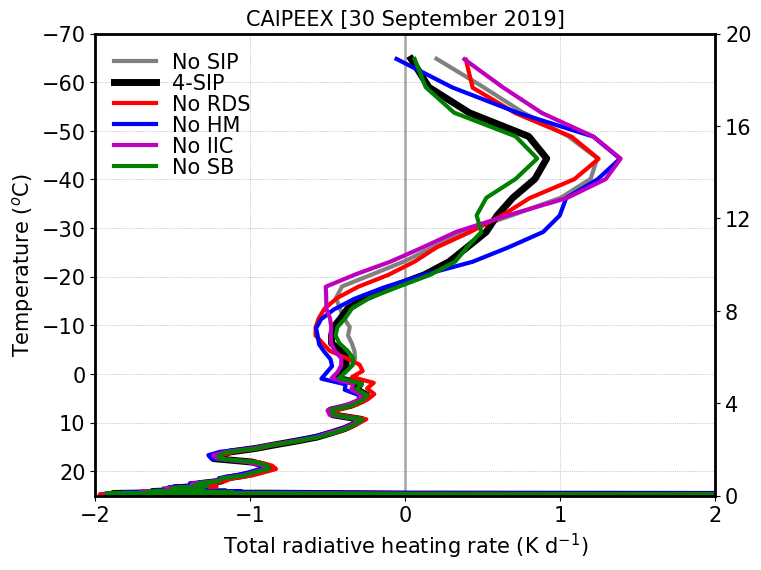

In [50]:
fontsize=15; lnwdth=3; alpha=0.6;

plt.figure(figsize=(8, 6)) 

plt1=plt.gca() 
plt2=plt1.twinx() 

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6) 

plt1.plot(mean_tot_rad_kperd_nosip, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP') 
plt1.plot(mean_tot_rad_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth+2, label='4-SIP') 
plt1.plot(mean_tot_rad_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS') 
plt1.plot(mean_tot_rad_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM') 
plt1.plot(mean_tot_rad_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC') 
plt1.plot(mean_tot_rad_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt2.plot(mean_tot_rad_kperd_nosb, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-2, 2) 
plt1.set_ylim(25, -70) 
plt2.set_ylim(0.5, 20)

plt1.set_xticks([-2, -1, 0, 1, 2]) 
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70]) 
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize) 
plt1.tick_params(axis='y', labelsize=fontsize) 
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total radiative heating rate (K d$^{-1}$)', fontsize=fontsize) 
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.legend() 
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('CAIPEEX [30 September 2019]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1) 
plt1.spines['right'].set_linewidth(1) 
plt1.spines['left'].set_linewidth(1) 
plt1.spines['bottom'].set_linewidth(1) 
plt.show()

#### The above plot should be the other way round, cooling at the top and warming in the middle levels

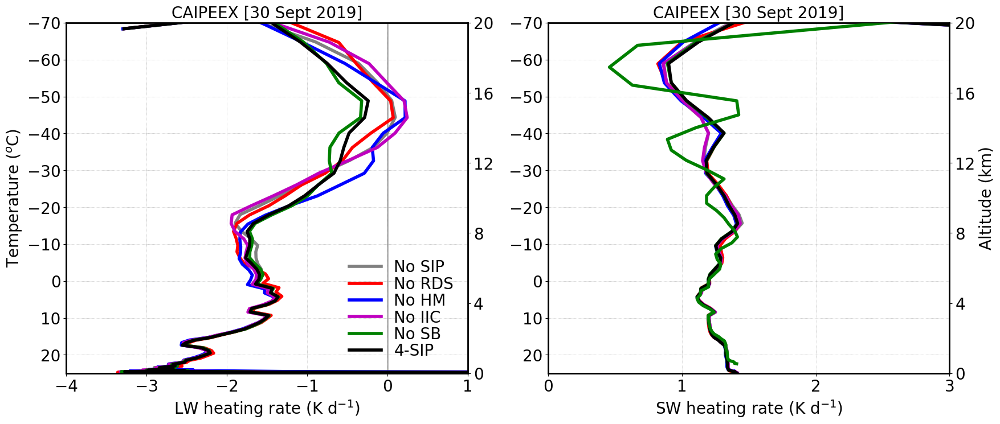

In [51]:

fontsize=20;
lnwdth=4;
alpha=0.8;

plt.figure(figsize=(20, 8))
plt.subplot(1,2,1)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_lwr_kperd_nosip, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_lwr_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_lwr_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(mean_lwr_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_lwr_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_lwr_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(mean_lwr_kperd_nosb, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(-4., 1)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

plt1.set_xticks([-4, -3, -2, -1, 0, 1])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')

plt1.set_xlabel('LW heating rate (K d$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
#plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('CAIPEEX [30 Sept 2019]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.subplot(1,2,2)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_swr_kperd_nosip, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_swr_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_swr_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(mean_swr_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_swr_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_swr_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt2.plot(mean_swr_kperd_nosb, mean_ht_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(0, 3)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

plt1.set_xticks([0, 1, 2, 3])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')

plt1.set_xlabel('SW heating rate (K d$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('CAIPEEX [30 Sept 2019]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.show()


## Vertical velocity
### Change in updrafts and downdrafts

In [73]:
thres_q = 0.
#mean_ht_nosip = 1.e-3*ds_nosip.z_mc.mean(dim=('time','ncells'))
#mean_tempc_nosip = ds_nosip.tempc.mean(dim=('time','ncells'))

#mean_ht_4sip = 1.e-3*ds_4sip.z_mc.mean(dim=('time','ncells'))
#mean_tempc_4sip = ds_4sip.tempc.mean(dim=('time','ncells'))

#mean_ht_norf = 1.e-3*ds_norf.z_mc.mean(dim=('time','ncells'))
#mean_tempc_norf = ds_norf.tempc.mean(dim=('time','ncells'))

#mean_ht_nohm = 1.e-3*ds_nohm.z_mc.mean(dim=('time','ncells'))
#mean_tempc_nohm = ds_nohm.tempc.mean(dim=('time','ncells'))

#mean_ht_nobr = 1.e-3*ds_nobr.z_mc.mean(dim=('time','ncells'))
#mean_tempc_nobr = ds_nobr.tempc.mean(dim=('time','ncells'))

#mean_ht_nosb = 1.e-3*ds_nosb.z_mc.mean(dim=('time','ncells'))
#mean_tempc_nosb = ds_nosb.tempc.mean(dim=('time','ncells'))

#mean_tot_w_nosip = ds_nosip.w_vel.where(abs(ds_nosip.w_vel) > 0.).mean(dim=('time','ncells'))
#mean_tot_w_4sip = ds_4sip.w_vel.where(abs(ds_4sip.w_vel) > 0.).mean(dim=('time','ncells'))
#mean_tot_w_norf = ds_norf.w_vel.where(abs(ds_norf.w_vel) > 0.).mean(dim=('time','ncells'))
#mean_tot_w_nohm = ds_nohm.w_vel.where(abs(ds_nohm.w_vel) > 0.).mean(dim=('time','ncells'))
#mean_tot_w_nobr = ds_nobr.w_vel.where(abs(ds_nobr.w_vel) > 0.).mean(dim=('time','ncells'))
#mean_tot_w_nosb = ds_nosb.w_vel.where(abs(ds_nosb.w_vel) > 0.).mean(dim=('time','ncells'))

#mean_tot_w_nosip = ds_nosip.w_vel.mean(dim=('time','ncells'))
#mean_tot_w_4sip = ds_4sip.w_vel.mean(dim=('time','ncells'))
#mean_tot_w_norf = ds_norf.w_vel.mean(dim=('time','ncells'))
#mean_tot_w_nohm = ds_nohm.w_vel.mean(dim=('time','ncells'))
#mean_tot_w_nobr = ds_nobr.w_vel.mean(dim=('time','ncells'))
#mean_tot_w_nosb = ds_nosb.w_vel.mean(dim=('time','ncells'))

mean_tot_w_nosip = xr.where(ds_nosip.tqi > thres_q, ds_nosip.w_vel, np.nan).mean(dim=('time','ncells'))
mean_tot_w_4sip = xr.where(ds_4sip.tqi > thres_q, ds_4sip.w_vel, np.nan).mean(dim=('time','ncells'))
mean_tot_w_norf = xr.where(ds_norf.tqi > thres_q, ds_norf.w_vel, np.nan).mean(dim=('time','ncells'))
mean_tot_w_nohm = xr.where(ds_nohm.tqi > thres_q, ds_nohm.w_vel, np.nan).mean(dim=('time','ncells'))
mean_tot_w_nobr = xr.where(ds_nobr.tqi > thres_q, ds_nobr.w_vel, np.nan).mean(dim=('time','ncells'))
mean_tot_w_nosb = xr.where(ds_nosb.tqi > thres_q, ds_nosb.w_vel, np.nan).mean(dim=('time','ncells'))

del_tot_w_nosip = mean_tot_w_4sip - mean_tot_w_nosip
del_tot_w_norf = mean_tot_w_4sip - mean_tot_w_norf
del_tot_w_nohm = mean_tot_w_4sip - mean_tot_w_nohm
del_tot_w_nobr = mean_tot_w_4sip - mean_tot_w_nobr
del_tot_w_nosb = mean_tot_w_4sip - mean_tot_w_nosb

#mean_tot_w_nosip = mean_tot_w_nosip.where(mean_tempc_nosip > -70)
#mean_tot_w_4sip = mean_tot_w_4sip.where(mean_tempc_4sip > -70)
#mean_tot_w_norf = mean_tot_w_norf.where(mean_tempc_norf > -70)
#mean_tot_w_nohm = mean_tot_w_nohm.where(mean_tempc_nohm > -70)
#mean_tot_w_nobr = mean_tot_w_nobr.where(mean_tempc_nobr > -70)
#mean_tot_w_nosb = mean_tot_w_nosb.where(mean_tempc_nosb > -70)

#del_tot_w_nosip = del_tot_w_nosip.where(mean_tempc_nosip > -70)
#del_tot_w_norf = del_tot_w_norf.where(mean_tempc_norf > -70)
#del_tot_w_nohm = del_tot_w_nohm.where(mean_tempc_nohm > -70)
#del_tot_w_nobr = del_tot_w_nobr.where(mean_tempc_nobr > -70)
#del_tot_w_nosb = del_tot_w_nosb.where(mean_tempc_nosb > -70)



In [74]:
# xarrays takes longer time to plot, convert them to numpy instead

variables = [mean_tot_w_nosip, mean_tot_w_4sip, mean_tot_w_norf, mean_tot_w_nohm, mean_tot_w_nobr, mean_tot_w_nosb]
numpy_variables = [var.values for var in variables]

mean_tot_w_nosip = numpy_variables[0]
mean_tot_w_4sip = numpy_variables[1]
mean_tot_w_norf = numpy_variables[2]
mean_tot_w_nohm = numpy_variables[3]
mean_tot_w_nobr = numpy_variables[4]
mean_tot_w_nosb = numpy_variables[5]


In [75]:

del_tot_w_nosip = mean_tot_w_4sip-mean_tot_w_nosip 
del_tot_w_norf = mean_tot_w_4sip-mean_tot_w_norf 
del_tot_w_nohm = mean_tot_w_4sip-mean_tot_w_nohm 
del_tot_w_nobr = mean_tot_w_4sip-mean_tot_w_nobr 
del_tot_w_nosb = mean_tot_w_4sip-mean_tot_w_nosb 

per_del_tot_w_nosip = 100*del_tot_w_nosip/mean_tot_w_4sip
per_del_tot_w_norf = 100*del_tot_w_norf/mean_tot_w_4sip
per_del_tot_w_nohm = 100*del_tot_w_nohm/mean_tot_w_4sip
per_del_tot_w_nobr = 100*del_tot_w_nobr/mean_tot_w_4sip
per_del_tot_w_nosb = 100*del_tot_w_nosb/mean_tot_w_4sip


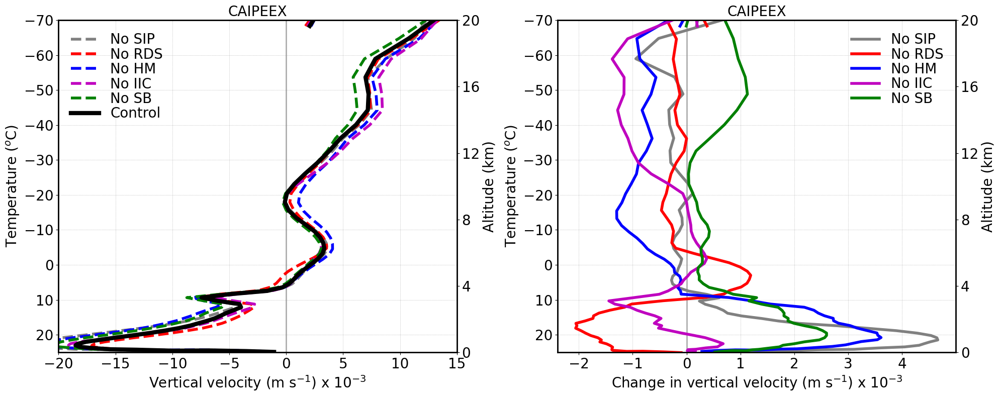

In [80]:


fontsize=20;
lnwdth=4;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.e3
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_w_nosip*fact, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_tot_w_norf*fact, mean_tempc_norf, 'r--', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_tot_w_nohm*fact, mean_tempc_nohm, 'b--', linewidth=lnwdth, label='No HM')
plt1.plot(mean_tot_w_nobr*fact, mean_tempc_nobr, 'm--', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_tot_w_nosb*fact, mean_tempc_nosb, 'g--', linewidth=lnwdth, label='No SB')
plt1.plot(mean_tot_w_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth+2, label='Control')

plt2.plot(mean_tot_w_nosb*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-20, 15)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([0, 2, 4, 6, 8, 10, 12, 14, 16, 18])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Vertical velocity (m s$^{-1}$) x 10$^{-3}$', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('CAIPEEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.e3

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(del_tot_w_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(del_tot_w_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(del_tot_w_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(del_tot_w_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(del_tot_w_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt2.plot(del_tot_w_nosb*fact, mean_ht_nobr, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

#plt1.set_xlim(-6, 2)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([-2, -1, 0, 1, 2])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Change in vertical velocity (m s$^{-1}$) x 10$^{-3}$', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('CAIPEEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.tight_layout()
plt.show()


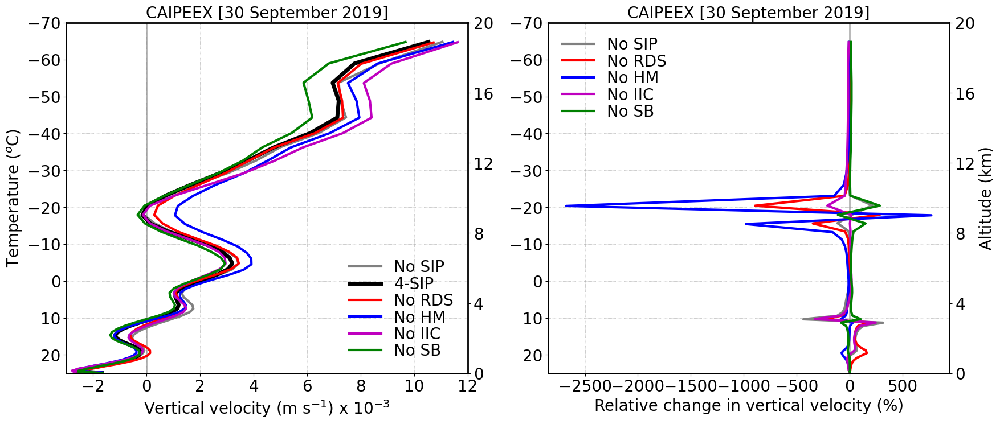

In [70]:


fontsize=20;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.e3
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_w_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_tot_w_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth+2, label='4-SIP')
plt1.plot(mean_tot_w_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_tot_w_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(mean_tot_w_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_tot_w_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt2.plot(mean_tot_w_nosb*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-3, 12)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([0, 2, 4, 6, 8, 10, 12, 14, 16, 18])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Vertical velocity (m s$^{-1}$) x 10$^{-3}$', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')

plt.title('CAIPEEX [30 September 2019]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(per_del_tot_w_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(per_del_tot_w_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(per_del_tot_w_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(per_del_tot_w_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(per_del_tot_w_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt2.plot(per_del_tot_w_nosb*fact, mean_ht_nobr, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

#plt1.set_xlim(-80, 20)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([-80, -60, -40, -20, 0, 20])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Relative change in vertical velocity (%)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('CAIPEEX [30 September 2019]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


## Cloud cover

In [21]:

mean_tot_cld_cover_nosip = ds_nosip.clc.where(ds_nosip.tq > 0.).mean(dim=('time','ncells'))
mean_tot_cld_cover_4sip = ds_4sip.clc.where(ds_4sip.tq > 0.).mean(dim=('time','ncells'))
mean_tot_cld_cover_norf = ds_norf.clc.where(ds_norf.tq > 0.).mean(dim=('time','ncells'))
mean_tot_cld_cover_nohm = ds_nohm.clc.where(ds_nohm.tq > 0.).mean(dim=('time','ncells'))
mean_tot_cld_cover_nobr = ds_nobr.clc.where(ds_nobr.tq > 0.).mean(dim=('time','ncells'))
mean_tot_cld_cover_nosb = ds_nosb.clc.where(ds_nosb.tq > 0.).mean(dim=('time','ncells'))


In [22]:
# xarrays takes longer time to plot, convert them to numpy instead

variables = [mean_tot_cld_cover_nosip, mean_tot_cld_cover_4sip, mean_tot_cld_cover_norf, mean_tot_cld_cover_nohm, 
             mean_tot_cld_cover_nobr, mean_tot_cld_cover_nosb]
numpy_variables = [var.values for var in variables]

mean_tot_cld_cover_nosip = numpy_variables[0]
mean_tot_cld_cover_4sip = numpy_variables[1]
mean_tot_cld_cover_norf = numpy_variables[2]
mean_tot_cld_cover_nohm = numpy_variables[3]
mean_tot_cld_cover_nobr = numpy_variables[4]
mean_tot_cld_cover_nosb = numpy_variables[5]


In [24]:

del_tot_cld_cover_nosip = mean_tot_cld_cover_4sip-mean_tot_cld_cover_nosip 
del_tot_cld_cover_norf = mean_tot_cld_cover_4sip-mean_tot_cld_cover_norf 
del_tot_cld_cover_nohm = mean_tot_cld_cover_4sip-mean_tot_cld_cover_nohm 
del_tot_cld_cover_nobr = mean_tot_cld_cover_4sip-mean_tot_cld_cover_nobr 
del_tot_cld_cover_nosb = mean_tot_cld_cover_4sip-mean_tot_cld_cover_nosb 

per_del_tot_cld_cover_nosip = 100*del_tot_cld_cover_nosip/mean_tot_cld_cover_4sip
per_del_tot_cld_cover_norf = 100*del_tot_cld_cover_norf/mean_tot_cld_cover_4sip
per_del_tot_cld_cover_nohm = 100*del_tot_cld_cover_nohm/mean_tot_cld_cover_4sip
per_del_tot_cld_cover_nobr = 100*del_tot_cld_cover_nobr/mean_tot_cld_cover_4sip
per_del_tot_cld_cover_nosb = 100*del_tot_cld_cover_nosb/mean_tot_cld_cover_4sip


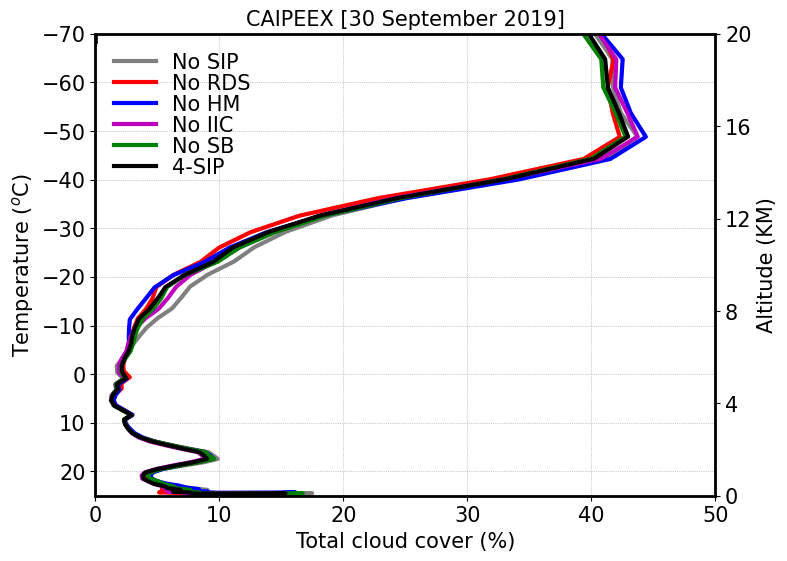

In [28]:
fontsize=15; lnwdth=3; alpha=0.6;

plt.figure(figsize=(8, 6)) 

plt1=plt.gca() 
plt2=plt1.twinx() 

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6) 

plt1.plot(mean_tot_cld_cover_nosip, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP') 
plt1.plot(mean_tot_cld_cover_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS') 
plt1.plot(mean_tot_cld_cover_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM') 
plt1.plot(mean_tot_cld_cover_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC') 
plt1.plot(mean_tot_cld_cover_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_tot_cld_cover_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP') 

plt2.plot(mean_tot_cld_cover_4sip, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(0, 50) 
plt1.set_ylim(25, -70) 
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([-2, -1, 0, 1, 2]) 
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70]) 
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize) 
plt1.tick_params(axis='y', labelsize=fontsize) 
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total cloud cover (%)', fontsize=fontsize) 
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (KM)', fontsize=fontsize)

plt1.legend() 
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('CAIPEEX [30 September 2019]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2) 
plt1.spines['right'].set_linewidth(2) 
plt1.spines['left'].set_linewidth(2) 
plt1.spines['bottom'].set_linewidth(2) 
plt.show()

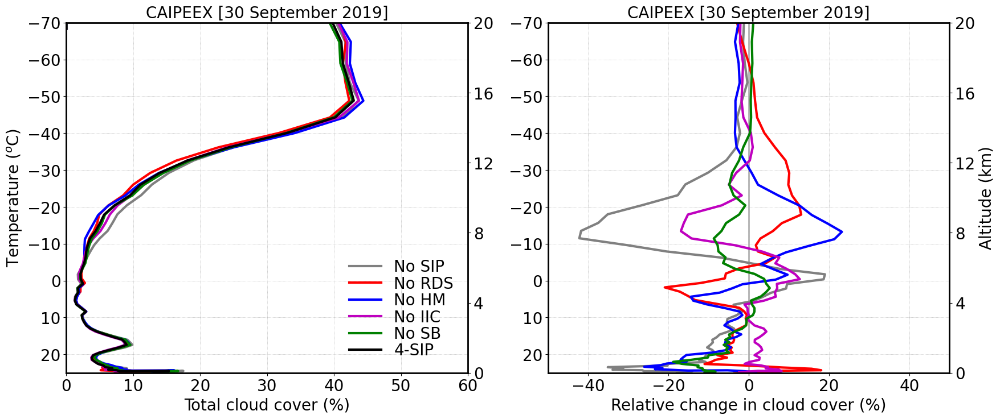

In [29]:


fontsize=20;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_cld_cover_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_tot_cld_cover_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_tot_cld_cover_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(mean_tot_cld_cover_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_tot_cld_cover_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_tot_cld_cover_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt2.plot(mean_tot_w_nosb*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(0, 60)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

plt1.set_xticks([0, 10, 20, 30, 40, 50 ,60])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total cloud cover (%)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')

plt.title('CAIPEEX [30 September 2019]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(per_del_tot_cld_cover_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(per_del_tot_cld_cover_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(per_del_tot_cld_cover_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(per_del_tot_cld_cover_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(per_del_tot_cld_cover_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt2.plot(per_del_tot_w_nosb*fact, mean_ht_nobr, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-50, 50)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([-80, -60, -40, -20, 0, 20])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Relative change in cloud cover (%)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('CAIPEEX [30 September 2019]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


### Surface rainfall

In [30]:
acc_precip_nosip = ds_nosip.tot_prec.mean('ncells')
acc_precip_4sip = ds_4sip.tot_prec.mean('ncells')
acc_precip_nohm = ds_nohm.tot_prec.mean('ncells')
acc_precip_nobr = ds_nobr.tot_prec.mean('ncells')
acc_precip_norf = ds_norf.tot_prec.mean('ncells')
acc_precip_nosb = ds_nosb.tot_prec.mean('ncells')

In [31]:
del_prec_nosip = ds_nosip.tot_prec.diff('time')
del_prec_4sip = ds_4sip.tot_prec.diff('time')
del_prec_norf = ds_norf.tot_prec.diff('time')
del_prec_nohm = ds_nohm.tot_prec.diff('time')
del_prec_nobr = ds_nobr.tot_prec.diff('time')
del_prec_nosb = ds_nosb.tot_prec.diff('time')

precip_rate_nosip = del_prec_nosip/0.5
precip_rate_4sip = del_prec_4sip/0.5
precip_rate_norf = del_prec_norf/0.5            # output is over 30 min
precip_rate_nohm = del_prec_nohm/0.5
precip_rate_nobr = del_prec_nobr/0.5
precip_rate_nosb = del_prec_nosb/0.5

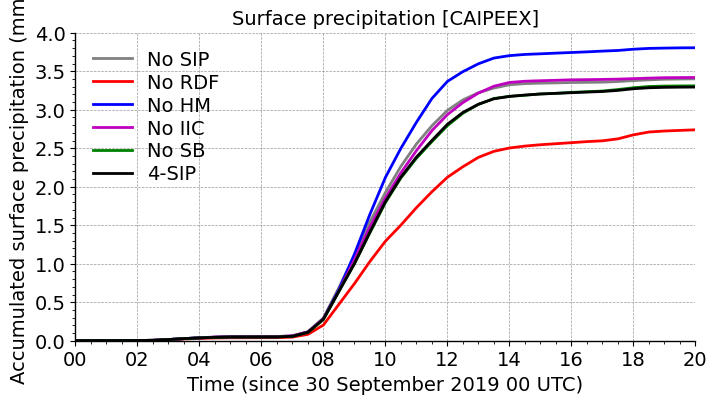

In [56]:
del_prec_nosip = ds_nosip.tot_prec.diff('time')
del_prec_4sip = ds_4sip.tot_prec.diff('time')
del_prec_norf = ds_norf.tot_prec.diff('time')
del_prec_nohm = ds_nohm.tot_prec.diff('time')
del_prec_nobr = ds_nobr.tot_prec.diff('time')
del_prec_nosb = ds_nosb.tot_prec.diff('time')

precip_rate_nosip = del_prec_nosip/0.5
precip_rate_4sip = del_prec_4sip/0.5
precip_rate_norf = del_prec_norf/0.5            # output is over 30 min
precip_rate_nohm = del_prec_nohm/0.5
precip_rate_nobr = del_prec_nobr/0.5
precip_rate_nosb = del_prec_nosb/0.5

fontsize=14
linwdth = 2
plt.figure(figsize=(8, 4))

plt.plot(ds_nosip.time, acc_precip_nosip, "-", color='grey', label="No SIP", linewidth = linwdth)
plt.plot(ds_norf.time, acc_precip_norf, "r-", label="No RDF", linewidth = linwdth)
plt.plot(ds_nohm.time, acc_precip_nohm, "b-", label="No HM", linewidth = linwdth)
plt.plot(ds_nobr.time, acc_precip_nobr, "m-", label="No IIC", linewidth = linwdth)
plt.plot(ds_nosb.time, acc_precip_nosb, "g-", label="No SB", linewidth = linwdth)
plt.plot(ds_4sip.time, acc_precip_4sip, "k-", label="4-SIP", linewidth = linwdth)

plt.grid(True, linestyle='--', color='grey', linewidth=0.5, alpha=0.8)
plt.minorticks_on()
plt.ylim(0, 4)
plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fontsize)
plt.ylabel('Accumulated surface precipitation (mm)', fontsize=fontsize)
start_date = datetime(2019, 9, 30, 0, 0)  # Start at 00 UTC on 10 May 2011
end_date = datetime(2019, 9, 30, 20, 0)
plt.xlim(start_date, end_date)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.title('Surface precipitation [CAIPEEX]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.2, fontsize=fontsize, loc='upper left')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_linewidth(1)
plt.gca().spines['left'].set_linewidth(1)
plt.show()

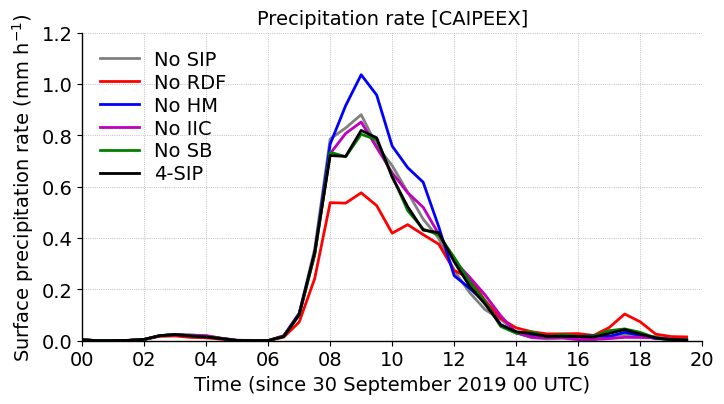

In [57]:
fontsize=14
linwdth = 2
plt.figure(figsize=(8, 4))

plt.plot(ds_nosip.time[:-1], precip_rate_nosip.mean('ncells'), '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time[:-1], precip_rate_norf.mean('ncells'), 'r-', linewidth=lnwdth, label='No RDF')
plt.plot(ds_nohm.time[:-1], precip_rate_nohm.mean('ncells'), 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time[:-1], precip_rate_nobr.mean('ncells'), 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time[:-1], precip_rate_nosb.mean('ncells'), 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time[:-1], precip_rate_4sip.mean('ncells'), 'k-', linewidth=lnwdth, label='4-SIP')

plt.ylim(0, 1.2)
plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fontsize)
plt.ylabel('Surface precipitation rate (mm h$^{-1}$)', fontsize=fontsize)
start_date = datetime(2019, 9, 30, 0, 0)  # Start at 00 UTC on 10 May 2011
end_date = datetime(2019, 9, 30, 20, 0)
plt.xlim(start_date, end_date)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))

plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.title('Precipitation rate [CAIPEEX]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.2, fontsize=fontsize, loc='upper left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_linewidth(1)
plt.gca().spines['left'].set_linewidth(1)
plt.show()

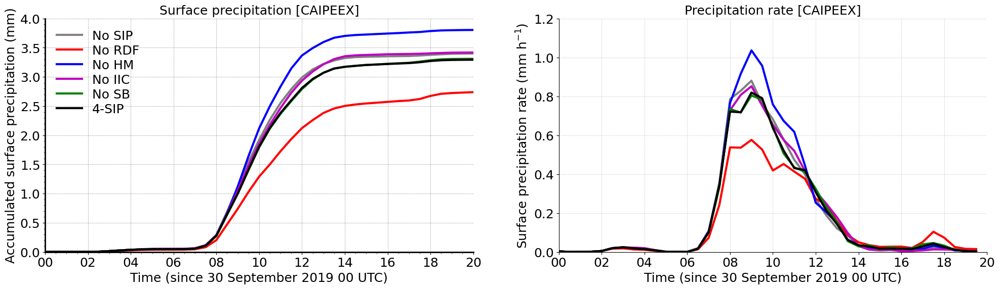

In [57]:


fontsize=18
linwdth = 3
plt.figure(figsize=(24, 6))

plt.subplot(1,2,1)
plt.plot(ds_nosip.time, acc_precip_nosip, "-", color='grey', label="No SIP", linewidth = linwdth)
plt.plot(ds_norf.time, acc_precip_norf, "r-", label="No RDF", linewidth = linwdth)
plt.plot(ds_nohm.time, acc_precip_nohm, "b-", label="No HM", linewidth = linwdth)
plt.plot(ds_nobr.time, acc_precip_nobr, "m-", label="No IIC", linewidth = linwdth)
plt.plot(ds_nosb.time, acc_precip_nosb, "g-", label="No SB", linewidth = linwdth)
plt.plot(ds_4sip.time, acc_precip_4sip, "k-", label="4-SIP", linewidth = linwdth)

plt.grid(True, linestyle='--', color='grey', linewidth=0.5, alpha=0.8)
plt.minorticks_on()
plt.ylim(0, 4)
plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fontsize)
plt.ylabel('Accumulated surface precipitation (mm)', fontsize=fontsize)
start_date = datetime(2019, 9, 30, 0, 0)  # Start at 00 UTC on 10 May 2011
end_date = datetime(2019, 9, 30, 20, 0)
plt.xlim(start_date, end_date)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.title('Surface precipitation [CAIPEEX]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.2, fontsize=fontsize, loc='upper left')#, ncol = 1, fontsize='16', bbox_to_anchor=(1.02, 1.02))
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_linewidth(2)
plt.gca().spines['left'].set_linewidth(2)

plt.subplot(1,2,2)
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(ds_nosip.time[:-1], precip_rate_nosip.mean('ncells'), '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time[:-1], precip_rate_norf.mean('ncells'), 'r-', linewidth=lnwdth, label='No RDF')
plt.plot(ds_nohm.time[:-1], precip_rate_nohm.mean('ncells'), 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time[:-1], precip_rate_nobr.mean('ncells'), 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time[:-1], precip_rate_nosb.mean('ncells'), 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time[:-1], precip_rate_4sip.mean('ncells'), 'k-', linewidth=lnwdth, label='4-SIP')

plt.ylim(0, 1.2)
plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fontsize)
plt.ylabel('Surface precipitation rate (mm h$^{-1}$)', fontsize=fontsize)
start_date = datetime(2019, 9, 30, 0, 0)  # Start at 00 UTC on 10 May 2011
end_date = datetime(2019, 9, 30, 20, 0)
plt.xlim(start_date, end_date)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))

plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.title('Precipitation rate [CAIPEEX]', fontsize=fontsize)
#plt.legend()
#plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['right'].set_linewidth(3)
plt.gca().spines['right'].set_linewidth(3)
plt.show()


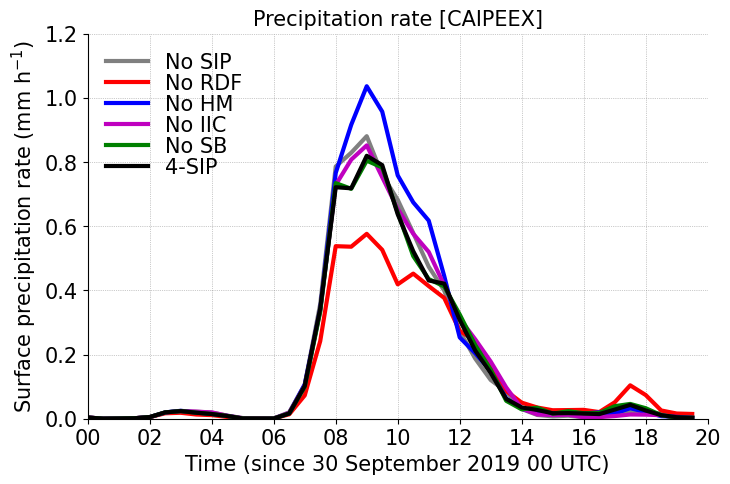

In [59]:
fontsize=15;
lnwdth=2;
alpha=0.6;

plt.figure(figsize=(8, 5))
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(ds_nosip.time[:-1], precip_rate_nosip.mean('ncells'), '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time[:-1], precip_rate_norf.mean('ncells'), 'r-', linewidth=lnwdth, label='No RDF')
plt.plot(ds_nohm.time[:-1], precip_rate_nohm.mean('ncells'), 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time[:-1], precip_rate_nobr.mean('ncells'), 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time[:-1], precip_rate_nosb.mean('ncells'), 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time[:-1], precip_rate_4sip.mean('ncells'), 'k-', linewidth=lnwdth, label='4-SIP')

plt.ylim(0, 1.2)
plt.xlabel('Time (since 30 September 2019 00 UTC)', fontsize=fontsize)
plt.ylabel('Surface precipitation rate (mm h$^{-1}$)', fontsize=fontsize)
start_date = datetime(2019, 9, 30, 0, 0)  # Start at 00 UTC on 10 May 2011
end_date = datetime(2019, 9, 30, 20, 0)
plt.xlim(start_date, end_date)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))

plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.title('Precipitation rate [CAIPEEX]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['right'].set_linewidth(3)
plt.gca().spines['right'].set_linewidth(3)
plt.show()

## Ice number concentrations

In [36]:


thres_w = 2.
mean_tot_inc_up_nosip = ds_nosip.inc_perl.where(ds_nosip.w_vel > thres_w).mean(dim=('time','ncells'))
mean_tot_inc_up_4sip = ds_4sip.inc_perl.where(ds_4sip.w_vel > thres_w).mean(dim=('time','ncells'))
mean_tot_inc_up_norf = ds_norf.inc_perl.where(ds_norf.w_vel > thres_w).mean(dim=('time','ncells'))
mean_tot_inc_up_nohm = ds_nohm.inc_perl.where(ds_nohm.w_vel > thres_w).mean(dim=('time','ncells'))
mean_tot_inc_up_nobr = ds_nobr.inc_perl.where(ds_nobr.w_vel > thres_w).mean(dim=('time','ncells'))
mean_tot_inc_up_nosb = ds_nosb.inc_perl.where(ds_nosb.w_vel > thres_w).mean(dim=('time','ncells'))

mean_tot_inc_dn_nosip = ds_nosip.inc_perl.where(ds_nosip.w_vel < -1*thres_w).mean(dim=('time','ncells'))
mean_tot_inc_dn_4sip = ds_4sip.inc_perl.where(ds_4sip.w_vel < -1*thres_w).mean(dim=('time','ncells'))
mean_tot_inc_dn_norf = ds_norf.inc_perl.where(ds_norf.w_vel < -1*thres_w).mean(dim=('time','ncells'))
mean_tot_inc_dn_nohm = ds_nohm.inc_perl.where(ds_nohm.w_vel < -1*thres_w).mean(dim=('time','ncells'))
mean_tot_inc_dn_nobr = ds_nobr.inc_perl.where(ds_nobr.w_vel < -1*thres_w).mean(dim=('time','ncells'))
mean_tot_inc_dn_nosb = ds_nosb.inc_perl.where(ds_nosb.w_vel < -1*thres_w).mean(dim=('time','ncells'))



In [37]:
# xarrays takes longer time to plot, convert them to numpy instead

variables = [mean_tot_inc_up_nosip, mean_tot_inc_up_4sip, mean_tot_inc_up_norf, mean_tot_inc_up_nohm, 
             mean_tot_inc_up_nobr, mean_tot_inc_up_nosb]
numpy_variables = [var.values for var in variables]

mean_tot_inc_up_nosip = numpy_variables[0]
mean_tot_inc_up_4sip = numpy_variables[1]
mean_tot_inc_up_norf = numpy_variables[2]
mean_tot_inc_up_nohm = numpy_variables[3]
mean_tot_inc_up_nobr = numpy_variables[4]
mean_tot_inc_up_nosb = numpy_variables[5]


variables = [mean_tot_inc_dn_nosip, mean_tot_inc_dn_4sip, mean_tot_inc_dn_norf, mean_tot_inc_dn_nohm, 
             mean_tot_inc_dn_nobr, mean_tot_inc_dn_nosb]
numpy_variables = [var.values for var in variables]

mean_tot_inc_dn_nosip = numpy_variables[0]
mean_tot_inc_dn_4sip = numpy_variables[1]
mean_tot_inc_dn_norf = numpy_variables[2]
mean_tot_inc_dn_nohm = numpy_variables[3]
mean_tot_inc_dn_nobr = numpy_variables[4]
mean_tot_inc_dn_nosb = numpy_variables[5]


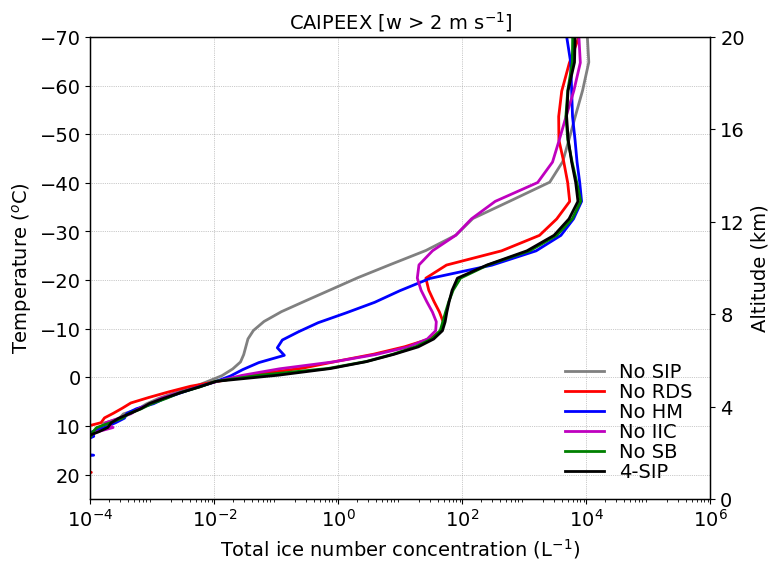

In [36]:
fontsize=14;
lnwdth=2;
alpha=0.6;

plt.figure(figsize=(8, 6))

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_inc_up_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_tot_inc_up_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_tot_inc_up_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(mean_tot_inc_up_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_tot_inc_up_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_tot_inc_up_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt2.plot(mean_tot_inc_up_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt2.grid(True, linestyle='-', linewidth=0., color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e6)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total ice number concentration (L$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')

plt.title('CAIPEEX [w > 2 m s$^{-1}$]', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

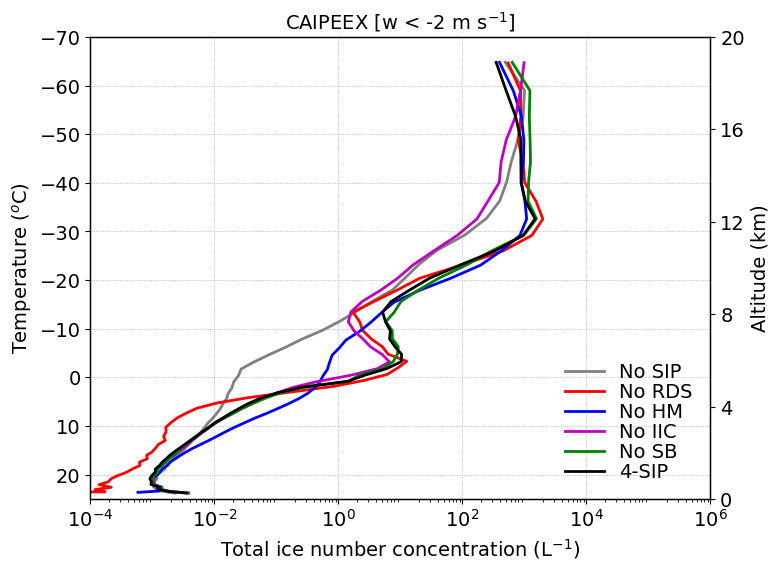

In [37]:
fontsize=14;
lnwdth=2;
alpha=0.6;

plt.figure(figsize=(8, 6))

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_inc_dn_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_tot_inc_dn_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_tot_inc_dn_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(mean_tot_inc_dn_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_tot_inc_dn_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_tot_inc_dn_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt2.plot(mean_tot_inc_dn_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt2.grid(True, linestyle='-', linewidth=0., color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e6)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total ice number concentration (L$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')

plt.title('CAIPEEX [w < -2 m s$^{-1}$]', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

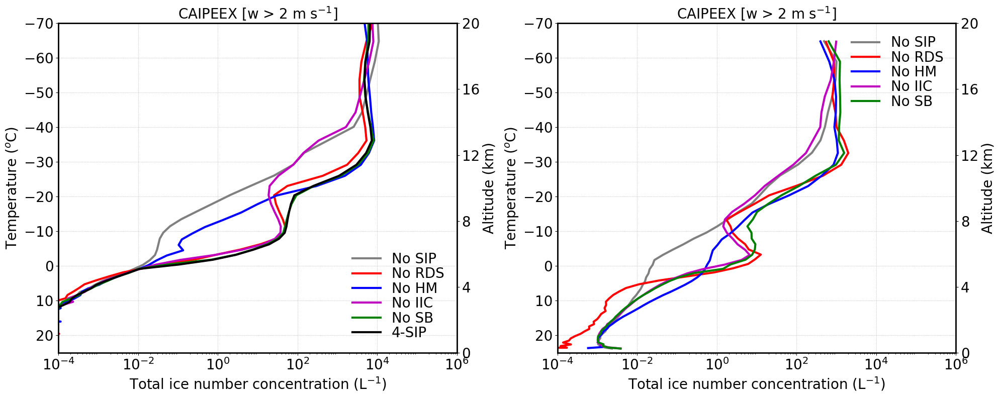

In [41]:


fontsize=20;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_inc_up_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_tot_inc_up_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_tot_inc_up_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(mean_tot_inc_up_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_tot_inc_up_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_tot_inc_up_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt2.plot(mean_tot_inc_up_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e6)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total ice number concentration (L$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')

plt.title('CAIPEEX [w > 2 m s$^{-1}$]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_inc_dn_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_tot_inc_dn_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_tot_inc_dn_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(mean_tot_inc_dn_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_tot_inc_dn_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt2.plot(mean_tot_inc_dn_nosb*fact, mean_ht_nobr, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e6)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total ice number concentration (L$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('CAIPEEX [w > 2 m s$^{-1}$]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.tight_layout()
plt.show()


### mass and number mixing ratios of hydrometeors

In [58]:

thres_q = 1.e-12

mean_qc_4sip = ds_4sip.qc.where(ds_4sip.qc > thres_q).mean(dim=('time','ncells'))
mean_qr_4sip = ds_4sip.qr.where(ds_4sip.qr > thres_q).mean(dim=('time','ncells'))
mean_qi_4sip = ds_4sip.qi.where(ds_4sip.qi > thres_q).mean(dim=('time','ncells'))
mean_qs_4sip = ds_4sip.qs.where(ds_4sip.qs > thres_q).mean(dim=('time','ncells'))
mean_qg_4sip = ds_4sip.qg.where(ds_4sip.qg > thres_q).mean(dim=('time','ncells'))
mean_qh_4sip = ds_4sip.qh.where(ds_4sip.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qc_4sip, mean_qr_4sip, mean_qi_4sip, mean_qs_4sip, mean_qg_4sip, mean_qh_4sip]
numpy_variables = [var.values for var in variables]

mean_qc_4sip = numpy_variables[0]
mean_qr_4sip = numpy_variables[1]
mean_qi_4sip = numpy_variables[2]
mean_qs_4sip = numpy_variables[3]
mean_qg_4sip = numpy_variables[4]
mean_qh_4sip = numpy_variables[5]

mean_qnc_4sip = ds_4sip.qnc.where(ds_4sip.qc > thres_q).mean(dim=('time','ncells'))
mean_qnr_4sip = ds_4sip.qnr.where(ds_4sip.qr > thres_q).mean(dim=('time','ncells'))
mean_qni_4sip = ds_4sip.qni.where(ds_4sip.qi > thres_q).mean(dim=('time','ncells'))
mean_qns_4sip = ds_4sip.qns.where(ds_4sip.qs > thres_q).mean(dim=('time','ncells'))
mean_qng_4sip = ds_4sip.qng.where(ds_4sip.qg > thres_q).mean(dim=('time','ncells'))
mean_qnh_4sip = ds_4sip.qnh.where(ds_4sip.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qnc_4sip, mean_qnr_4sip, mean_qni_4sip, mean_qns_4sip, mean_qng_4sip, mean_qnh_4sip]
numpy_variables = [var.values for var in variables]

mean_qnc_4sip = numpy_variables[0]
mean_qnr_4sip = numpy_variables[1]
mean_qni_4sip = numpy_variables[2]
mean_qns_4sip = numpy_variables[3]
mean_qng_4sip = numpy_variables[4]
mean_qnh_4sip = numpy_variables[5]


In [70]:
mean_tqi_4sip

np.float32(0.0048745167)

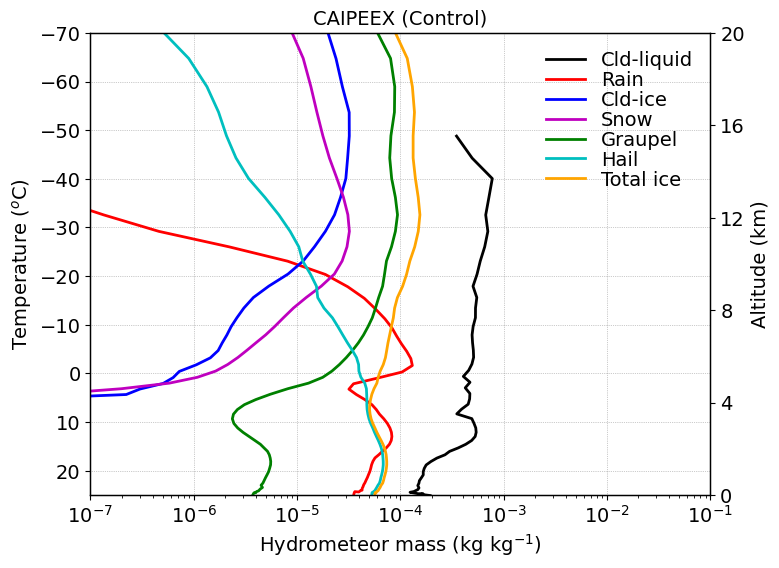

In [62]:

mean_tqi_4sip = np.nansum([mean_qi_4sip,mean_qs_4sip,mean_qg_4sip,mean_qh_4sip], axis=0)

fontsize=14;
lnwdth=2;
alpha=0.6;

plt.figure(figsize=(8, 6))

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qc_4sip*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qr_4sip*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qi_4sip*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qs_4sip*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qg_4sip*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qh_4sip*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')
plt1.plot(mean_tqi_4sip*fact, mean_tempc_4sip, '-', color='orange', linewidth=lnwdth, label='Total ice')

plt2.plot(mean_qh_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt2.grid(True, linestyle='-', linewidth=0., color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-7, 1.e-1)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor mass (kg kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('CAIPEEX (Control)', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

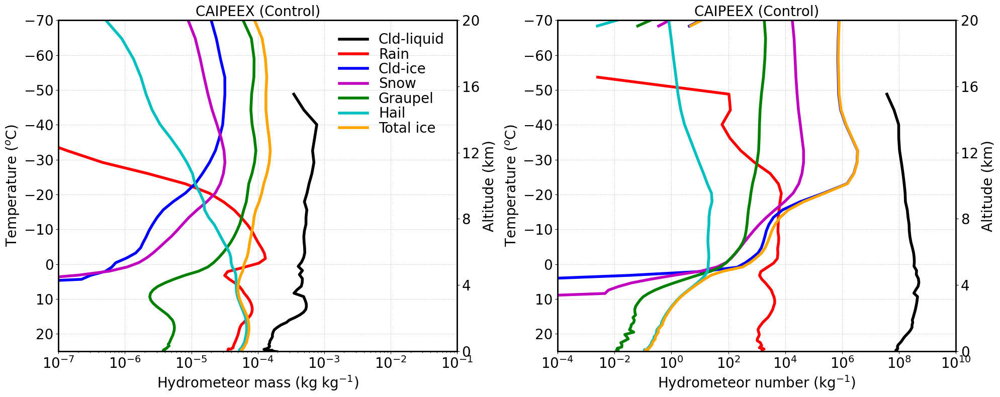

In [63]:

mean_tqi_4sip = np.nansum([mean_qi_4sip,mean_qs_4sip,mean_qg_4sip,mean_qh_4sip], axis=0)
mean_tqni_4sip = np.nansum([mean_qni_4sip,mean_qns_4sip,mean_qng_4sip,mean_qnh_4sip], axis=0)

fontsize=20;
lnwdth=4;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qc_4sip*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qr_4sip*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qi_4sip*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qs_4sip*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qg_4sip*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qh_4sip*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')
plt1.plot(mean_tqi_4sip*fact, mean_tempc_4sip, '-', color='orange', linewidth=lnwdth, label='Total ice')

plt2.plot(mean_qh_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-7, 1.e-1)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor mass (kg kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('CAIPEEX (Control)', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qnc_4sip*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qnr_4sip*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qni_4sip*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qns_4sip*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qng_4sip*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qnh_4sip*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')
plt1.plot(mean_tqni_4sip*fact, mean_tempc_4sip, '-', color='orange', linewidth=lnwdth, label='Total ice')

plt2.plot(mean_qnh_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor number (kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('CAIPEEX (Control)', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.tight_layout()
plt.show()


In [52]:

thres_q = 1.e-12

mean_qc_nosip = ds_nosip.qc.where(ds_nosip.qc > thres_q).mean(dim=('time','ncells'))
mean_qr_nosip = ds_nosip.qr.where(ds_nosip.qr > thres_q).mean(dim=('time','ncells'))
mean_qi_nosip = ds_nosip.qi.where(ds_nosip.qi > thres_q).mean(dim=('time','ncells'))
mean_qs_nosip = ds_nosip.qs.where(ds_nosip.qs > thres_q).mean(dim=('time','ncells'))
mean_qg_nosip = ds_nosip.qg.where(ds_nosip.qg > thres_q).mean(dim=('time','ncells'))
mean_qh_nosip = ds_nosip.qh.where(ds_nosip.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qc_nosip, mean_qr_nosip, mean_qi_nosip, mean_qs_nosip, mean_qg_nosip, mean_qh_nosip]
numpy_variables = [var.values for var in variables]

mean_qc_nosip = numpy_variables[0]
mean_qr_nosip = numpy_variables[1]
mean_qi_nosip = numpy_variables[2]
mean_qs_nosip = numpy_variables[3]
mean_qg_nosip = numpy_variables[4]
mean_qh_nosip = numpy_variables[5]

mean_qnc_nosip = ds_nosip.qnc.where(ds_nosip.qc > thres_q).mean(dim=('time','ncells'))
mean_qnr_nosip = ds_nosip.qnr.where(ds_nosip.qr > thres_q).mean(dim=('time','ncells'))
mean_qni_nosip = ds_nosip.qni.where(ds_nosip.qi > thres_q).mean(dim=('time','ncells'))
mean_qns_nosip = ds_nosip.qns.where(ds_nosip.qs > thres_q).mean(dim=('time','ncells'))
mean_qng_nosip = ds_nosip.qng.where(ds_nosip.qg > thres_q).mean(dim=('time','ncells'))
mean_qnh_nosip = ds_nosip.qnh.where(ds_nosip.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qnc_nosip, mean_qnr_nosip, mean_qni_nosip, mean_qns_nosip, mean_qng_nosip, mean_qnh_nosip]
numpy_variables = [var.values for var in variables]

mean_qnc_nosip = numpy_variables[0]
mean_qnr_nosip = numpy_variables[1]
mean_qni_nosip = numpy_variables[2]
mean_qns_nosip = numpy_variables[3]
mean_qng_nosip = numpy_variables[4]
mean_qnh_nosip = numpy_variables[5]


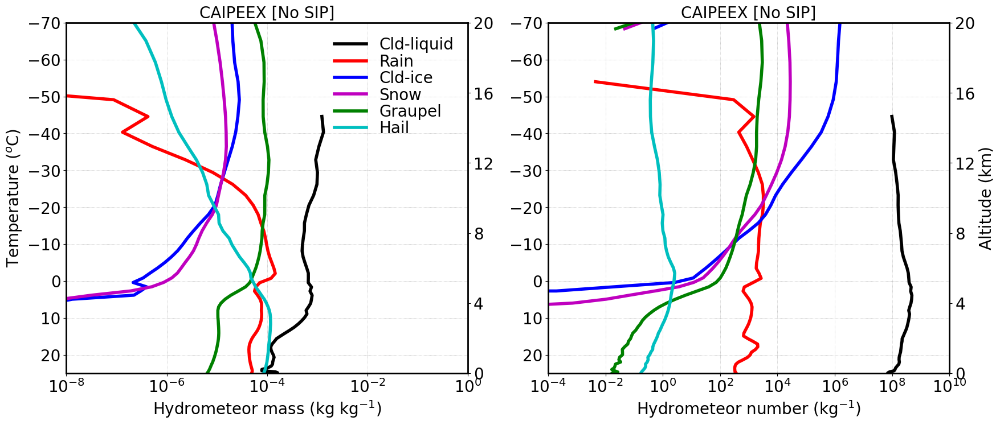

In [54]:


fontsize=20;
lnwdth=4;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qc_nosip*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qr_nosip*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qi_nosip*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qs_nosip*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qg_nosip*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qh_nosip*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qh_nosip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-8, 1.e0)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor mass (kg kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('CAIPEEX [No SIP]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qnc_nosip*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qnr_nosip*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qni_nosip*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qns_nosip*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qng_nosip*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qnh_nosip*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qnh_nosip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor number (kg$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('CAIPEEX [No SIP]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


In [73]:
thres_q = 1.e-12

mean_qc_norf = ds_norf.qc.where(ds_norf.qc > thres_q).mean(dim=('time','ncells'))
mean_qr_norf = ds_norf.qr.where(ds_norf.qr > thres_q).mean(dim=('time','ncells'))
mean_qi_norf = ds_norf.qi.where(ds_norf.qi > thres_q).mean(dim=('time','ncells'))
mean_qs_norf = ds_norf.qs.where(ds_norf.qs > thres_q).mean(dim=('time','ncells'))
mean_qg_norf = ds_norf.qg.where(ds_norf.qg > thres_q).mean(dim=('time','ncells'))
mean_qh_norf = ds_norf.qh.where(ds_norf.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qc_norf, mean_qr_norf, mean_qi_norf, mean_qs_norf, mean_qg_norf, mean_qh_norf]
numpy_variables = [var.values for var in variables]

mean_qc_norf = numpy_variables[0]
mean_qr_norf = numpy_variables[1]
mean_qi_norf = numpy_variables[2]
mean_qs_norf = numpy_variables[3]
mean_qg_norf = numpy_variables[4]
mean_qh_norf = numpy_variables[5]

mean_qnc_norf = ds_norf.qnc.where(ds_norf.qc > thres_q).mean(dim=('time','ncells'))
mean_qnr_norf = ds_norf.qnr.where(ds_norf.qr > thres_q).mean(dim=('time','ncells'))
mean_qni_norf = ds_norf.qni.where(ds_norf.qi > thres_q).mean(dim=('time','ncells'))
mean_qns_norf = ds_norf.qns.where(ds_norf.qs > thres_q).mean(dim=('time','ncells'))
mean_qng_norf = ds_norf.qng.where(ds_norf.qg > thres_q).mean(dim=('time','ncells'))
mean_qnh_norf = ds_norf.qnh.where(ds_norf.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qnc_norf, mean_qnr_norf, mean_qni_norf, mean_qns_norf, mean_qng_norf, mean_qnh_norf]
numpy_variables = [var.values for var in variables]

mean_qnc_norf = numpy_variables[0]
mean_qnr_norf = numpy_variables[1]
mean_qni_norf = numpy_variables[2]
mean_qns_norf = numpy_variables[3]
mean_qng_norf = numpy_variables[4]
mean_qnh_norf = numpy_variables[5]

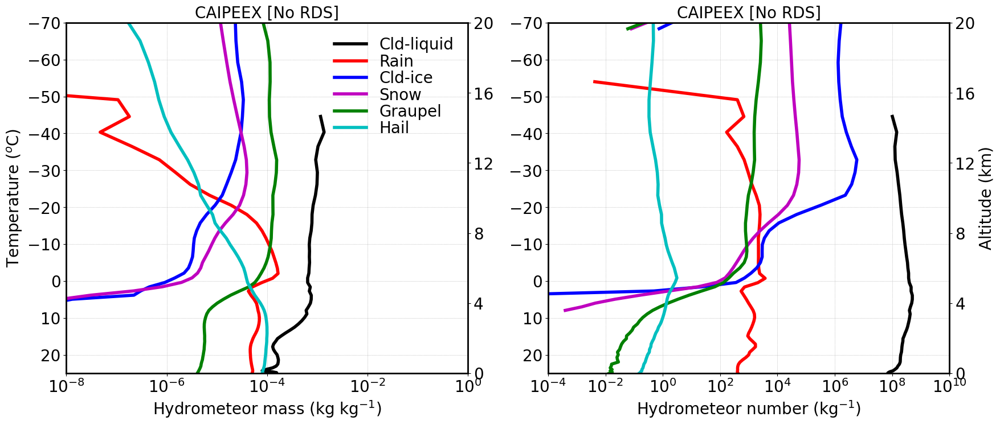

In [56]:


fontsize=20;
lnwdth=4;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qc_norf*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qr_norf*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qi_norf*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qs_norf*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qg_norf*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qh_norf*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qh_norf*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-8, 1.e0)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor mass (kg kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('CAIPEEX [No RDS]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qnc_norf*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qnr_norf*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qni_norf*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qns_norf*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qng_norf*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qnh_norf*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qnh_norf*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor number (kg$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('CAIPEEX [No RDS]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


In [55]:
thres_q = 1.e-12

mean_qc_nohm = ds_nohm.qc.where(ds_nohm.qc > thres_q).mean(dim=('time','ncells'))
mean_qr_nohm = ds_nohm.qr.where(ds_nohm.qr > thres_q).mean(dim=('time','ncells'))
mean_qi_nohm = ds_nohm.qi.where(ds_nohm.qi > thres_q).mean(dim=('time','ncells'))
mean_qs_nohm = ds_nohm.qs.where(ds_nohm.qs > thres_q).mean(dim=('time','ncells'))
mean_qg_nohm = ds_nohm.qg.where(ds_nohm.qg > thres_q).mean(dim=('time','ncells'))
mean_qh_nohm = ds_nohm.qh.where(ds_nohm.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qc_nohm, mean_qr_nohm, mean_qi_nohm, mean_qs_nohm, mean_qg_nohm, mean_qh_nohm]
numpy_variables = [var.values for var in variables]

mean_qc_nohm = numpy_variables[0]
mean_qr_nohm = numpy_variables[1]
mean_qi_nohm = numpy_variables[2]
mean_qs_nohm = numpy_variables[3]
mean_qg_nohm = numpy_variables[4]
mean_qh_nohm = numpy_variables[5]

mean_qnc_nohm = ds_nohm.qnc.where(ds_nohm.qc > thres_q).mean(dim=('time','ncells'))
mean_qnr_nohm = ds_nohm.qnr.where(ds_nohm.qr > thres_q).mean(dim=('time','ncells'))
mean_qni_nohm = ds_nohm.qni.where(ds_nohm.qi > thres_q).mean(dim=('time','ncells'))
mean_qns_nohm = ds_nohm.qns.where(ds_nohm.qs > thres_q).mean(dim=('time','ncells'))
mean_qng_nohm = ds_nohm.qng.where(ds_nohm.qg > thres_q).mean(dim=('time','ncells'))
mean_qnh_nohm = ds_nohm.qnh.where(ds_nohm.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qnc_nohm, mean_qnr_nohm, mean_qni_nohm, mean_qns_nohm, mean_qng_nohm, mean_qnh_nohm]
numpy_variables = [var.values for var in variables]

mean_qnc_nohm = numpy_variables[0]
mean_qnr_nohm = numpy_variables[1]
mean_qni_nohm = numpy_variables[2]
mean_qns_nohm = numpy_variables[3]
mean_qng_nohm = numpy_variables[4]
mean_qnh_nohm = numpy_variables[5]

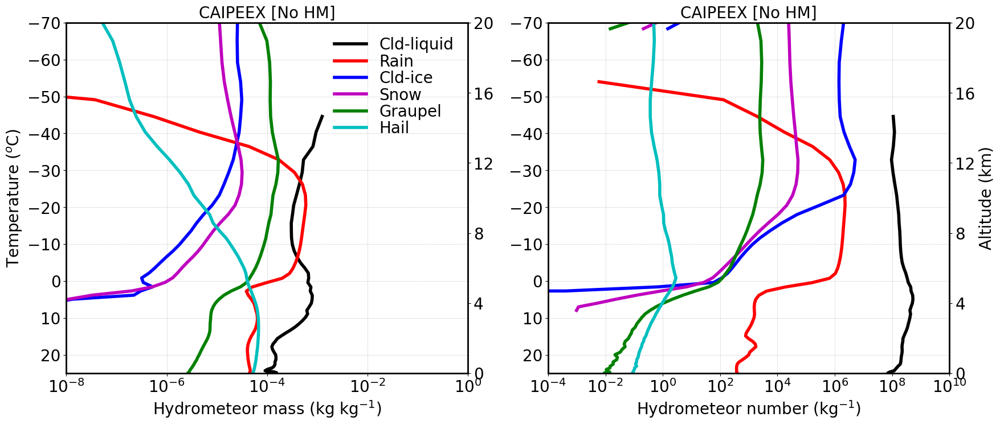

In [61]:


fontsize=20;
lnwdth=4;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qc_nohm*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qr_nohm*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qi_nohm*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qs_nohm*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qg_nohm*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qh_nohm*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qh_nohm*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-8, 1.e0)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor mass (kg kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('CAIPEEX [No HM]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qnc_nohm*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qnr_nohm*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qni_nohm*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qns_nohm*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qng_nohm*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qnh_nohm*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qnh_nohm*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor number (kg$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('CAIPEEX [No HM]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


In [57]:
thres_q = 1.e-12

mean_qc_nobr = ds_nobr.qc.where(ds_nobr.qc > thres_q).mean(dim=('time','ncells'))
mean_qr_nobr = ds_nobr.qr.where(ds_nobr.qr > thres_q).mean(dim=('time','ncells'))
mean_qi_nobr = ds_nobr.qi.where(ds_nobr.qi > thres_q).mean(dim=('time','ncells'))
mean_qs_nobr = ds_nobr.qs.where(ds_nobr.qs > thres_q).mean(dim=('time','ncells'))
mean_qg_nobr = ds_nobr.qg.where(ds_nobr.qg > thres_q).mean(dim=('time','ncells'))
mean_qh_nobr = ds_nobr.qh.where(ds_nobr.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qc_nobr, mean_qr_nobr, mean_qi_nobr, mean_qs_nobr, mean_qg_nobr, mean_qh_nobr]
numpy_variables = [var.values for var in variables]

mean_qc_nobr = numpy_variables[0]
mean_qr_nobr = numpy_variables[1]
mean_qi_nobr = numpy_variables[2]
mean_qs_nobr = numpy_variables[3]
mean_qg_nobr = numpy_variables[4]
mean_qh_nobr = numpy_variables[5]

mean_qnc_nobr = ds_nobr.qnc.where(ds_nobr.qc > thres_q).mean(dim=('time','ncells'))
mean_qnr_nobr = ds_nobr.qnr.where(ds_nobr.qr > thres_q).mean(dim=('time','ncells'))
mean_qni_nobr = ds_nobr.qni.where(ds_nobr.qi > thres_q).mean(dim=('time','ncells'))
mean_qns_nobr = ds_nobr.qns.where(ds_nobr.qs > thres_q).mean(dim=('time','ncells'))
mean_qng_nobr = ds_nobr.qng.where(ds_nobr.qg > thres_q).mean(dim=('time','ncells'))
mean_qnh_nobr = ds_nobr.qnh.where(ds_nobr.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qnc_nobr, mean_qnr_nobr, mean_qni_nobr, mean_qns_nobr, mean_qng_nobr, mean_qnh_nobr]
numpy_variables = [var.values for var in variables]

mean_qnc_nobr = numpy_variables[0]
mean_qnr_nobr = numpy_variables[1]
mean_qni_nobr = numpy_variables[2]
mean_qns_nobr = numpy_variables[3]
mean_qng_nobr = numpy_variables[4]
mean_qnh_nobr = numpy_variables[5]


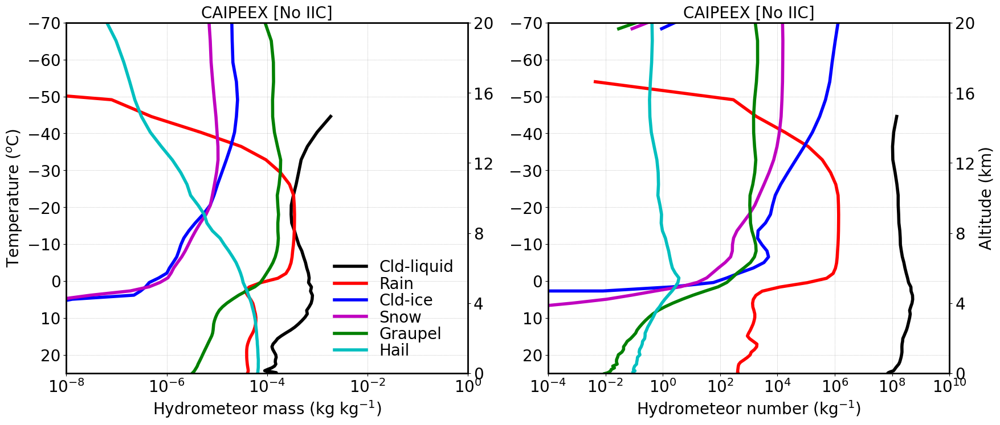

In [60]:


fontsize=20;
lnwdth=4;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qc_nobr*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qr_nobr*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qi_nobr*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qs_nobr*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qg_nobr*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qh_nobr*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qh_nobr*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-8, 1.e0)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor mass (kg kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('CAIPEEX [No IIC]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qnc_nobr*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qnr_nobr*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qni_nobr*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qns_nobr*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qng_nobr*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qnh_nobr*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qnh_nobr*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor number (kg$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('CAIPEEX [No IIC]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


In [58]:
thres_q = 1.e-12

mean_qc_nosb = ds_nosb.qc.where(ds_nosb.qc > thres_q).mean(dim=('time','ncells'))
mean_qr_nosb = ds_nosb.qr.where(ds_nosb.qr > thres_q).mean(dim=('time','ncells'))
mean_qi_nosb = ds_nosb.qi.where(ds_nosb.qi > thres_q).mean(dim=('time','ncells'))
mean_qs_nosb = ds_nosb.qs.where(ds_nosb.qs > thres_q).mean(dim=('time','ncells'))
mean_qg_nosb = ds_nosb.qg.where(ds_nosb.qg > thres_q).mean(dim=('time','ncells'))
mean_qh_nosb = ds_nosb.qh.where(ds_nosb.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qc_nosb, mean_qr_nosb, mean_qi_nosb, mean_qs_nosb, mean_qg_nosb, mean_qh_nosb]
numpy_variables = [var.values for var in variables]

mean_qc_nosb = numpy_variables[0]
mean_qr_nosb = numpy_variables[1]
mean_qi_nosb = numpy_variables[2]
mean_qs_nosb = numpy_variables[3]
mean_qg_nosb = numpy_variables[4]
mean_qh_nosb = numpy_variables[5]

mean_qnc_nosb = ds_nosb.qnc.where(ds_nosb.qc > thres_q).mean(dim=('time','ncells'))
mean_qnr_nosb = ds_nosb.qnr.where(ds_nosb.qr > thres_q).mean(dim=('time','ncells'))
mean_qni_nosb = ds_nosb.qni.where(ds_nosb.qi > thres_q).mean(dim=('time','ncells'))
mean_qns_nosb = ds_nosb.qns.where(ds_nosb.qs > thres_q).mean(dim=('time','ncells'))
mean_qng_nosb = ds_nosb.qng.where(ds_nosb.qg > thres_q).mean(dim=('time','ncells'))
mean_qnh_nosb = ds_nosb.qnh.where(ds_nosb.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qnc_nosb, mean_qnr_nosb, mean_qni_nosb, mean_qns_nosb, mean_qng_nosb, mean_qnh_nosb]
numpy_variables = [var.values for var in variables]

mean_qnc_nosb = numpy_variables[0]
mean_qnr_nosb = numpy_variables[1]
mean_qni_nosb = numpy_variables[2]
mean_qns_nosb = numpy_variables[3]
mean_qng_nosb = numpy_variables[4]
mean_qnh_nosb = numpy_variables[5]

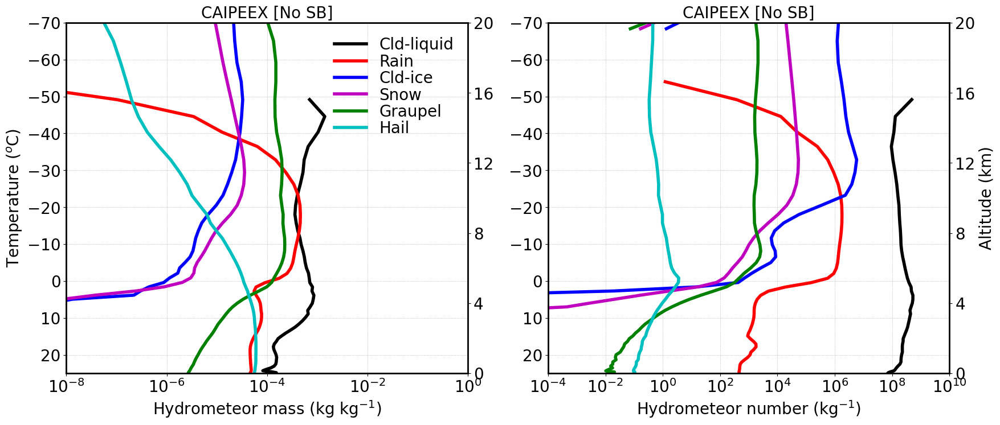

In [59]:


fontsize=20;
lnwdth=4;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qc_nosb*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qr_nosb*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qi_nosb*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qs_nosb*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qg_nosb*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qh_nosb*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qh_nosb*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-8, 1.e0)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor mass (kg kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('CAIPEEX [No SB]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qnc_nosb*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qnr_nosb*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qni_nosb*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qns_nosb*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qng_nosb*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qnh_nosb*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qnh_nosb*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor number (kg$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('CAIPEEX [No SB]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


## Process rates

### 1. Process rates of SIPs
#### mass and number mixing ratio 

In [66]:
ds_4sip

<xarray.Dataset> Size: 74GB
Dimensions:            (time: 41, ncells: 68960, vertices: 3, height: 65,
                        bnds: 2, plev: 1, plev_2: 1, plev_3: 1, height_2: 66)
Coordinates:
  * time               (time) datetime64[ns] 328B 2019-09-30 ... 2019-09-30T2...
    clon               (ncells) float64 552kB dask.array<chunksize=(68960,), meta=np.ndarray>
    clat               (ncells) float64 552kB dask.array<chunksize=(68960,), meta=np.ndarray>
  * height             (height) float64 520B 1.0 2.0 3.0 4.0 ... 63.0 64.0 65.0
  * height_2           (height_2) float64 528B 1.0 2.0 3.0 ... 64.0 65.0 66.0
  * plev               (plev) float64 8B 800.0
  * plev_2             (plev_2) float64 8B 400.0
  * plev_3             (plev_3) float64 8B 0.0
Dimensions without coordinates: ncells, vertices, bnds
Data variables: (12/121)
    clon_bnds          (time, ncells, vertices) float64 68MB dask.array<chunksize=(1, 68960, 3), meta=np.ndarray>
    clat_bnds          (time, ncells, vertices) float64 68MB dask.array<chunksize=(1, 68960, 3), meta=np.ndarray>
    height_bnds        (time, height, bnds) float64 43kB dask.array<chunksize=(1, 65, 2), meta=np.ndarray>
    plev_bnds          (time, plev, bnds) float64 656B dask.array<chunksize=(1, 1, 2), meta=np.ndarray>
    plev_2_bnds        (time, plev_2, bnds) float64 656B dask.array<chunksize=(1, 1, 2), meta=np.ndarray>
    plev_3_bnds        (time, plev_3, bnds) float64 656B dask.array<chunksize=(1, 1, 2), meta=np.ndarray>
    ...                 ...
    tqi                (time, height, ncells) float32 735MB dask.array<chunksize=(1, 65, 68960), meta=np.ndarray>
    tq                 (time, height, ncells) float32 735MB dask.array<chunksize=(1, 65, 68960), meta=np.ndarray>
    ciwc_gperm3        (time, height, ncells) float32 735MB dask.array<chunksize=(1, 65, 68960), meta=np.ndarray>
    tiwc_gperm3        (time, height, ncells) float32 735MB dask.array<chunksize=(1, 65, 68960), meta=np.ndarray>
    cdnc_percm3        (time, height, ncells) float32 735MB dask.array<chunksize=(1, 65, 68960), meta=np.ndarray>
    inc_perl           (time, height, ncells) float32 735MB dask.array<chunksize=(1, 65, 68960), meta=np.ndarray>
Attributes:
    CDI:                  Climate Data Interface version 2.4.0 (https://mpime...
    Conventions:          CF-1.6
    number_of_grid_used:  99
    uuidOfHGrid:          3eb4f381-adbd-e79a-b32f-6e1ff3ba2860
    uuidOfVGrid:          acbf7b33-d4a3-b631-6ecd-012f775e2bc0
    institution:          Max Planck Institute for Meteorology/Deutscher Wett...
    title:                ICON simulation
    source:               version: 2024.10; revision: f3f9a5624ca4223a7fe2f0c...
    history:              /home/b/b382718/continental_cases/4sip/icon-oct2024...
    references:           see MPIM/DWD publications
    comment:              Deepak Waman (b382718) on l20442 (Linux 4.18.0-513....

## SIP rates

In [11]:


dt_hours = (ds_4sip.time.diff('time') / np.timedelta64(1, 'h'))

thres_q = 1.e-14;
thres_w = -1.;
thres_cond = (ds_4sip.dqi_sec > thres_q) & (ds_4sip.w_vel < thres_w)
mean_qni_tot_sec_4sip = (ds_4sip.dqni_sec.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_rf_4sip = (ds_4sip.dqni_ds.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_hm_4sip = (ds_4sip.dqni_rs.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_br_4sip = (ds_4sip.dqni_br.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_sb_snow_4sip = (ds_4sip.dqni_snow_sbf.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_sb_graup_4sip = (ds_4sip.dqni_graup_sbf.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_sb_4sip = mean_qni_sb_snow_4sip + mean_qni_sb_graup_4sip

mean_qni_tot_sec_4sip = mean_qni_tot_sec_4sip/dt_hours.mean('time')
mean_qni_rf_4sip = mean_qni_rf_4sip/dt_hours.mean('time')
mean_qni_hm_4sip = mean_qni_hm_4sip/dt_hours.mean('time')
mean_qni_br_4sip = mean_qni_br_4sip/dt_hours.mean('time')
mean_qni_sb_snow_4sip = mean_qni_sb_snow_4sip/dt_hours.mean('time')
mean_qni_sb_graup_4sip = mean_qni_sb_graup_4sip/dt_hours.mean('time')
mean_qni_sb_4sip = mean_qni_sb_4sip/dt_hours.mean('time')


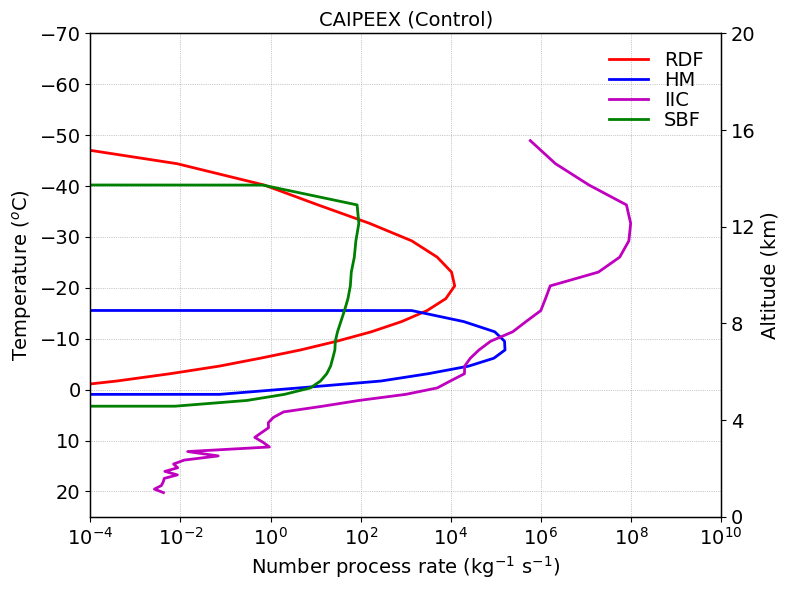

In [20]:


fontsize=14;
lnwdth=2;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qni_rf_4sip*fact, mean_tempc_4sip, 'r-', linewidth=lnwdth, label='RDF')
plt1.plot(mean_qni_hm_4sip*fact, mean_tempc_4sip, 'b-', linewidth=lnwdth, label='HM')
plt1.plot(mean_qni_br_4sip*fact, mean_tempc_4sip, 'm-', linewidth=lnwdth, label='IIC')
plt1.plot(mean_qni_sb_4sip*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='SBF')
#plt1.plot(mean_qni_tot_sec_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt2.plot(mean_qni_tot_sec_4sip*fact, mean_tempc_4sip, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Number process rate (kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('CAIPEEX (Control)', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


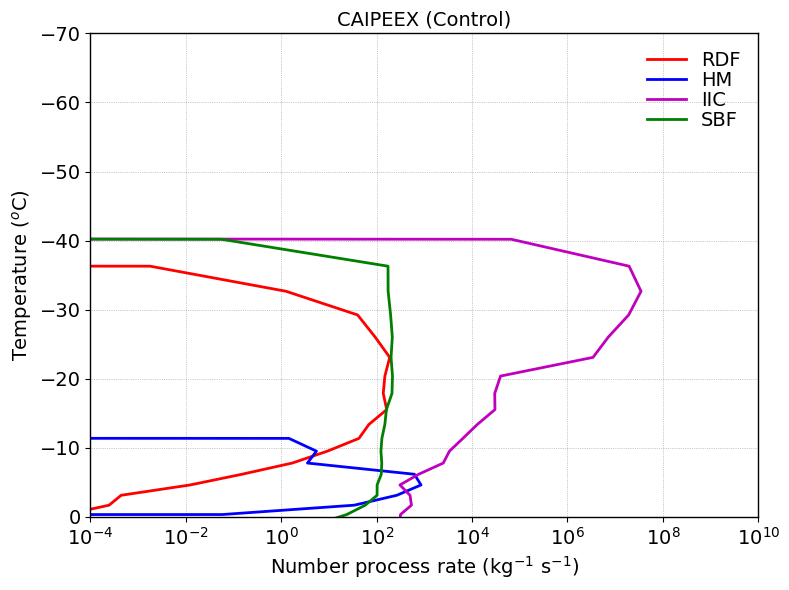

In [12]:


fontsize=14;
lnwdth=2;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
#plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qni_rf_4sip*fact, mean_tempc_4sip, 'r-', linewidth=lnwdth, label='RDF')
plt1.plot(mean_qni_hm_4sip*fact, mean_tempc_4sip, 'b-', linewidth=lnwdth, label='HM')
plt1.plot(mean_qni_br_4sip*fact, mean_tempc_4sip, 'm-', linewidth=lnwdth, label='IIC')
plt1.plot(mean_qni_sb_4sip*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='SBF')
#plt1.plot(mean_qni_tot_sec_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

#plt2.plot(mean_qni_tot_sec_4sip*fact, mean_tempc_4sip, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(0, -70)
#plt2.set_ylim(0.5, 20)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([0, -10, -20, -30, -40, -50, -60, -70])
#plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
#plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Number process rate (kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
#plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('CAIPEEX (Control)', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


In [45]:

thres_q = 1.e-14

mean_qi_homhet_4sip = ds_4sip.d_qi_homhet.where(ds_4sip.tqi > thres_q).mean(dim=('time','ncells'))
mean_qi_hom_4sip = ds_4sip.d_qi_hom.where(ds_4sip.tqi > thres_q).mean(dim=('time','ncells'))
mean_qi_het_4sip = ds_4sip.d_qi_het.where(ds_4sip.tqi > thres_q).mean(dim=('time','ncells'))

variables = [mean_qi_homhet_4sip, mean_qi_hom_4sip, mean_qi_het_4sip]
numpy_variables = [var.values for var in variables]

mean_qi_homhet_4sip = numpy_variables[0]
mean_qi_hom_4sip = numpy_variables[1]
mean_qi_het_4sip = numpy_variables[2]

mean_qni_homhet_4sip = ds_4sip.d_qni_homhet.where(ds_4sip.tqi > thres_q).mean(dim=('time','ncells'))
mean_qni_hom_4sip = ds_4sip.d_qni_hom.where(ds_4sip.tqi > thres_q).mean(dim=('time','ncells'))

variables = [mean_qni_homhet_4sip, mean_qni_hom_4sip]
numpy_variables = [var.values for var in variables]
mean_qni_homhet_4sip = numpy_variables[0]
mean_qni_hom_4sip = numpy_variables[1]

mean_qi_tot_sec_4sip = ds_4sip.dqi_sec.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qi_rf_4sip = ds_4sip.dqi_ds.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qi_hm_4sip = ds_4sip.dqi_rs.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qi_br_4sip = ds_4sip.dqi_br.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qi_sb_snow_4sip = ds_4sip.dqi_snow_sbf.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qi_sb_graup_4sip = ds_4sip.dqi_graup_sbf.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qi_sb_4sip = mean_qi_sb_snow_4sip + mean_qi_sb_graup_4sip

mean_qni_tot_sec_4sip = ds_4sip.dqni_sec.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qni_rf_4sip = ds_4sip.dqni_ds.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qni_hm_4sip = ds_4sip.dqni_rs.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qni_br_4sip = ds_4sip.dqni_br.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qni_sb_snow_4sip = ds_4sip.dqni_snow_sbf.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qni_sb_graup_4sip = ds_4sip.dqni_graup_sbf.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qni_sb_4sip = mean_qni_sb_snow_4sip + mean_qni_sb_graup_4sip

variables = [mean_qi_tot_sec_4sip, mean_qi_rf_4sip, mean_qi_hm_4sip, mean_qi_br_4sip, mean_qi_sb_4sip]
numpy_variables = [var.values for var in variables]

mean_qi_tot_sec_4sip = numpy_variables[0]
mean_qi_rf_4sip = numpy_variables[1]
mean_qi_hm_4sip = numpy_variables[2]
mean_qi_br_4sip = numpy_variables[3]
mean_qi_sb_4sip = numpy_variables[4]

variables = [mean_qni_tot_sec_4sip, mean_qni_rf_4sip, mean_qni_hm_4sip, mean_qni_br_4sip, mean_qni_sb_4sip]
numpy_variables = [var.values for var in variables]

mean_qni_tot_sec_4sip = numpy_variables[0]
mean_qni_rf_4sip = numpy_variables[1]
mean_qni_hm_4sip = numpy_variables[2]
mean_qni_br_4sip = numpy_variables[3]
mean_qni_sb_4sip = numpy_variables[4]

In [67]:
mean_qni_homhet_4sip = ds_4sip.d_qni_homhet.where(ds_4sip.tqi > thres_q).mean(dim=('time','ncells'))
mean_qni_hom_4sip = ds_4sip.d_qni_hom.where(ds_4sip.tqi > thres_q).mean(dim=('time','ncells'))

variables = [mean_qni_homhet_4sip, mean_qni_hom_4sip]
numpy_variables = [var.values for var in variables]
mean_qni_homhet_4sip = numpy_variables[0]
mean_qni_hom_4sip = numpy_variables[1]

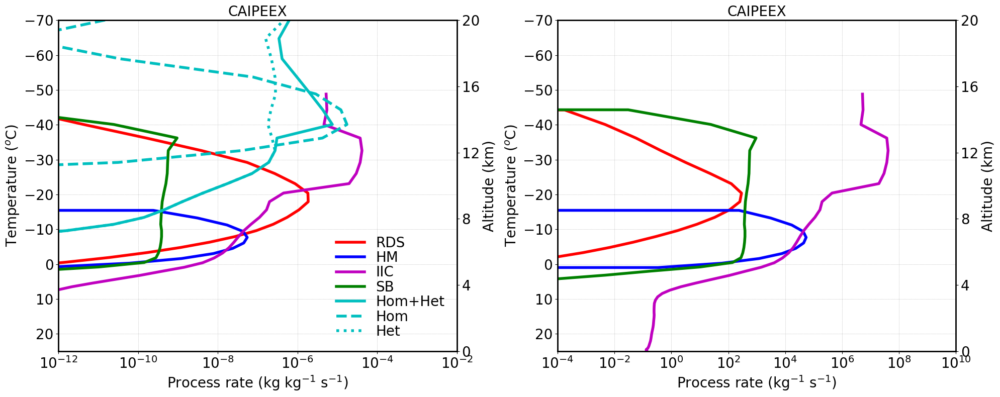

In [50]:


fontsize=20;
lnwdth=4;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qi_rf_4sip*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='RDS')
plt1.plot(mean_qi_hm_4sip*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='HM')
plt1.plot(mean_qi_br_4sip*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='IIC')
plt1.plot(mean_qi_sb_4sip*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='SB')
#plt1.plot(mean_qi_tot_sec_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')


plt1.plot(mean_qi_homhet_4sip*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hom+Het')
plt1.plot(mean_qi_hom_4sip*fact, mean_tempc_4sip, 'c--', linewidth=lnwdth, label='Hom')
plt1.plot(mean_qi_het_4sip*fact, mean_tempc_4sip, 'c:', linewidth=lnwdth, label='Het')
#plt1.plot(mean_qi_hom*fact, mean_tempc_4sip, 'c--', linewidth=lnwdth, label='Hom')

plt2.plot(mean_qi_tot_sec_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-12, 1.e-2)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Process rate (kg kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')

plt.title('CAIPEEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qni_rf_4sip*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='RDS')
plt1.plot(mean_qni_hm_4sip*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='HM')
plt1.plot(mean_qni_br_4sip*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='IIC')
plt1.plot(mean_qni_sb_4sip*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='SB')
#plt1.plot(mean_qni_tot_sec_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt2.plot(mean_qni_tot_sec_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Process rate (kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('CAIPEEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.tight_layout()
plt.show()


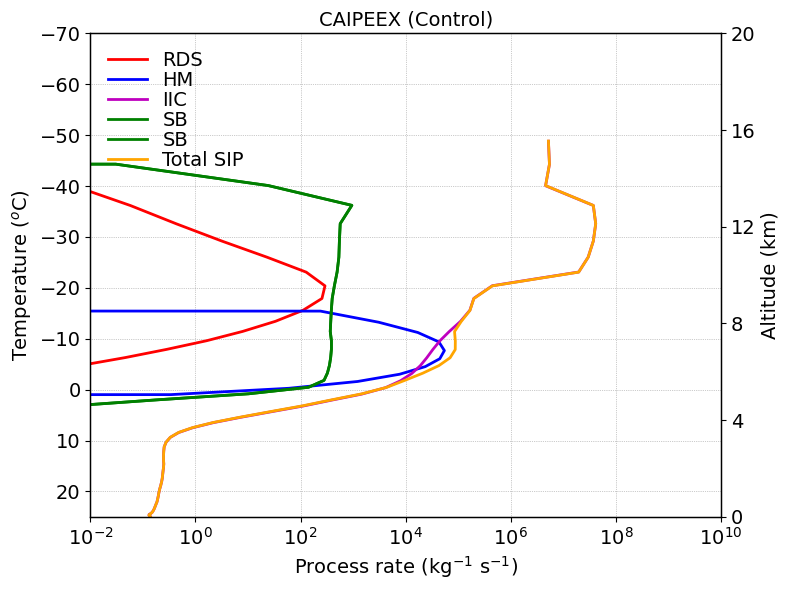

In [71]:

#mean_qni_tot_homhet_4sip = mean_qni_homhet_4sip + mean_qni_hom_4sip 
#mean_qni_het_4sip = mean_qni_homhet_4sip-mean_tot_qi_hom_4sip

mean_qni_tot_sec_4sip = mean_qni_rf_4sip+mean_qni_hm_4sip+mean_qni_br_4sip+mean_qni_sb_4sip

fontsize=14;
lnwdth=2;
alpha=0.6;

plt.figure(figsize=(8, 6))

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qni_rf_4sip*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='RDS')
plt1.plot(mean_qni_hm_4sip*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='HM')
plt1.plot(mean_qni_br_4sip*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='IIC')
plt1.plot(mean_qni_sb_4sip*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='SB')
plt1.plot(mean_qni_sb_4sip*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='SB')
plt1.plot(mean_qni_tot_sec_4sip*fact, mean_tempc_4sip, '-', color='orange', linewidth=lnwdth, label='Total SIP')

plt2.plot(mean_qni_tot_sec_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-2, 1.e10)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Process rate (kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('CAIPEEX (Control)', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


(25.0, -70.0)

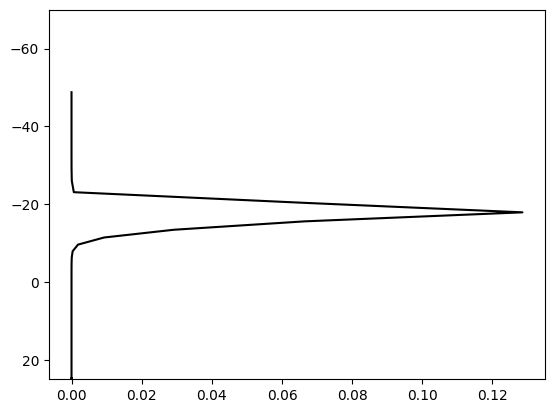

In [75]:

plt.plot(per_qni_rf_4sip, mean_tempc_norf, 'k-')
#plt.xlim(0, 1.e2)
plt.ylim(25, -70)

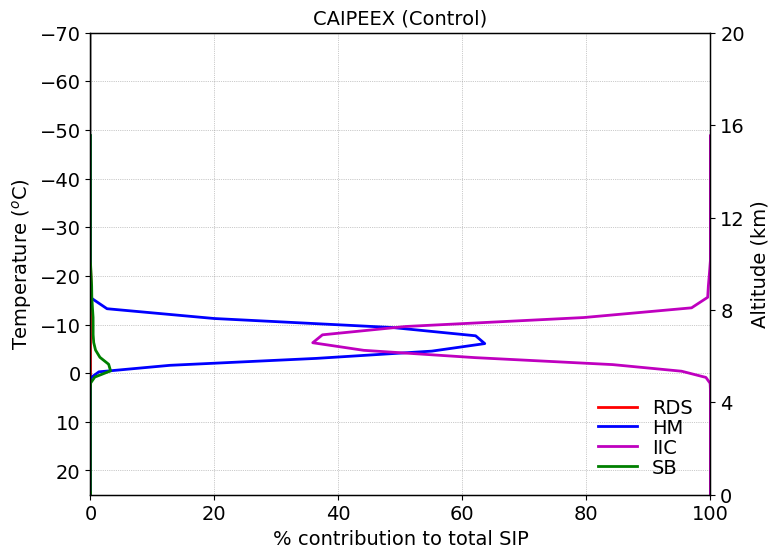

In [70]:
fontsize=14;
lnwdth=2;
alpha=0.6;

mean_qni_tot_sec_4sip = mean_qni_rf_4sip+mean_qni_hm_4sip+mean_qni_br_4sip+mean_qni_sb_4sip

per_qni_rf_4sip = 100*mean_qni_rf_4sip/mean_qni_tot_sec_4sip
per_qni_hm_4sip = 100*mean_qni_hm_4sip/mean_qni_tot_sec_4sip
per_qni_br_4sip = 100*mean_qni_br_4sip/mean_qni_tot_sec_4sip
per_qni_sb_4sip = 100*mean_qni_sb_4sip/mean_qni_tot_sec_4sip

plt.figure(figsize=(8, 6))


plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(per_qni_rf_4sip, mean_tempc_norf, 'r-', linewidth=lnwdth, label='RDS')
plt1.plot(per_qni_hm_4sip, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='HM')
plt1.plot(per_qni_br_4sip, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='IIC')
plt1.plot(per_qni_sb_4sip, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='SB')


#plt1.plot(mean_qi_hom*fact, mean_tempc_4sip, 'c--', linewidth=lnwdth, label='Hom')

plt2.plot(per_qni_sb_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

#plt1.set_xscale('log')
plt1.set_xlim(0, 1.e2)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('% contribution to total SIP', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')

plt.title('CAIPEEX (Control)', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.show()

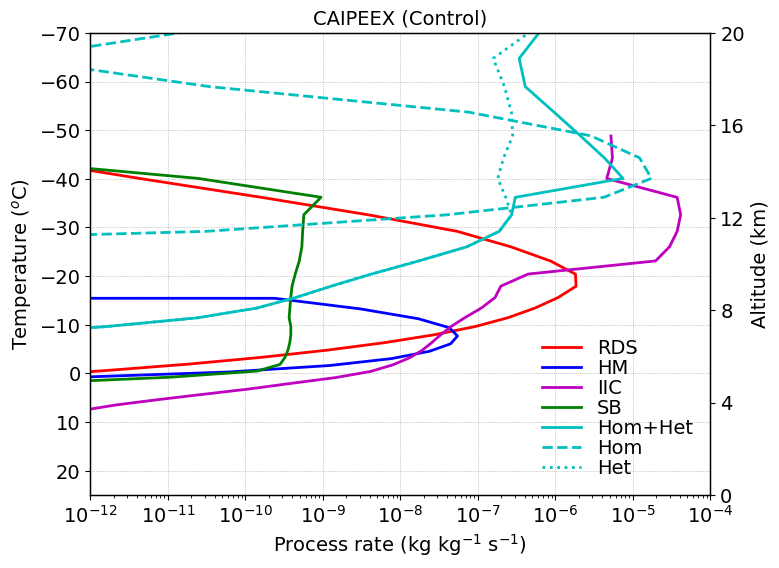

In [69]:


fontsize=14;
lnwdth=2;
alpha=0.6;

plt.figure(figsize=(8, 6))

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qi_rf_4sip*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='RDS')
plt1.plot(mean_qi_hm_4sip*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='HM')
plt1.plot(mean_qi_br_4sip*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='IIC')
plt1.plot(mean_qi_sb_4sip*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='SB')
#plt1.plot(mean_qi_tot_sec_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')


plt1.plot(mean_qi_homhet_4sip*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hom+Het')
plt1.plot(mean_qi_hom_4sip*fact, mean_tempc_4sip, 'c--', linewidth=lnwdth, label='Hom')
plt1.plot(mean_qi_het_4sip*fact, mean_tempc_4sip, 'c:', linewidth=lnwdth, label='Het')
#plt1.plot(mean_qi_hom*fact, mean_tempc_4sip, 'c--', linewidth=lnwdth, label='Hom')

plt2.plot(mean_qi_tot_sec_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-12, 1.e-4)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Process rate (kg kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')

plt.title('CAIPEEX (Control)', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)


plt.show()


## Process rates of riming, deposition, nucleation, freezing

In [10]:

thres_q = 1.e-8

# Riming
mean_dq_tot_rime_4sip = xr.where(ds_4sip.d_qx_riming > thres_q, ds_4sip.d_qx_riming, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_rime_nosip = xr.where(ds_nosip.d_qx_riming > thres_q, ds_nosip.d_qx_riming, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_rime_norf = xr.where(ds_norf.d_qx_riming > thres_q, ds_norf.d_qx_riming, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_rime_nohm = xr.where(ds_nohm.d_qx_riming > thres_q, ds_nohm.d_qx_riming, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_rime_nobr = xr.where(ds_nobr.d_qx_riming > thres_q, ds_nobr.d_qx_riming, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_rime_nosb = xr.where(ds_nosb.d_qx_riming > thres_q, ds_nosb.d_qx_riming, np.nan).mean(dim=('time','ncells'))

# Deposition 
mean_dq_tot_dep_4sip = ds_4sip.d_qi_dep+ds_4sip.d_qs_dep+ds_4sip.d_qg_dep+ds_4sip.d_qh_dep
mean_dq_tot_dep_nosip = ds_nosip.d_qi_dep+ds_nosip.d_qs_dep+ds_nosip.d_qg_dep+ds_nosip.d_qh_dep
mean_dq_tot_dep_norf = ds_norf.d_qi_dep+ds_norf.d_qs_dep+ds_norf.d_qg_dep+ds_norf.d_qh_dep
mean_dq_tot_dep_nohm = ds_nohm.d_qi_dep+ds_nohm.d_qs_dep+ds_nohm.d_qg_dep+ds_nohm.d_qh_dep
mean_dq_tot_dep_nobr = ds_nobr.d_qi_dep+ds_nobr.d_qs_dep+ds_nobr.d_qg_dep+ds_nobr.d_qh_dep
mean_dq_tot_dep_nosb = ds_nosb.d_qi_dep+ds_nosb.d_qs_dep+ds_nosb.d_qg_dep+ds_nosb.d_qh_dep

mean_dq_tot_dep_4sip = xr.where(mean_dq_tot_dep_4sip > thres_q, mean_dq_tot_dep_4sip, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_dep_nosip = xr.where(mean_dq_tot_dep_nosip > thres_q, mean_dq_tot_dep_nosip, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_dep_norf = xr.where(mean_dq_tot_dep_norf > thres_q, mean_dq_tot_dep_norf, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_dep_nohm = xr.where(mean_dq_tot_dep_nohm > thres_q, mean_dq_tot_dep_nohm, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_dep_nobr = xr.where(mean_dq_tot_dep_nobr > thres_q, mean_dq_tot_dep_nobr, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_dep_nosb = xr.where(mean_dq_tot_dep_nosb > thres_q, mean_dq_tot_dep_nosb, np.nan).mean(dim=('time','ncells'))

# Saturation adjustment
mean_dq_satad1_4sip = xr.where(ds_4sip.d_satad > thres_q, ds_4sip.d_satad, np.nan).mean(dim=('time','ncells'))
mean_dq_satad1_nosip = xr.where(ds_nosip.d_satad > thres_q, ds_nosip.d_satad, np.nan).mean(dim=('time','ncells'))
mean_dq_satad1_norf = xr.where(ds_norf.d_satad > thres_q, ds_norf.d_satad, np.nan).mean(dim=('time','ncells'))
mean_dq_satad1_nohm = xr.where(ds_nohm.d_satad > thres_q, ds_nohm.d_satad, np.nan).mean(dim=('time','ncells'))
mean_dq_satad1_nobr = xr.where(ds_nobr.d_satad > thres_q, ds_nobr.d_satad, np.nan).mean(dim=('time','ncells'))
mean_dq_satad1_nosb = xr.where(ds_nosb.d_satad > thres_q, ds_nosb.d_satad, np.nan).mean(dim=('time','ncells'))

mean_dq_satad2_4sip = xr.where(ds_4sip.d_satad2 > thres_q, ds_4sip.d_satad2, np.nan).mean(dim=('time','ncells'))
mean_dq_satad2_nosip = xr.where(ds_nosip.d_satad2 > thres_q, ds_nosip.d_satad2, np.nan).mean(dim=('time','ncells'))
mean_dq_satad2_norf = xr.where(ds_norf.d_satad2 > thres_q, ds_norf.d_satad2, np.nan).mean(dim=('time','ncells'))
mean_dq_satad2_nohm = xr.where(ds_nohm.d_satad2 > thres_q, ds_nohm.d_satad2, np.nan).mean(dim=('time','ncells'))
mean_dq_satad2_nobr = xr.where(ds_nobr.d_satad2 > thres_q, ds_nobr.d_satad2, np.nan).mean(dim=('time','ncells'))
mean_dq_satad2_nosb = xr.where(ds_nosb.d_satad2 > thres_q, ds_nosb.d_satad2, np.nan).mean(dim=('time','ncells'))

# Hom+het ice nucleation
mean_dq_homhet_4sip = xr.where(ds_4sip.d_qi_homhet > thres_q, ds_4sip.d_qi_homhet, np.nan).mean(dim=('time','ncells'))
mean_dq_homhet_nosip = xr.where(ds_nosip.d_qi_homhet > thres_q, ds_nosip.d_qi_homhet, np.nan).mean(dim=('time','ncells'))
mean_dq_homhet_norf = xr.where(ds_norf.d_qi_homhet > thres_q, ds_norf.d_qi_homhet, np.nan).mean(dim=('time','ncells'))
mean_dq_homhet_nohm = xr.where(ds_nohm.d_qi_homhet > thres_q, ds_nohm.d_qi_homhet, np.nan).mean(dim=('time','ncells'))
mean_dq_homhet_nobr = xr.where(ds_nobr.d_qi_homhet > thres_q, ds_nobr.d_qi_homhet, np.nan).mean(dim=('time','ncells'))
mean_dq_homhet_nosb = xr.where(ds_nosb.d_qi_homhet > thres_q, ds_nosb.d_qi_homhet, np.nan).mean(dim=('time','ncells'))

# Hom ice nucleation
mean_dq_hom_4sip = xr.where(ds_4sip.d_qi_hom > thres_q, ds_4sip.d_qi_hom, np.nan).mean(dim=('time','ncells'))
mean_dq_hom_nosip = xr.where(ds_nosip.d_qi_hom > thres_q, ds_nosip.d_qi_hom, np.nan).mean(dim=('time','ncells'))
mean_dq_hom_norf = xr.where(ds_norf.d_qi_hom > thres_q, ds_norf.d_qi_hom, np.nan).mean(dim=('time','ncells'))
mean_dq_hom_nohm = xr.where(ds_nohm.d_qi_hom > thres_q, ds_nohm.d_qi_hom, np.nan).mean(dim=('time','ncells'))
mean_dq_hom_nobr = xr.where(ds_nobr.d_qi_hom > thres_q, ds_nobr.d_qi_hom, np.nan).mean(dim=('time','ncells'))
mean_dq_hom_nosb = xr.where(ds_nosb.d_qi_hom > thres_q, ds_nosb.d_qi_hom, np.nan).mean(dim=('time','ncells'))

# het ice nucleation
mean_dq_het_4sip = xr.where(ds_4sip.d_qi_het > thres_q, ds_4sip.d_qi_het, np.nan).mean(dim=('time','ncells'))
mean_dq_het_nosip = xr.where(ds_nosip.d_qi_het > thres_q, ds_nosip.d_qi_het, np.nan).mean(dim=('time','ncells'))
mean_dq_het_norf = xr.where(ds_norf.d_qi_het > thres_q, ds_norf.d_qi_het, np.nan).mean(dim=('time','ncells'))
mean_dq_het_nohm = xr.where(ds_nohm.d_qi_het > thres_q, ds_nohm.d_qi_het, np.nan).mean(dim=('time','ncells'))
mean_dq_het_nobr = xr.where(ds_nobr.d_qi_het > thres_q, ds_nobr.d_qi_het, np.nan).mean(dim=('time','ncells'))
mean_dq_het_nosb = xr.where(ds_nosb.d_qi_het > thres_q, ds_nosb.d_qi_het, np.nan).mean(dim=('time','ncells'))

# Rain freezing
mean_dq_rainfreez_4sip = ds_4sip.d_qr_rf+ds_4sip.d_qs_rf+ds_4sip.d_qg_rf+ds_4sip.d_qh_rf
mean_dq_rainfreez_nosip = ds_nosip.d_qr_rf+ds_nosip.d_qs_rf+ds_nosip.d_qg_rf+ds_nosip.d_qh_rf
mean_dq_rainfreez_norf = ds_norf.d_qr_rf+ds_norf.d_qs_rf+ds_norf.d_qg_rf+ds_norf.d_qh_rf
mean_dq_rainfreez_nohm = ds_nohm.d_qr_rf+ds_nohm.d_qs_rf+ds_nohm.d_qg_rf+ds_nohm.d_qh_rf
mean_dq_rainfreez_nobr = ds_nobr.d_qr_rf+ds_nobr.d_qs_rf+ds_nobr.d_qg_rf+ds_nobr.d_qh_rf
mean_dq_rainfreez_nosb = ds_nosb.d_qr_rf+ds_nosb.d_qs_rf+ds_nosb.d_qg_rf+ds_nosb.d_qh_rf

mean_dq_rainfreez_4sip = xr.where(mean_dq_rainfreez_4sip > thres_q, mean_dq_rainfreez_4sip, np.nan).mean(dim=('time','ncells'))
mean_dq_rainfreez_nosip = xr.where(mean_dq_rainfreez_nosip > thres_q, mean_dq_rainfreez_nosip, np.nan).mean(dim=('time','ncells'))
mean_dq_rainfreez_norf = xr.where(mean_dq_rainfreez_norf > thres_q, mean_dq_rainfreez_norf, np.nan).mean(dim=('time','ncells'))
mean_dq_rainfreez_nohm = xr.where(mean_dq_rainfreez_nohm > thres_q, mean_dq_rainfreez_nohm, np.nan).mean(dim=('time','ncells'))
mean_dq_rainfreez_nobr = xr.where(mean_dq_rainfreez_nobr > thres_q, mean_dq_rainfreez_nobr, np.nan).mean(dim=('time','ncells'))
mean_dq_rainfreez_nosb = xr.where(mean_dq_rainfreez_nosb > thres_q, mean_dq_rainfreez_nosb, np.nan).mean(dim=('time','ncells'))

# Evaporation
mean_dq_evap_4sip = ds_4sip.d_qr_evap+ds_4sip.d_qsgh_evap
mean_dq_evap_nosip = ds_nosip.d_qr_evap+ds_nosip.d_qsgh_evap
mean_dq_evap_norf = ds_norf.d_qr_evap+ds_norf.d_qsgh_evap
mean_dq_evap_nohm = ds_nohm.d_qr_evap+ds_nohm.d_qsgh_evap
mean_dq_evap_nobr = ds_nobr.d_qr_evap+ds_nobr.d_qsgh_evap
mean_dq_evap_nosb = ds_nosb.d_qr_evap+ds_nosb.d_qsgh_evap

mean_dq_evap_4sip = xr.where(mean_dq_evap_4sip > thres_q, mean_dq_evap_4sip, np.nan).mean(dim=('time','ncells'))
mean_dq_evap_nosip = xr.where(mean_dq_evap_nosip > thres_q, mean_dq_evap_nosip, np.nan).mean(dim=('time','ncells'))
mean_dq_evap_norf = xr.where(mean_dq_evap_norf > thres_q, mean_dq_evap_norf, np.nan).mean(dim=('time','ncells'))
mean_dq_evap_nohm = xr.where(mean_dq_evap_nohm > thres_q, mean_dq_evap_nohm, np.nan).mean(dim=('time','ncells'))
mean_dq_evap_nobr = xr.where(mean_dq_evap_nobr > thres_q, mean_dq_evap_nobr, np.nan).mean(dim=('time','ncells'))
mean_dq_evap_nosb = xr.where(mean_dq_evap_nosb > thres_q, mean_dq_evap_nosb, np.nan).mean(dim=('time','ncells'))

# Melting
mean_dq_melt_4sip = ds_4sip.d_qc_melt+ds_4sip.d_qr_melt
mean_dq_melt_nosip = ds_nosip.d_qc_melt+ds_nosip.d_qr_melt
mean_dq_melt_norf = ds_norf.d_qc_melt+ds_norf.d_qr_melt
mean_dq_melt_nohm = ds_nohm.d_qc_melt+ds_nohm.d_qr_melt
mean_dq_melt_nobr = ds_nobr.d_qc_melt+ds_nobr.d_qr_melt
mean_dq_melt_nosb = ds_nosb.d_qc_melt+ds_nosb.d_qr_melt

mean_dq_melt_4sip = xr.where(mean_dq_melt_4sip > thres_q, mean_dq_melt_4sip, np.nan).mean(dim=('time','ncells'))
mean_dq_melt_nosip = xr.where(mean_dq_melt_nosip > thres_q, mean_dq_melt_nosip, np.nan).mean(dim=('time','ncells'))
mean_dq_melt_norf = xr.where(mean_dq_melt_norf > thres_q, mean_dq_melt_norf, np.nan).mean(dim=('time','ncells'))
mean_dq_melt_nohm = xr.where(mean_dq_melt_nohm > thres_q, mean_dq_melt_nohm, np.nan).mean(dim=('time','ncells'))
mean_dq_melt_nobr = xr.where(mean_dq_melt_nobr > thres_q, mean_dq_melt_nobr, np.nan).mean(dim=('time','ncells'))
mean_dq_melt_nosb = xr.where(mean_dq_melt_nosb > thres_q, mean_dq_melt_nosb, np.nan).mean(dim=('time','ncells'))

# Nucleation

mean_dq_nuc_4sip = xr.where(ds_4sip.d_qc_nuc > thres_q, ds_4sip.d_qc_nuc, np.nan).mean(dim=('time','ncells'))
mean_dq_nuc_nosip = xr.where(ds_nosip.d_qc_nuc > thres_q, ds_nosip.d_qc_nuc, np.nan).mean(dim=('time','ncells'))
mean_dq_nuc_norf = xr.where(ds_norf.d_qc_nuc > thres_q, ds_norf.d_qc_nuc, np.nan).mean(dim=('time','ncells'))
mean_dq_nuc_nohm = xr.where(ds_nohm.d_qc_nuc > thres_q, ds_nohm.d_qc_nuc, np.nan).mean(dim=('time','ncells'))
mean_dq_nuc_nobr = xr.where(ds_nobr.d_qc_nuc > thres_q, ds_nobr.d_qc_nuc, np.nan).mean(dim=('time','ncells'))
mean_dq_nuc_nosb = xr.where(ds_nosb.d_qc_nuc > thres_q, ds_nosb.d_qc_nuc, np.nan).mean(dim=('time','ncells'))


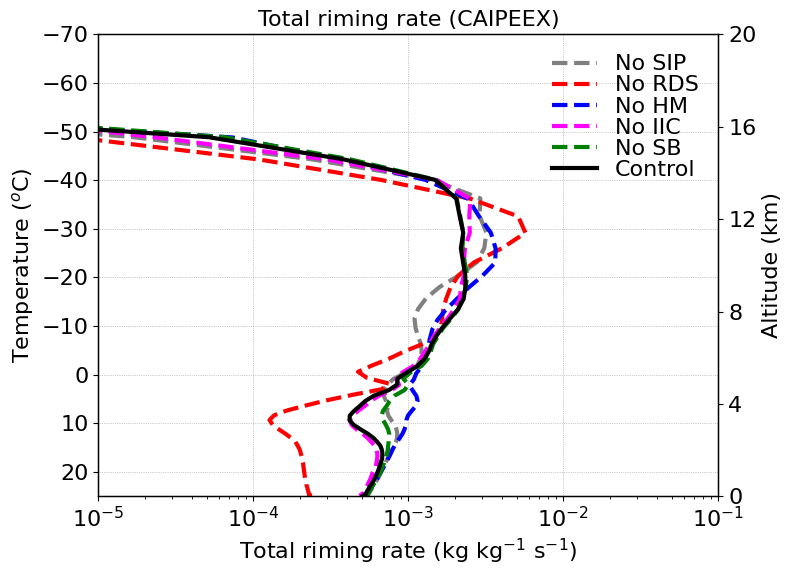

In [11]:

fontsize=16;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_dq_tot_rime_nosip*fact, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_dq_tot_rime_norf*fact, mean_tempc_norf, '--', color='red', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_dq_tot_rime_nohm*fact, mean_tempc_nohm, '--', color='blue', linewidth=lnwdth, label='No HM')
plt1.plot(mean_dq_tot_rime_nobr*fact, mean_tempc_nobr, '--', color='magenta', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_dq_tot_rime_nosb*fact, mean_tempc_nosb, '--', color='green', linewidth=lnwdth, label='No SB')
plt1.plot(mean_dq_tot_rime_4sip*fact, mean_tempc_4sip, '-', color='black', linewidth=lnwdth, label='Control')

plt2.plot(mean_dq_tot_rime_4sip*fact, mean_ht_4sip, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-5, 1.e-1)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total riming rate (kg kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('Total riming rate (CAIPEEX)', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

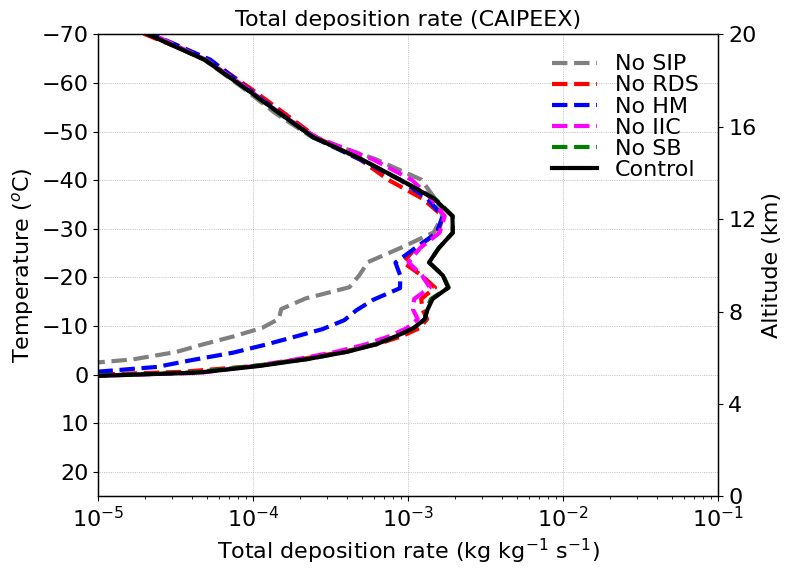

In [12]:

fontsize=16;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_dq_tot_dep_nosip*fact, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_dq_tot_dep_norf*fact, mean_tempc_norf, '--', color='red', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_dq_tot_dep_nohm*fact, mean_tempc_nohm, '--', color='blue', linewidth=lnwdth, label='No HM')
plt1.plot(mean_dq_tot_dep_nobr*fact, mean_tempc_nobr, '--', color='magenta', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_dq_tot_dep_nosb*fact, mean_tempc_nosb, '--', color='green', linewidth=lnwdth, label='No SB')
plt1.plot(mean_dq_tot_dep_4sip*fact, mean_tempc_4sip, '-', color='black', linewidth=lnwdth, label='Control')

plt2.plot(mean_dq_tot_dep_4sip*fact, mean_ht_4sip, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-5, 1.e-1)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total deposition rate (kg kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('Total deposition rate (CAIPEEX)', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

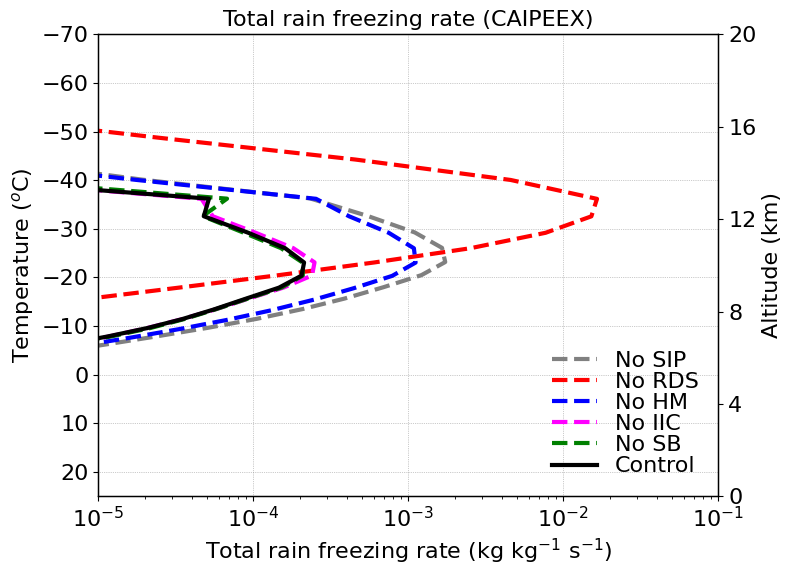

In [13]:

fontsize=16;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_dq_rainfreez_nosip*fact, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_dq_rainfreez_norf*fact, mean_tempc_norf, '--', color='red', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_dq_rainfreez_nohm*fact, mean_tempc_nohm, '--', color='blue', linewidth=lnwdth, label='No HM')
plt1.plot(mean_dq_rainfreez_nobr*fact, mean_tempc_nobr, '--', color='magenta', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_dq_rainfreez_nosb*fact, mean_tempc_nosb, '--', color='green', linewidth=lnwdth, label='No SB')
plt1.plot(mean_dq_rainfreez_4sip*fact, mean_tempc_4sip, '-', color='black', linewidth=lnwdth, label='Control')

plt2.plot(mean_dq_rainfreez_4sip*fact, mean_ht_4sip, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-5, 1.e-1)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total rain freezing rate (kg kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('Total rain freezing rate (CAIPEEX)', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

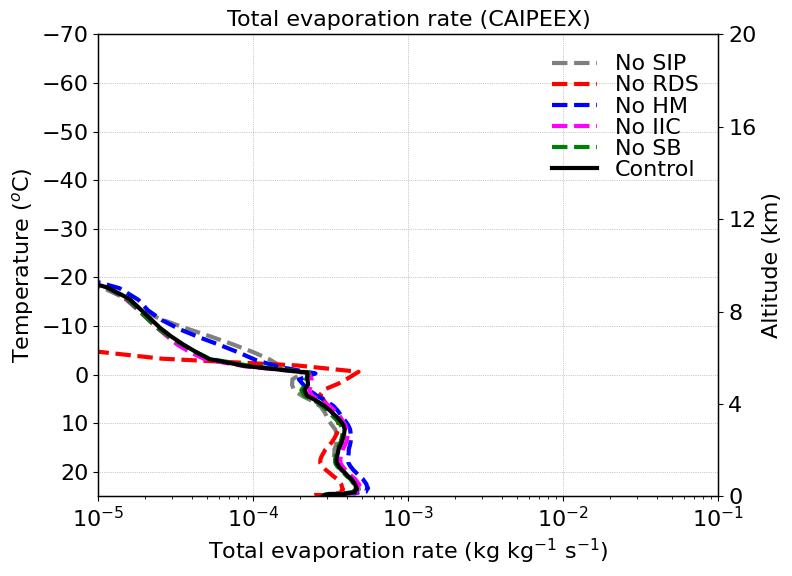

In [14]:

fontsize=16;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_dq_evap_nosip*fact, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_dq_evap_norf*fact, mean_tempc_norf, '--', color='red', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_dq_evap_nohm*fact, mean_tempc_nohm, '--', color='blue', linewidth=lnwdth, label='No HM')
plt1.plot(mean_dq_evap_nobr*fact, mean_tempc_nobr, '--', color='magenta', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_dq_evap_nosb*fact, mean_tempc_nosb, '--', color='green', linewidth=lnwdth, label='No SB')
plt1.plot(mean_dq_evap_4sip*fact, mean_tempc_4sip, '-', color='black', linewidth=lnwdth, label='Control')

plt2.plot(mean_dq_evap_4sip*fact, mean_ht_4sip, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-5, 1.e-1)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 16)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total evaporation rate (kg kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('Total evaporation rate (CAIPEEX)', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

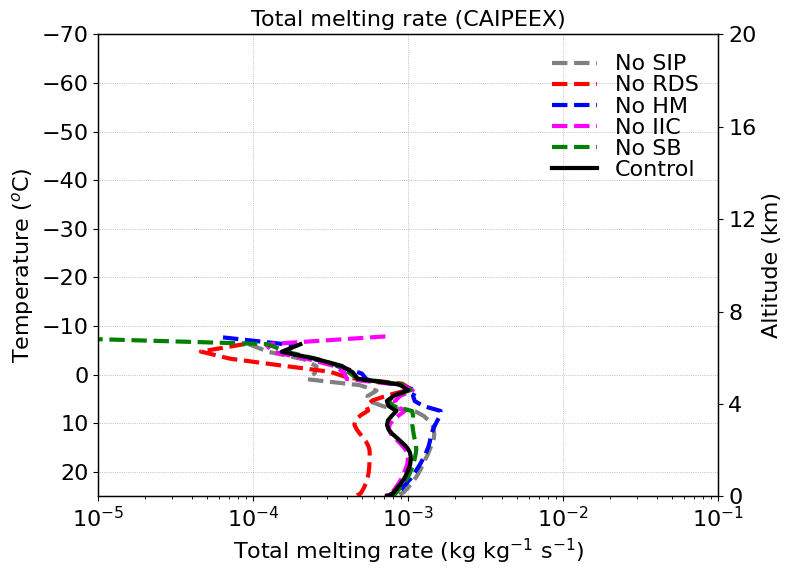

In [15]:

fontsize=16;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_dq_melt_nosip*fact, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_dq_melt_norf*fact, mean_tempc_norf, '--', color='red', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_dq_melt_nohm*fact, mean_tempc_nohm, '--', color='blue', linewidth=lnwdth, label='No HM')
plt1.plot(mean_dq_melt_nobr*fact, mean_tempc_nobr, '--', color='magenta', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_dq_melt_nosb*fact, mean_tempc_nosb, '--', color='green', linewidth=lnwdth, label='No SB')
plt1.plot(mean_dq_melt_4sip*fact, mean_tempc_4sip, '-', color='black', linewidth=lnwdth, label='Control')

plt2.plot(mean_dq_melt_4sip*fact, mean_ht_4sip, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-5, 1.e-1)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total melting rate (kg kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('Total melting rate (CAIPEEX)', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

In [ ]:

#mean_lhr_kperd_4sip_mc3e[mean_tempc_4sip_mc3e > 18.] = np.nan

fontsize=16;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_dq_homhet_nosip*fact, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_dq_homhet_norf*fact, mean_tempc_norf, '--', color='red', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_dq_homhet_nohm*fact, mean_tempc_nohm, '--', color='blue', linewidth=lnwdth, label='No HM')
plt1.plot(mean_dq_homhet_nobr*fact, mean_tempc_nobr, '--', color='magenta', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_dq_homhet_nosb*fact, mean_tempc_nosb, '--', color='green', linewidth=lnwdth, label='No SB')
plt1.plot(mean_dq_homhet_4sip*fact, mean_tempc_4sip, '-', color='black', linewidth=lnwdth, label='Control')

plt2.plot(mean_dq_homhet_4sip*fact, mean_ht_4sip, '-', color='none', linewidth=lnwdth)#, label='Control')

#plt2.plot(mean_tot_inc_up_caipeex*fact, mean_ht_4sip_caipeex, '-', color='none', linewidth=lnwdth)#, label='No SB')
#plt2.plot(mean_tot_inc_up_dcmex*fact, mean_ht_4sip_dcmex, '-', color='none', linewidth=lnwdth)
#plt2.plot(mean_tot_inc_up_mc3e*fact, mean_ht_4sip_mc3e, '-', color='none', linewidth=lnwdth)
#plt2.plot(mean_tot_inc_up_orcestra*fact, mean_ht_4sip_orcestra, '-', color='none', linewidth=lnwdth)
#plt2.plot(mean_tot_inc_up_steps*fact, mean_ht_4sip_steps, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
#plt2.grid(True, linestyle='-', linewidth=0., color='grey', alpha=0.8)

plt1.set_xscale('log')
#plt1.set_xlim(1.e-5, 1.e-1)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Homogeneous and heterogeneous nucleation rate (kg kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('Homogeneous and heterogeneous nucleation rate (CAIPEEX)', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

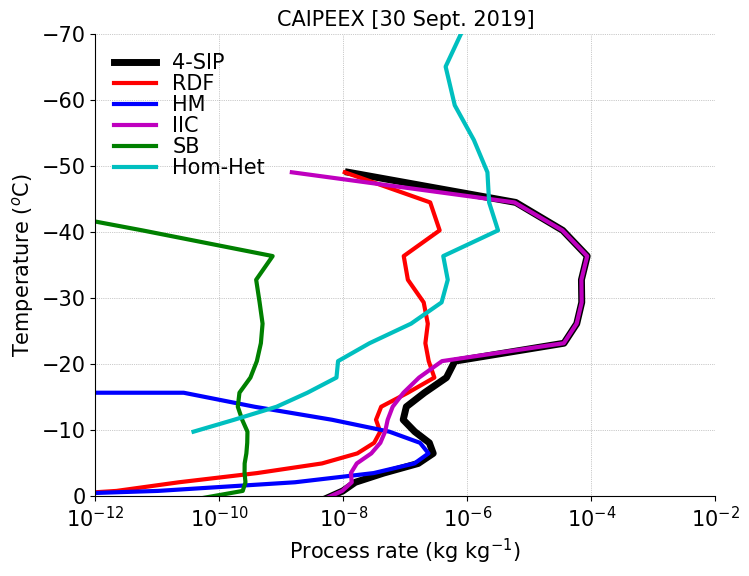

In [7]:

thres_q = 1.e-12
qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqi_sec, np.nan)
dqi_sec_tot = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqi_ds, np.nan)
dqi_rf_tot = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqi_rs, np.nan)
dqi_hm_tot = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqi_br, np.nan)
dqi_br_tot = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqi_snow_sbf, np.nan)
dqi_snow_sb = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqi_graup_sbf, np.nan)
dqi_graup_sb = qi_filt.mean(dim=('time','ncells'))

dqi_tot_sb = dqi_snow_sb + dqi_graup_sb

qi_filt = xr.where(ds_4sip.d_qi_homhet > thres_q, ds_4sip.d_qi_homhet, np.nan)
dqi_homhet_tot = qi_filt.mean(dim=('time', 'ncells'))


avg_tempc = ds_4sip.tempc.mean(dim=('time','ncells'))


dqi_sec_tot = dqi_sec_tot.where(avg_tempc > -50)
dqi_rf_tot = dqi_rf_tot.where(avg_tempc > -50)
dqi_hm_tot = dqi_hm_tot.where(avg_tempc > -50)
dqi_br_tot = dqi_br_tot.where(avg_tempc > -50)
dqi_tot_sb = dqi_tot_sb.where(avg_tempc > -50)

dqi_sec_tot = dqi_sec_tot.values #where(avg_tempc > -50)
dqi_rf_tot = dqi_rf_tot.values   #where(avg_tempc > -50)
dqi_hm_tot = dqi_hm_tot.values   #where(avg_tempc > -50)
dqi_br_tot = dqi_br_tot.values   #where(avg_tempc > -50)
dqi_tot_sb = dqi_tot_sb.values   #where(avg_tempc > -50)
dqi_homhet_tot = dqi_homhet_tot.values
avg_tempc = avg_tempc.values

fontsize=15;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(dqi_sec_tot, avg_tempc, 'k-', linewidth=lnwdth+2, label='4-SIP')
plt.plot(dqi_rf_tot, avg_tempc, 'r-', linewidth=lnwdth, label='RDF')
plt.plot(dqi_hm_tot, avg_tempc, 'b-', linewidth=lnwdth, label='HM')
plt.plot(dqi_br_tot, avg_tempc, 'm-', linewidth=lnwdth, label='IIC')
plt.plot(dqi_tot_sb, avg_tempc, 'g-', linewidth=lnwdth, label='SB')
plt.plot(dqi_homhet_tot, avg_tempc, 'c-', linewidth=lnwdth, label='Hom-Het')

plt.xscale('log')
plt.xlim(1.e-12, 1.e-2)
plt.ylim(0, -70)
#plt.xticks([-4, -2, 0, 2, 4, 6, 8, 10], fontsize=fontsize)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.xlabel('Process rate (kg kg$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('CAIPEEX [30 Sept. 2019]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['right'].set_linewidth(3)
plt.gca().spines['right'].set_linewidth(3)
plt.show()


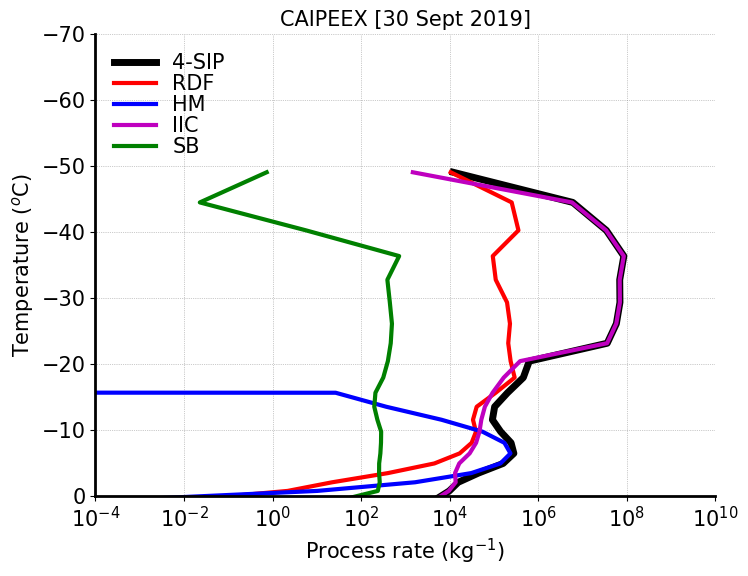

In [12]:

thres_q = 1.e-12
qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_sec, np.nan)
dqi_sec_tot = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_ds, np.nan)
dqi_rf_tot = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_rs, np.nan)
dqi_hm_tot = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_br, np.nan)
dqi_br_tot = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_snow_sbf, np.nan)
dqi_snow_sb = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_graup_sbf, np.nan)
dqi_graup_sb = qi_filt.mean(dim=('time','ncells'))

dqi_tot_sb = dqi_snow_sb + dqi_graup_sb

qi_filt = xr.where(ds_4sip.d_qi_homhet > thres_q, ds_4sip.d_qi_homhet, np.nan)
dqi_homhet_tot = qi_filt.mean(dim=('time', 'ncells'))


avg_tempc = ds_4sip.tempc.mean(dim=('time','ncells'))


dqi_sec_tot = dqi_sec_tot.where(avg_tempc > -50)
dqi_rf_tot = dqi_rf_tot.where(avg_tempc > -50)
dqi_hm_tot = dqi_hm_tot.where(avg_tempc > -50)
dqi_br_tot = dqi_br_tot.where(avg_tempc > -50)
dqi_tot_sb = dqi_tot_sb.where(avg_tempc > -50)

dqi_sec_tot = dqi_sec_tot.values #where(avg_tempc > -50)
dqi_rf_tot = dqi_rf_tot.values   #where(avg_tempc > -50)
dqi_hm_tot = dqi_hm_tot.values   #where(avg_tempc > -50)
dqi_br_tot = dqi_br_tot.values   #where(avg_tempc > -50)
dqi_tot_sb = dqi_tot_sb.values   #where(avg_tempc > -50)
dqi_homhet_tot = dqi_homhet_tot.values
avg_tempc = avg_tempc.values

fontsize=15;
lnwdth=3;
alpha=0.6;
st = 3
plt.figure(figsize=(8, 6))
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(dqi_sec_tot, avg_tempc, 'k-', linewidth=lnwdth+2, label='4-SIP')
plt.plot(dqi_rf_tot, avg_tempc, 'r-', linewidth=lnwdth, label='RDF')
plt.plot(dqi_hm_tot, avg_tempc, 'b-', linewidth=lnwdth, label='HM')
plt.plot(dqi_br_tot, avg_tempc, 'm-', linewidth=lnwdth, label='IIC')
plt.plot(dqi_tot_sb, avg_tempc, 'g-', linewidth=lnwdth, label='SB')
#plt.plot(dqi_homhet_tot, avg_tempc, 'c-', linewidth=lnwdth, label='Hom-Het')

plt.xscale('log')
plt.xlim(1.e-4, 1.e10)
plt.ylim(0, -70)
#plt.xticks([-4, -2, 0, 2, 4, 6, 8, 10], fontsize=fontsize)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.xlabel('Process rate (kg$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('CAIPEEX [30 Sept 2019]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()


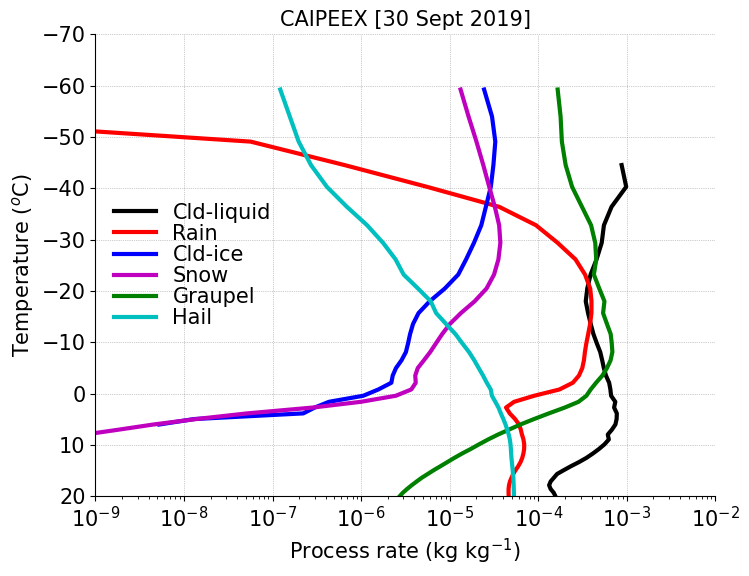

In [9]:

thres_q = 1.e-12
filt_q = xr.where(ds_4sip.qr > thres_q, ds_4sip.qr, np.nan)
avg_qr = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qc > thres_q, ds_4sip.qc, np.nan)
avg_qc = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qi > thres_q, ds_4sip.qi, np.nan)
avg_qi = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qs > thres_q, ds_4sip.qs, np.nan)
avg_qs = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qh > thres_q, ds_4sip.qg, np.nan)
avg_qg = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qh > thres_q, ds_4sip.qh, np.nan)
avg_qh = filt_q.mean(dim=('time','ncells'))

avg_tempc = ds_4sip.tempc.mean(dim=('time','ncells'))

avg_qr = avg_qr.where(avg_tempc > -60)
avg_qc = avg_qc.where(avg_tempc > -60)
avg_qi = avg_qi.where(avg_tempc > -60)
avg_qs = avg_qs.where(avg_tempc > -60)
avg_qg = avg_qg.where(avg_tempc > -60)
avg_qh = avg_qh.where(avg_tempc > -60)

avg_qr = avg_qr.values
avg_qc = avg_qc.values
avg_qi = avg_qi.values
avg_qs = avg_qs.values
avg_qg = avg_qg.values
avg_qh = avg_qh.values

avg_tempc = avg_tempc.values

fontsize=15;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(avg_qc, avg_tempc, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt.plot(avg_qr, avg_tempc, 'r-', linewidth=lnwdth, label='Rain')
plt.plot(avg_qi, avg_tempc, 'b-', linewidth=lnwdth, label='Cld-ice')
plt.plot(avg_qs, avg_tempc, 'm-', linewidth=lnwdth, label='Snow')
plt.plot(avg_qg, avg_tempc, 'g-', linewidth=lnwdth, label='Graupel')
plt.plot(avg_qh, avg_tempc, 'c-', linewidth=lnwdth, label='Hail')

plt.xscale('log')
plt.xlim(1.e-9, 1.e-2)
plt.ylim(20, -70)
#plt.xticks([-4, -2, 0, 2, 4, 6, 8, 10], fontsize=fontsize)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.xlabel('Process rate (kg kg$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('CAIPEEX [30 Sept 2019]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['right'].set_linewidth(3)
plt.gca().spines['right'].set_linewidth(3)
plt.show()

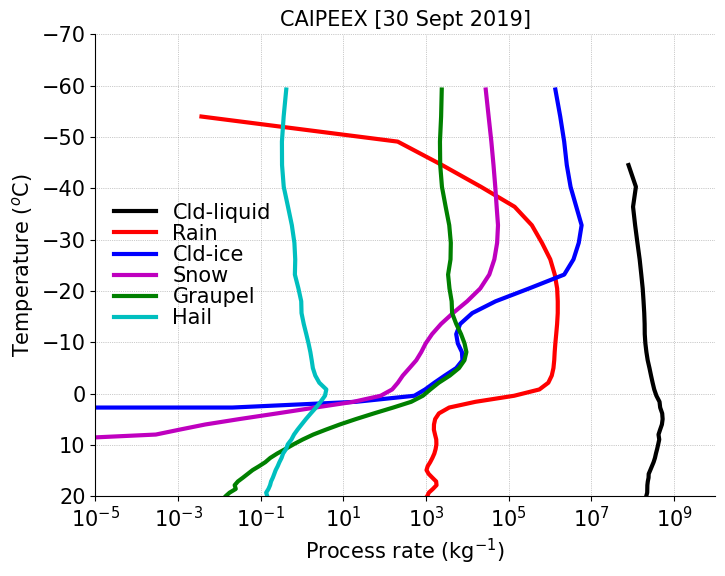

In [11]:

thres_q = 1.e-12
filt_q = xr.where(ds_4sip.qr > thres_q, ds_4sip.qnr, np.nan)
avg_qnr = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qc > thres_q, ds_4sip.qnc, np.nan)
avg_qnc = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qi > thres_q, ds_4sip.qni, np.nan)
avg_qni = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qs > thres_q, ds_4sip.qns, np.nan)
avg_qns = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qh > thres_q, ds_4sip.qng, np.nan)
avg_qng = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qh > thres_q, ds_4sip.qnh, np.nan)
avg_qnh = filt_q.mean(dim=('time','ncells'))

avg_tempc = ds_4sip.tempc.mean(dim=('time','ncells'))

avg_qnr = avg_qnr.where(avg_tempc > -60)
avg_qnc = avg_qnc.where(avg_tempc > -60)
avg_qni = avg_qni.where(avg_tempc > -60)
avg_qns = avg_qns.where(avg_tempc > -60)
avg_qng = avg_qng.where(avg_tempc > -60)
avg_qnh = avg_qnh.where(avg_tempc > -60)

avg_qnr = avg_qnr.values
avg_qnc = avg_qnc.values
avg_qni = avg_qni.values
avg_qns = avg_qns.values
avg_qng = avg_qng.values
avg_qnh = avg_qnh.values

avg_tempc = avg_tempc.values

fontsize=15;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(avg_qnc, avg_tempc, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt.plot(avg_qnr, avg_tempc, 'r-', linewidth=lnwdth, label='Rain')
plt.plot(avg_qni, avg_tempc, 'b-', linewidth=lnwdth, label='Cld-ice')
plt.plot(avg_qns, avg_tempc, 'm-', linewidth=lnwdth, label='Snow')
plt.plot(avg_qng, avg_tempc, 'g-', linewidth=lnwdth, label='Graupel')
plt.plot(avg_qnh, avg_tempc, 'c-', linewidth=lnwdth, label='Hail')

plt.xscale('log')
plt.xlim(1.e-2, 1.e10)
plt.ylim(20, -70)
#plt.xticks([-4, -2, 0, 2, 4, 6, 8, 10], fontsize=fontsize)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.xlabel('Process rate (kg$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('CAIPEEX [30 Sept 2019]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['right'].set_linewidth(3)
plt.gca().spines['right'].set_linewidth(3)
plt.show()


In [ ]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import multiprocessing
import dask.array as da
import time

thres_q = 1.e-12

start = time.time()

avg_ht = 1.e-3*ds_4sip.z_mc.mean(dim=('time', 'ncells'))

def process_variable(var, ref_var, ds):
    """Processes variable with dask-backed operations"""
    avg_tempc = ds.tempc.mean(dim=('time', 'ncells'))
    filt_q = xr.where(ref_var > thres_q, var, np.nan).mean(dim=('time', 'ncells'))
    return filt_q.where(avg_tempc > -60)

if __name__ == '__main__':
    variable_pairs = [
        (ds_4sip.qnr, ds_4sip.qr),  # Rain
        (ds_4sip.qnc, ds_4sip.qc),  # Cloud-liquid
        (ds_4sip.qni, ds_4sip.qi),  # Cloud-ice
        (ds_4sip.qns, ds_4sip.qs),  # Snow
        (ds_4sip.qng, ds_4sip.qh),  # Graupel
        (ds_4sip.qnh, ds_4sip.qh)   # Hail
    ]
    
    results = [process_variable(var, ref, ds_4sip) for var, ref in variable_pairs]
    
    # Compute results correctly
    avg_qnr, avg_qnc, avg_qni, avg_qns, avg_qng, avg_qnh = [r.compute() for r in results]


    # Plotting
    fontsize = 15
    lnwdth = 3
    alpha = 0.6

    plt.figure(figsize=(8, 6))
    plt1 = plt.gca()
    plt2 = plt1.twinx()
    fact = 1.
    #plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
    plt1.plot(avg_qnc*fact, avg_tempc, 'k-', linewidth=lnwdth, label='Cld-liquid')
    plt1.plot(avg_qnr*fact, avg_tempc, 'r-', linewidth=lnwdth, label='Rain')
    plt1.plot(avg_qni*fact, avg_tempc, 'b-', linewidth=lnwdth, label='Cld-ice')
    plt1.plot(avg_qns*fact, avg_tempc, 'm-', linewidth=lnwdth, label='Snow')
    plt1.plot(avg_qng*fact, avg_tempc, 'g-', linewidth=lnwdth, label='Graupel')
    plt1.plot(avg_qnh*fact, avg_tempc, 'c-', linewidth=lnwdth, label='Hail')

    plt2.plot(avg_qnh, mean_ht, '-', color='none', linewidth=lnwdth)

    plt1.set_xscale('log')
    plt1.set_xlim(1.e-2, 1.e12)
    plt1.set_ylim(25, -70)
    plt2.set_ylim(0.5, 20)

    plt1.tick_params(axis='x', labelsize=fontsize)
    plt1.tick_params(axis='y', labelsize=fontsize)
    plt2.tick_params(axis='y', labelsize=fontsize) 
    
    
    plt1.set_xticks([1.e-2, 1.e0, 1.e2, 1.e4, 1.e6, 1.e8, 1.e10, 1.e12])
    plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
    plt2.set_yticks([0, 4, 8, 12, 16, 20])
    
    plt1.set_xlabel('Process rate (kg$^{-1}$)', fontsize=fontsize)
    plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
    plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
    plt.title('CAIPEEX [30 Sept 2019]', fontsize=fontsize)
    plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')
    plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
    plt1.spines['top'].set_visible(False)
    plt2.spines['top'].set_visible(False)
    plt1.spines['left'].set_linewidth(1)
    plt1.spines['bottom'].set_linewidth(1)
    plt1.spines['right'].set_linewidth(1)
    plt.show()

end = time.time()
print('Time :: ', end-start)

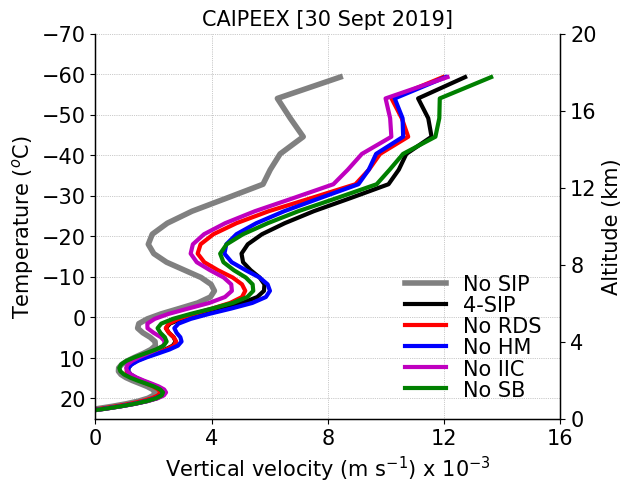

Time taken ::  34.382598876953125


In [11]:
import multiprocessing
import xarray as xr
import matplotlib.pyplot as plt
import time



start = time.time()

def process_dataset(args):
    """Parallel processing of each dataset"""
    ds, mean_tempc = args
    return ds.w_vel.mean(dim=('time', 'ncells')).where(mean_tempc > -60).compute().values

if __name__ == '__main__':
    mean_tempc = ds_4sip.tempc.mean(dim=('time', 'ncells')).compute()
    mean_ht = 1.e-3 * ds_4sip.z_mc.mean(dim=('time', 'ncells')).compute()

    datasets = [ds_nosip, ds_4sip, ds_norf, ds_nohm, ds_nobr, ds_nosb]

    # Parallel processing using multiprocessing
    with multiprocessing.Pool(processes=6) as pool:  # Use 6 workers
        results = pool.map(process_dataset, [(ds, mean_tempc) for ds in datasets])

    (mean_w_net_nosip, mean_w_net_4sip, mean_w_net_norf, mean_w_net_nohm, mean_w_net_nobr, mean_w_net_nosb) = results
    

    # Plotting 
    fontsize = 15
    lnwdth = 3
    alpha = 0.6

    plt.figure(figsize=(6, 5))
    plt1 = plt.gca()
    plt2 = plt1.twinx()
    plt1.plot(mean_w_net_nosip*1.e3, mean_tempc, '-', color='grey', linewidth=lnwdth+1, label='No SIP')
    plt1.plot(mean_w_net_4sip*1.e3, mean_tempc, 'k-', linewidth=lnwdth, label='4-SIP')
    plt1.plot(mean_w_net_norf*1.e3, mean_tempc, 'r-', linewidth=lnwdth, label='No RDS')
    plt1.plot(mean_w_net_nohm*1.e3, mean_tempc, 'b-', linewidth=lnwdth, label='No HM')
    plt1.plot(mean_w_net_nobr*1.e3, mean_tempc, 'm-', linewidth=lnwdth, label='No IIC')
    plt1.plot(mean_w_net_nosb*1.e3, mean_tempc, 'g-', linewidth=lnwdth, label='No SB')

    plt2.plot(mean_w_net_nosip*1.e3, mean_ht, '-', color='none', linewidth=lnwdth+1)#, label='No SIP')

    plt1.set_xlim(0., 16)
    plt1.set_ylim(25, -70)
    plt2.set_ylim(0.5, 20)

    plt1.tick_params(axis='x', labelsize=fontsize)
    plt1.tick_params(axis='y', labelsize=fontsize)
    plt2.tick_params(axis='y', labelsize=fontsize) 
    
    
    plt1.set_xticks([0, 4, 8, 12, 16])
    plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
    plt2.set_yticks([0, 4, 8, 12, 16, 20])
    
    plt1.set_xlabel('Vertical velocity (m s$^{-1}$) x 10$^{-3}$', fontsize=fontsize)
    plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
    plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
    plt.title('CAIPEEX [30 Sept 2019]', fontsize=fontsize)
    plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')
    plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
    plt1.spines['top'].set_visible(False)
    plt2.spines['top'].set_visible(False)
    #plt.spines['right'].set_visible(False)
    plt1.spines['left'].set_linewidth(1)
    plt1.spines['bottom'].set_linewidth(1)
    plt1.spines['right'].set_linewidth(1)
    plt.show()
    
    end = time.time()
    print('Time taken :: ', end-start)

In [66]:
print(ds_4sip.tempc[1,0,1].values)
print(ds_4sip.z_mc[1,0,1].values)

-67.23299
20700.926


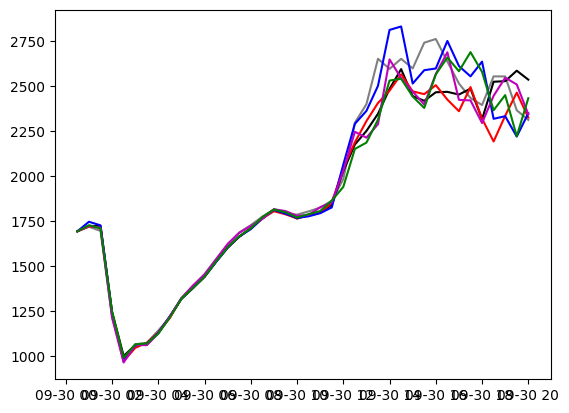

In [14]:


hbas_filt = xr.where(ds_nosip.hbas_con > 0., ds_nosip.hbas_con, np.nan)
htop_filt = xr.where(ds_nosip.htop_con > 0., ds_nosip.htop_con, np.nan)

cld_base_nosip = hbas_filt.mean('ncells')
cld_top_nosip = htop_filt.mean('ncells')

hbas_filt = xr.where(ds_4sip.hbas_con > 0., ds_4sip.hbas_con, np.nan)
htop_filt = xr.where(ds_4sip.htop_con > 0., ds_4sip.htop_con, np.nan)

cld_base_4sip = hbas_filt.mean('ncells')
cld_top_4sip = htop_filt.mean('ncells')

hbas_filt = xr.where(ds_norf.hbas_con > 0., ds_norf.hbas_con, np.nan)
htop_filt = xr.where(ds_norf.htop_con > 0., ds_norf.htop_con, np.nan)

cld_base_norf = hbas_filt.mean('ncells')
cld_top_norf = htop_filt.mean('ncells')

hbas_filt = xr.where(ds_nohm.hbas_con > 0., ds_nohm.hbas_con, np.nan)
htop_filt = xr.where(ds_nohm.htop_con > 0., ds_nohm.htop_con, np.nan)

cld_base_nohm = hbas_filt.mean('ncells')
cld_top_nohm = htop_filt.mean('ncells')


hbas_filt = xr.where(ds_nobr.hbas_con > 0., ds_nobr.hbas_con, np.nan)
htop_filt = xr.where(ds_nobr.htop_con > 0., ds_nobr.htop_con, np.nan)

cld_base_nobr = hbas_filt.mean('ncells')
cld_top_nobr = htop_filt.mean('ncells')


hbas_filt = xr.where(ds_nosb.hbas_con > 0., ds_nosb.hbas_con, np.nan)
htop_filt = xr.where(ds_nosb.htop_con > 0., ds_nosb.htop_con, np.nan)

cld_base_nosb = hbas_filt.mean('ncells')
cld_top_nosb = htop_filt.mean('ncells')



plt.plot(ds_nosip.time, cld_base_nosip, '-', color='grey')
plt.plot(ds_4sip.time, cld_base_4sip, 'k-')
plt.plot(ds_norf.time, cld_base_norf, 'r-')
plt.plot(ds_nohm.time, cld_base_nohm, 'b-')
plt.plot(ds_nobr.time, cld_base_nobr, 'm-')
plt.plot(ds_nosb.time, cld_base_nosb, 'g-')

In [7]:

mean_ht_nosip = ds_nosip.z_mc.mean(dim=('time','ncells'))
mean_tempc_nosip = ds_nosip.tempc.mean(dim=('time','ncells'))

mean_ht_4sip = ds_4sip.z_mc.mean(dim=('time','ncells'))
mean_tempc_4sip = ds_4sip.tempc.mean(dim=('time','ncells'))

mean_ht_norf = ds_norf.z_mc.mean(dim=('time','ncells'))
mean_tempc_norf = ds_norf.tempc.mean(dim=('time','ncells'))

mean_ht_nohm = ds_nohm.z_mc.mean(dim=('time','ncells'))
mean_tempc_nohm = ds_nohm.tempc.mean(dim=('time','ncells'))

mean_ht_nobr = ds_nobr.z_mc.mean(dim=('time','ncells'))
mean_tempc_nobr = ds_nobr.tempc.mean(dim=('time','ncells'))

mean_ht_nosb = ds_nosb.z_mc.mean(dim=('time','ncells'))
mean_tempc_nosb = ds_nosb.tempc.mean(dim=('time','ncells'))

w_thres = 2.
# Latent heating rate with No SIP
filt_lhr = xr.where((ds_nosip.tq > 1.e-6) & (ds_nosip.w_vel > w_thres), ds_nosip.d_lhr, np.nan)
lhr_kpers_nosip = (1./1800.) * np.gradient(ds_nosip.d_lhr, axis=0) # w.r.t. time
lhr_kperd_nosip = lhr_kpers_nosip * 86400.
mean_lhr_kperd_nosip = np.mean(lhr_kperd_nosip, axis=(0,2))

# Latent heating rate with 4-SIP
filt_lhr = xr.where((ds_4sip.tq > 1.e-6) & (ds_4sip.w_vel > w_thres), ds_4sip.d_lhr, np.nan)
lhr_kpers_4sip = (1./1800.) * np.gradient(ds_4sip.d_lhr, axis=0) # w.r.t. time
lhr_kperd_4sip = lhr_kpers_4sip * 86400.
mean_lhr_kperd_4sip = np.mean(lhr_kperd_4sip, axis=(0,2))

# Latent heating rate with No Raindrop Shattering (RF)
filt_lhr = xr.where((ds_norf.tq > 1.e-6) & (ds_norf.w_vel > w_thres), ds_norf.d_lhr, np.nan)
lhr_kpers_norf = (1./1800.) * np.gradient(ds_norf.d_lhr, axis=0) # w.r.t. time
lhr_kperd_norf = lhr_kpers_norf * 86400.
mean_lhr_kperd_norf = np.mean(lhr_kperd_norf, axis=(0,2))

# Latent heating rate with No Hallett-Mossop (HM)
filt_lhr = xr.where((ds_nohm.tq > 1.e-6) & (ds_nohm.w_vel > w_thres), ds_nohm.d_lhr, np.nan)
lhr_kpers_nohm = (1./1800.) * np.gradient(ds_nohm.d_lhr, axis=0) # w.r.t. time
lhr_kperd_nohm = lhr_kpers_nohm * 86400.
mean_lhr_kperd_nohm = np.mean(lhr_kperd_nohm, axis=(0,2))

# Latent heating rate with No ice-ice collision breakup (BR)
filt_lhr = xr.where((ds_nobr.tq > 1.e-6) & (ds_nobr.w_vel > w_thres), ds_nobr.d_lhr, np.nan)
lhr_kpers_nobr = (1./1800.) * np.gradient(ds_nobr.d_lhr, axis=0) # w.r.t. time
lhr_kperd_nobr = lhr_kpers_nobr * 86400.
mean_lhr_kperd_nobr = np.mean(lhr_kperd_nobr, axis=(0,2))

# Latent heating rate with No Sublimation (SB)
filt_lhr = xr.where((ds_nosb.tq > 1.e-6) & (ds_nosb.w_vel > w_thres), ds_nosb.d_lhr, np.nan)
lhr_kpers_nosb = (1./1800.) * np.gradient(ds_nosb.d_lhr, axis=0) # w.r.t. time
lhr_kperd_nosb = lhr_kpers_nosb * 86400.
mean_lhr_kperd_nosb = np.mean(lhr_kperd_nosb, axis=(0,2))


# Change in lhr w.r.t. control
del_lhr_kperd_norf = mean_lhr_kperd_4sip-mean_lhr_kperd_norf
del_lhr_kperd_nohm = mean_lhr_kperd_4sip-mean_lhr_kperd_nohm
del_lhr_kperd_nobr = mean_lhr_kperd_4sip-mean_lhr_kperd_nobr
del_lhr_kperd_nosb = mean_lhr_kperd_4sip-mean_lhr_kperd_nosb
del_lhr_kperd_nosip = mean_lhr_kperd_4sip-mean_lhr_kperd_nosip


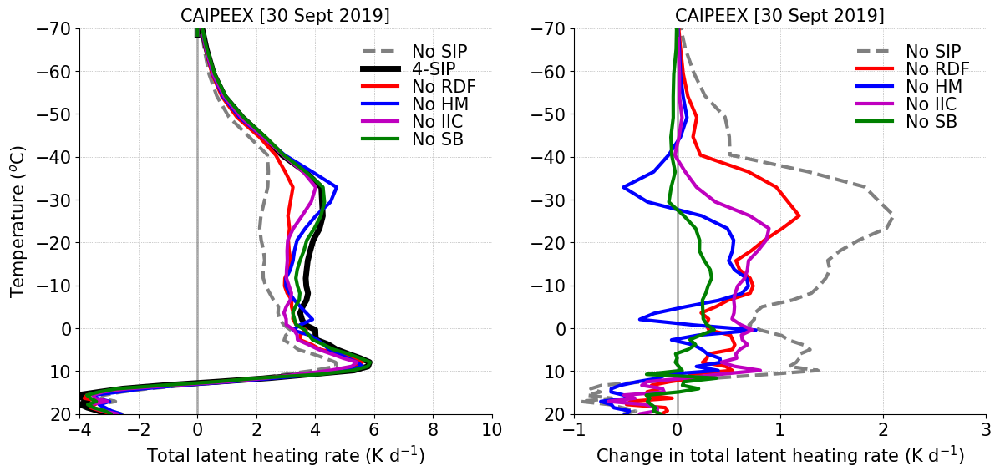

In [8]:

fontsize=15;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(14, 6))
plt.subplot(1,2,1)
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(mean_lhr_kperd_nosip, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(mean_lhr_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth+2, label='4-SIP')
plt.plot(mean_lhr_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDF')
plt.plot(mean_lhr_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(mean_lhr_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(mean_lhr_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlim(-4, 10)
plt.ylim(20, -70)
plt.xticks([-4, -2, 0, 2, 4, 6, 8, 10], fontsize=fontsize)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xlabel('Total latent heating rate (K d$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('CAIPEEX [30 Sept 2019]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['right'].set_linewidth(3)
plt.gca().spines['right'].set_linewidth(3)

plt.subplot(1,2,2)
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(del_lhr_kperd_nosip, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(del_lhr_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDF')
plt.plot(del_lhr_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(del_lhr_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(del_lhr_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlim(-1, 3)
plt.ylim(20, -70)
plt.xticks([-1, 0, 1, 2, 3], fontsize=fontsize)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xlabel('Change in total latent heating rate (K d$^{-1}$)', fontsize=fontsize)
#plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('CAIPEEX [30 Sept 2019]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['right'].set_linewidth(3)
plt.gca().spines['right'].set_linewidth(3)
plt.show()


In [25]:

#######
min_tempc_sip = ds_4sip.tempc.min().values
max_tempc_sip = ds_4sip.tempc.max().values

min_wvel_sip = ds_4sip.w_vel.min().values
max_wvel_sip = ds_4sip.w_vel.max().values

num_temp_bin = 20; num_w_bin = 20;

temp_bin = np.linspace(min_tempc_sip, max_tempc_sip, num_temp_bin+1)
wvel_bin = np.linspace(min_wvel_sip, max_wvel_sip, num_w_bin+1)
#######

#######
tempc_sip_flat = ds_4sip.tempc.values.flatten()
wvel_sip_flat = ds_4sip.w_vel.values.flatten()

qc_sip_flat = ds_4sip.qc.values.flatten()
qi_sip_flat = ds_4sip.qi.values.flatten()
qs_sip_flat = ds_4sip.qs.values.flatten()
qg_sip_flat = ds_4sip.qg.values.flatten()
qh_sip_flat = ds_4sip.qh.values.flatten()
tqi_sip_flat = ds_4sip.tqi.values.flatten()
#######

hist_sip, temp_edges_sip, wvel_edges_sip = np.histogram2d(tempc_sip_flat, wvel_sip_flat, bins=(temp_bin, wvel_bin))

#######
qc_sum_sip = np.histogram2d(tempc_sip_flat, wvel_sip_flat, bins=(temp_bin, wvel_bin), weights = qc_sip_flat)[0]
qi_sum_sip = np.histogram2d(tempc_sip_flat, wvel_sip_flat, bins=(temp_bin, wvel_bin), weights = qi_sip_flat)[0]
qs_sum_sip = np.histogram2d(tempc_sip_flat, wvel_sip_flat, bins=(temp_bin, wvel_bin), weights = qs_sip_flat)[0]
qg_sum_sip = np.histogram2d(tempc_sip_flat, wvel_sip_flat, bins=(temp_bin, wvel_bin), weights = qg_sip_flat)[0]
qh_sum_sip = np.histogram2d(tempc_sip_flat, wvel_sip_flat, bins=(temp_bin, wvel_bin), weights = qh_sip_flat)[0]
tqi_sum_sip = np.histogram2d(tempc_sip_flat, wvel_sip_flat, bins=(temp_bin, wvel_bin), weights = tqi_sip_flat)[0]
#######

#######
avg_qc_temp_w_sip = qc_sum_sip/hist_sip
avg_qc_temp_w_sip[avg_qc_temp_w_sip < 1.e-9] = np.nan

avg_qi_temp_w_sip = qi_sum_sip/hist_sip
avg_qi_temp_w_sip[avg_qi_temp_w_sip < 1.e-9] = np.nan

avg_qs_temp_w_sip = qs_sum_sip/hist_sip
avg_qs_temp_w_sip[avg_qs_temp_w_sip < 1.e-9] = np.nan

avg_qg_temp_w_sip = qg_sum_sip/hist_sip
avg_qg_temp_w_sip[avg_qg_temp_w_sip < 1.e-9] = np.nan

avg_qh_temp_w_sip = qh_sum_sip/hist_sip
avg_qh_temp_w_sip[avg_qh_temp_w_sip < 1.e-9] = np.nan

avg_tqi_temp_w_sip = tqi_sum_sip/hist_sip
avg_tqi_temp_w_sip[avg_tqi_temp_w_sip < 1.e-9] = np.nan
#######


/tmp/ipykernel_1917976/3900975349.py:8: RuntimeWarning: invalid value encountered in divide
  avg_qc_temp_w_sip = qc_sum_sip/hist_sip
/tmp/ipykernel_1917976/3900975349.py:11: RuntimeWarning: invalid value encountered in divide
  avg_qi_temp_w_sip = qi_sum_sip/hist_sip
/tmp/ipykernel_1917976/3900975349.py:14: RuntimeWarning: invalid value encountered in divide
  avg_qs_temp_w_sip = qs_sum_sip/hist_sip
/tmp/ipykernel_1917976/3900975349.py:17: RuntimeWarning: invalid value encountered in divide
  avg_qg_temp_w_sip = qg_sum_sip/hist_sip
/tmp/ipykernel_1917976/3900975349.py:20: RuntimeWarning: invalid value encountered in divide
  avg_qh_temp_w_sip = qh_sum_sip/hist_sip
/tmp/ipykernel_1917976/3900975349.py:23: RuntimeWarning: invalid value encountered in divide
  avg_tqi_temp_w_sip = tqi_sum_sip/hist_sip


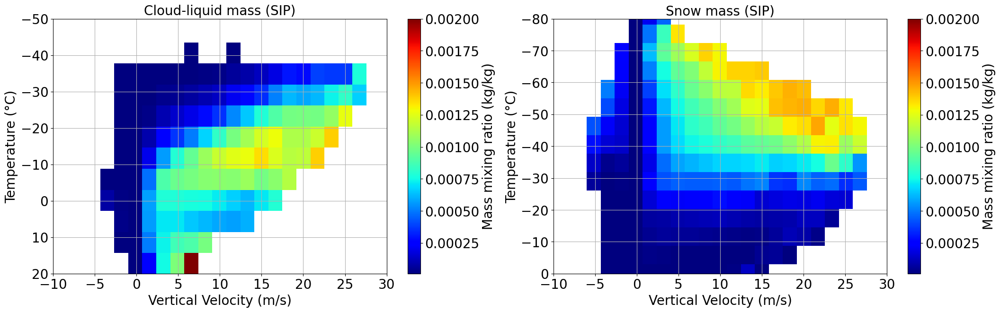

In [37]:

fontsize = 20;

plt.figure(figsize=(25, 7))
plt.subplot(1,2,1)
contour=plt.imshow(avg_qc_temp_w_sip, extent=[wvel_bin[0], wvel_bin[-1],temp_bin[0], temp_bin[-1]], 
                   vmin=1.e-5, vmax=2.e-3, aspect='auto', origin='lower',cmap='jet')

plt.grid(True)
plt.xlim(-10, 30)
plt.xticks([-10, -5, 0, 5, 10, 15, 20, 25, 30], fontsize=fontsize)
plt.ylim(20, -50)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Cloud-liquid mass (SIP)', fontsize=fontsize)

plt.subplot(1,2,2)
contour=plt.imshow(avg_qi_temp_w_sip, extent=[wvel_bin[0], wvel_bin[-1],temp_bin[0], temp_bin[-1]], 
                   vmin=1.e-5, vmax=2.e-3, aspect='auto', origin='lower',cmap='jet')

plt.grid(True)
plt.xlim(-10, 30)
plt.xticks([-10, -5, 0, 5, 10, 15, 20, 25, 30], fontsize=fontsize)
plt.ylim(0, -80)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Snow mass (SIP)', fontsize=fontsize)
plt.show()

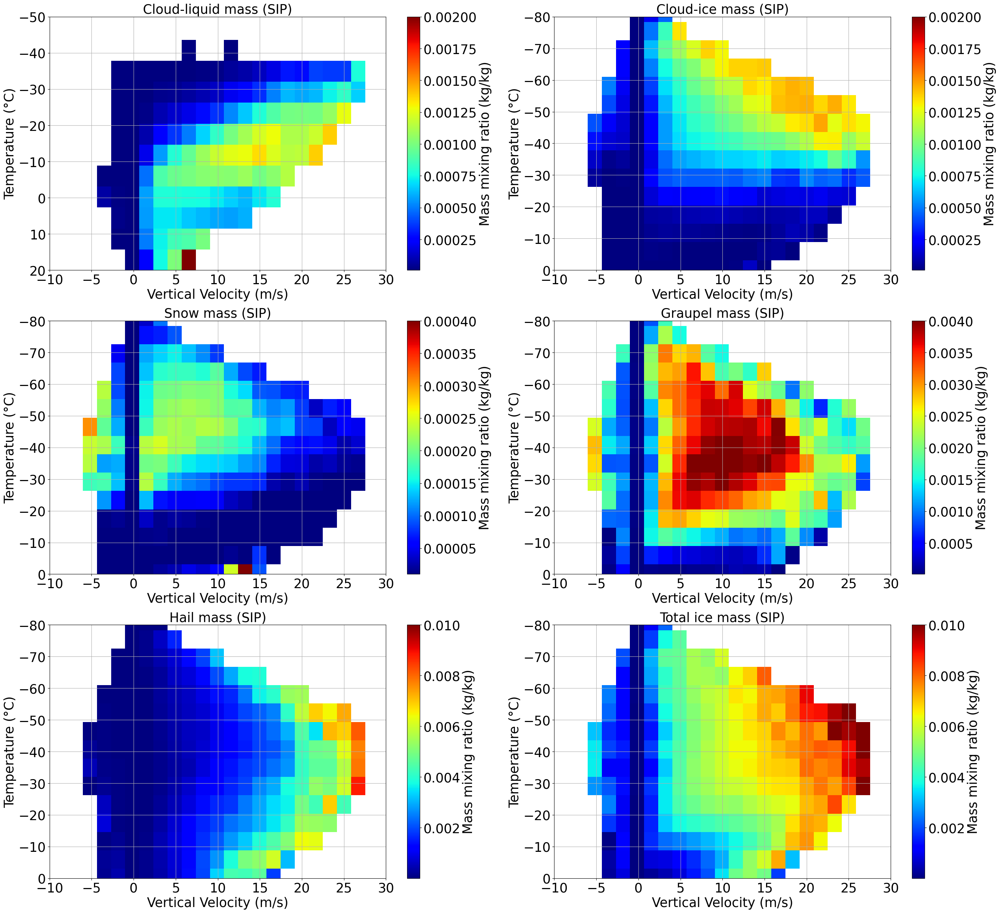

In [64]:


fontsize = 25;

plt.figure(figsize=(32, 30))
plt.subplot(3,2,1)
contour=plt.imshow(avg_qc_temp_w_sip, extent=[wvel_bin[0], wvel_bin[-1],temp_bin[0], temp_bin[-1]], 
                   vmin=1.e-5, vmax=2.e-3, aspect='auto', origin='lower',cmap='jet')

plt.grid(True)
plt.xlim(-10, 30)
plt.xticks([-10, -5, 0, 5, 10, 15, 20, 25, 30], fontsize=fontsize)
plt.ylim(20, -50)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Cloud-liquid mass (SIP)', fontsize=fontsize)

plt.subplot(3,2,2)
contour=plt.imshow(avg_qi_temp_w_sip, extent=[wvel_bin[0], wvel_bin[-1],temp_bin[0], temp_bin[-1]], 
                   vmin=1.e-5, vmax=2.e-3, aspect='auto', origin='lower',cmap='jet')

plt.grid(True)
plt.xlim(-10, 30)
plt.xticks([-10, -5, 0, 5, 10, 15, 20, 25, 30], fontsize=fontsize)
plt.ylim(0, -80)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Cloud-ice mass (SIP)', fontsize=fontsize)
#plt.show()


#fontsize = 20;

#plt.figure(figsize=(25, 7))
plt.subplot(3,2,3)
contour=plt.imshow(avg_qs_temp_w_sip, extent=[wvel_bin[0], wvel_bin[-1],temp_bin[0], temp_bin[-1]], 
                   vmin=1.e-5, vmax=4.e-4, aspect='auto', origin='lower',cmap='jet')

plt.grid(True)
plt.xlim(-10, 30)
plt.xticks([-10, -5, 0, 5, 10, 15, 20, 25, 30], fontsize=fontsize)
plt.ylim(0, -80)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Snow mass (SIP)', fontsize=fontsize)

plt.subplot(3,2,4)
contour=plt.imshow(avg_qg_temp_w_sip, extent=[wvel_bin[0], wvel_bin[-1],temp_bin[0], temp_bin[-1]], 
                   vmin=1.e-5, vmax=4.e-3, aspect='auto', origin='lower',cmap='jet')
plt.grid(True)
plt.xlim(-10, 30)
plt.xticks([-10, -5, 0, 5, 10, 15, 20, 25, 30], fontsize=fontsize)
plt.ylim(0, -80)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Graupel mass (SIP)', fontsize=fontsize)

#plt.show()


#fontsize = 20;

#plt.figure(figsize=(25, 7))
plt.subplot(3,2,5)
contour=plt.imshow(avg_qh_temp_w_sip, extent=[wvel_bin[0], wvel_bin[-1],temp_bin[0], temp_bin[-1]], 
                   vmin=1.e-5, vmax=1.e-2, aspect='auto', origin='lower',cmap='jet')

plt.grid(True)
plt.xlim(-10, 30)
plt.xticks([-10, -5, 0, 5, 10, 15, 20, 25, 30], fontsize=fontsize)
plt.ylim(0, -80)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Hail mass (SIP)', fontsize=fontsize)

plt.subplot(3,2,6)
contour=plt.imshow(avg_tqi_temp_w_sip, extent=[wvel_bin[0], wvel_bin[-1],temp_bin[0], temp_bin[-1]], 
                   vmin=1.e-5, vmax=1.e-2, aspect='auto', origin='lower',cmap='jet')
plt.grid(True)
plt.xlim(-10, 30)
plt.xticks([-10, -5, 0, 5, 10, 15, 20, 25, 30], fontsize=fontsize)
plt.ylim(0, -80)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Total ice mass (SIP)', fontsize=fontsize)

plt.show()
